In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils as utils
import torchvision.transforms as transforms

from torch.autograd import Variable

import os
import time

from PIL.Image import BICUBIC
from torchvision.datasets import MNIST
from ram import RecurrentAttentionModel, RAMContextNetwork
from trainer import *

### MNIST dataset
Testing out this model and training algorithm implementation on the basic MNIST dataset, which is pretty simple so hopefully everything goes well.

In [2]:
num_train_data_copies = 2  # Number of times to load the training dataset (with augmentation)
num_eval_data_copies = 1   # Number of times to load the evaluation dataset (with augmentation)
test_val_split = 0.5       # Percentage of the test set to use as validation data
batch_size = 30            # Batch size for training
eval_batch_size = 25       # Batch size for validation and testing

# Image parameters
num_classes = 10       # Digits 0-9
image_size = 60        # Translate MNIST images randomly into a 60x60 image
in_channels = 1        # Number of color channels in the inputs (MNIST dataset is grayscale)

glimpse_width = 12
glimpse_depth = 3
glimpse_sizes = [glimpse_width * 2**d for d in range(glimpse_depth)]
padding = int(np.ceil(glimpse_sizes[-1] / 2))
padded_img_size = image_size + 2*padding
print('Glimpse sizes: %s' % str(glimpse_sizes))

Glimpse sizes: [12, 24, 48]


In [3]:
# This version of PyTorch doesn't have a random translate
# transform, so we have to write it ourselves
class RandomTranslate:
    def __init__(self, size, fill = 0):
        '''
        `size`: the final size of the translate image, as
        either a 2-tuple of integers for (width, height) or
        a single integer.
        '''
        assert (isinstance(size, tuple) and len(size) == 2) or isinstance(size, int)
        if isinstance(size, int):
            size = (size, size)
        self.size = size
        self.fill = fill
        
    def __call__(self, img):
        '''
        `img`: a PIL image
        '''
        pad_w, pad_h = (s - i_s for s, i_s in zip(self.size, img.size))
        
        pad_left = np.random.randint(0, pad_w)
        pad_top = np.random.randint(0, pad_h)
        pad_right = pad_w - pad_left
        pad_bottom = pad_h - pad_top
        
        padding = (pad_left, pad_top, pad_right, pad_bottom)
        pad_transform = transforms.Pad(padding, fill = self.fill)
        
        return pad_transform(img)

In [4]:
# Down/load MNIST data
mnist_data_loc = os.path.join('data', 'mnist')
data_transforms = transforms.Compose([ # Keep things pretty basic for now
    RandomTranslate(size = image_size),
    # Pad images with 0s so the GlimpseSensor won't have to
    transforms.Pad(padding = padding),
    # Converts a PIL Image or numpy.ndarray (H x W x C) in the range [0, 255]
    # to a torch.FloatTensor of shape (C x H x W) in the range [0.0, 1.0]
    transforms.ToTensor(),
])

'''
Can increase the number of images in each dataset by loading up the data again,
applying the (random) transformations, then concatenating it all together
'''
### Training Dataset and DataLoader
all_train_datasets = [
    MNIST(
        root = mnist_data_loc, train = True,
        download = True, transform = data_transforms
    ) for _ in range(num_train_data_copies)
]
train_datasets = utils.data.ConcatDataset(all_train_datasets)
train_data = utils.data.DataLoader(train_datasets, batch_size = batch_size, shuffle = True)
num_train_data = len(train_datasets)
num_train_batches = len(train_data)

### Validation and Test Dataset and DataLoader
all_eval_datasets = [
    MNIST(
        root = mnist_data_loc, train = False,
        download = True, transform = data_transforms
    ) for _ in range(num_eval_data_copies)
]
eval_datasets = utils.data.ConcatDataset(all_eval_datasets)
num_eval_data = len(eval_datasets)

eval_split_pt = int(test_val_split * num_eval_data)
eval_idx = list(range(num_eval_data))
np.random.shuffle(eval_idx)

val_idx, test_idx = eval_idx[:eval_split_pt], eval_idx[eval_split_pt:]

val_sampler = utils.data.sampler.SubsetRandomSampler(val_idx)
val_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = val_sampler
)
num_val_data = len(val_sampler)
num_val_batches = len(val_data)

test_sampler = utils.data.sampler.SubsetRandomSampler(test_idx)
test_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = test_sampler
)
num_test_data = len(test_sampler)
num_test_batches = len(test_data)

print('Num:\n- train data: %d (%d batches)\n- val data: %d (%d batches)\n- test data: %d (%d batches)' % (
    num_train_data, num_train_batches, num_val_data, num_val_batches, num_test_data, num_test_batches
))

Num:
- train data: 120000 (4000 batches)
- val data: 5000 (200 batches)
- test data: 5000 (200 batches)


In [5]:
# Basic training hyperparameters
lr = 1e-4
min_lr = 1e-3   # this is a scaling factor, so the min lr will actually be min_lr * lr
grad_clip = 1
lr_step_size = 1
steps_per_epoch = int(num_train_data_copies * 20)  # Number of times to step the lr scheduler in an epoch
decay_rate = 0.995

# RL training hyperparameters
end_train_ep_early = False     # End each training episode early after a correct classification
assert (end_train_ep_early and batch_size == 1) or not end_train_ep_early
max_ep_len = 6                 # Maximum number of glimpses per episode
num_epochs = 400               # Number of times to go through all of the training examples
early_stopping = 4

random_start_loc = True
error_penalty = 0.  # Amount of penalty to apply each time the agent makes an incorrect classification (<= 0.)
gamma = 1.0         # Reward discount factor

# Etc
log_freq = num_train_batches // 4    # How often to print a training log in an epoch
viz_freq = num_train_batches // 2     # How often to visualize the glimpses in an epoch
eval_viz_freq = num_val_batches // 1  # How often to visualize the glimpses in an epoch

### Model
Need to modify class implementation so that any recurrent `nn.Module` instance can be passed in when initializing a new `RecurrentAttentionModel` to make it easier to try this visual attention mechanism out with different core recurrent networks.

In [6]:
# Model hyperparameters
glimpse_g_size = 128    # Size of the transformed Glimpse representation in the GlimpseNetwork
loc_g_size = 128        # Size of the transformed location representation in the GlimpseNetwork
glimpse_net_size = 256  # Size of the GlimpseNetwork output
rnn_state_size = 256
g_rep_op = 'mul'
sensor_size = glimpse_sizes[0]  # Size of the glimpses after resizing

# Context network
img_downsample_size = 2*glimpse_sizes[0] if len(glimpse_sizes) == 1 else glimpse_sizes[1]
context_out_channels = 4  # number of filter channels in each filter group
cn_kernel_size = 3
cn_filter_groups = 2

dropout = 0.1
# Standard deviation to use when sampling the glimpse location coordinates from a normal distribution. A
# standard deviation of 1.0 means if the mean is at either end of the boundaries (-1 or 1), the furthest
# opposite end will only be 2 standard deviations away, allowing for a reasonable chance of jumping around
loc_std = 0.22

In [7]:
# Initialize the network
context_net = RAMContextNetwork(
    in_channels = in_channels, out_channels = context_out_channels,
    img_downsample_size = img_downsample_size, unpad = padding,
    output_size = rnn_state_size, kernel_size = cn_kernel_size,
    filter_groups = cn_filter_groups
)
model = RecurrentAttentionModel(
    image_size = image_size, in_channels = in_channels,
    glimpse_g_size = glimpse_g_size, loc_g_size = loc_g_size,
    glimpse_net_size = glimpse_net_size, g_rep_op = g_rep_op,
    rnn_state_size = rnn_state_size, num_actions = num_classes,
    sensor_size = sensor_size, glimpse_sizes = glimpse_sizes,
    pad_imgs = False, padding = padding, double_core = True,
    dropout = dropout, context_net = context_net
)
num_parameters = sum([p.numel() for p in model.base_net.parameters()])
num_context_net_parameters = sum([p.numel() for p in context_net.parameters()])
print('Model has %d parameters' % num_parameters)
print('Context net has %d parameters' % num_context_net_parameters)
print('='*42)
print('TOTAL: %d parameters' % (num_parameters + num_context_net_parameters))

def getExponentialLR(gamma, optimizer, min_lr = 0):
    lrate = lambda e: max(min_lr, gamma**e)
    return optim.lr_scheduler.LambdaLR(optimizer, lr_lambda = lrate)

def getWarmupLR(h_size, warmup_steps, decay_factor, optimizer, min_lr = 0):
    lrate = lambda e: max(min_lr, h_size**(-0.5) * min(
        (e+1)**(-decay_factor), (e+1) * warmup_steps**(-(decay_factor+1))
    ))
    return optim.lr_scheduler.LambdaLR(optimizer, lr_lambda = lrate)

# Criterion, optimizer, learning rate scheduler
class_criterion = nn.CrossEntropyLoss()
# More specifically specify the learning rates for the context net params
param_lrs = [
    {
        'params': p,
        # Use a very small learning rate for the batch norm params (both
        # 1D and 2D), and relatively larger learning rates for the linear
        # and convolutional layers
        'lr': 1e-2 if p.dim() == 4 else (1e-2 if p.dim() == 2 else (1e-1 if float(p.mean()) > 1e-2 else 1e-12)),
    } for p in model.context_net.parameters()
]
param_lrs.append({'params': model.base_net.parameters()})

optimizer = optim.Adam(param_lrs, lr = lr)
lr_scheduler = getExponentialLR(decay_rate, optimizer, min_lr)

Model has 1167629 parameters
Context net has 1312952 parameters
TOTAL: 2480581 parameters


Epoch   1/400) lr = 0.0384
 b   1000/  4000 >> 338.4 ms/b | lr: 9.56e-03 | grad 2norm:  3.97 | grad inf norm:  2.475
         Weights || abs max:  0.350 (73813.336) | mean:  2.199e-06 ( 0.099) | var: 1.207e-03 (2437495.000)
          Biases || abs max:  0.043 (10196.276) | mean:  2.105e-03 ( 8.255) | var: 7.413e-05 (1180442.125)
                    class loss: 2.269 | steps: 5.110 | reward:  0.151 | acc.: 15.11%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (to

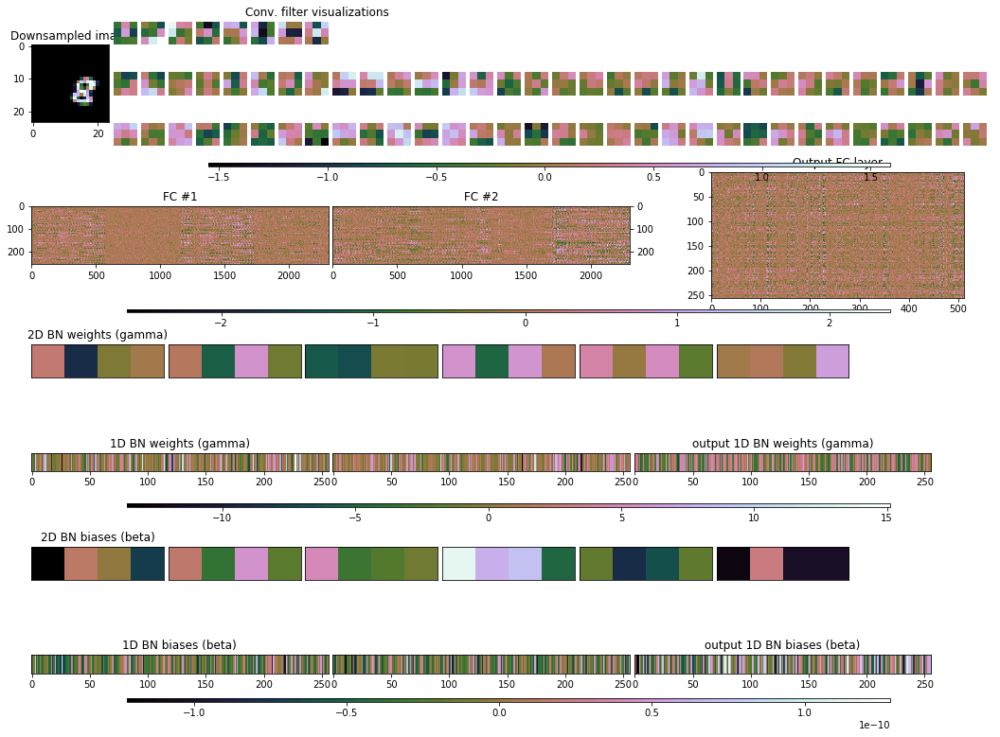


	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]
	                | Baseline rewards:   [0.111, 0.046, 0.089, 0.123, 0.146, 0.162]


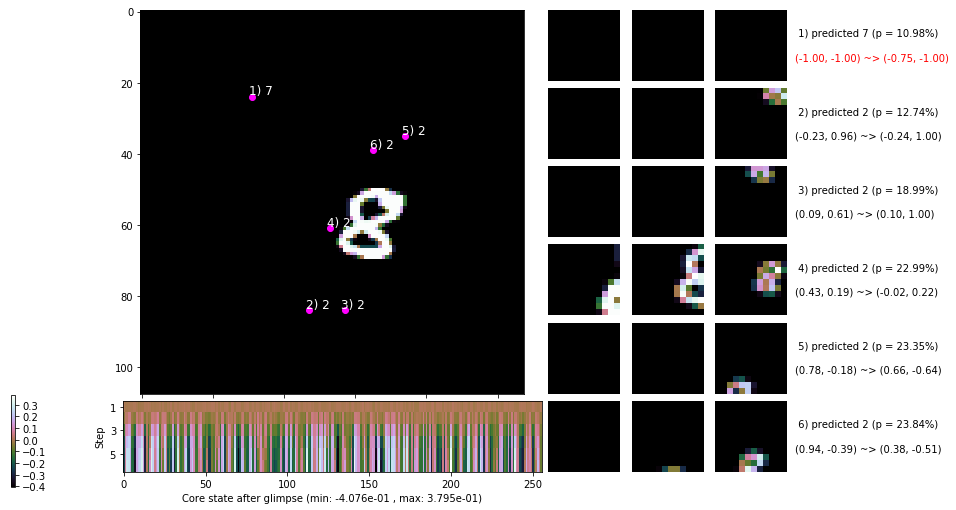

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 343.0 ms/b | lr: 8.65e-03 | grad 2norm:  4.95 | grad inf norm:  1.910
         Weights || abs max:  0.399 (65156.820) | mean:  4.855e-06 ( 0.113) | var: 1.389e-03 (1164118.000)
          Biases || abs max:  0.155 ( 3912.628) | mean:  9.627e-03 ( 3.011) | var: 4.371e-04 (209228.047)
                    class loss: 1.794 | steps: 4.584 | reward:  0.259 | acc.: 25.90%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 

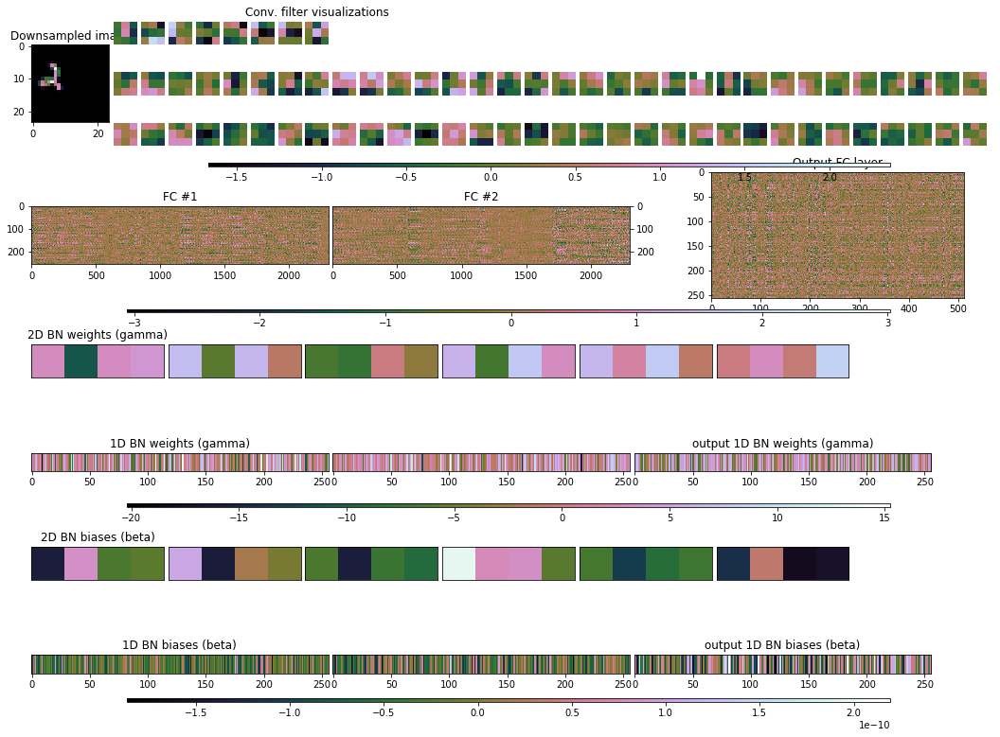


	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]
	                | Baseline rewards:   [0.184, 0.141, 0.153, 0.160, 0.154, 0.141]


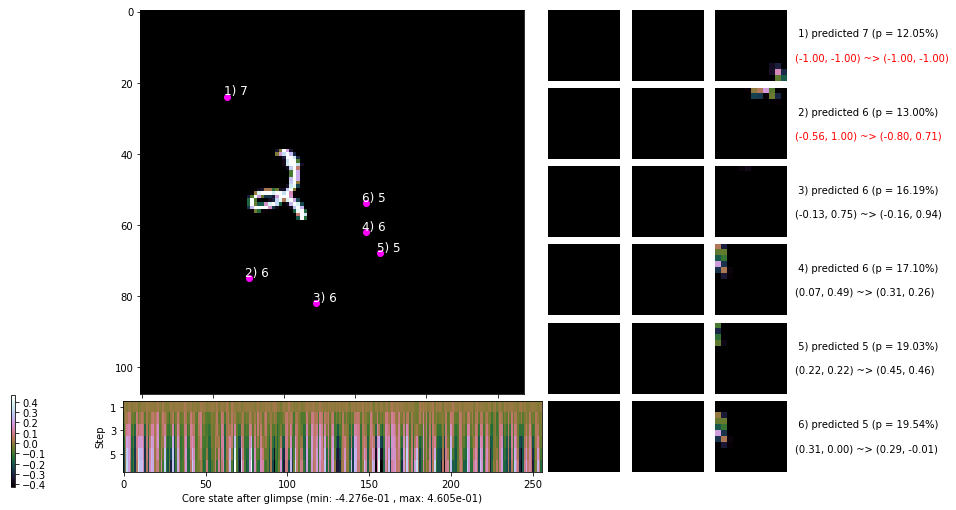

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


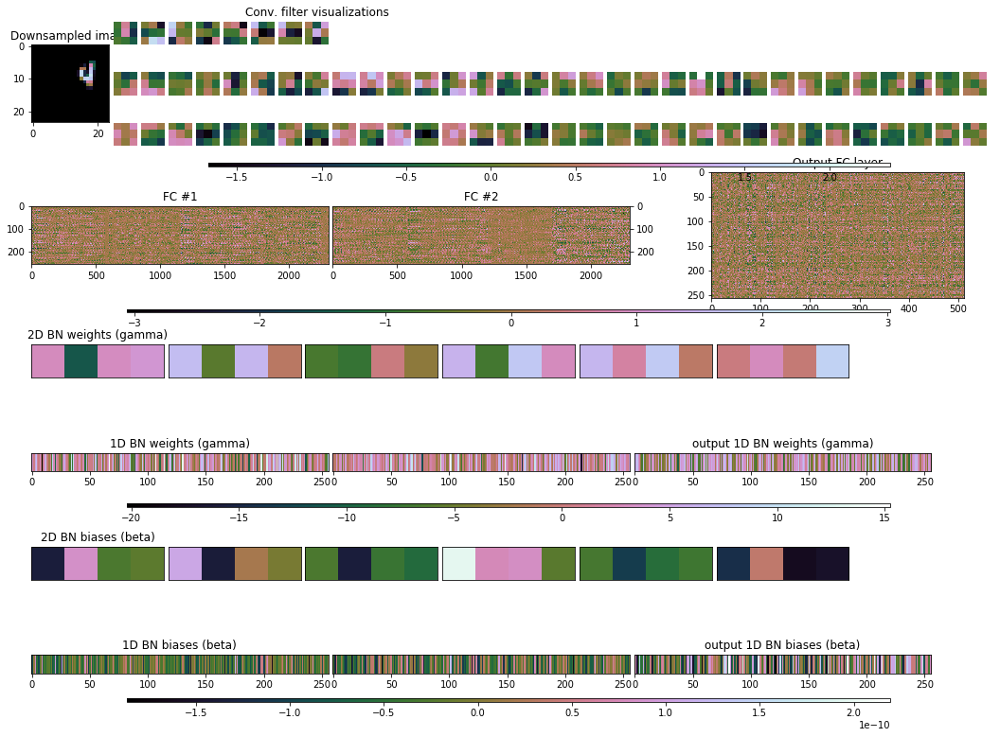


	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


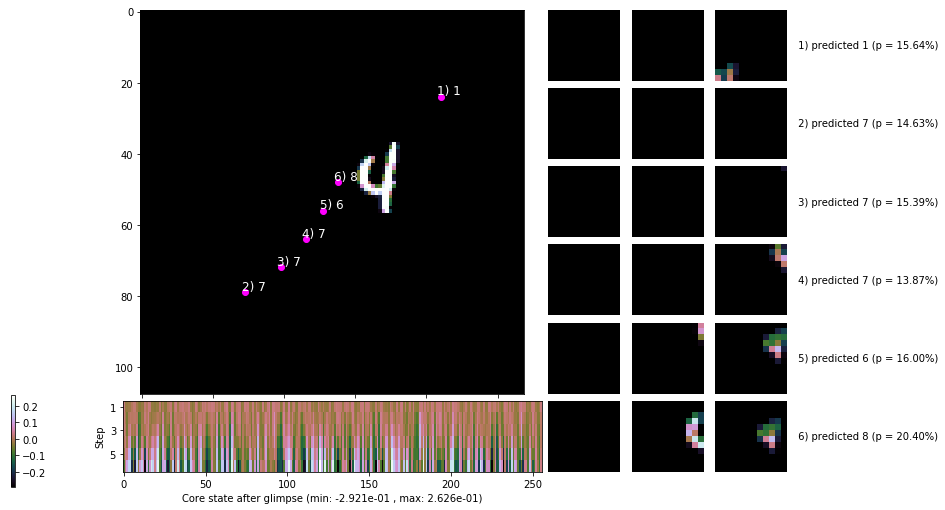

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


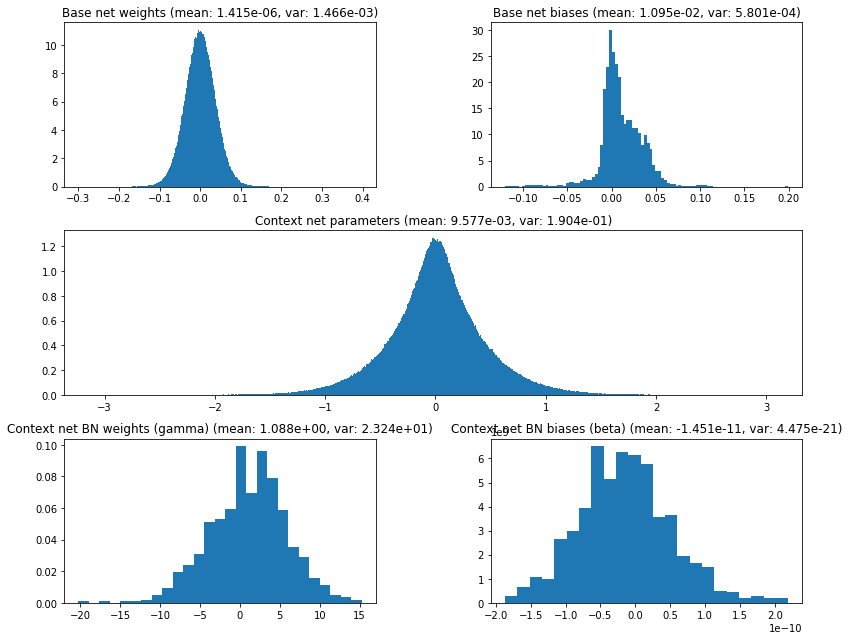

                                         Location network weights and biases


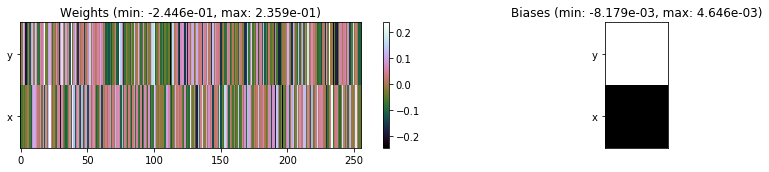

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1358.81 sec | TRAIN >> class loss: 1.9300 | steps:  4.704    | reward:  0.2361    | acc.: 23.608% 
                          | VAL   >> class loss: 3.1998 | steps:  4.564    | reward:  0.1182    | acc.: 11.820% 


Epoch   2/400) lr = 0.03143
 b   1000/  4000 >> 334.5 ms/b | lr: 7.82e-03 | grad 2norm:  5.72 | grad inf norm:  1.860
         Weights || abs max:  0.396 (154136.828) | mean:  1.345e-05 ( 0.193) | var: 1.495e-03 (10062988.000)
          Biases || abs max:  0.208 ( 6746.395) | mean:  1.131e-02 ( 3.806) | var: 6.228e-04 (4578411.000)
                    class loss: 1.551 | steps: 4.431 | reward:  0.352 | acc.: 35.17%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Siz

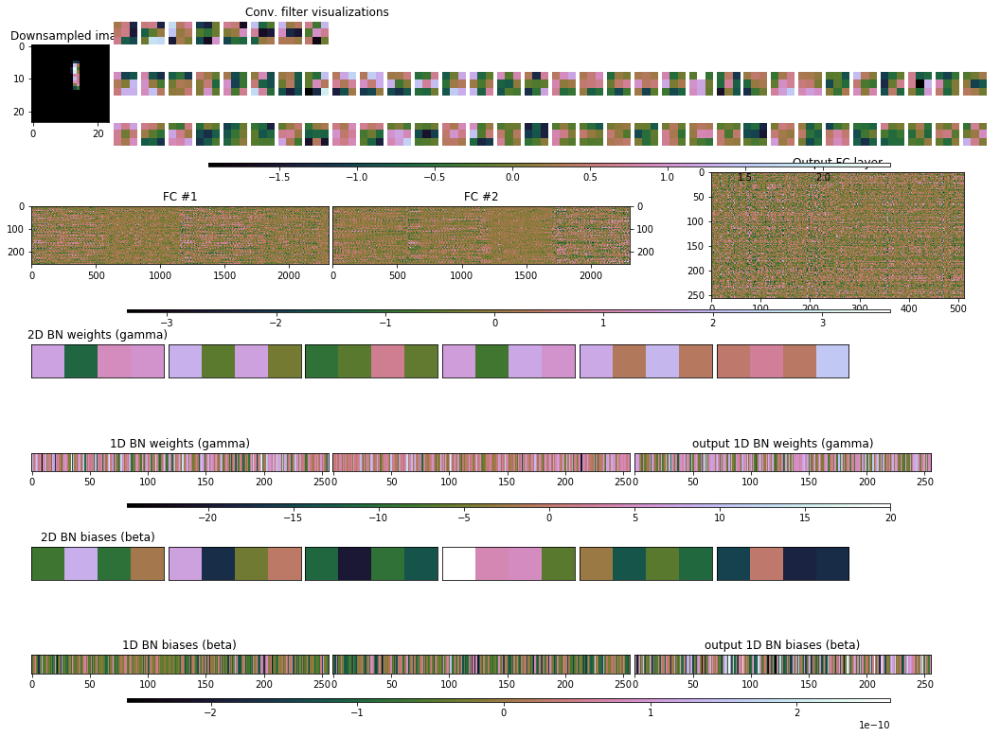


	Target class: 1 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.770, 0.827, 0.832, 0.861, 0.874, 0.875]


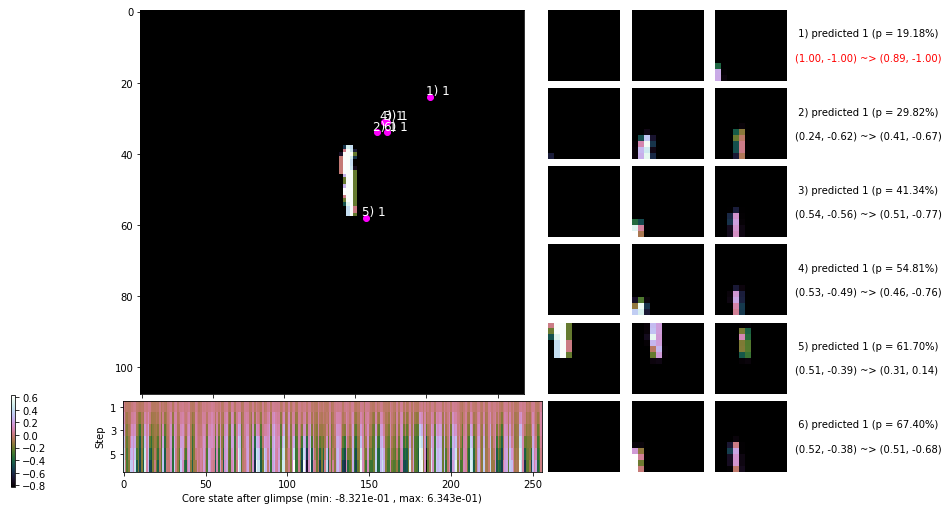

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 339.5 ms/b | lr: 7.08e-03 | grad 2norm:  7.38 | grad inf norm:  2.313
         Weights || abs max:  0.382 (48537.516) | mean:  6.364e-05 ( 0.104) | var: 1.606e-03 (149468.594)
          Biases || abs max:  0.263 (  996.250) | mean:  1.363e-02 ( 0.949) | var: 8.085e-04 (10864.088)
                    class loss: 1.293 | steps: 4.244 | reward:  0.493 | acc.: 49.32%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0,

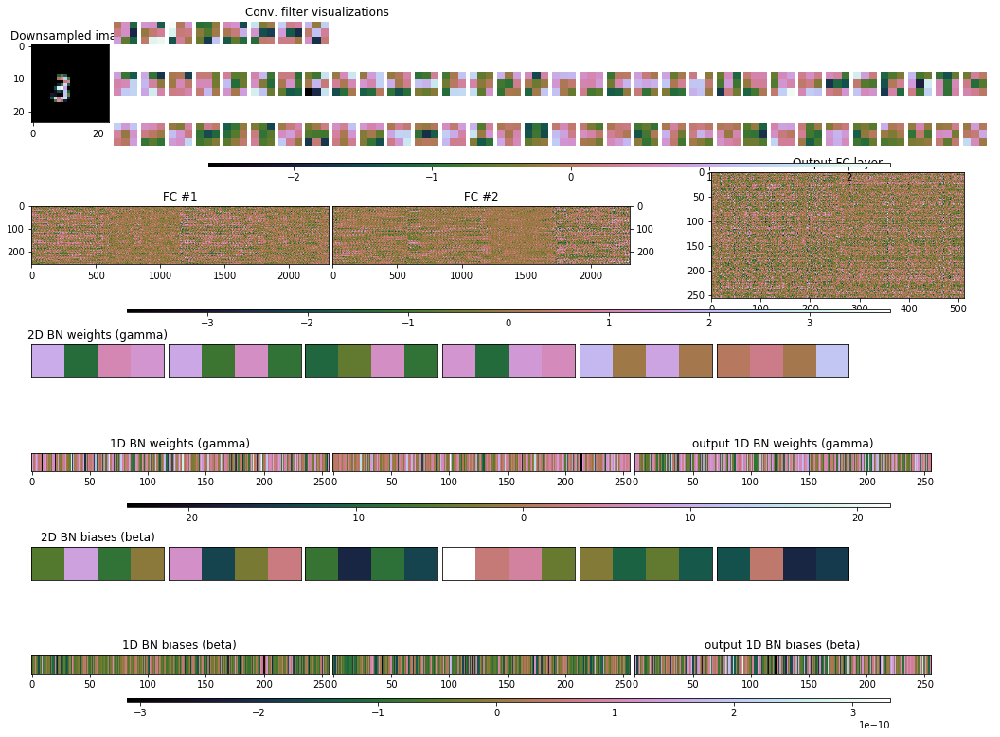


	Target class: 3 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.372, 0.326, 0.360, 0.374, 0.377, 0.379]


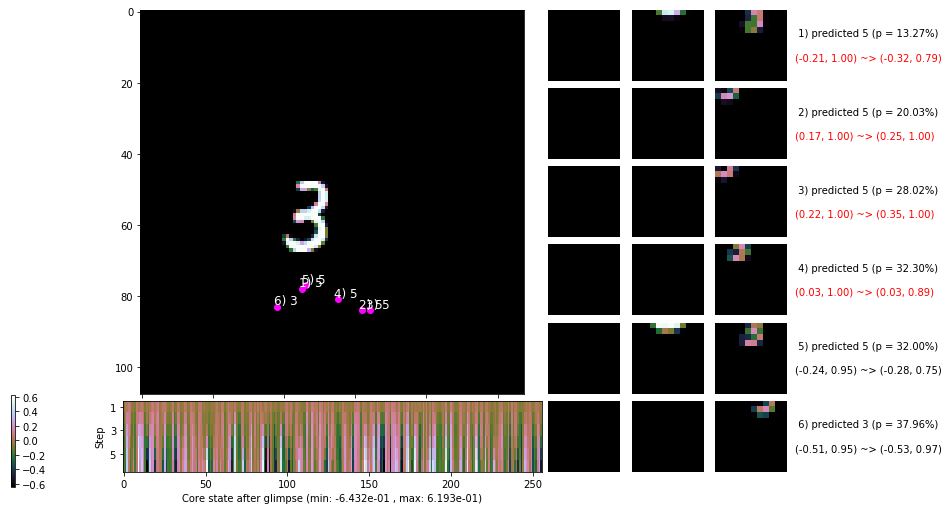

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


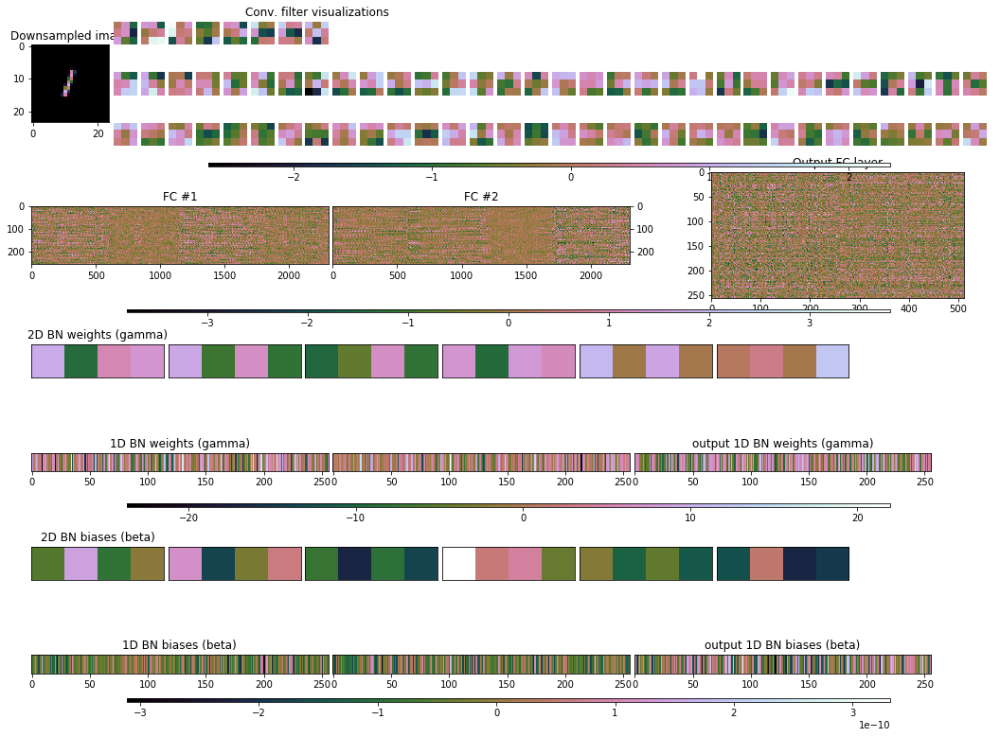


	Target class: 1 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


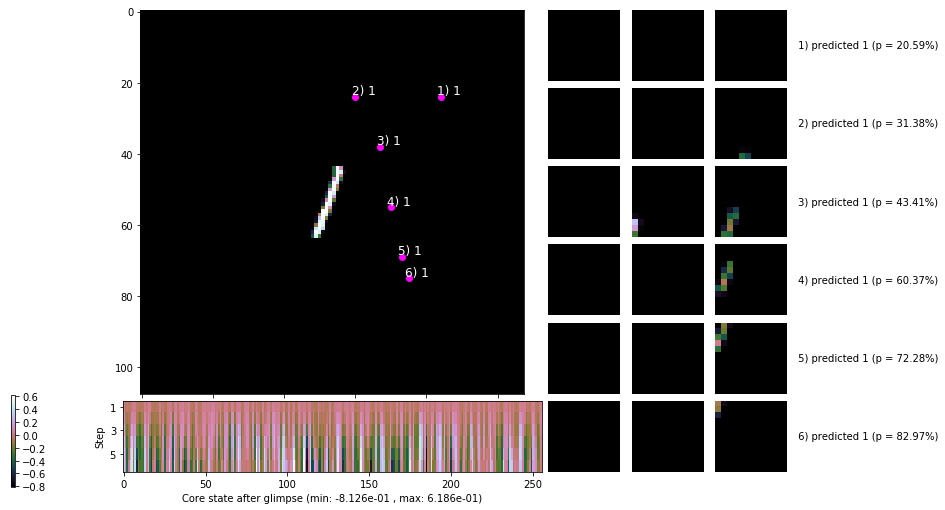

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


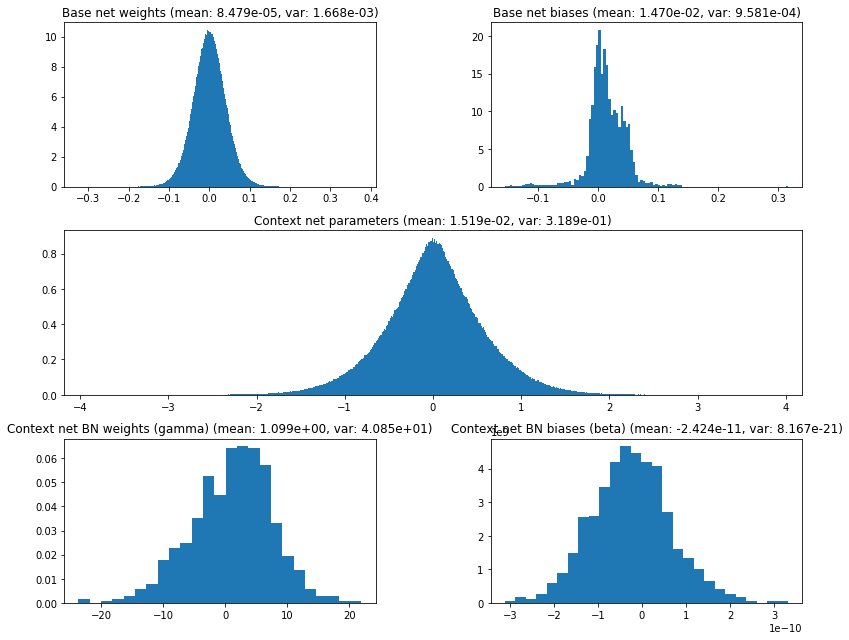

                                         Location network weights and biases


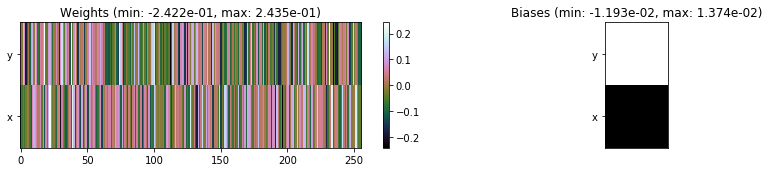

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1350.61 sec | TRAIN >> class loss: 1.3642 | steps:  4.294    | reward:  0.4543    | acc.: 45.429% 
                          | VAL   >> class loss: 1.6548 | steps:  4.146    | reward:  0.4690    | acc.: 46.900% 


Epoch   3/400) lr = 0.02572


H:\Users\Andrew\Anaconda3\envs\conda_jupyter\lib\site-packages\numpy\lib\nanfunctions.py:1315: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')


 b   1000/  4000 >> 333.9 ms/b | lr: 6.40e-03 | grad 2norm:  7.81 | grad inf norm:  2.171
         Weights || abs max:  0.376 (      inf) | mean:  9.047e-05 (   inf) | var: 1.691e-03 (      nan)
          Biases || abs max:  0.334 (  479.501) | mean:  1.527e-02 ( 0.544) | var: 1.014e-03 ( 1253.477)
                    class loss: 1.041 | steps: 4.293 | reward:  0.603 | acc.: 60.31%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 0), (torch.

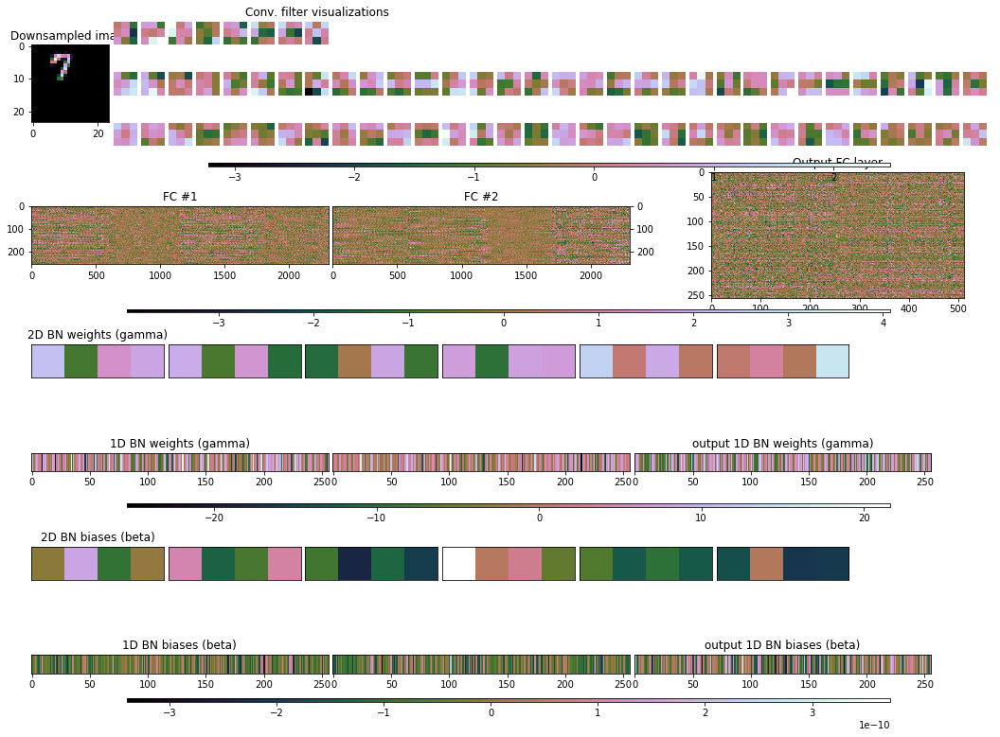


	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]
	                | Baseline rewards:   [0.465, 0.488, 0.508, 0.588, 0.696, 0.810]


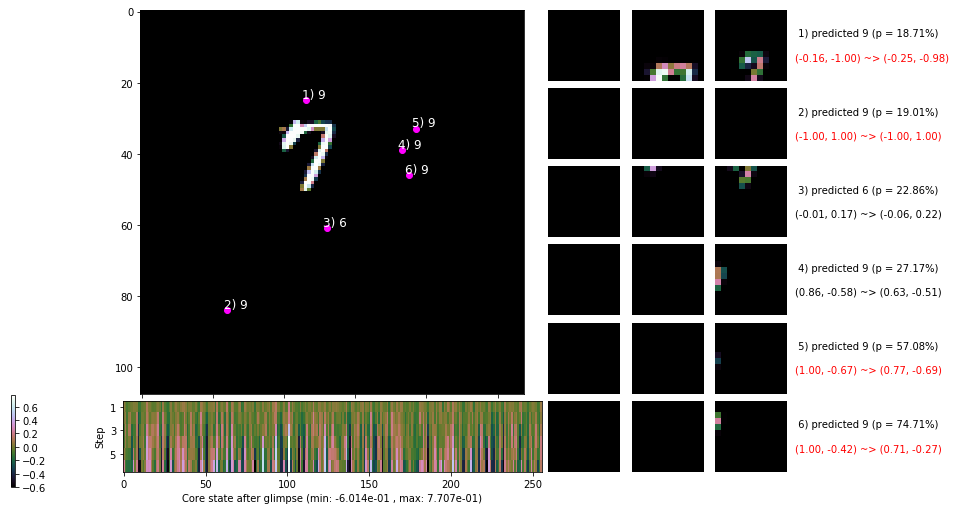

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 341.2 ms/b | lr: 5.79e-03 | grad 2norm:  7.84 | grad inf norm:  2.040
         Weights || abs max:  0.374 (1659351.000) | mean:  9.934e-05 ( 1.488) | var: 1.764e-03 (2265485568.000)
          Biases || abs max:  0.384 (  732.929) | mean:  1.650e-02 ( 0.592) | var: 1.188e-03 ( 7913.140)
                    class loss: 0.875 | steps: 4.235 | reward:  0.680 | acc.: 67.99%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256

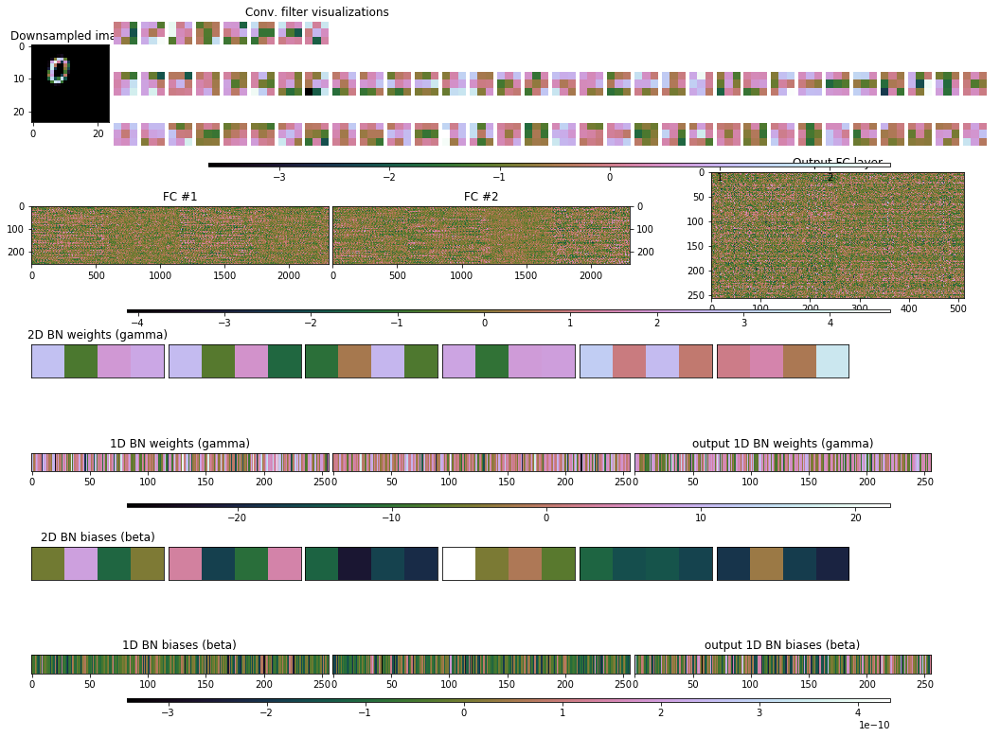


	Target class: 0 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.617, 0.568, 0.564, 0.586, 0.572, 0.516]


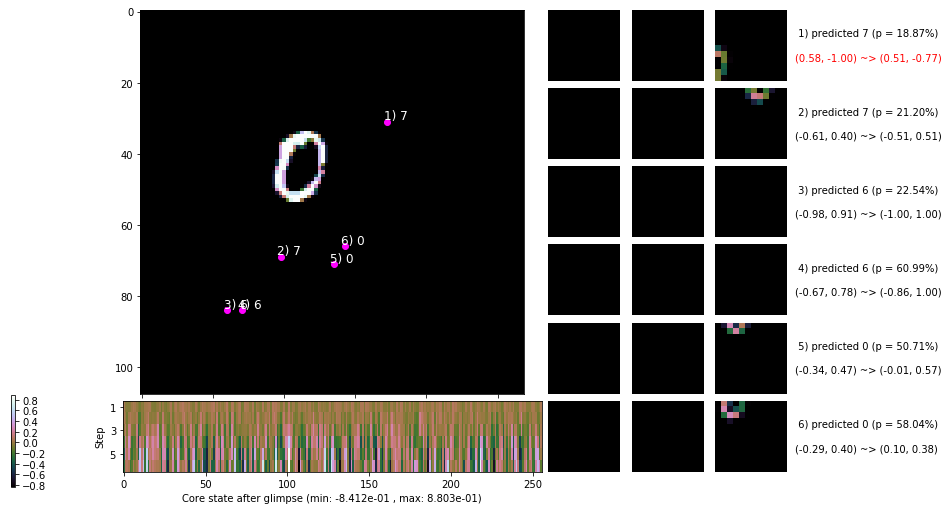

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


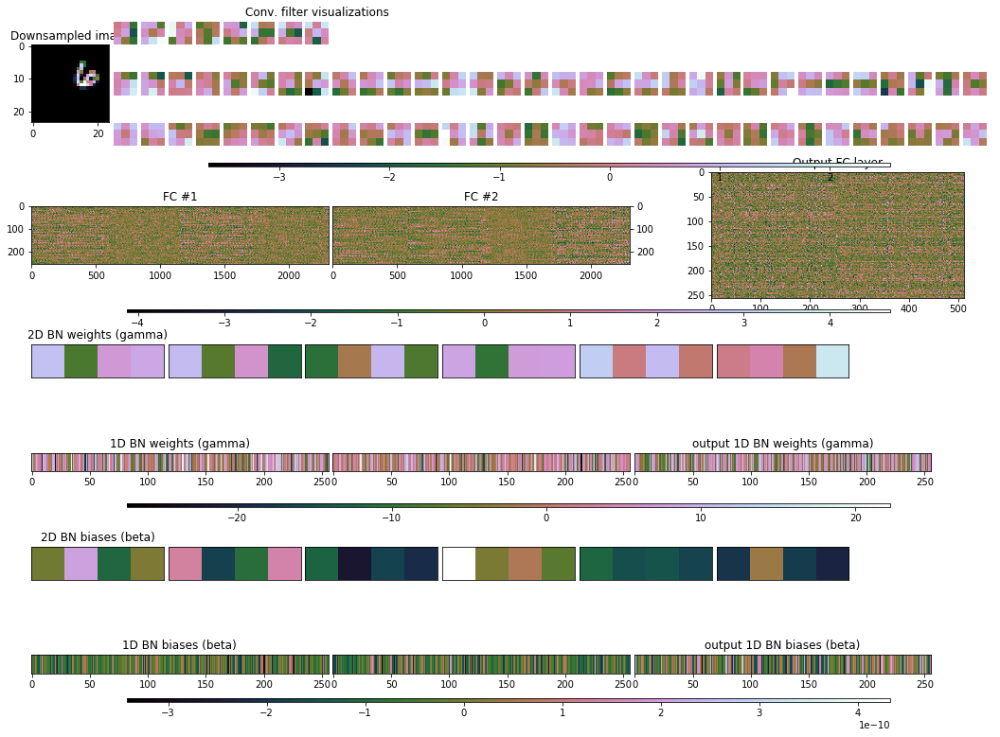


	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


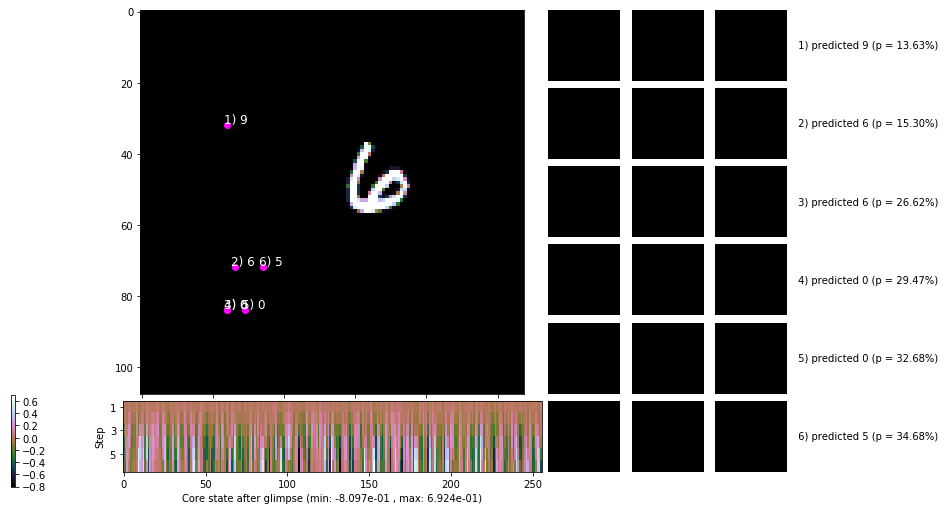

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


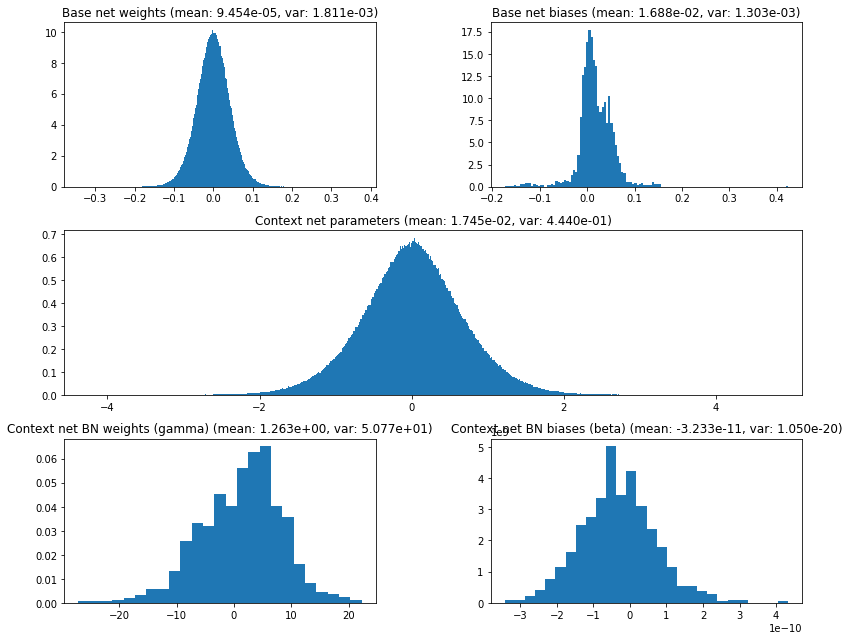

                                         Location network weights and biases


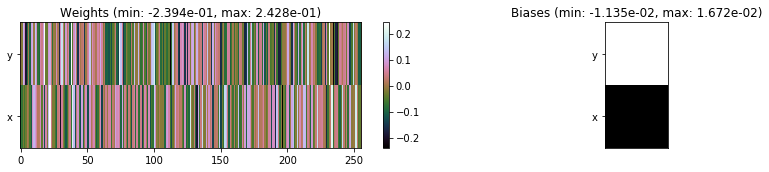

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1351.95 sec | TRAIN >> class loss: 0.9214 | steps:  4.250    | reward:  0.6579    | acc.: 65.793% 
                          | VAL   >> class loss: 2.7991 | steps:  4.827 :( | reward:  0.2228 :( | acc.: 22.280% :(


Epoch   4/400) lr = 0.02104
 b   1000/  4000 >> 338.4 ms/b | lr: 5.24e-03 | grad 2norm:  7.87 | grad inf norm:  2.069
         Weights || abs max:  0.376 (126156.883) | mean:  9.820e-05 ( 0.173) | var: 1.828e-03 (3160627.500)
          Biases || abs max:  0.436 (  920.609) | mean:  1.712e-02 ( 0.779) | var: 1.339e-03 ( 8891.225)
                    class loss: 0.765 | steps: 4.162 | reward:  0.724 | acc.: 72.42%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size

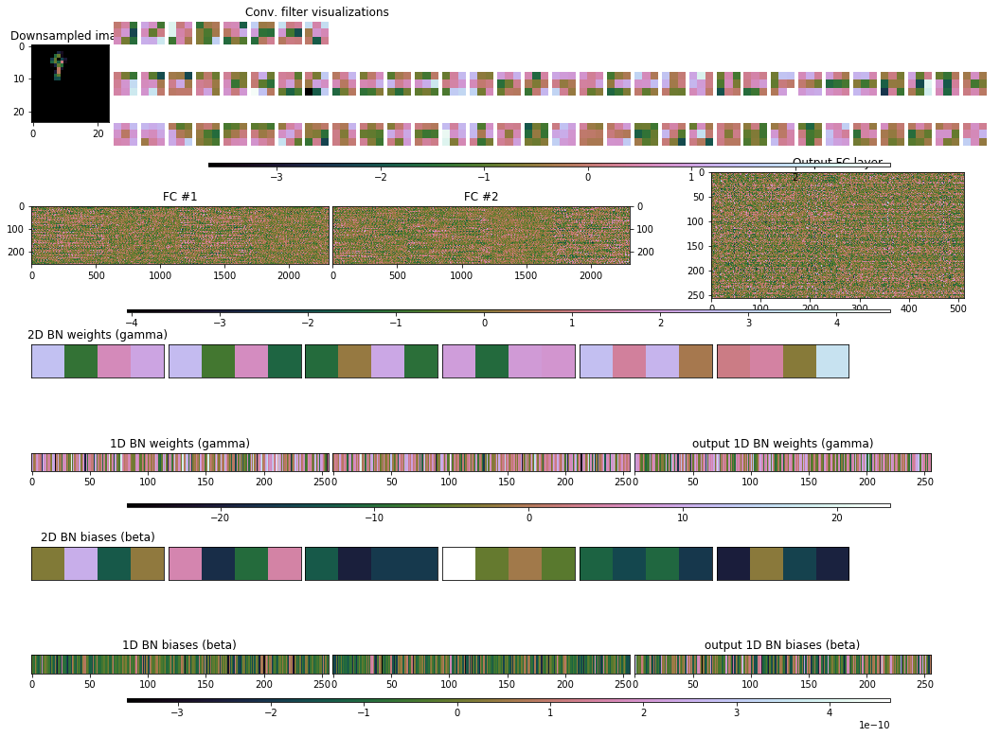


	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]
	                | Baseline rewards:   [0.853, 0.695, 0.630, 0.654, 0.684, 0.702]


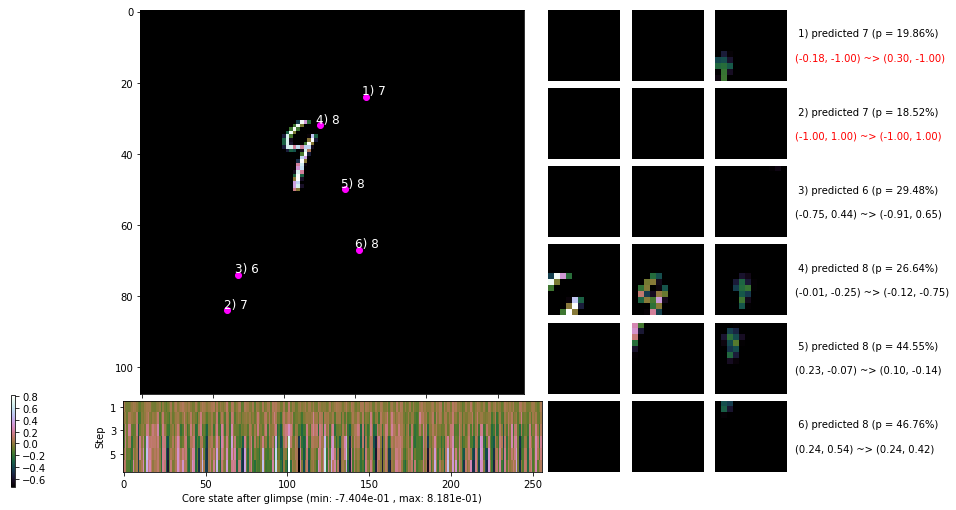

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 342.0 ms/b | lr: 4.74e-03 | grad 2norm:  7.89 | grad inf norm:  1.930
         Weights || abs max:  0.378 (42373.086) | mean:  9.252e-05 ( 0.100) | var: 1.874e-03 (40566.188)
          Biases || abs max:  0.487 (  938.529) | mean:  1.773e-02 ( 0.781) | var: 1.433e-03 (25749.307)
                    class loss: 0.671 | steps: 4.109 | reward:  0.779 | acc.: 77.89%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

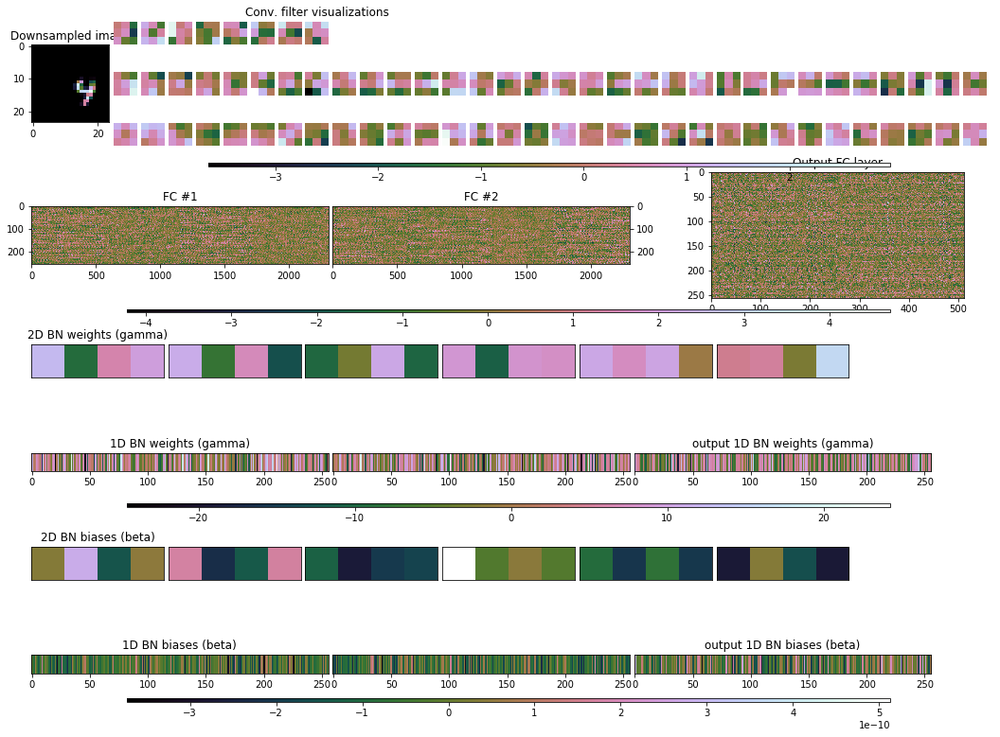


	Target class: 4 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.068, 0.995, 1.002, 1.007, 0.990, 0.930]


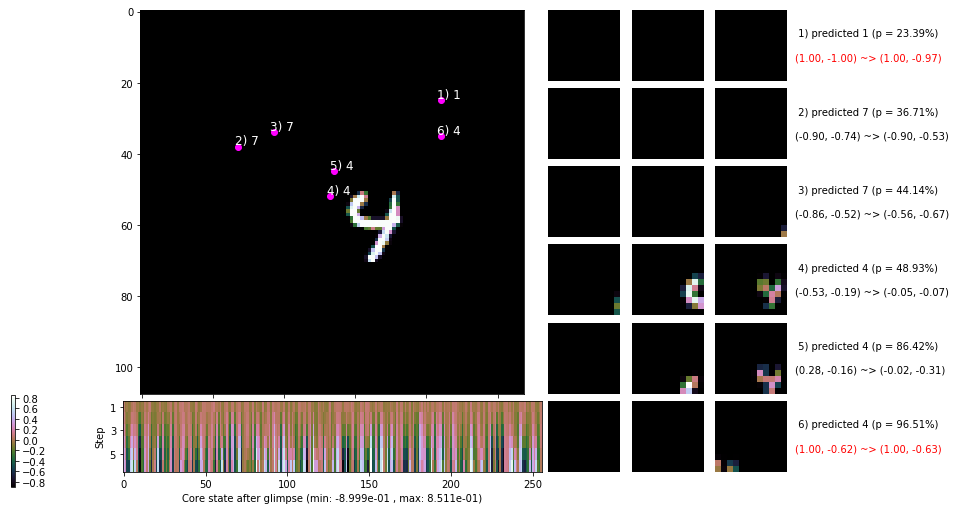

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


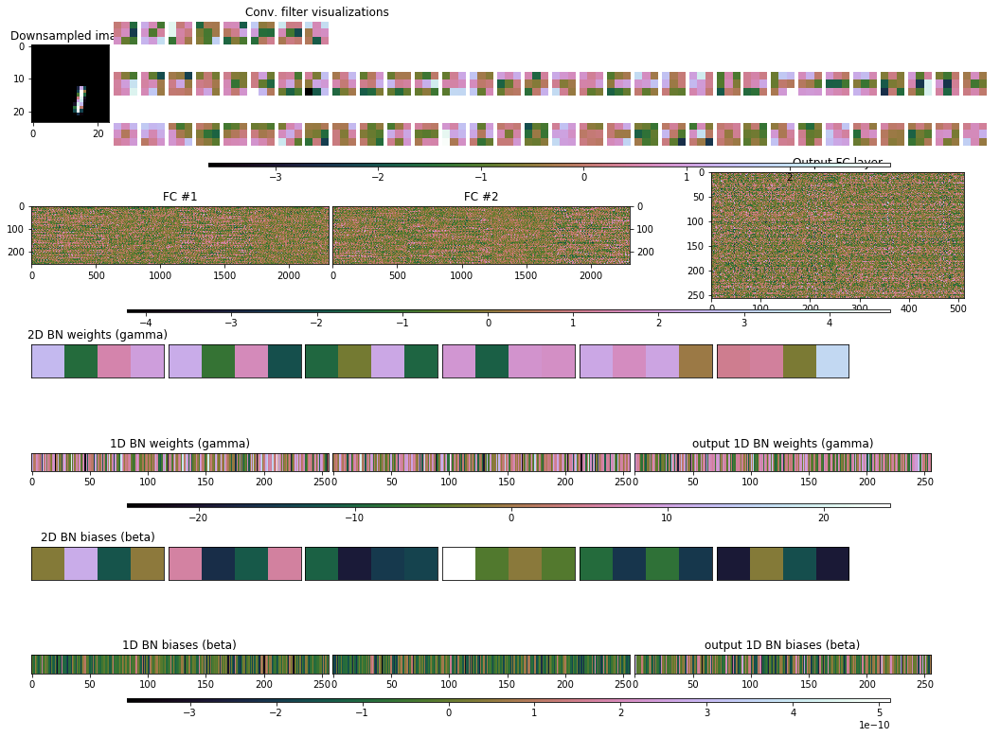


	Target class: 1 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


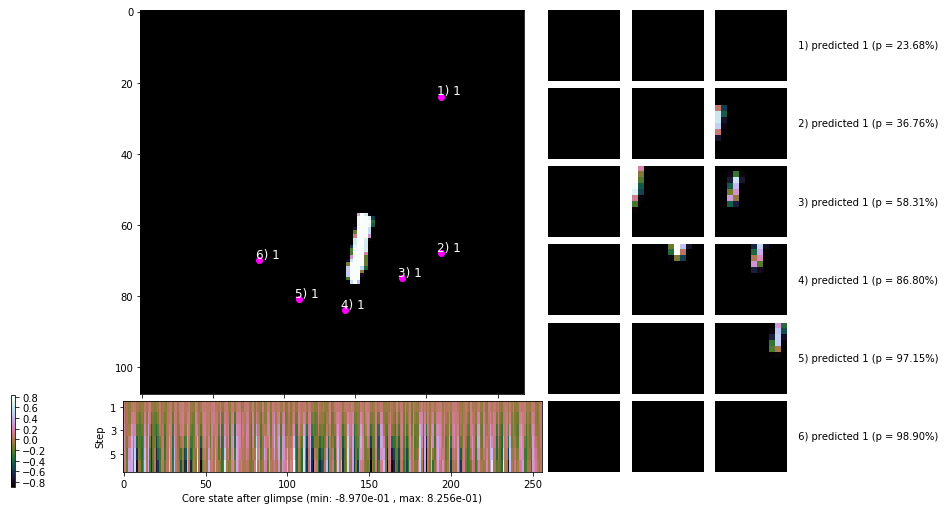

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


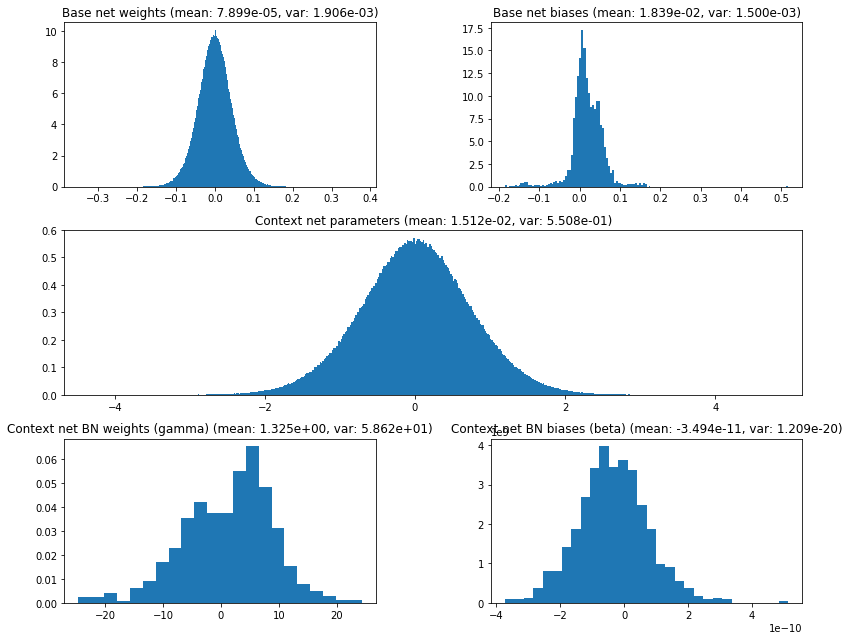

                                         Location network weights and biases


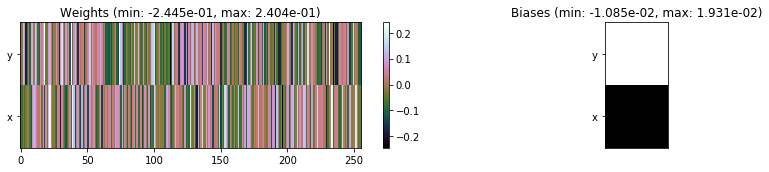

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1355.83 sec | TRAIN >> class loss: 0.6923 | steps:  4.118    | reward:  0.7665    | acc.: 76.646% 
                          | VAL   >> class loss: 0.4450 | steps:  3.888    | reward:  0.8642    | acc.: 86.420% 


Epoch   5/400) lr = 0.01722
 b   1000/  4000 >> 337.8 ms/b | lr: 4.29e-03 | grad 2norm:  7.97 | grad inf norm:  1.890
         Weights || abs max:  0.378 (38526.039) | mean:  7.655e-05 ( 0.096) | var: 1.915e-03 (43904.121)
          Biases || abs max:  0.528 (  642.162) | mean:  1.858e-02 ( 0.531) | var: 1.520e-03 ( 4895.993)
                    class loss: 0.580 | steps: 4.054 | reward:  0.828 | acc.: 82.75%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4])

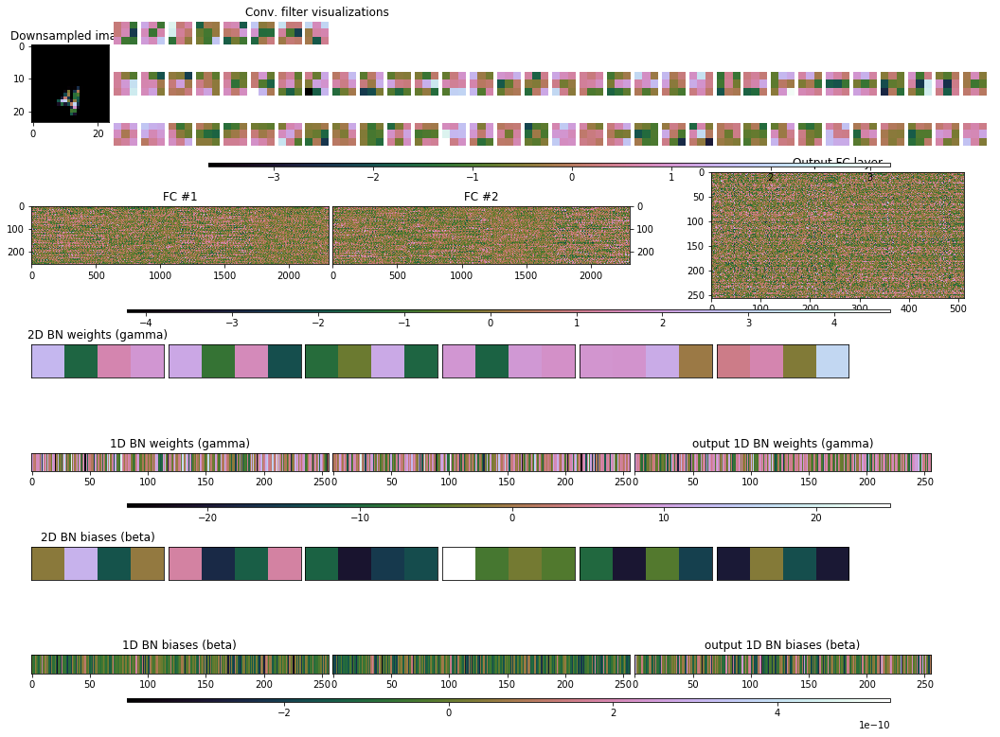


	Target class: 4 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.861, 0.922, 0.932, 0.964, 0.975, 0.988]


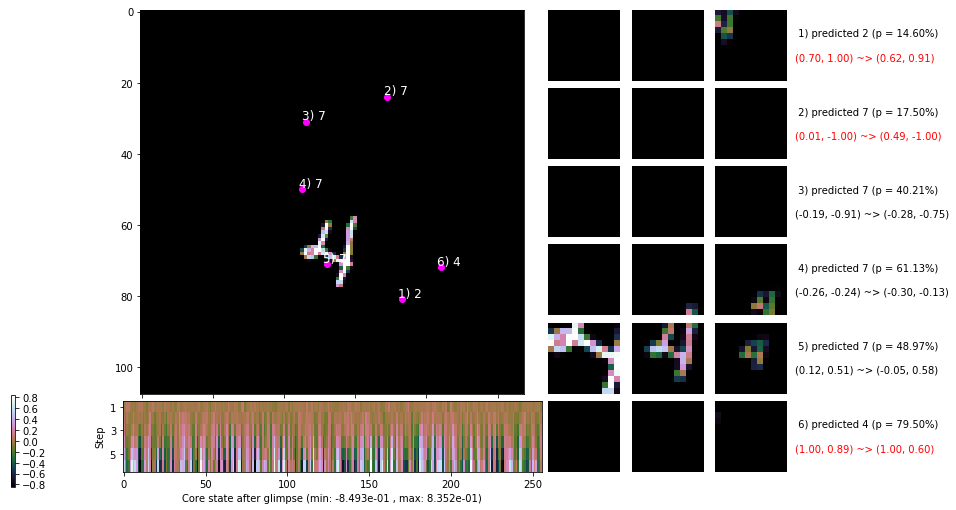

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 343.3 ms/b | lr: 3.88e-03 | grad 2norm:  7.85 | grad inf norm:  1.637
         Weights || abs max:  0.378 (199883.891) | mean:  5.757e-05 ( 0.235) | var: 1.955e-03 (15741020.000)
          Biases || abs max:  0.559 ( 1289.505) | mean:  1.928e-02 ( 0.867) | var: 1.615e-03 (122607.656)
                    class loss: 0.507 | steps: 4.029 | reward:  0.858 | acc.: 85.79%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256])

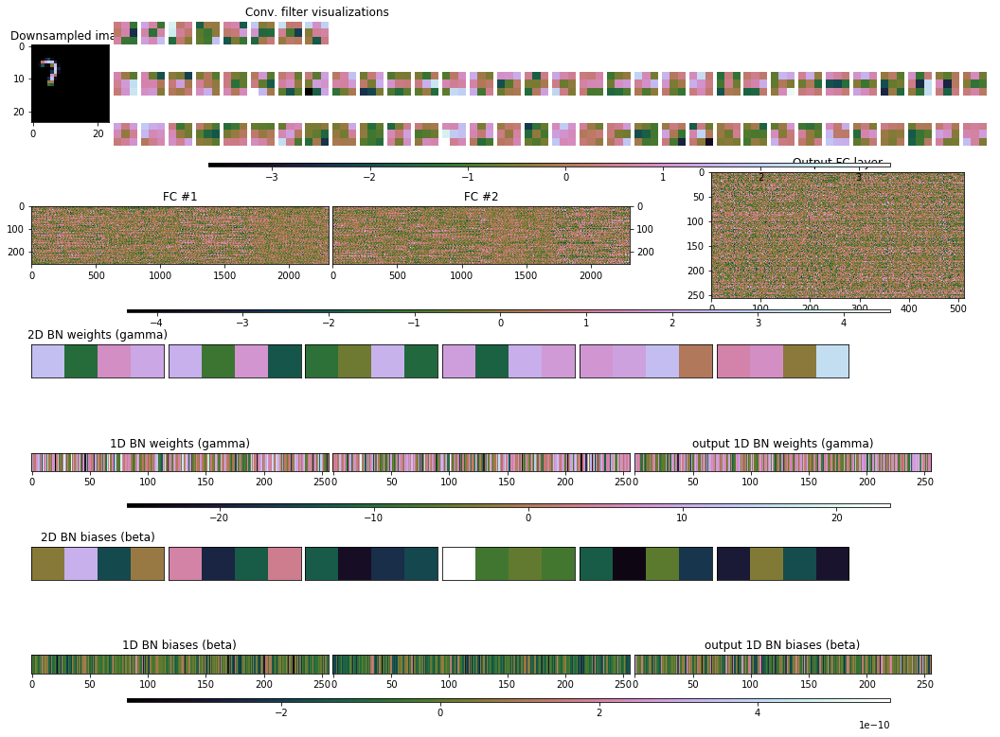


	Target class: 7 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.833, 0.784, 0.839, 0.909, 0.972, 1.020]


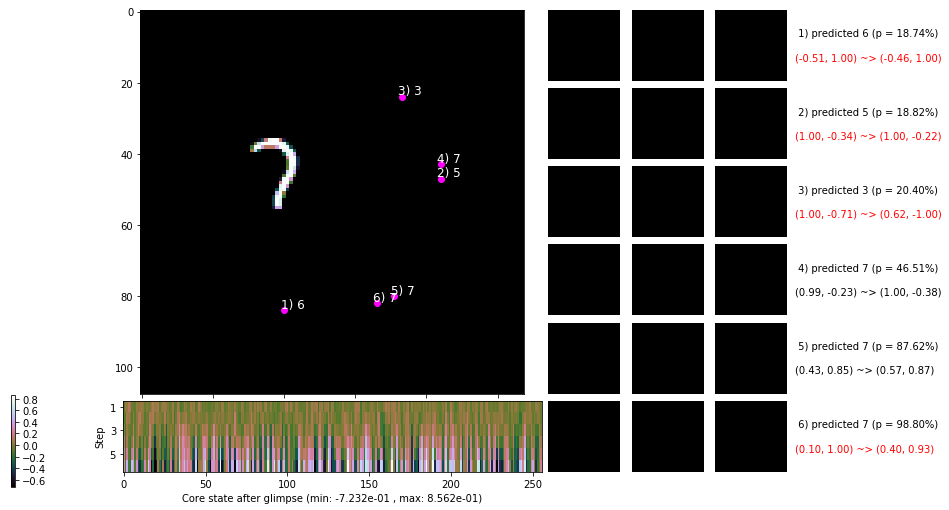

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


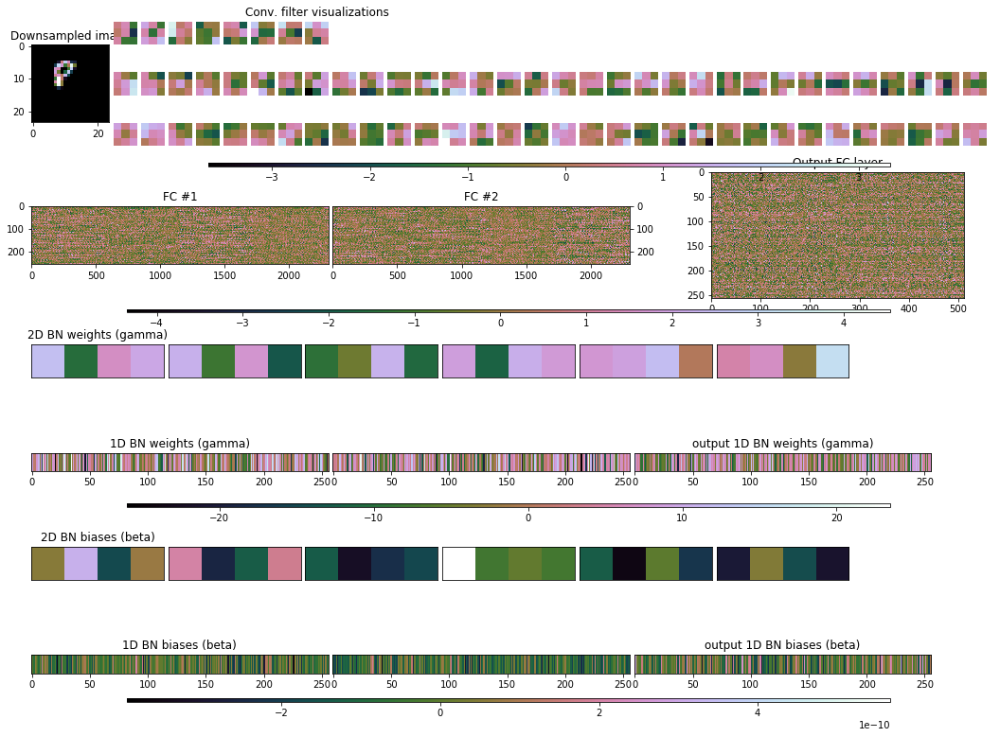


	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


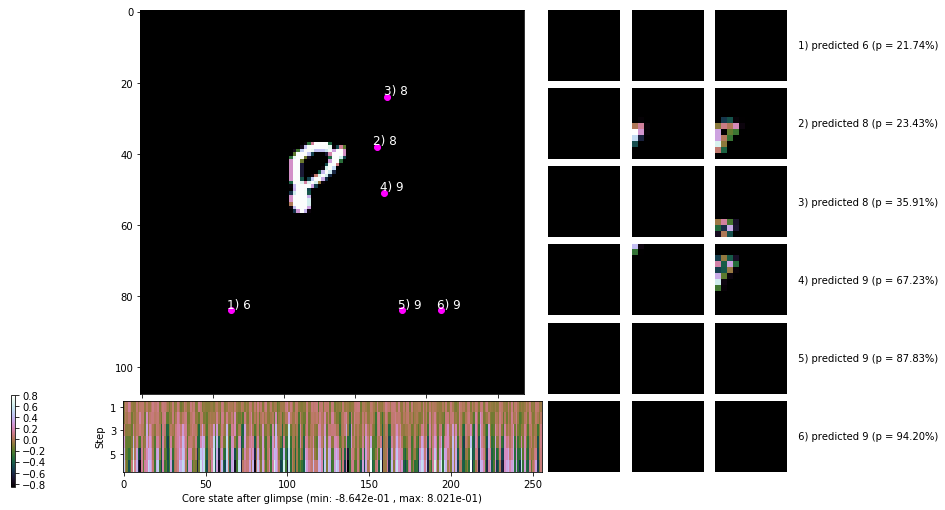

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


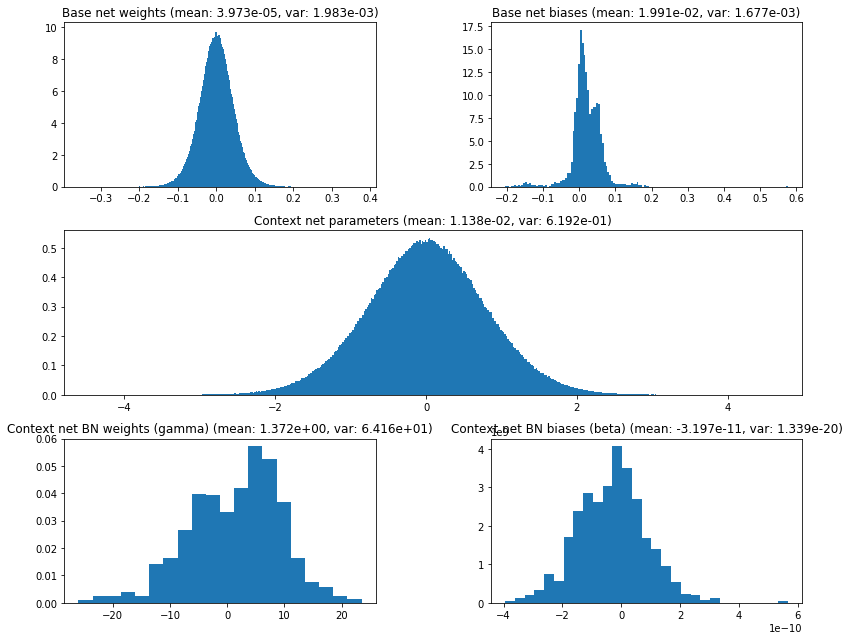

                                         Location network weights and biases


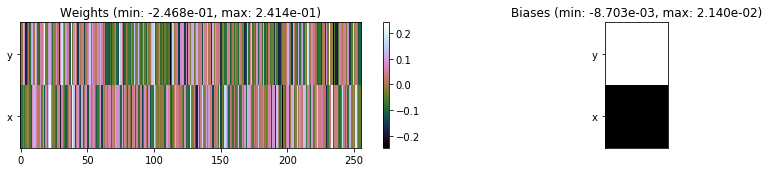

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1361.66 sec | TRAIN >> class loss: 0.5235 | steps:  4.044    | reward:  0.8494    | acc.: 84.939% 
                          | VAL   >> class loss: 1.3979 | steps:  3.840    | reward:  0.5952 :( | acc.: 59.520% :(


Epoch   6/400) lr = 0.01409
 b   1000/  4000 >> 336.5 ms/b | lr: 3.51e-03 | grad 2norm:  7.73 | grad inf norm:  1.551
         Weights || abs max:  0.377 (30924.797) | mean:  4.181e-05 ( 0.088) | var: 1.989e-03 (45207.910)
          Biases || abs max:  0.583 ( 1170.981) | mean:  2.006e-02 ( 0.712) | var: 1.696e-03 (49111.805)
                    class loss: 0.452 | steps: 4.074 | reward:  0.876 | acc.: 87.57%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4

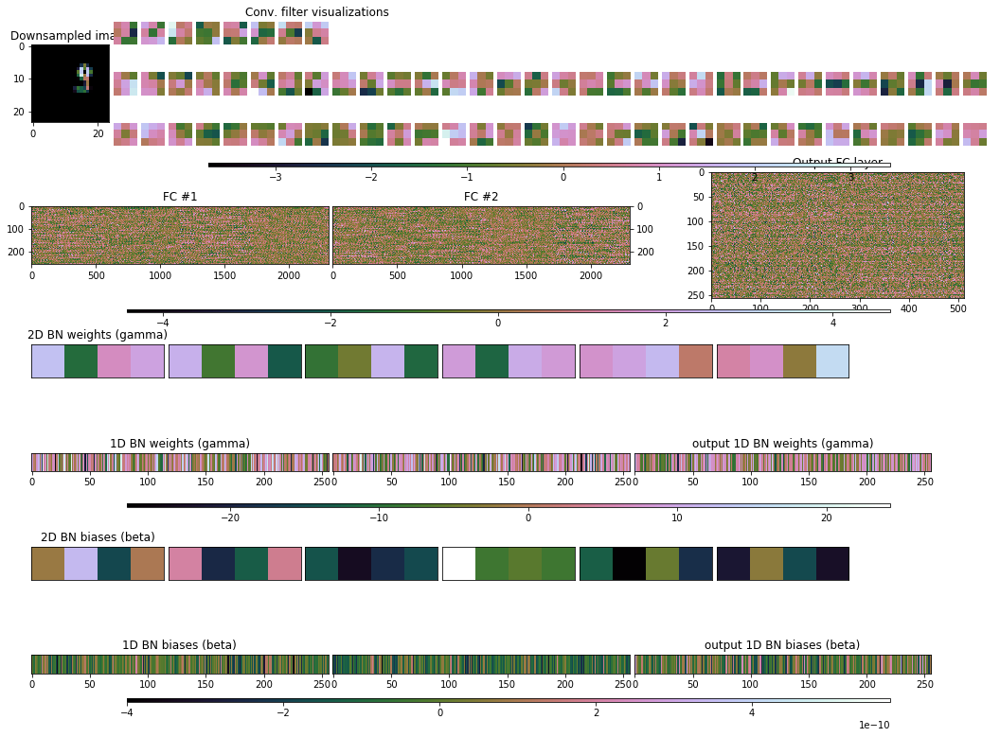


	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]
	                | Baseline rewards:   [0.696, 0.599, 0.652, 0.696, 0.747, 0.809]


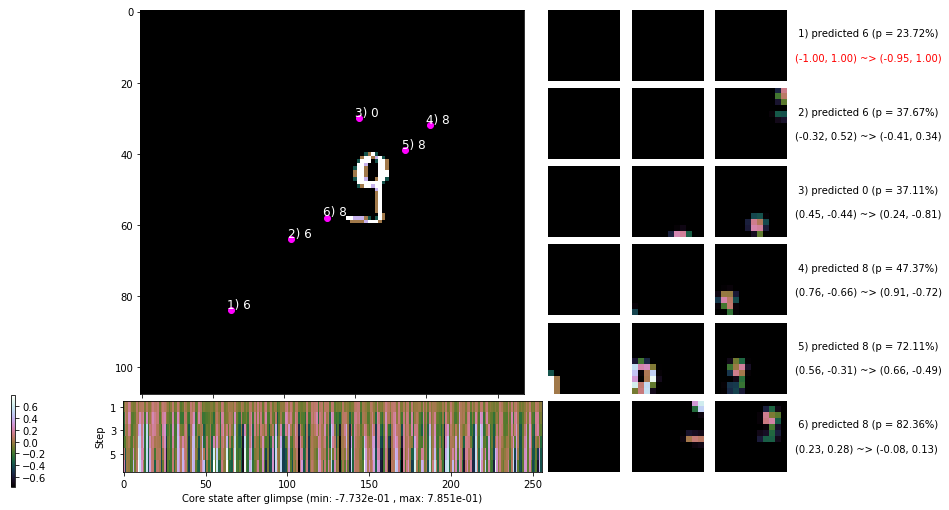

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 339.8 ms/b | lr: 3.17e-03 | grad 2norm:  7.82 | grad inf norm:  1.482
         Weights || abs max:  0.376 (53619.254) | mean:  4.666e-05 ( 0.105) | var: 2.010e-03 (461514.625)
          Biases || abs max:  0.605 ( 1184.284) | mean:  2.045e-02 ( 0.808) | var: 1.767e-03 (102557.562)
                    class loss: 0.416 | steps: 4.045 | reward:  0.887 | acc.: 88.71%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0

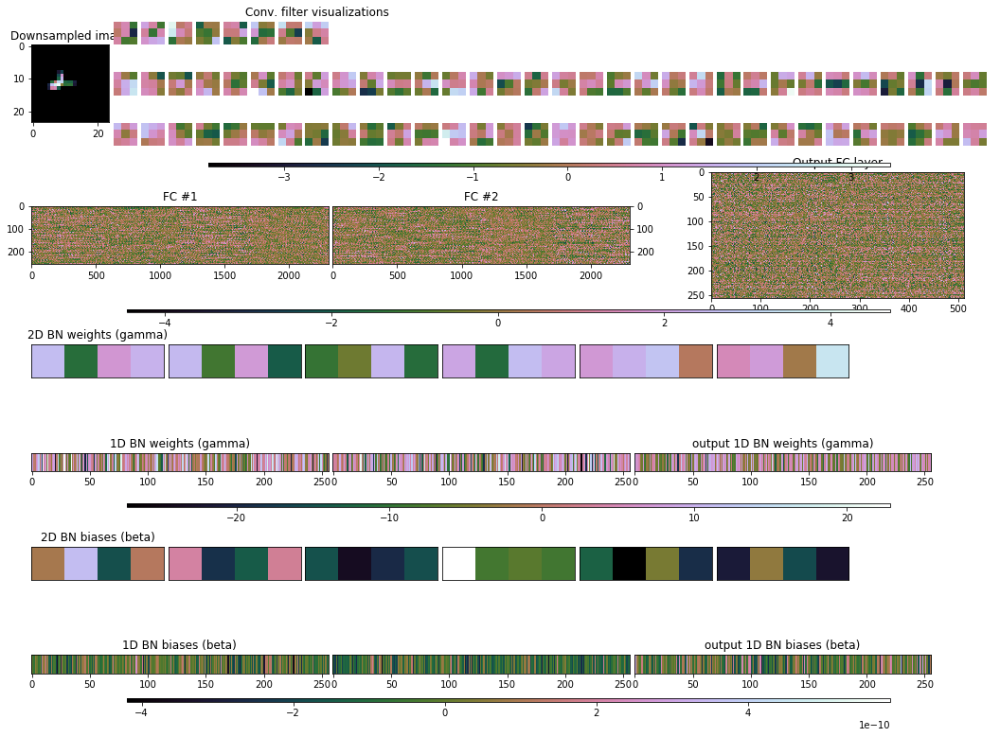


	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]
	                | Baseline rewards:   [0.891, 0.818, 0.805, 0.801, 0.790, 0.743]


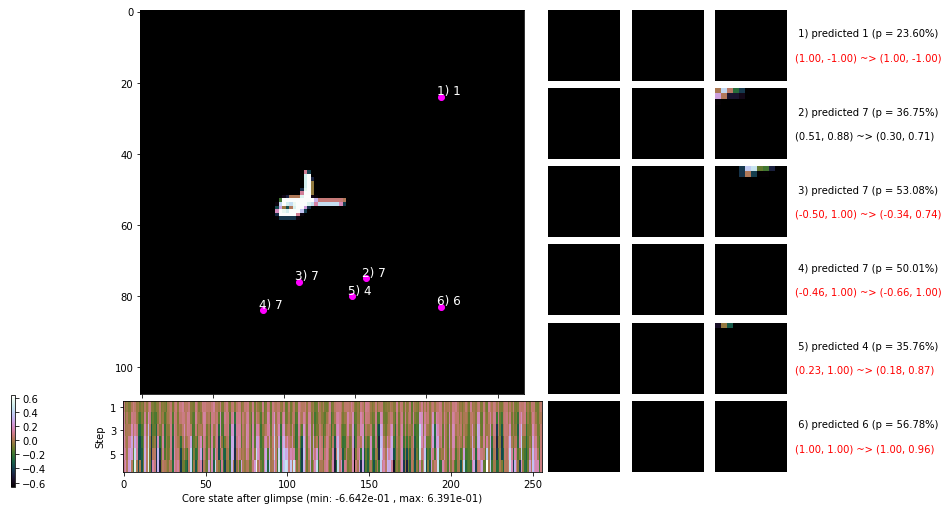

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


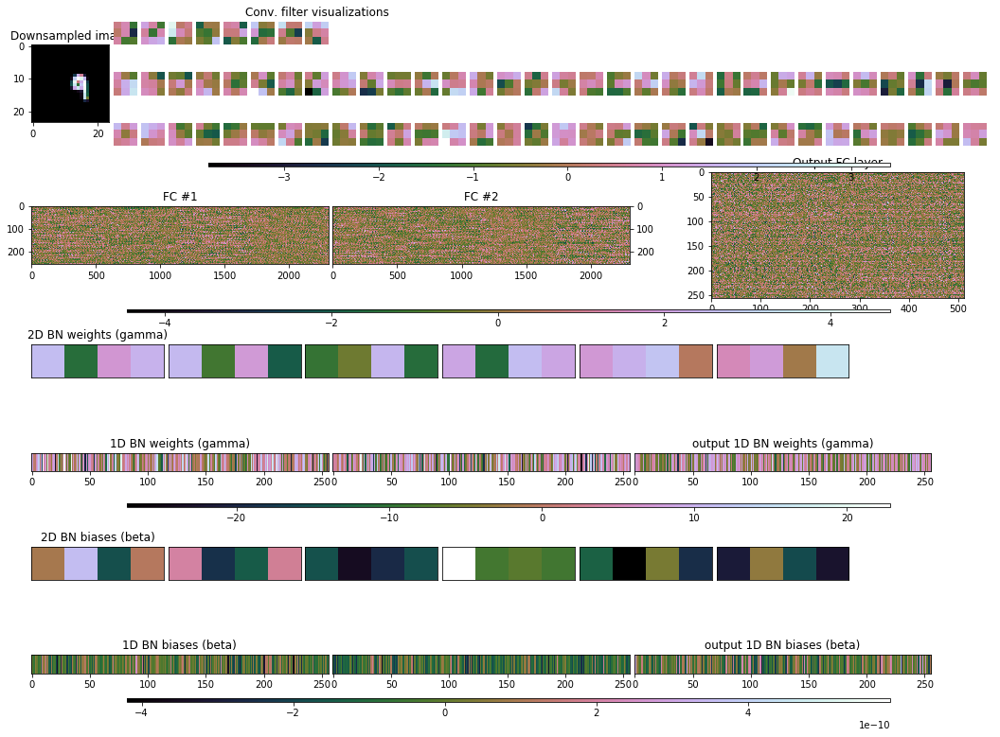


	Target class: 9 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


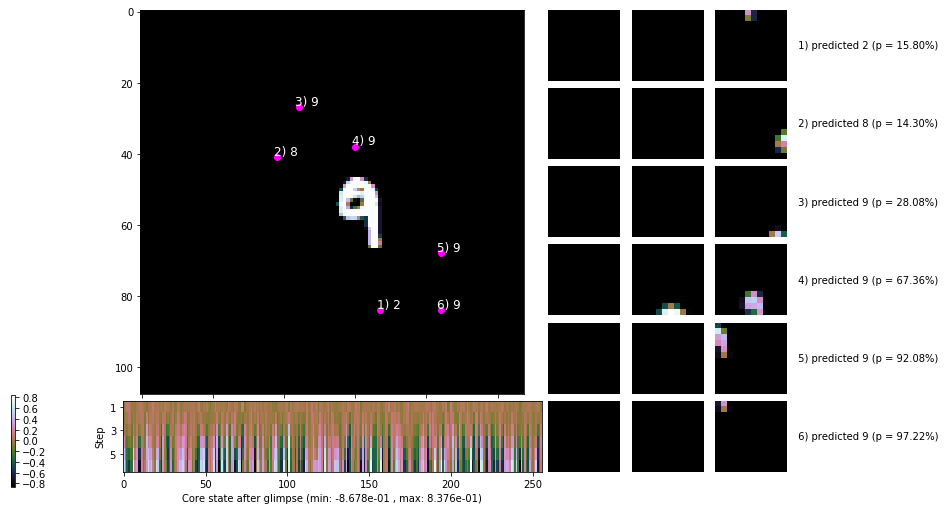

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


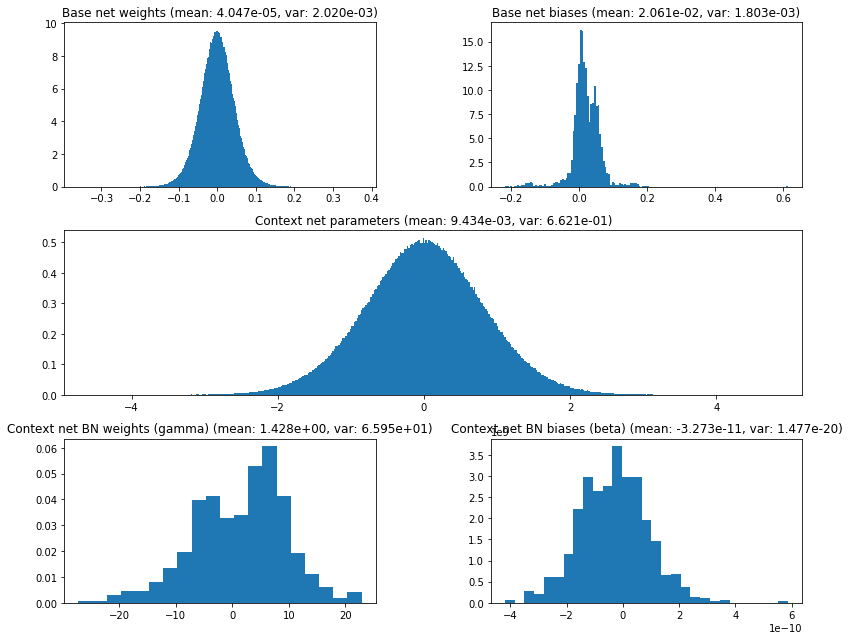

                                         Location network weights and biases


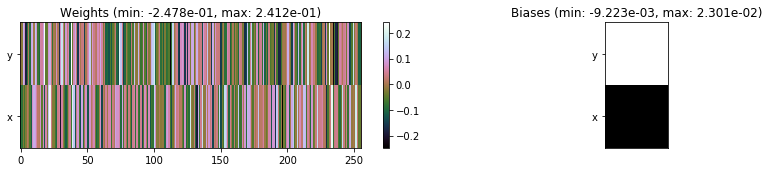

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1355.15 sec | TRAIN >> class loss: 0.4265 | steps:  4.060 :( | reward:  0.8839    | acc.: 88.393% 
                          | VAL   >> class loss: 0.3085 | steps:  3.837    | reward:  0.9124    | acc.: 91.240% 


Epoch   7/400) lr = 0.01153
 b   1000/  4000 >> 337.7 ms/b | lr: 2.87e-03 | grad 2norm:  7.73 | grad inf norm:  1.442
         Weights || abs max:  0.374 (51779.992) | mean:  4.171e-05 ( 0.104) | var: 2.023e-03 (238664.438)
          Biases || abs max:  0.620 (  811.977) | mean:  2.066e-02 ( 0.660) | var: 1.816e-03 (16478.281)
                    class loss: 0.391 | steps: 4.009 | reward:  0.897 | acc.: 89.66%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]

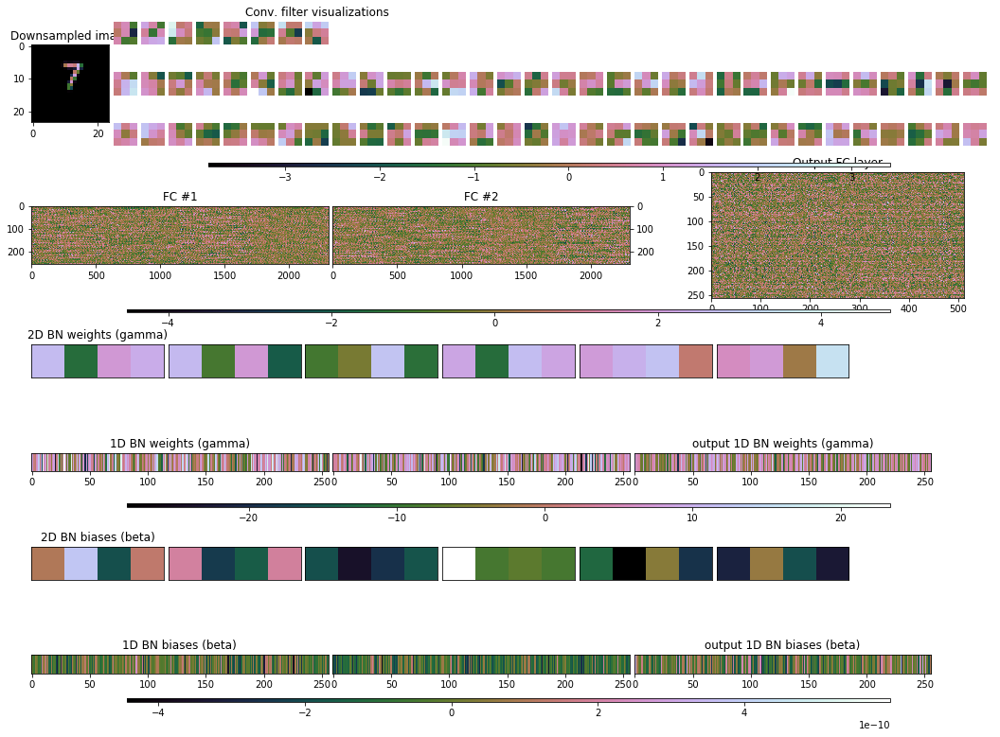


	Target class: 7 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.895, 0.837, 0.879, 0.911, 0.952, 1.025]


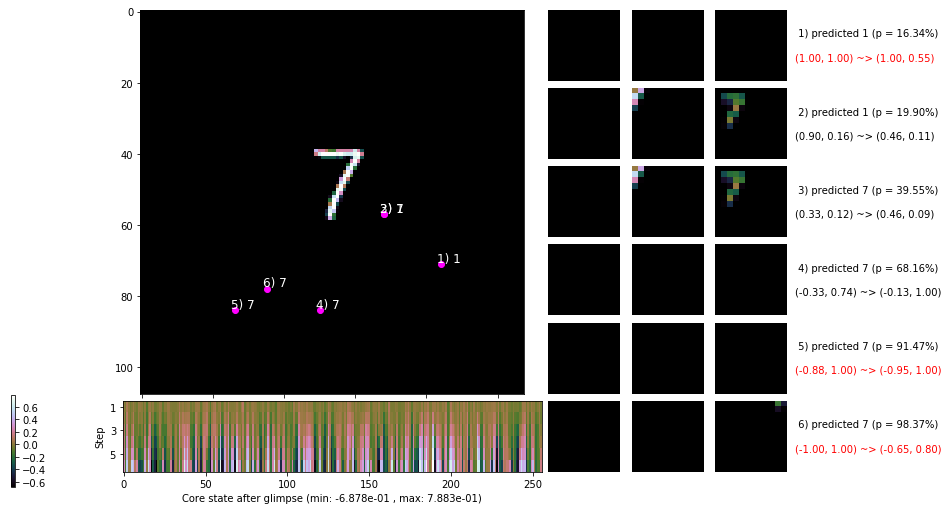

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 354.8 ms/b | lr: 2.60e-03 | grad 2norm:  7.95 | grad inf norm:  1.487
         Weights || abs max:  0.372 (43829.547) | mean:  4.989e-05 ( 0.095) | var: 2.040e-03 (225337.844)
          Biases || abs max:  0.634 ( 1673.401) | mean:  2.109e-02 ( 1.041) | var: 1.876e-03 (196690.703)
                    class loss: 0.383 | steps: 4.055 | reward:  0.899 | acc.: 89.91%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0

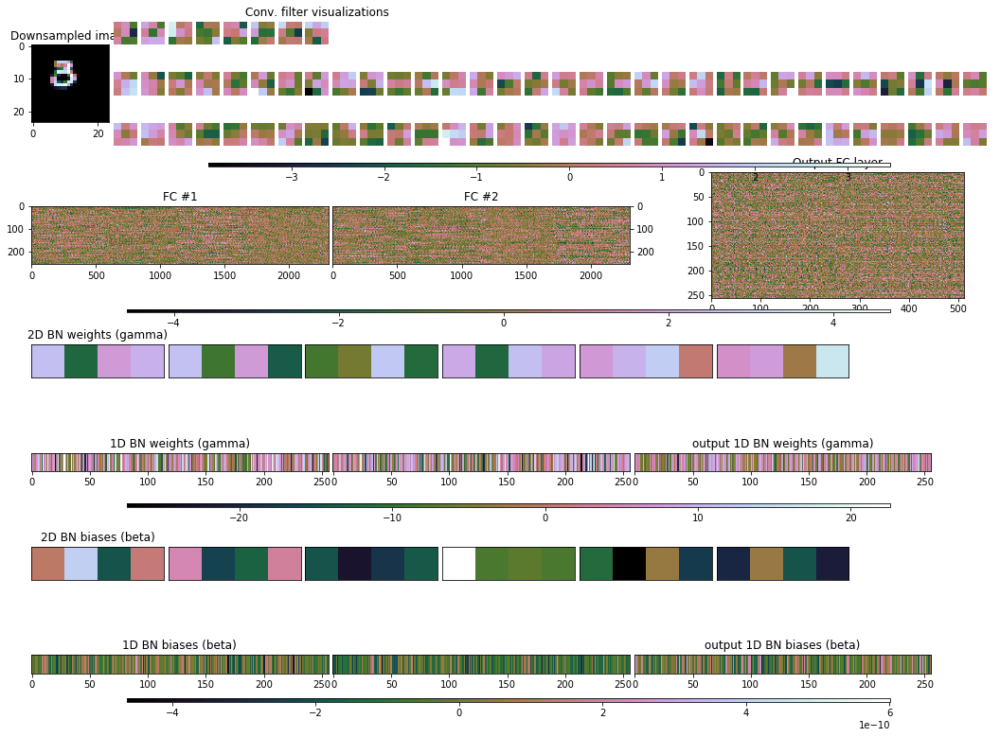


	Target class: 3 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.664, 0.777, 0.794, 0.790, 0.798, 0.833]


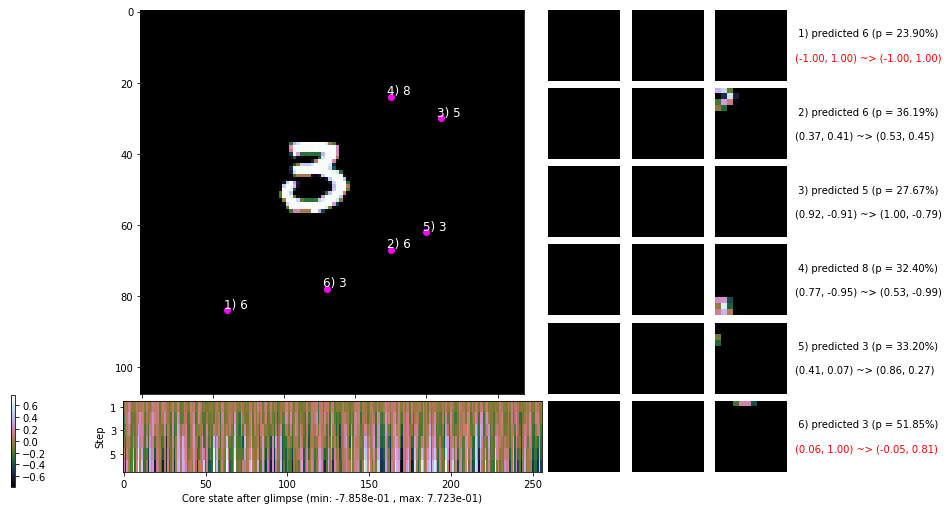

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


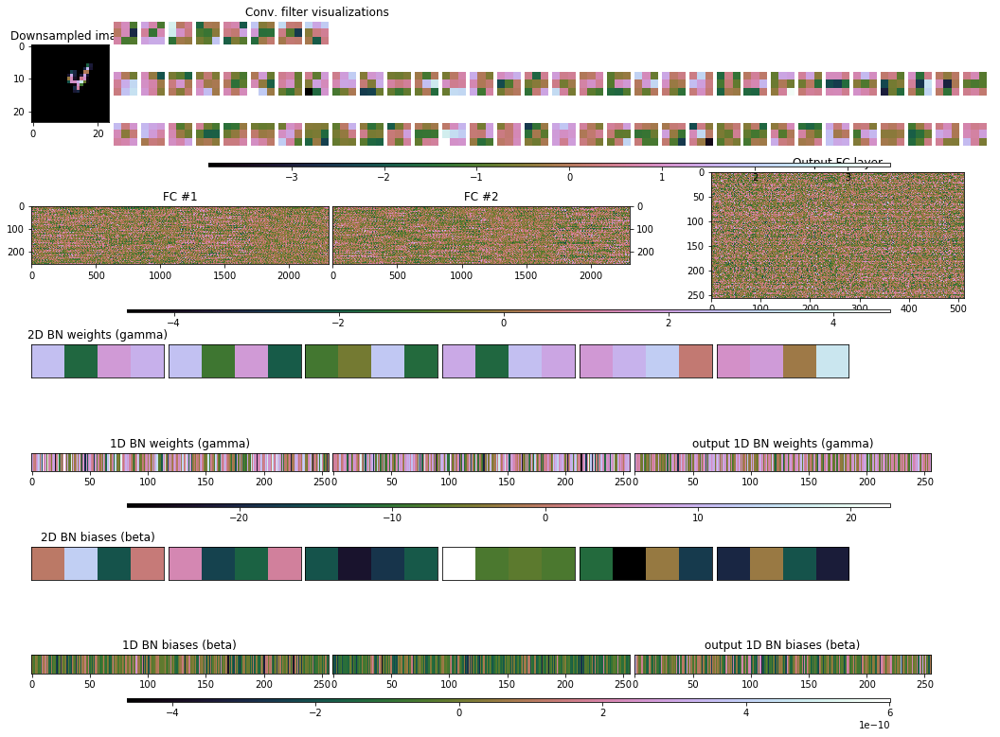


	Target class: 4 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


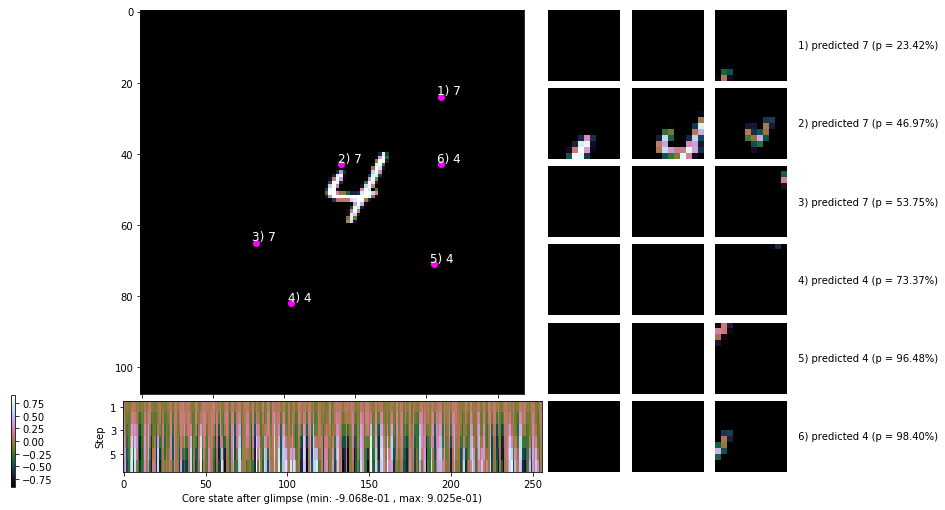

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


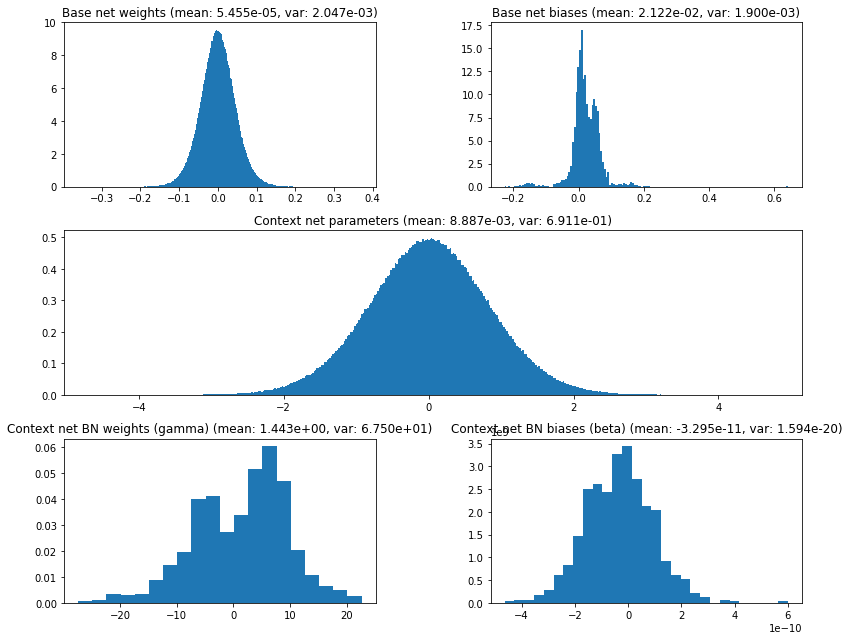

                                         Location network weights and biases


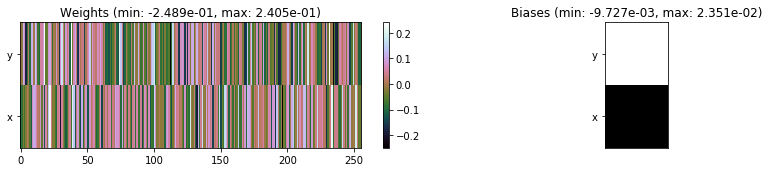

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1370.73 sec | TRAIN >> class loss: 0.3773 | steps:  4.042    | reward:  0.9000    | acc.: 90.002% 
                          | VAL   >> class loss: 0.2645 | steps:  3.907 :( | reward:  0.9286    | acc.: 92.860% 


Epoch   8/400) lr = 0.009437
 b   1000/  4000 >> 372.3 ms/b | lr: 2.35e-03 | grad 2norm:  7.59 | grad inf norm:  1.396
         Weights || abs max:  0.370 (64030.355) | mean:  5.133e-05 ( 0.110) | var: 2.049e-03 (1126206.625)
          Biases || abs max:  0.644 ( 1204.936) | mean:  2.126e-02 ( 0.777) | var: 1.908e-03 (18035.939)
                    class loss: 0.355 | steps: 4.054 | reward:  0.905 | acc.: 90.53%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([

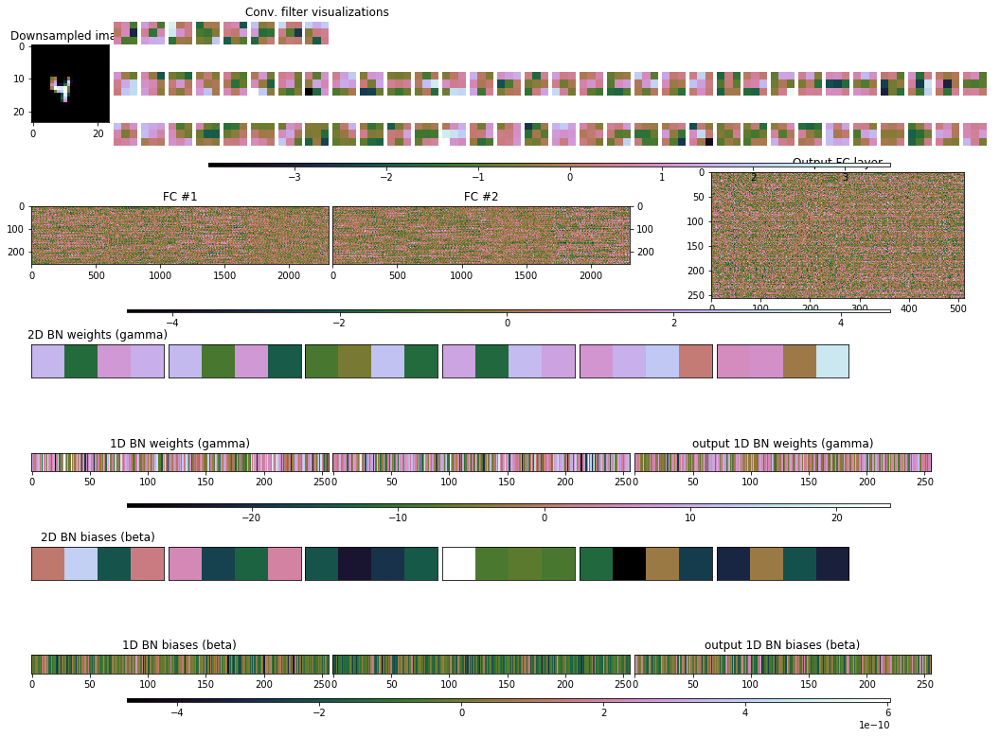


	Target class: 4 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.034, 1.010, 1.035, 1.060, 1.031, 0.946]


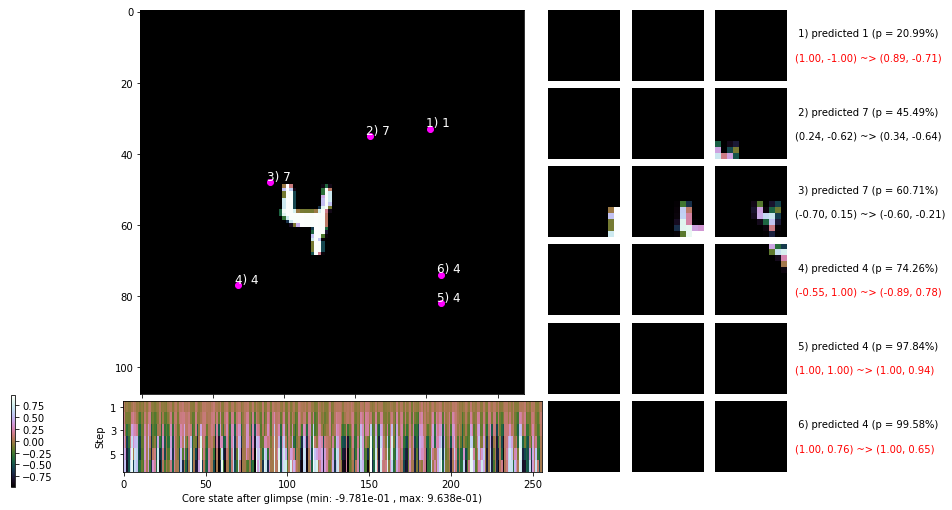

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 370.0 ms/b | lr: 2.12e-03 | grad 2norm:  7.53 | grad inf norm:  1.384
         Weights || abs max:  0.368 (34141.309) | mean:  5.361e-05 ( 0.084) | var: 2.061e-03 (17834.438)
          Biases || abs max:  0.655 (  798.351) | mean:  2.145e-02 ( 0.578) | var: 1.946e-03 ( 3584.478)
                    class loss: 0.329 | steps: 3.990 | reward:  0.915 | acc.: 91.48%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

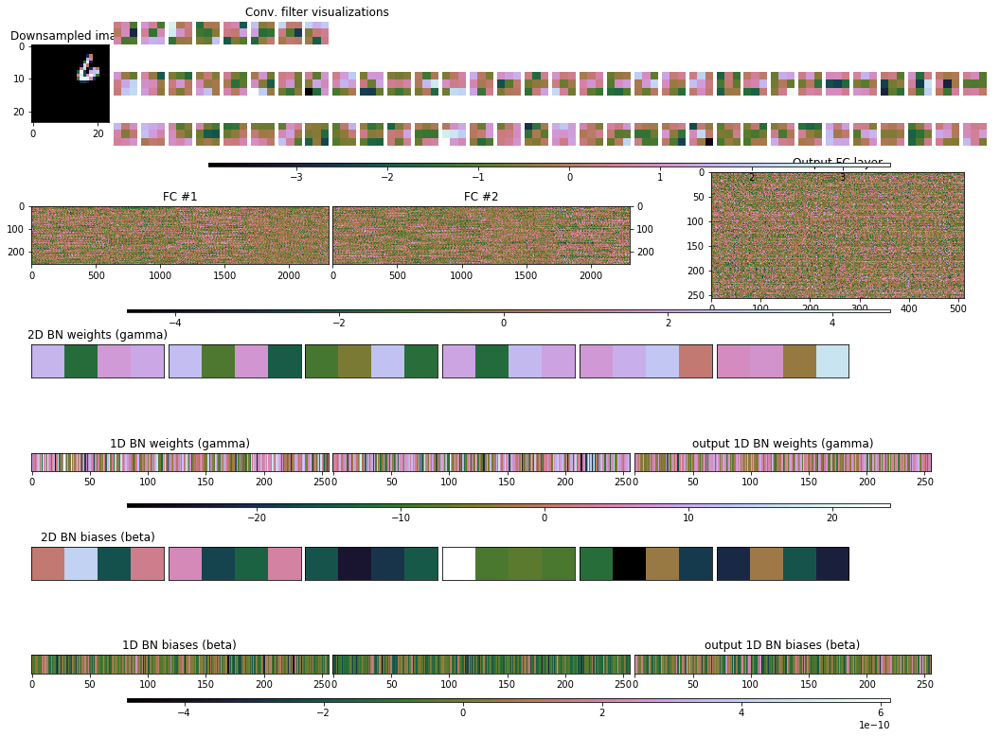


	Target class: 6 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.925, 0.932, 0.976, 0.927, 0.868, 0.783]


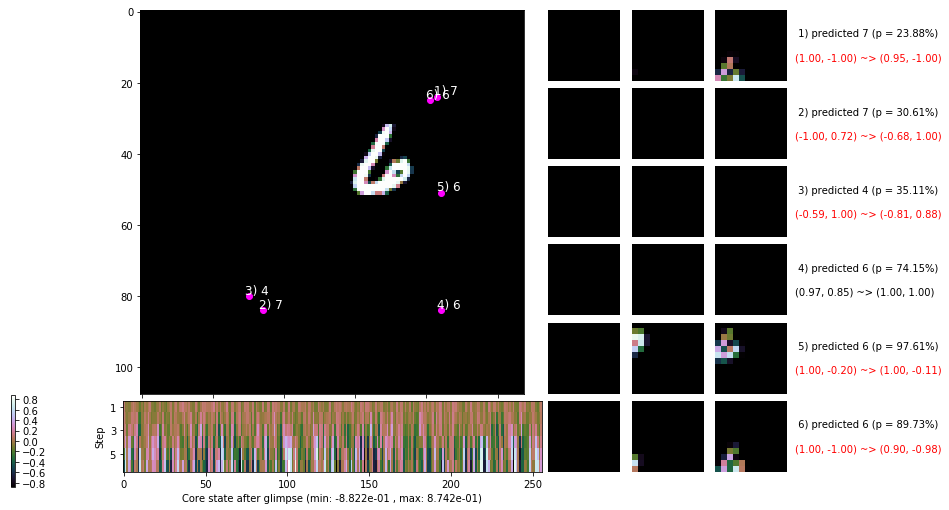

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


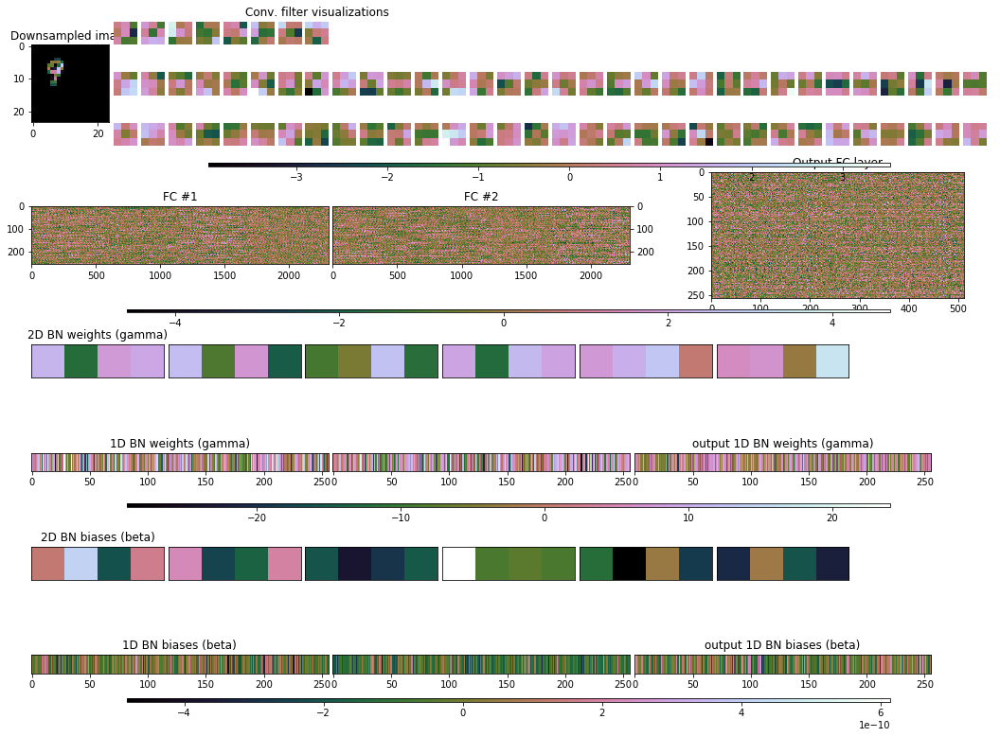


	Target class: 9 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


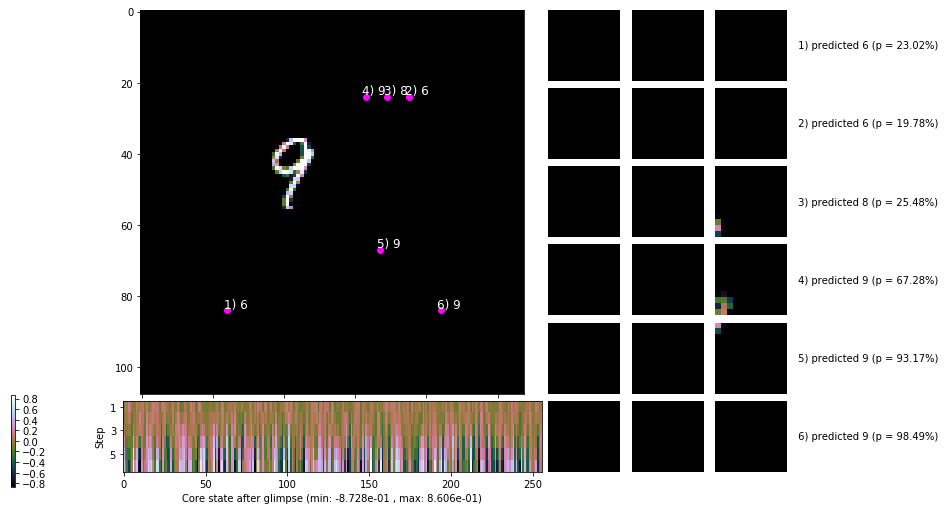

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


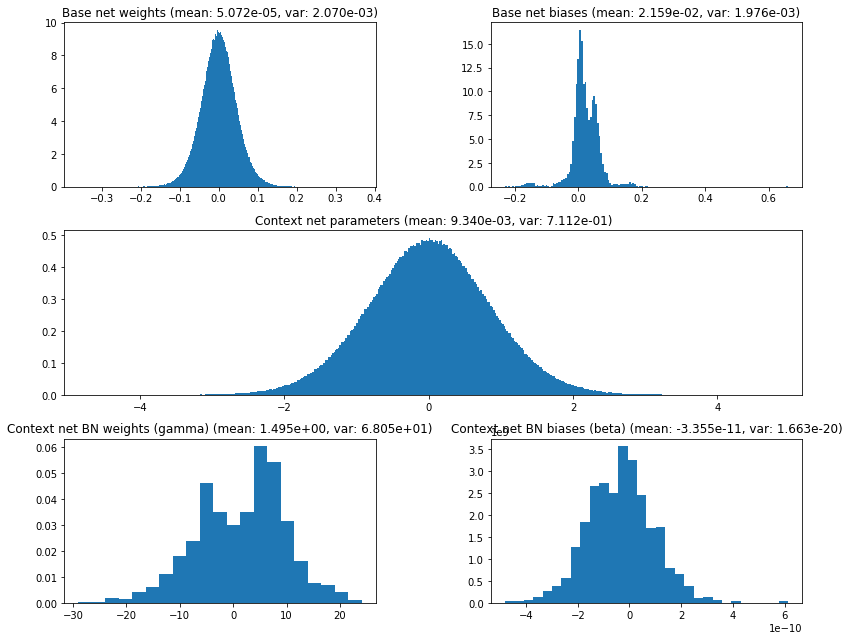

                                         Location network weights and biases


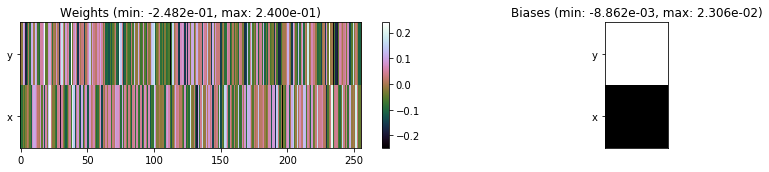

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1470.76 sec | TRAIN >> class loss: 0.3443 | steps:  4.009    | reward:  0.9096    | acc.: 90.956% 
                          | VAL   >> class loss: 0.2501 | steps:  3.762    | reward:  0.9340    | acc.: 93.400% 


Epoch   9/400) lr = 0.007723
 b   1000/  4000 >> 347.5 ms/b | lr: 1.92e-03 | grad 2norm:  7.69 | grad inf norm:  1.316
         Weights || abs max:  0.366 (49032.008) | mean:  4.895e-05 ( 0.097) | var: 2.073e-03 (186950.859)
          Biases || abs max:  0.663 (  446.583) | mean:  2.168e-02 ( 0.439) | var: 1.986e-03 ( 1942.130)
                    class loss: 0.325 | steps: 3.942 | reward:  0.915 | acc.: 91.48%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4

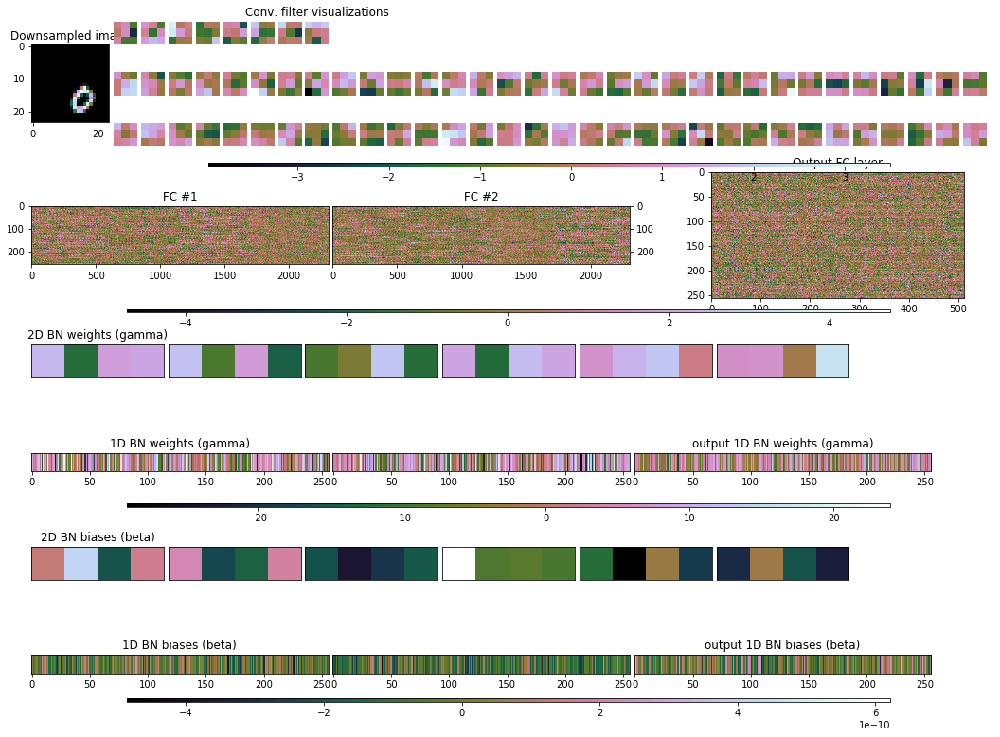


	Target class: 0 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.082, 1.019, 1.096, 1.121, 1.085, 1.036]


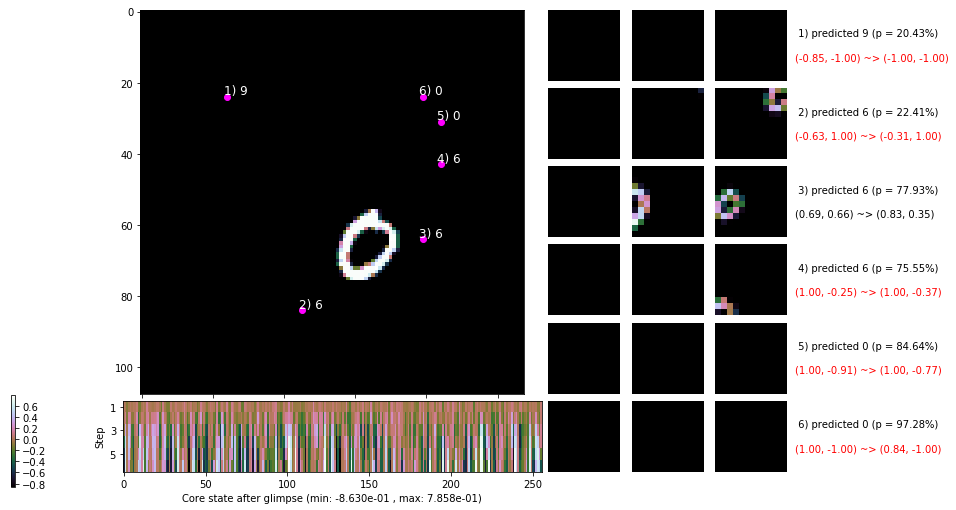

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 355.3 ms/b | lr: 1.74e-03 | grad 2norm:  7.88 | grad inf norm:  1.390
         Weights || abs max:  0.367 (36002.949) | mean:  4.967e-05 ( 0.084) | var: 2.087e-03 (91356.711)
          Biases || abs max:  0.669 (  635.002) | mean:  2.202e-02 ( 0.498) | var: 2.031e-03 ( 5041.050)
                    class loss: 0.313 | steps: 3.900 | reward:  0.918 | acc.: 91.81%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

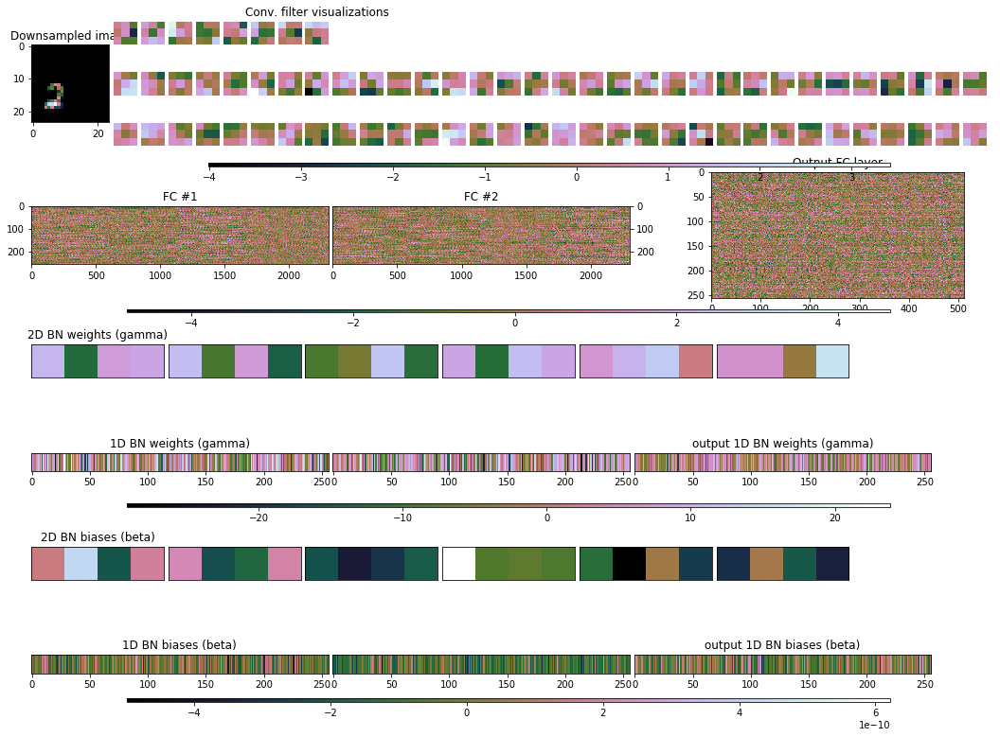


	Target class: 2 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.781, 0.873, 0.970, 1.013, 1.019, 1.014]


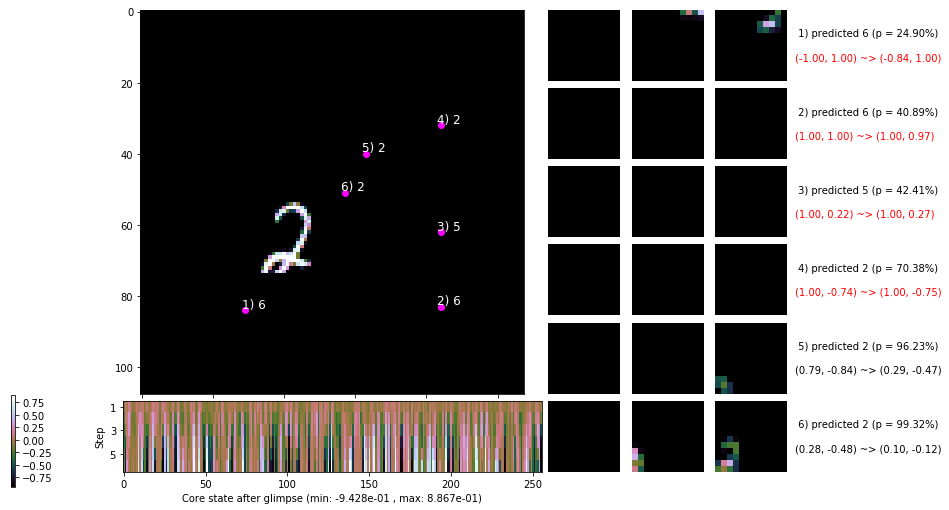

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


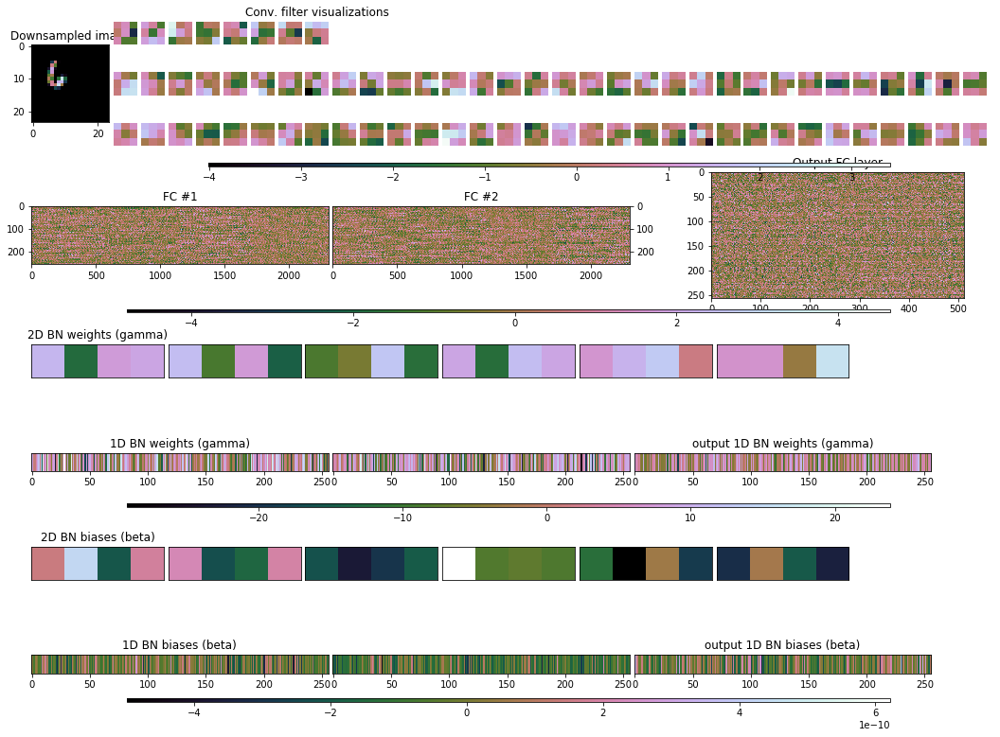


	Target class: 6 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


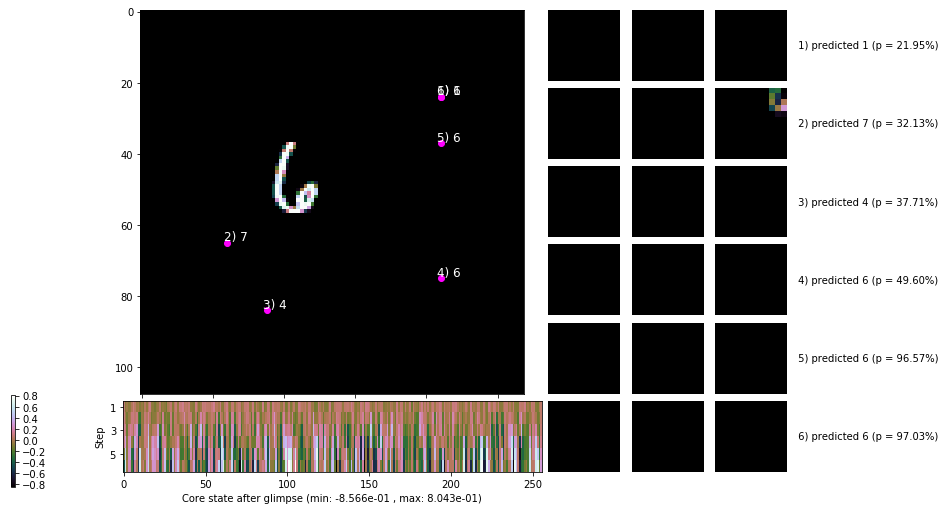

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


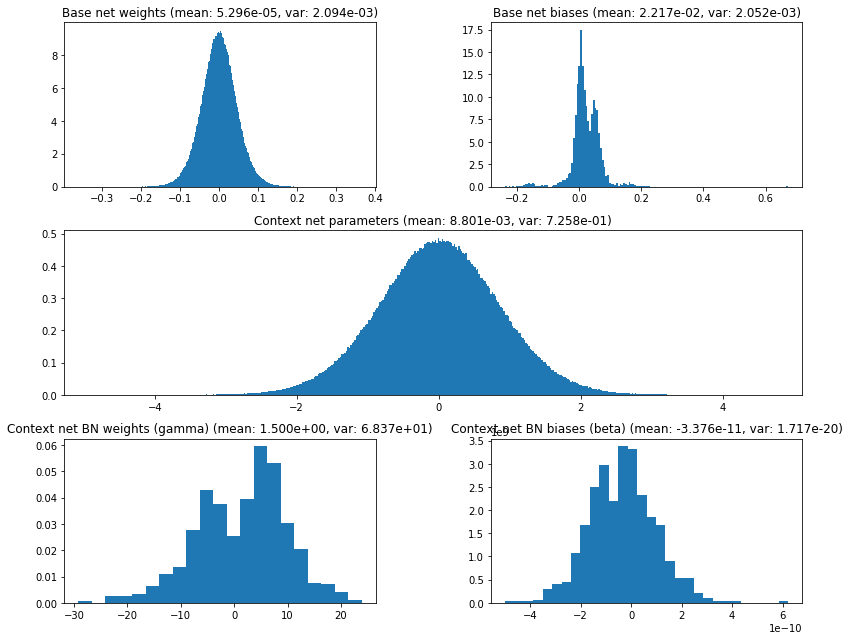

                                         Location network weights and biases


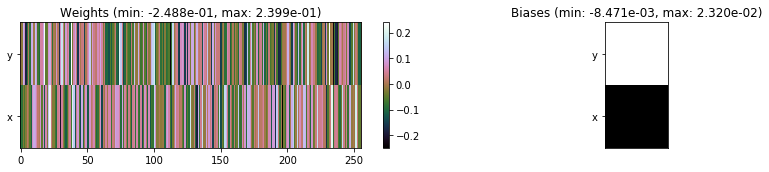

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1401.42 sec | TRAIN >> class loss: 0.3201 | steps:  3.917    | reward:  0.9167    | acc.: 91.673% 
                          | VAL   >> class loss: 0.2022 | steps:  3.678    | reward:  0.9448    | acc.: 94.480% 


Epoch  10/400) lr = 0.00632
 b   1000/  4000 >> 346.4 ms/b | lr: 1.57e-03 | grad 2norm:  7.87 | grad inf norm:  1.374
         Weights || abs max:  0.366 (42651.895) | mean:  5.390e-05 ( 0.089) | var: 2.097e-03 (176160.281)
          Biases || abs max:  0.674 (  543.686) | mean:  2.223e-02 ( 0.527) | var: 2.057e-03 ( 1331.893)
                    class loss: 0.310 | steps: 3.856 | reward:  0.920 | acc.: 91.99%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]

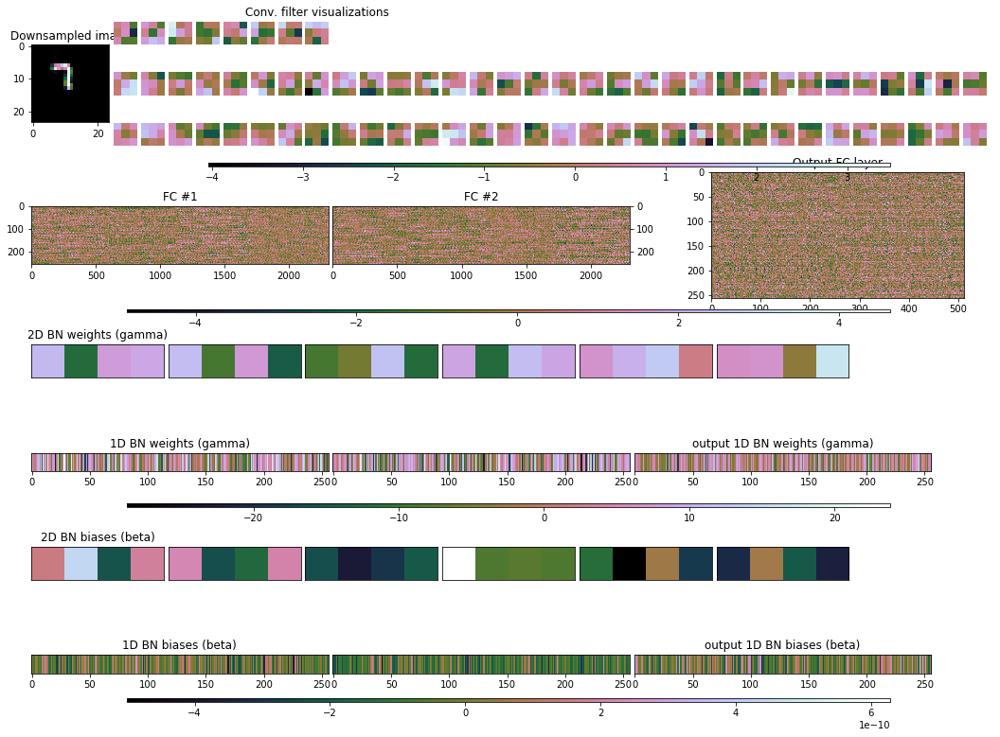


	Target class: 7 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.919, 0.823, 0.864, 0.899, 0.921, 0.894]


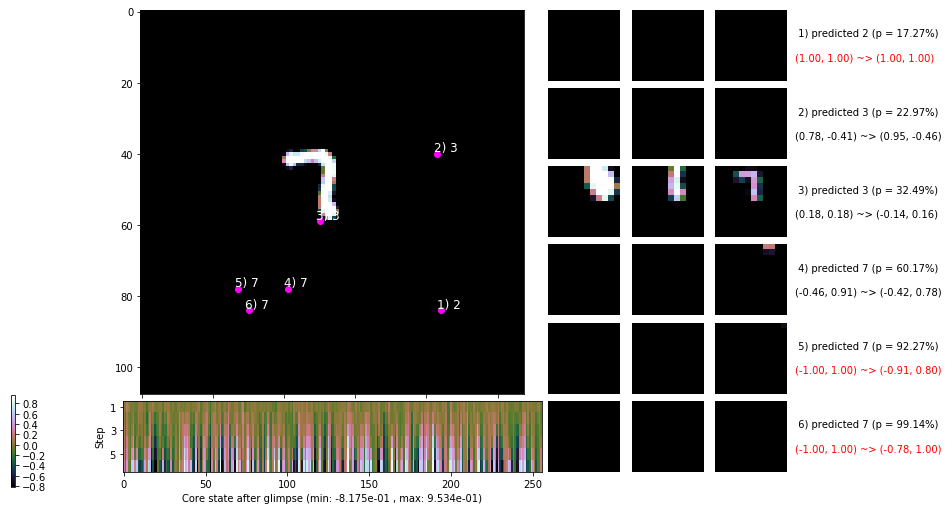

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 352.1 ms/b | lr: 1.42e-03 | grad 2norm:  8.01 | grad inf norm:  1.378
         Weights || abs max:  0.366 (28971.850) | mean:  5.396e-05 ( 0.076) | var: 2.107e-03 ( 9159.079)
          Biases || abs max:  0.678 ( 3470.771) | mean:  2.247e-02 ( 1.622) | var: 2.090e-03 (931169.938)
                    class loss: 0.305 | steps: 3.891 | reward:  0.921 | acc.: 92.09%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0,

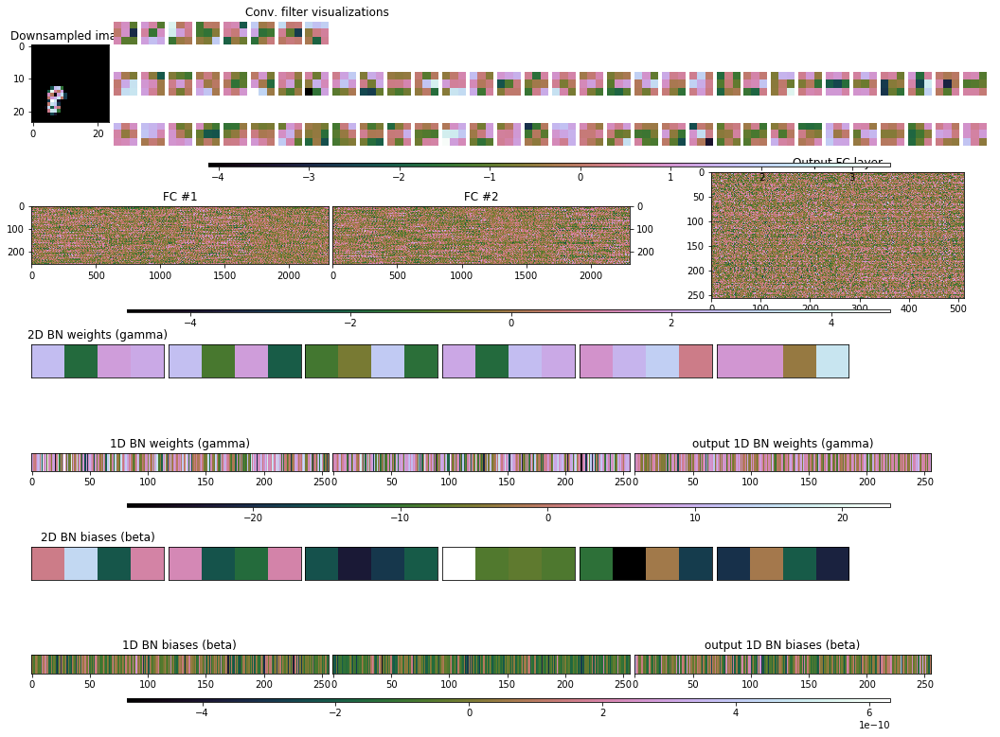


	Target class: 8 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.839, 0.879, 0.899, 0.906, 0.916, 0.879]


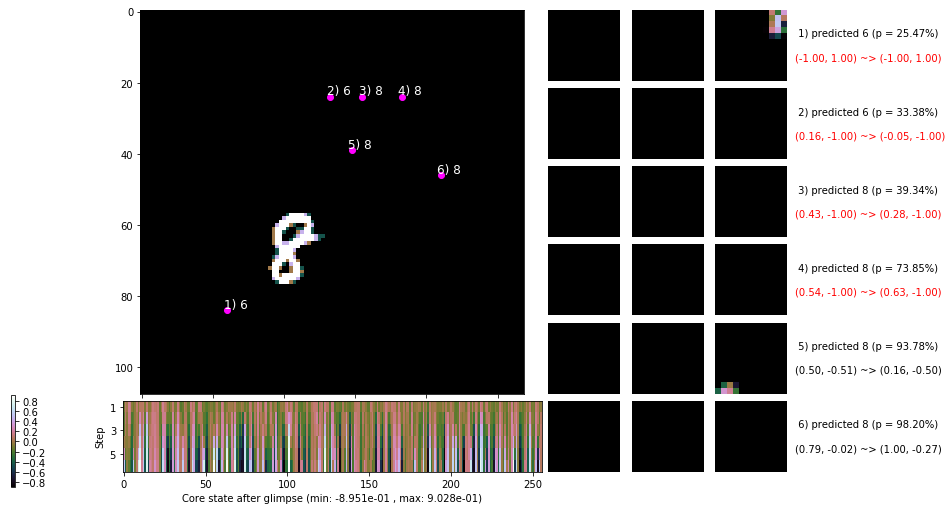

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


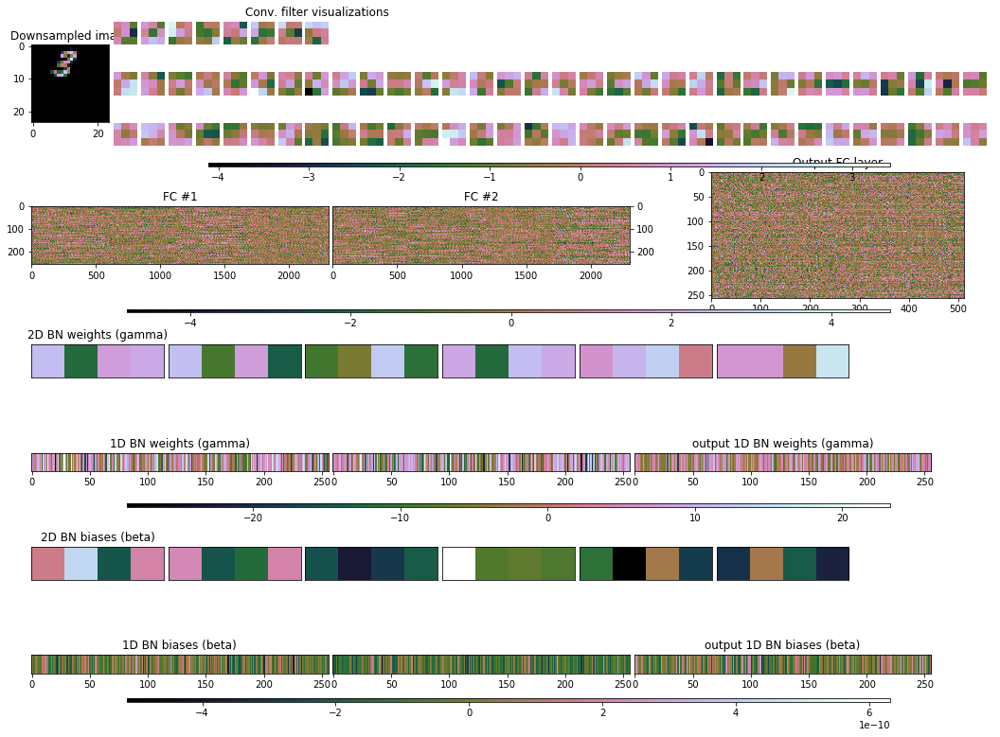


	Target class: 3 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


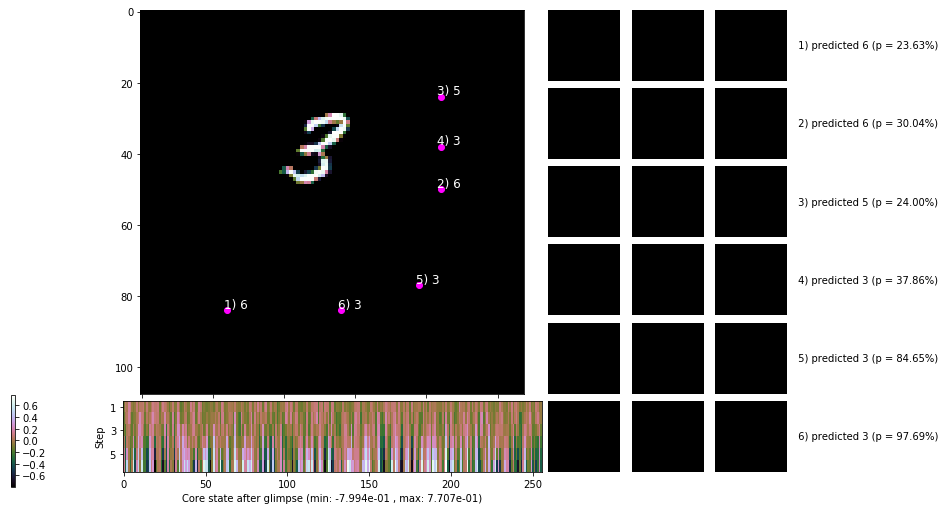

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


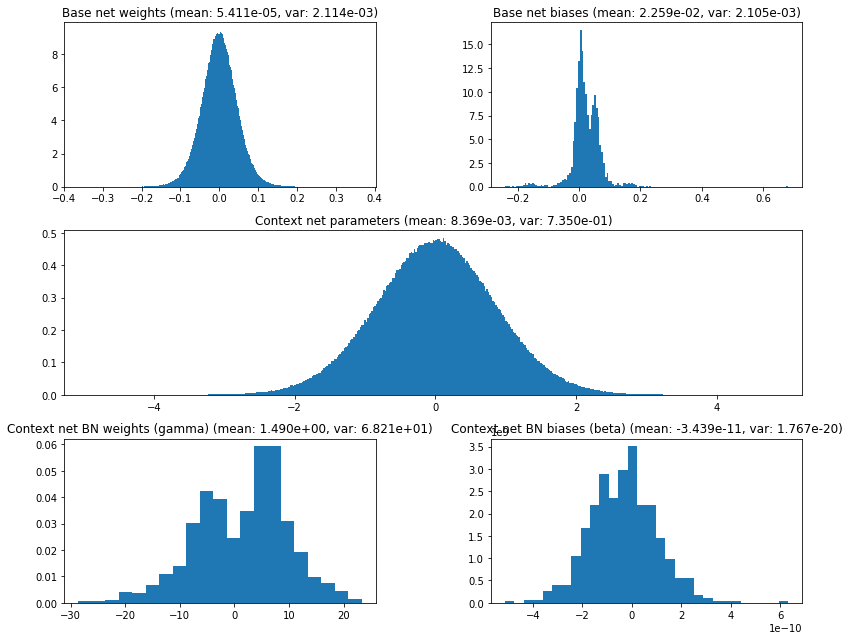

                                         Location network weights and biases


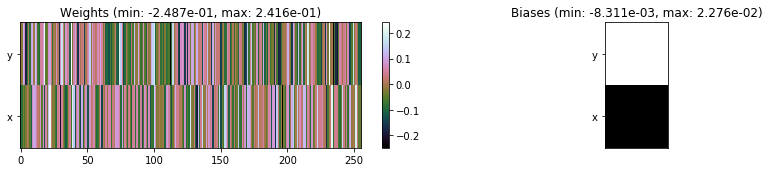

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1393.87 sec | TRAIN >> class loss: 0.3012 | steps:  3.872    | reward:  0.9218    | acc.: 92.183% 
                          | VAL   >> class loss: 0.2092 | steps:  3.771 :( | reward:  0.9456    | acc.: 94.560% 


Epoch  11/400) lr = 0.005171
 b   1000/  4000 >> 342.6 ms/b | lr: 1.29e-03 | grad 2norm:  7.82 | grad inf norm:  1.345
         Weights || abs max:  0.366 (37735.789) | mean:  5.642e-05 ( 0.083) | var: 2.115e-03 (92810.086)
          Biases || abs max:  0.682 (  846.717) | mean:  2.262e-02 ( 0.627) | var: 2.108e-03 (102887.000)
                    class loss: 0.288 | steps: 3.865 | reward:  0.924 | acc.: 92.41%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4

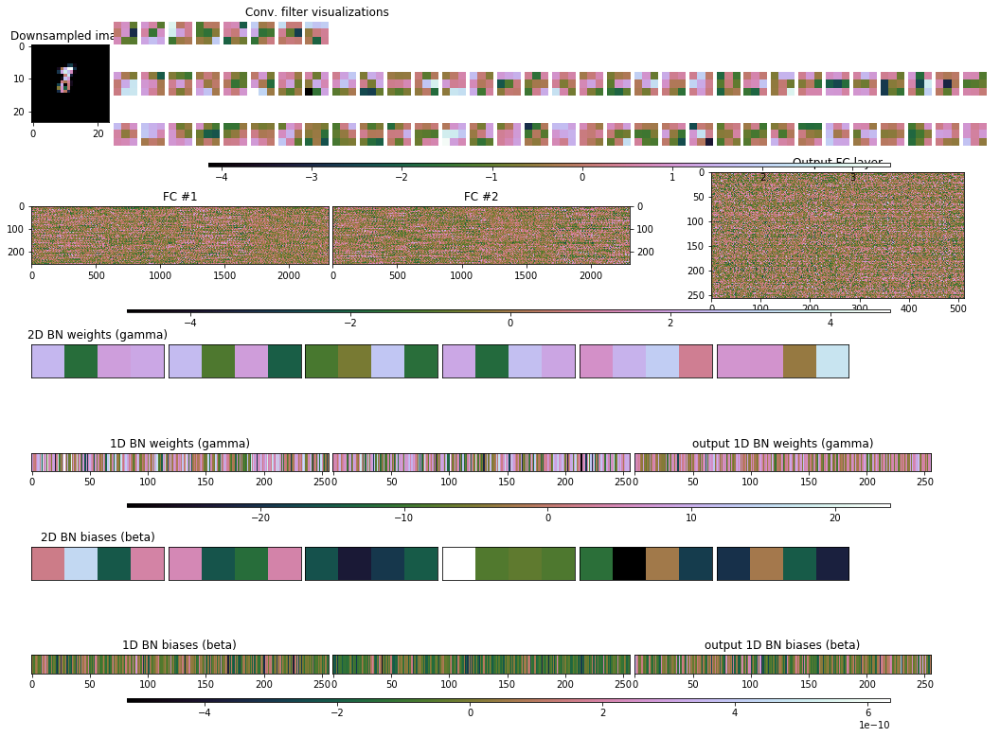


	Target class: 8 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.698, 0.749, 0.792, 0.816, 0.842, 0.876]


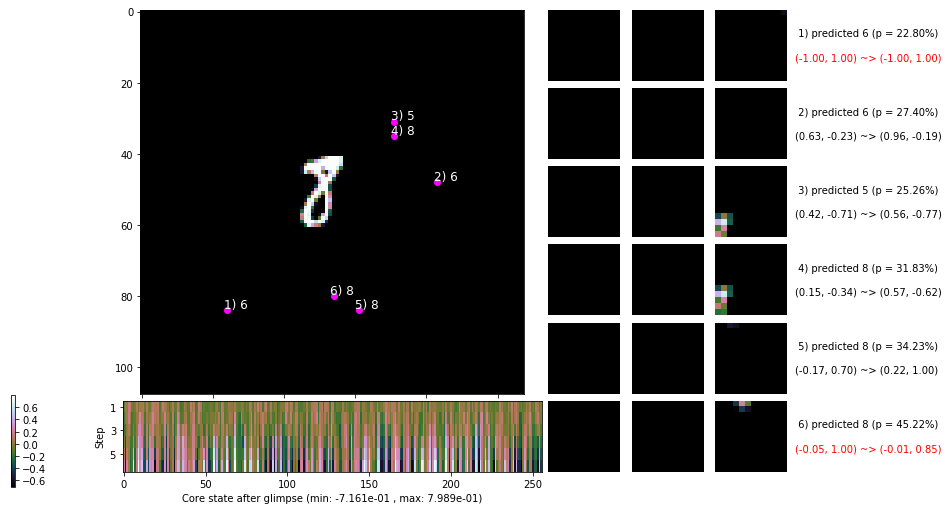

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 344.4 ms/b | lr: 1.16e-03 | grad 2norm:  7.38 | grad inf norm:  1.287
         Weights || abs max:  0.366 (71677.414) | mean:  5.622e-05 ( 0.112) | var: 2.124e-03 (1210913.625)
          Biases || abs max:  0.686 (  709.864) | mean:  2.287e-02 ( 0.635) | var: 2.138e-03 ( 3226.328)
                    class loss: 0.274 | steps: 3.864 | reward:  0.930 | acc.: 93.00%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0

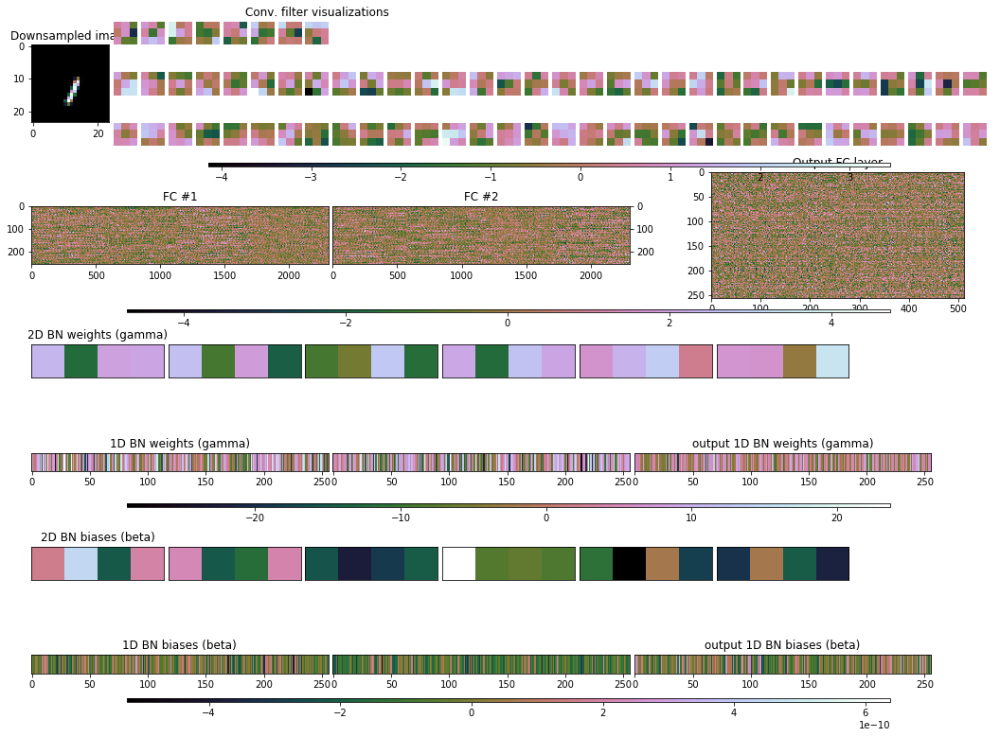


	Target class: 1 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.035, 0.971, 0.996, 1.015, 1.019, 0.980]


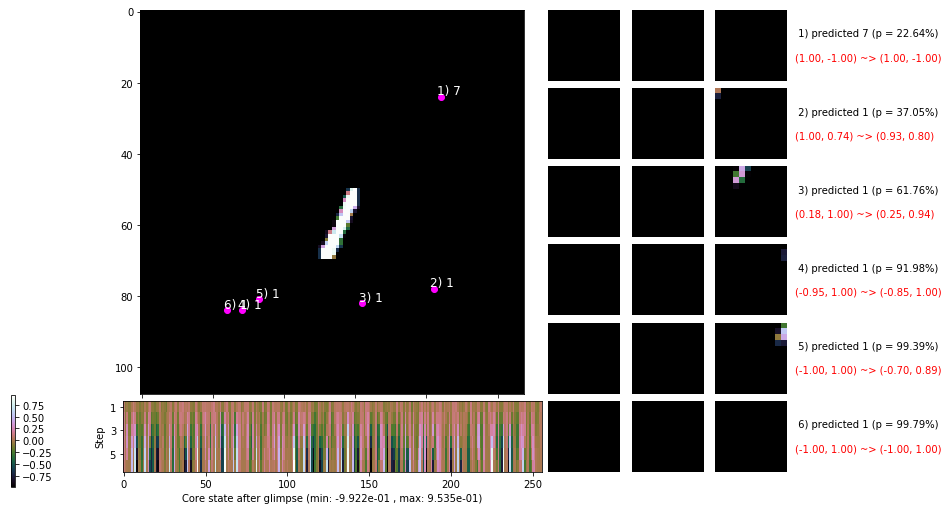

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


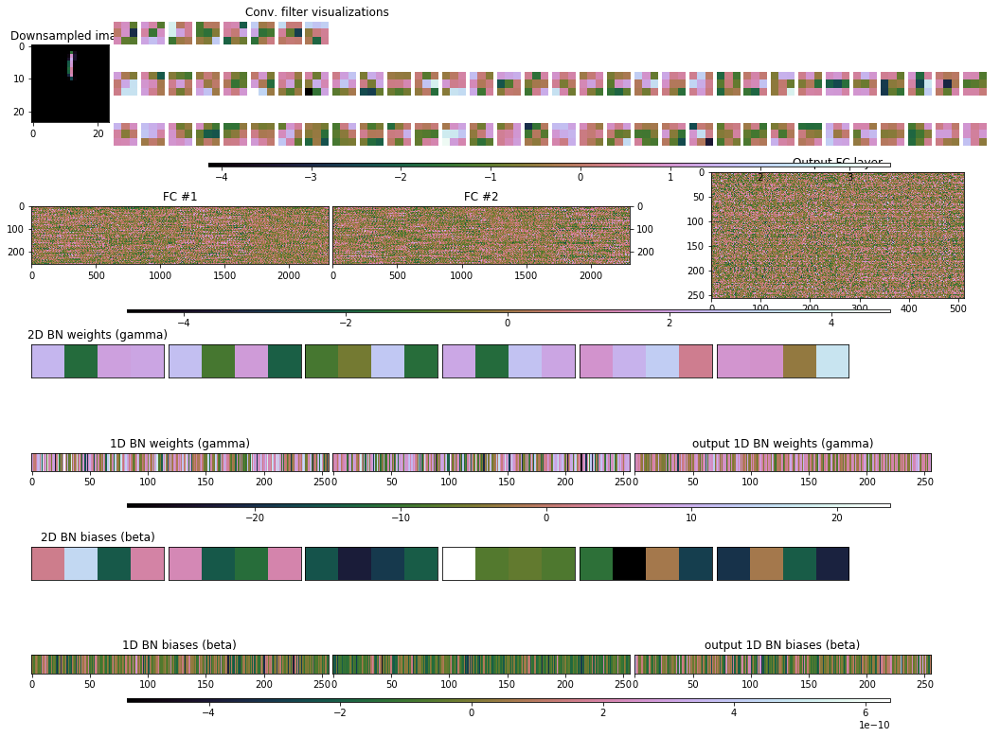


	Target class: 1 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


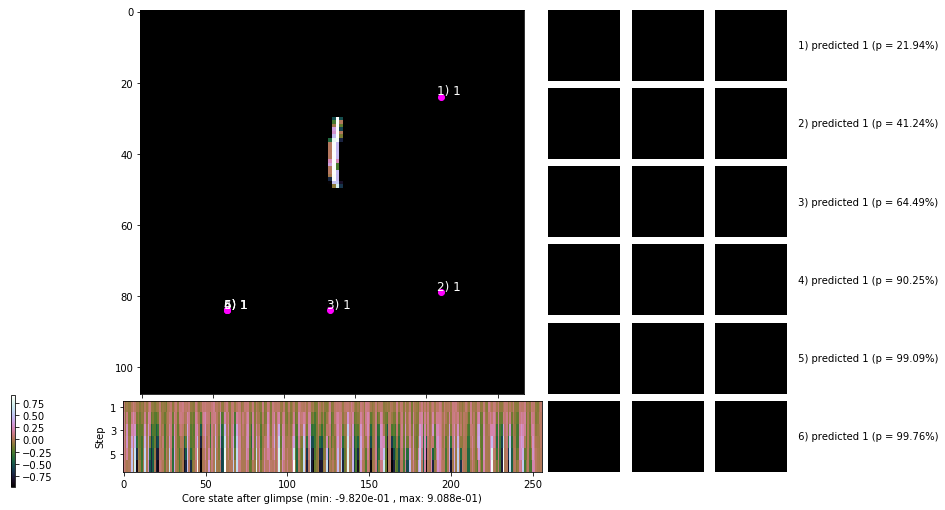

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


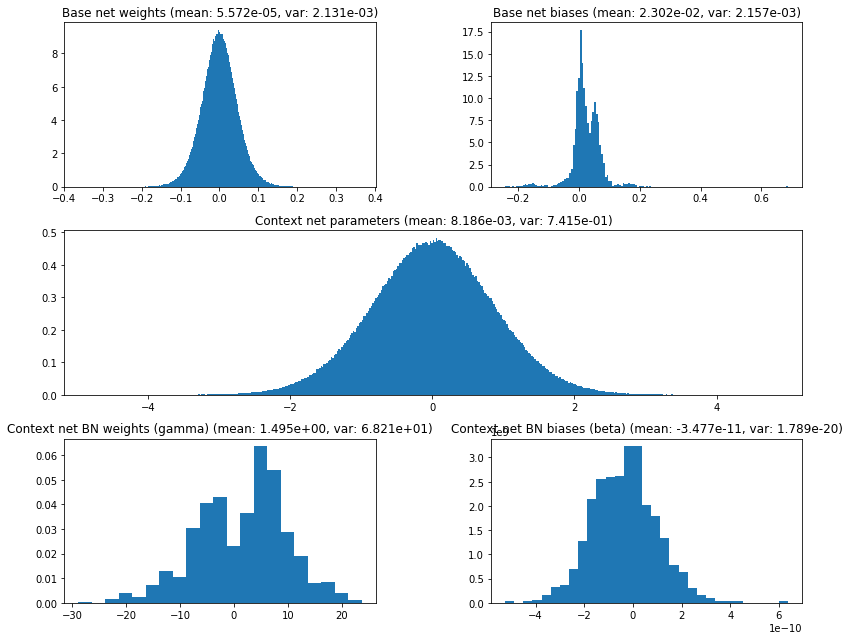

                                         Location network weights and biases


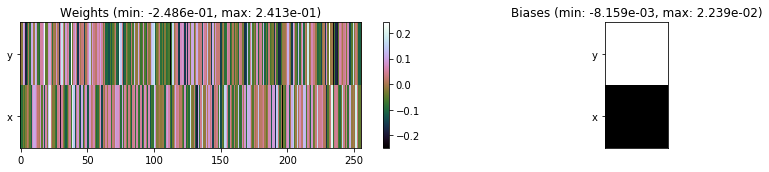

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1373.10 sec | TRAIN >> class loss: 0.2827 | steps:  3.861    | reward:  0.9268    | acc.: 92.681% 
                          | VAL   >> class loss: 0.1803 | steps:  3.692 :( | reward:  0.9540    | acc.: 95.400% 


Epoch  12/400) lr = 0.004232
 b   1000/  4000 >> 332.8 ms/b | lr: 1.05e-03 | grad 2norm:  7.89 | grad inf norm:  1.342
         Weights || abs max:  0.366 (53446.711) | mean:  5.624e-05 ( 0.096) | var: 2.132e-03 (561117.250)
          Biases || abs max:  0.689 ( 1313.637) | mean:  2.305e-02 ( 0.876) | var: 2.161e-03 (148949.203)
                    class loss: 0.279 | steps: 3.851 | reward:  0.928 | acc.: 92.85%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([

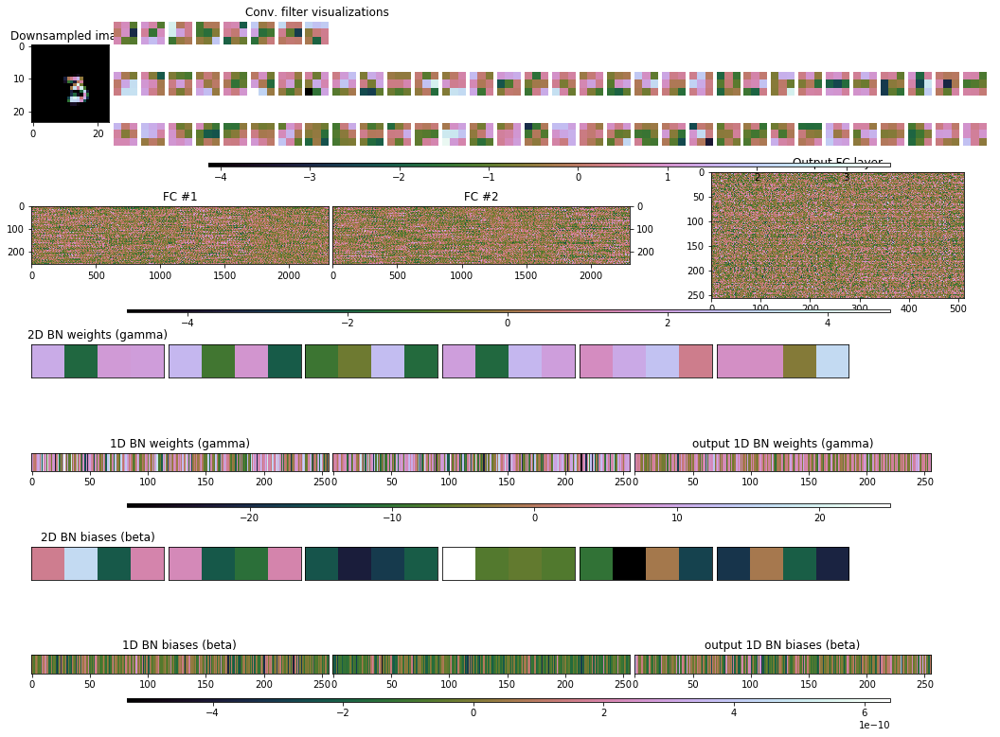


	Target class: 3 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.991, 0.894, 0.912, 0.911, 0.925, 0.956]


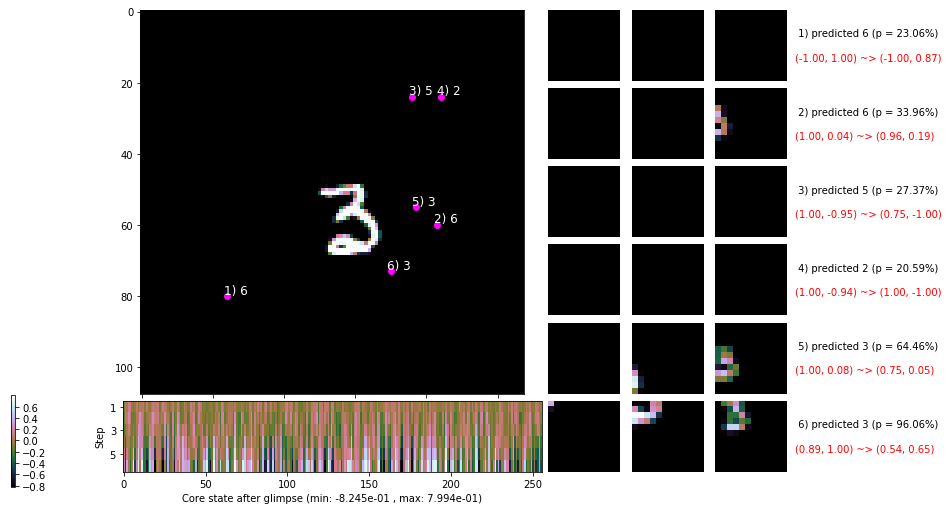

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 338.4 ms/b | lr: 9.53e-04 | grad 2norm:  7.73 | grad inf norm:  1.318
         Weights || abs max:  0.366 (45966.211) | mean:  6.008e-05 ( 0.089) | var: 2.138e-03 (241884.766)
          Biases || abs max:  0.692 (  849.322) | mean:  2.318e-02 ( 0.656) | var: 2.179e-03 ( 3379.412)
                    class loss: 0.274 | steps: 3.834 | reward:  0.929 | acc.: 92.94%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0,

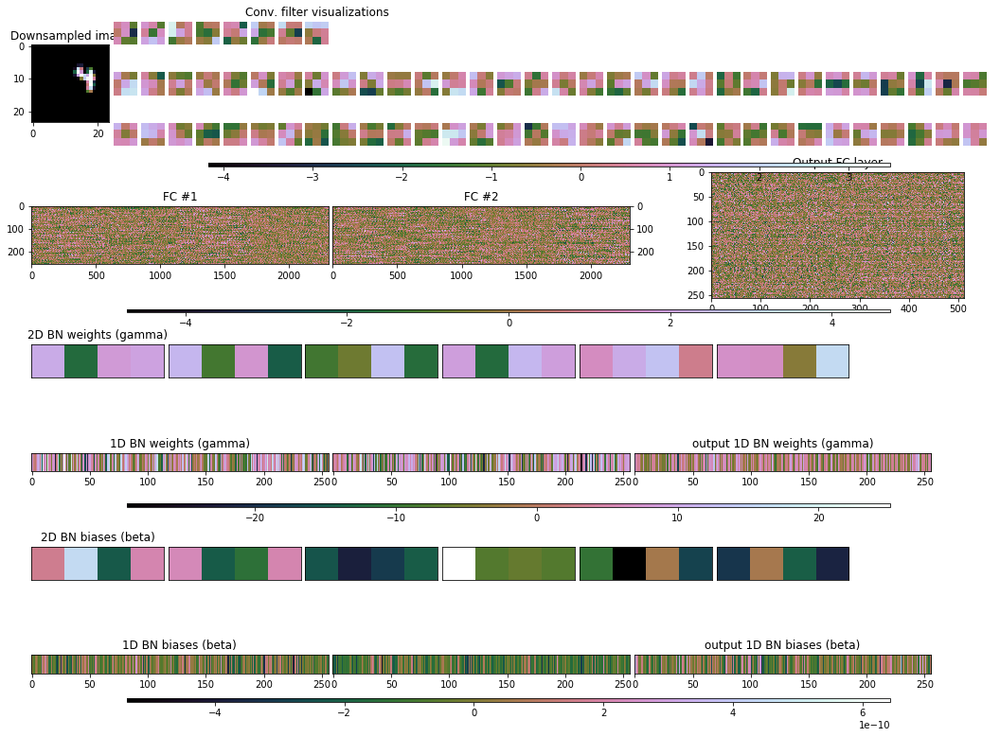


	Target class: 4 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.120, 1.071, 1.080, 1.079, 1.069, 1.020]


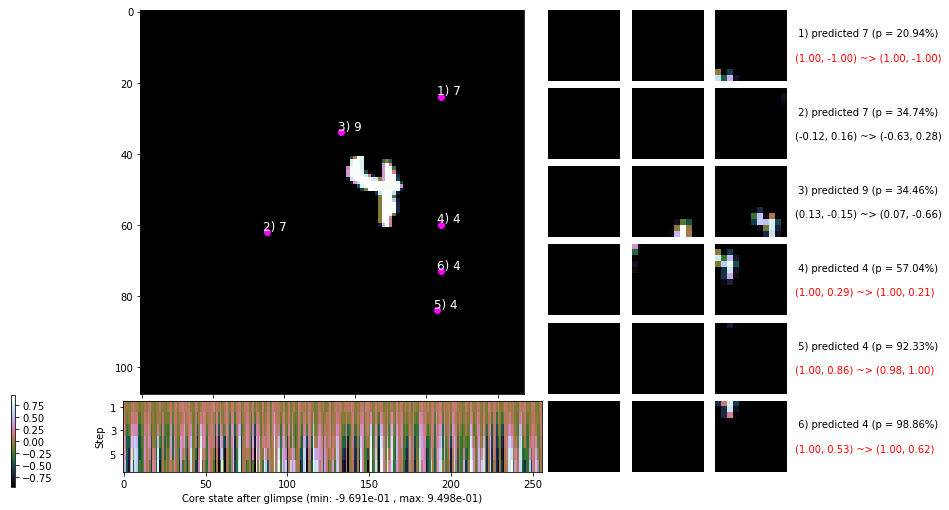

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


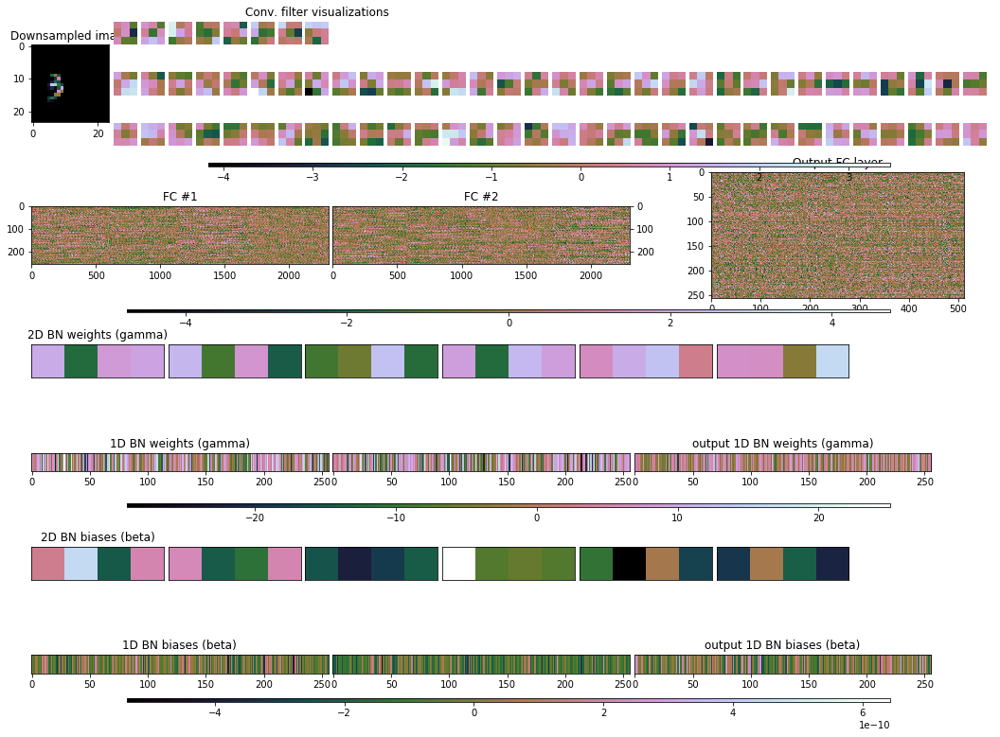


	Target class: 3 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


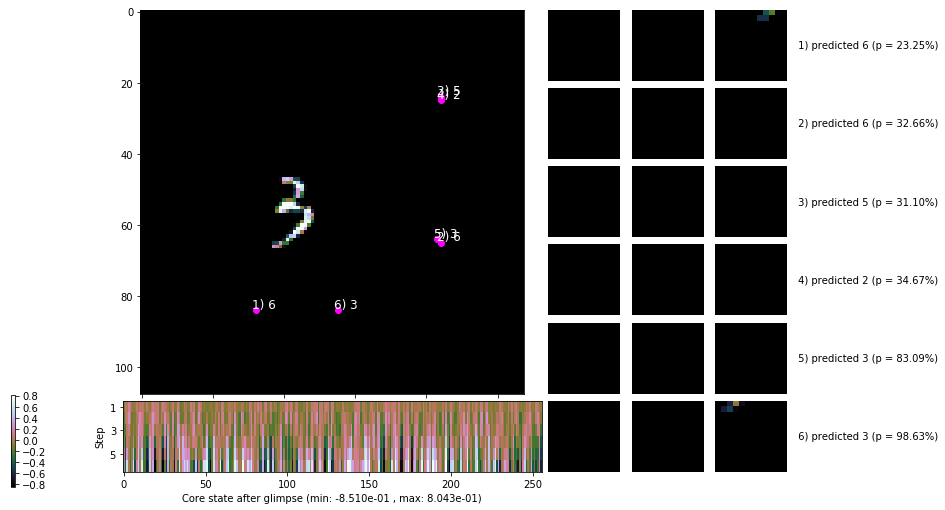

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


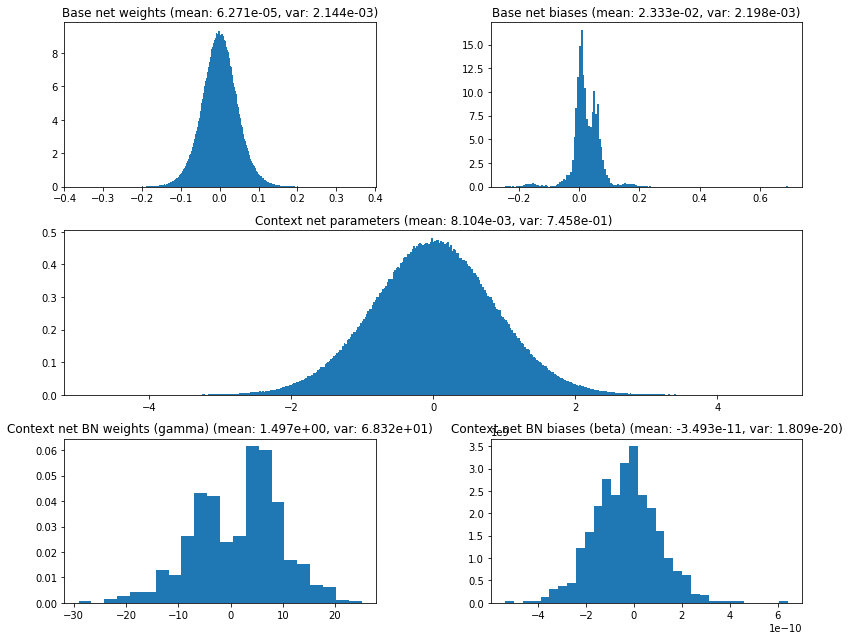

                                         Location network weights and biases


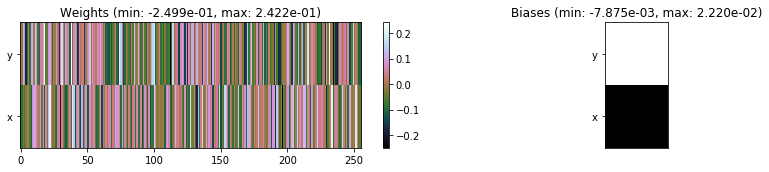

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1344.48 sec | TRAIN >> class loss: 0.2730 | steps:  3.842    | reward:  0.9293    | acc.: 92.931% 
                          | VAL   >> class loss: 0.1796 | steps:  3.686 :( | reward:  0.9552    | acc.: 95.520% 


Epoch  13/400) lr = 0.003463
 b   1000/  4000 >> 332.6 ms/b | lr: 8.62e-04 | grad 2norm:  7.88 | grad inf norm:  1.325
         Weights || abs max:  0.366 (58037.984) | mean:  6.274e-05 ( 0.100) | var: 2.145e-03 (612004.375)
          Biases || abs max:  0.695 ( 1059.053) | mean:  2.335e-02 ( 0.756) | var: 2.203e-03 (53747.488)
                    class loss: 0.264 | steps: 3.839 | reward:  0.933 | acc.: 93.27%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4

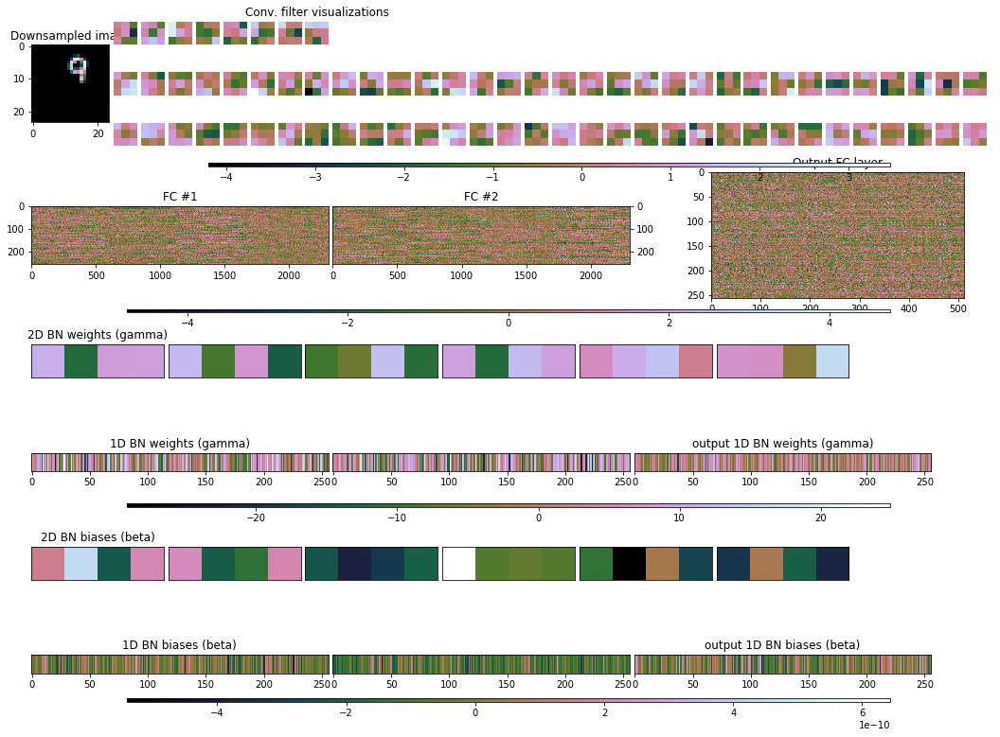


	Target class: 9 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.021, 1.041, 1.023, 1.030, 1.006, 0.931]


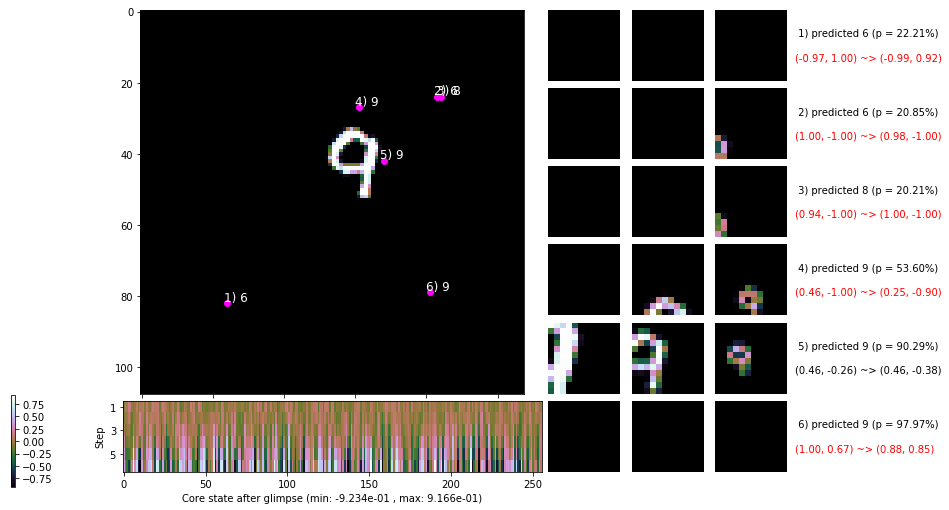

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 337.4 ms/b | lr: 7.80e-04 | grad 2norm:  8.09 | grad inf norm:  1.329
         Weights || abs max:  0.367 (29743.764) | mean:  6.444e-05 ( 0.076) | var: 2.151e-03 (27257.773)
          Biases || abs max:  0.697 (  981.513) | mean:  2.348e-02 ( 0.666) | var: 2.221e-03 (33124.770)
                    class loss: 0.271 | steps: 3.835 | reward:  0.931 | acc.: 93.12%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

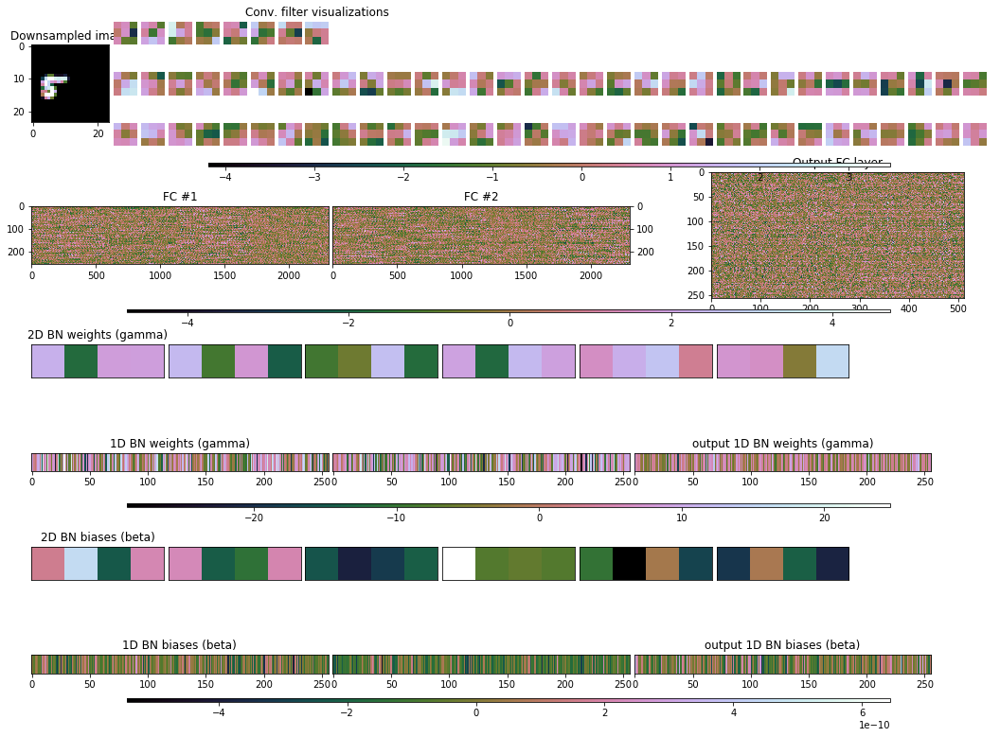


	Target class: 5 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.036, 0.887, 0.865, 0.836, 0.821, 0.808]


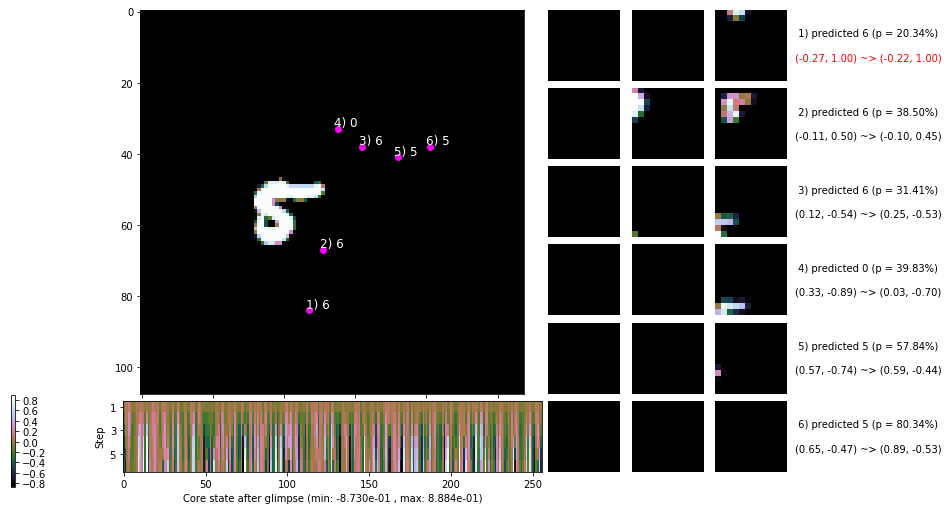

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


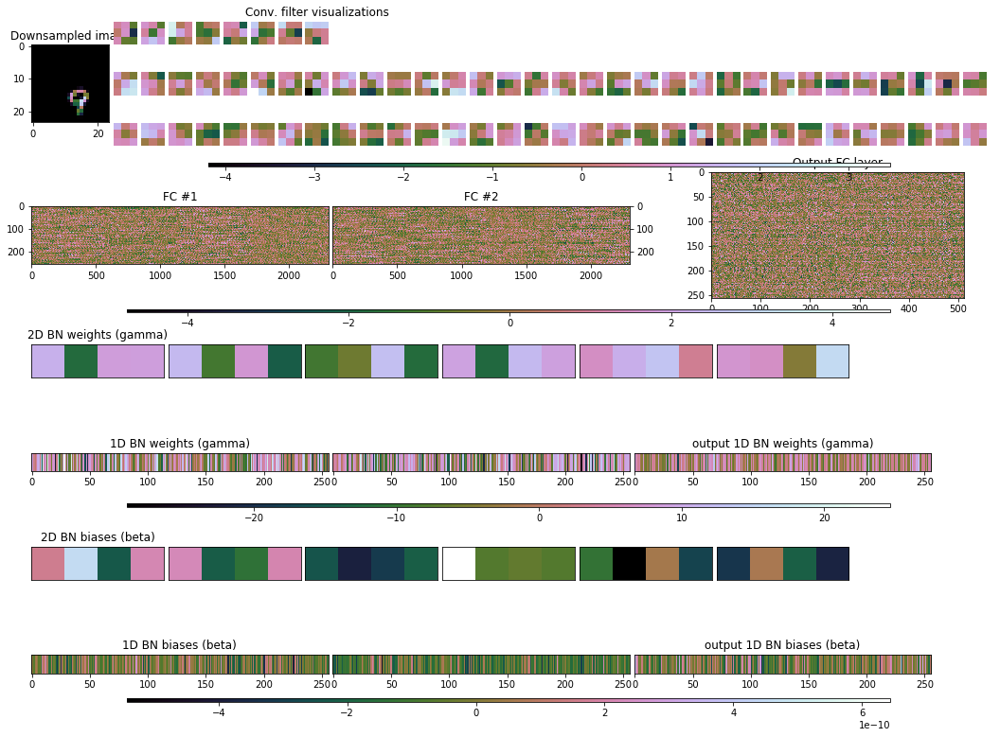


	Target class: 9 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


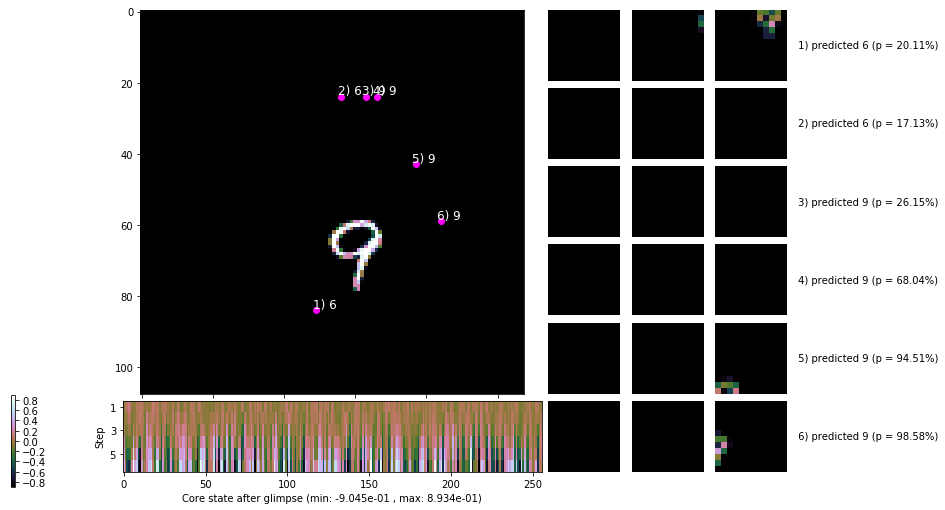

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


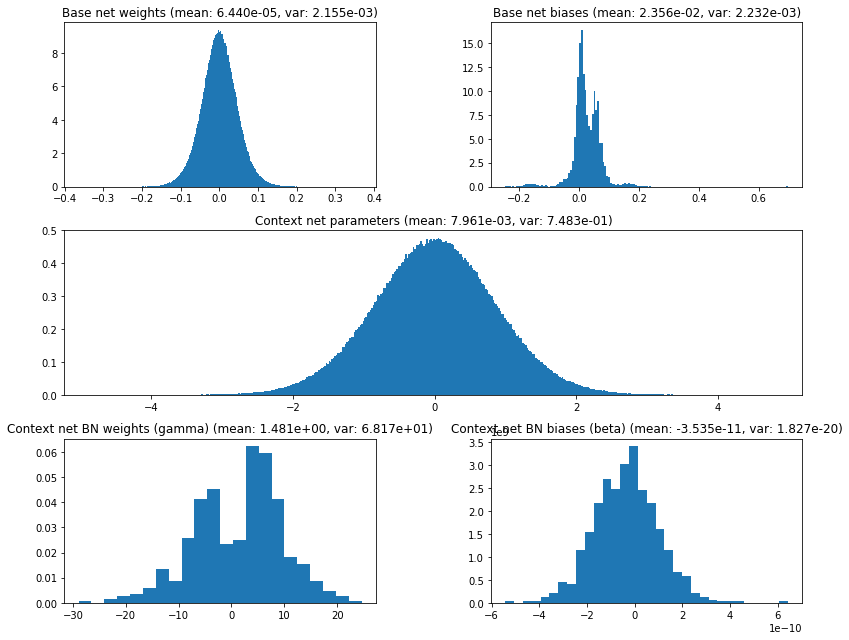

                                         Location network weights and biases


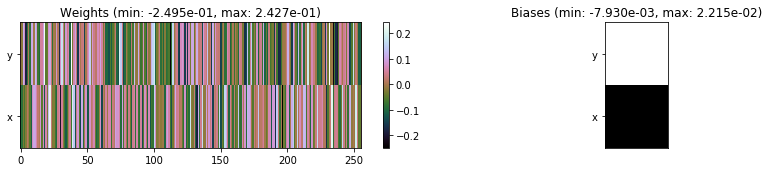

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1336.78 sec | TRAIN >> class loss: 0.2655 | steps:  3.835    | reward:  0.9329    | acc.: 93.287% 
                          | VAL   >> class loss: 0.1755 | steps:  3.684 :( | reward:  0.9560    | acc.: 95.600% 


Epoch  14/400) lr = 0.002834
 b   1000/  4000 >> 336.4 ms/b | lr: 7.05e-04 | grad 2norm:  7.90 | grad inf norm:  1.328
         Weights || abs max:  0.368 (48295.543) | mean:  6.415e-05 ( 0.090) | var: 2.156e-03 (278591.312)
          Biases || abs max:  0.699 ( 1372.745) | mean:  2.356e-02 ( 0.886) | var: 2.235e-03 (137264.109)
                    class loss: 0.264 | steps: 3.845 | reward:  0.934 | acc.: 93.36%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([

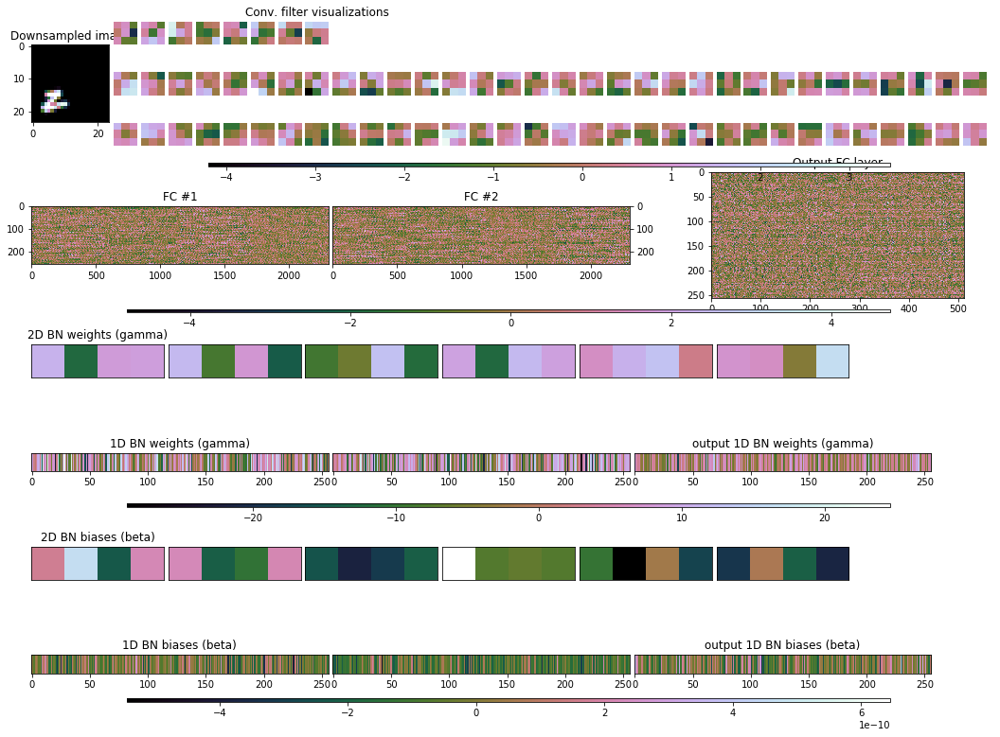


	Target class: 2 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.942, 1.060, 1.095, 1.108, 1.092, 1.052]


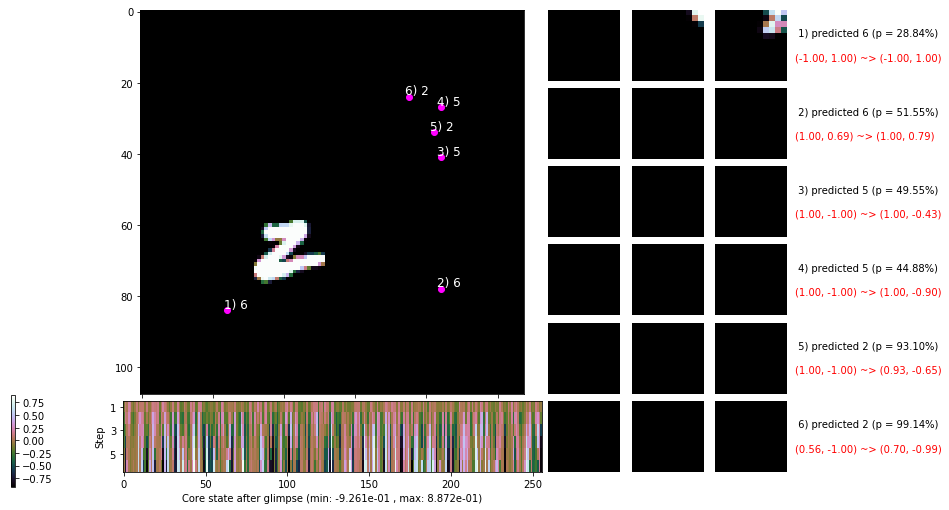

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 337.1 ms/b | lr: 6.38e-04 | grad 2norm:  8.00 | grad inf norm:  1.351
         Weights || abs max:  0.369 (63716.844) | mean:  6.688e-05 ( 0.103) | var: 2.160e-03 (747843.062)
          Biases || abs max:  0.701 ( 2007.608) | mean:  2.362e-02 ( 1.230) | var: 2.248e-03 (154310.109)
                    class loss: 0.263 | steps: 3.801 | reward:  0.932 | acc.: 93.21%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0

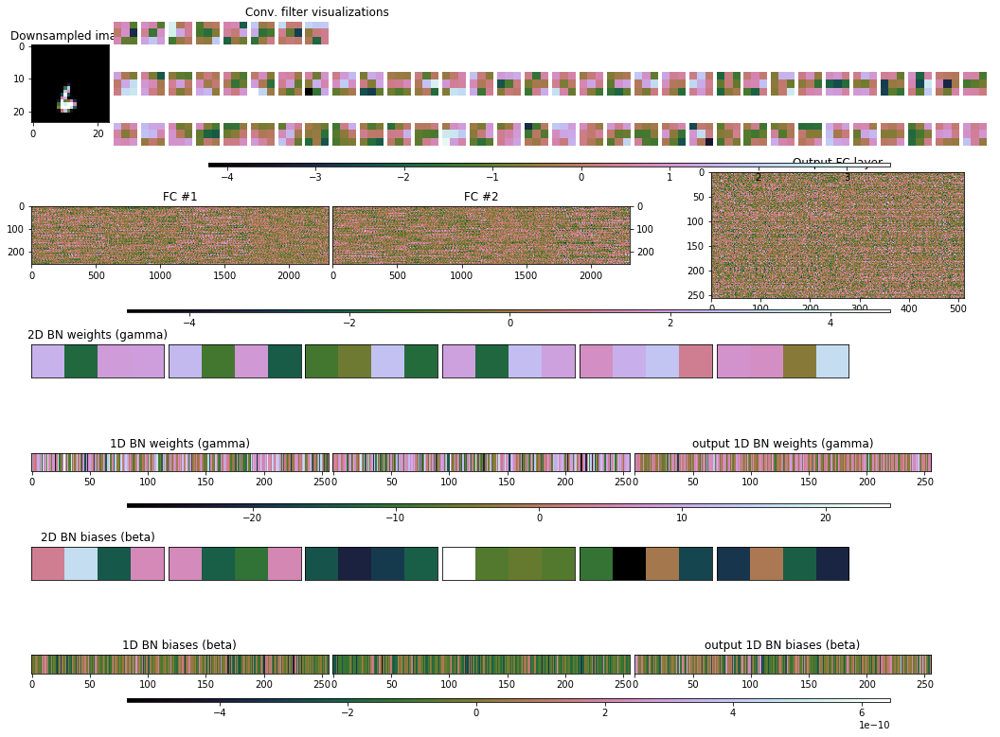


	Target class: 6 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.977, 1.000, 1.043, 0.944, 0.890, 0.906]


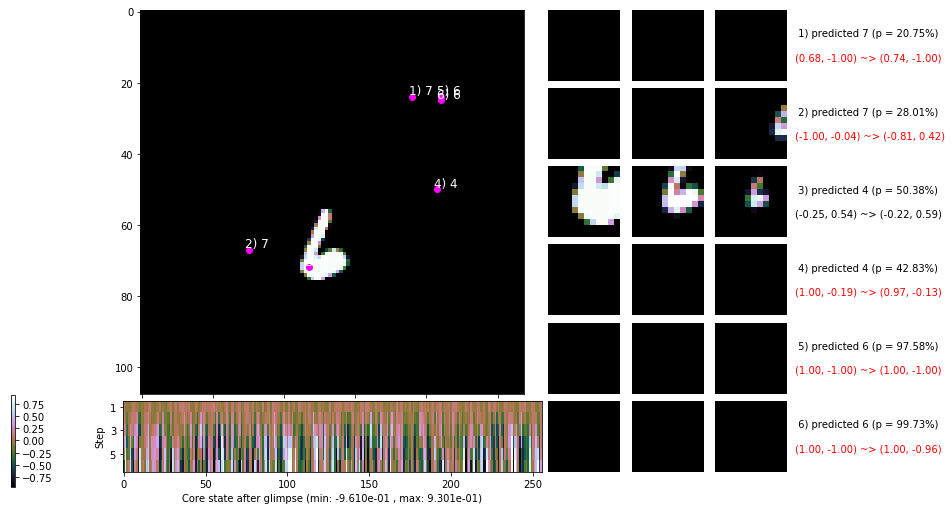

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


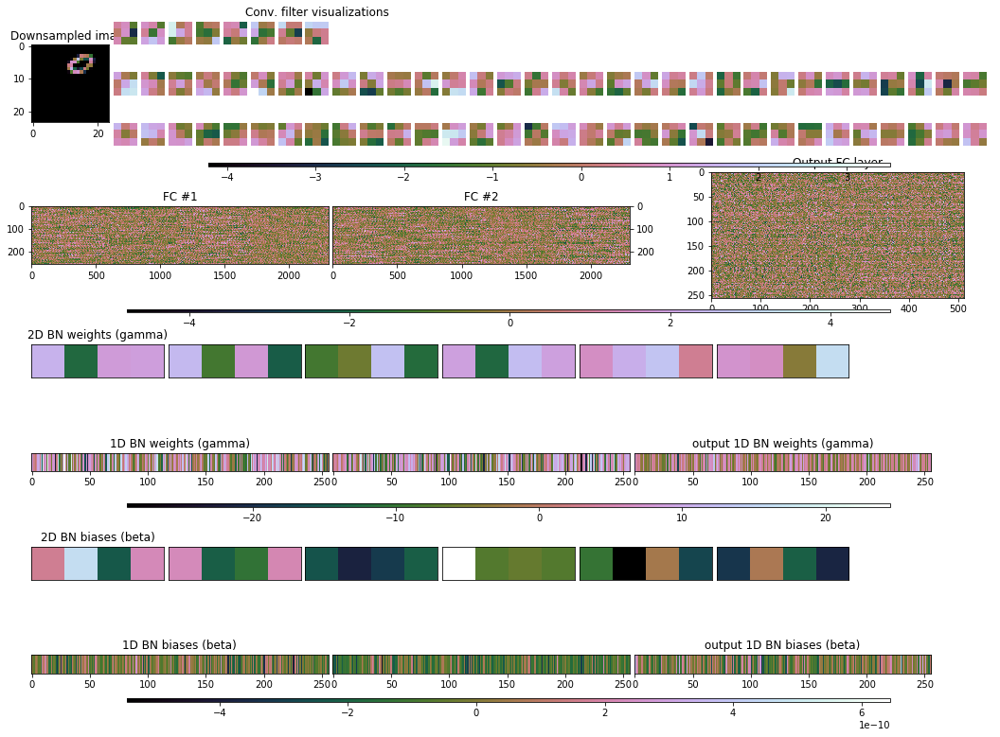


	Target class: 0 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


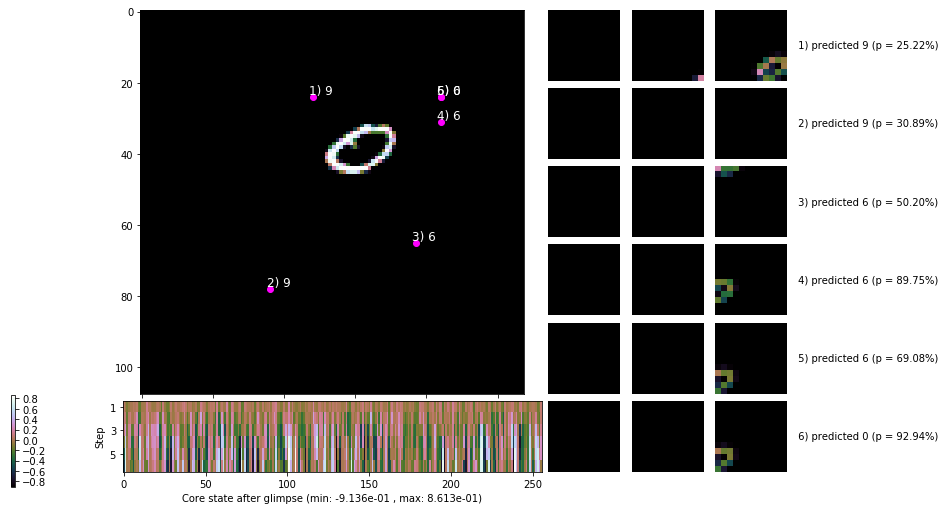

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


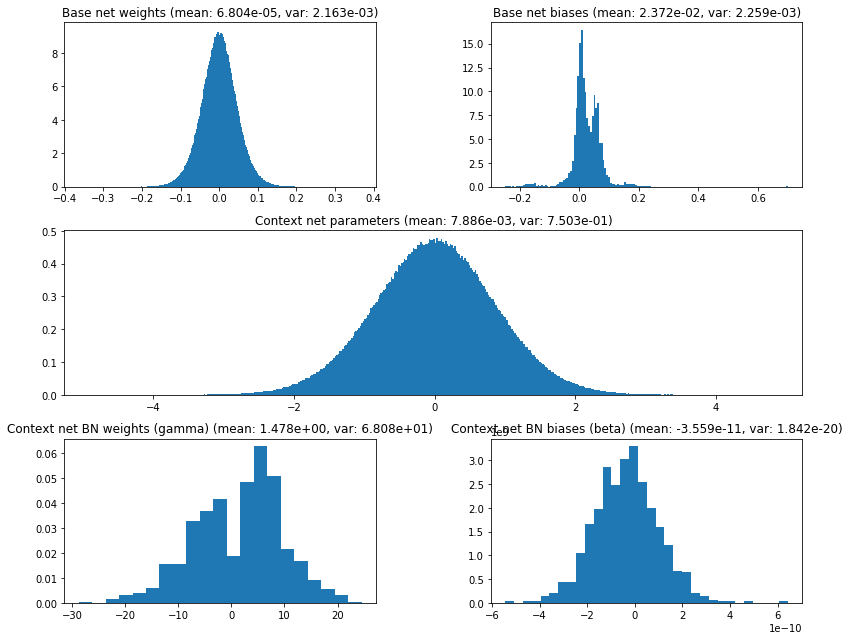

                                         Location network weights and biases


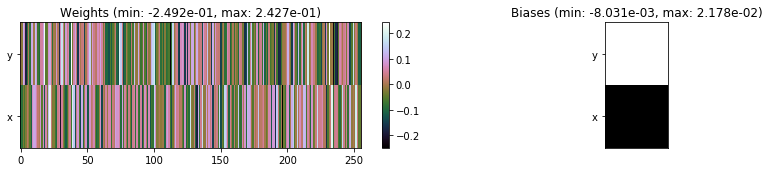

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1355.35 sec | TRAIN >> class loss: 0.2612 | steps:  3.822    | reward:  0.9333    | acc.: 93.332% 
                          | VAL   >> class loss: 0.1676 | steps:  3.672    | reward:  0.9572    | acc.: 95.720% 


Epoch  15/400) lr = 0.002319
 b   1000/  4000 >> 332.9 ms/b | lr: 5.77e-04 | grad 2norm:  8.10 | grad inf norm:  1.318
         Weights || abs max:  0.369 (27165.572) | mean:  6.882e-05 ( 0.071) | var: 2.163e-03 (22687.973)
          Biases || abs max:  0.702 (  256.716) | mean:  2.372e-02 ( 0.354) | var: 2.260e-03 ( 4178.439)
                    class loss: 0.251 | steps: 3.821 | reward:  0.935 | acc.: 93.49%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]

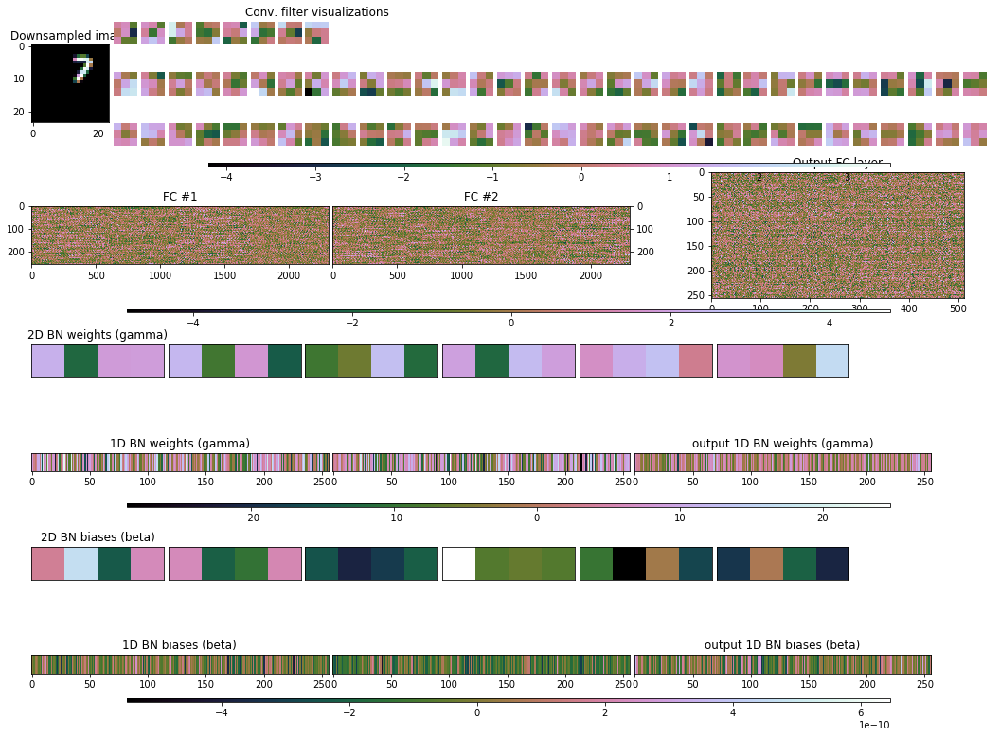


	Target class: 7 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.065, 0.881, 0.880, 0.864, 0.864, 0.847]


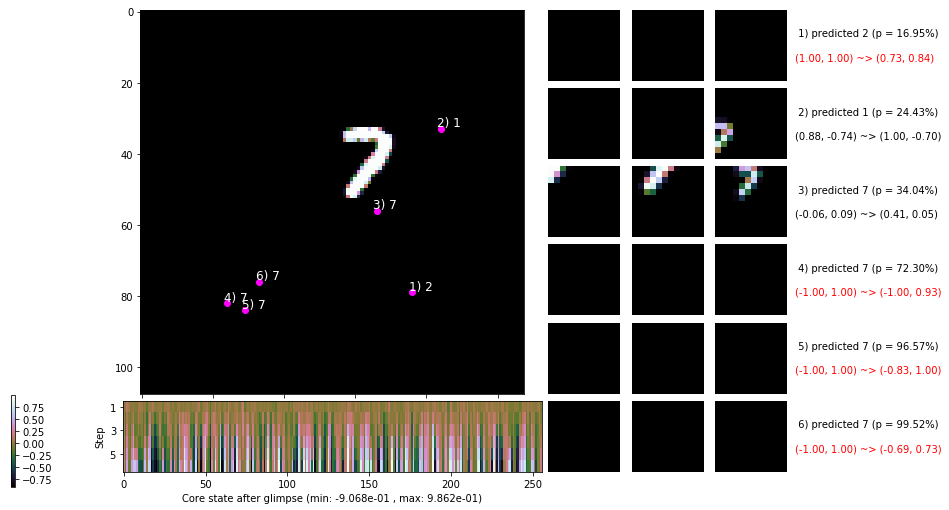

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 346.3 ms/b | lr: 5.22e-04 | grad 2norm:  7.90 | grad inf norm:  1.326
         Weights || abs max:  0.370 (25740.852) | mean:  6.939e-05 ( 0.070) | var: 2.167e-03 (16370.811)
          Biases || abs max:  0.704 (  180.376) | mean:  2.379e-02 ( 0.312) | var: 2.271e-03 (  305.341)
                    class loss: 0.249 | steps: 3.826 | reward:  0.936 | acc.: 93.58%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

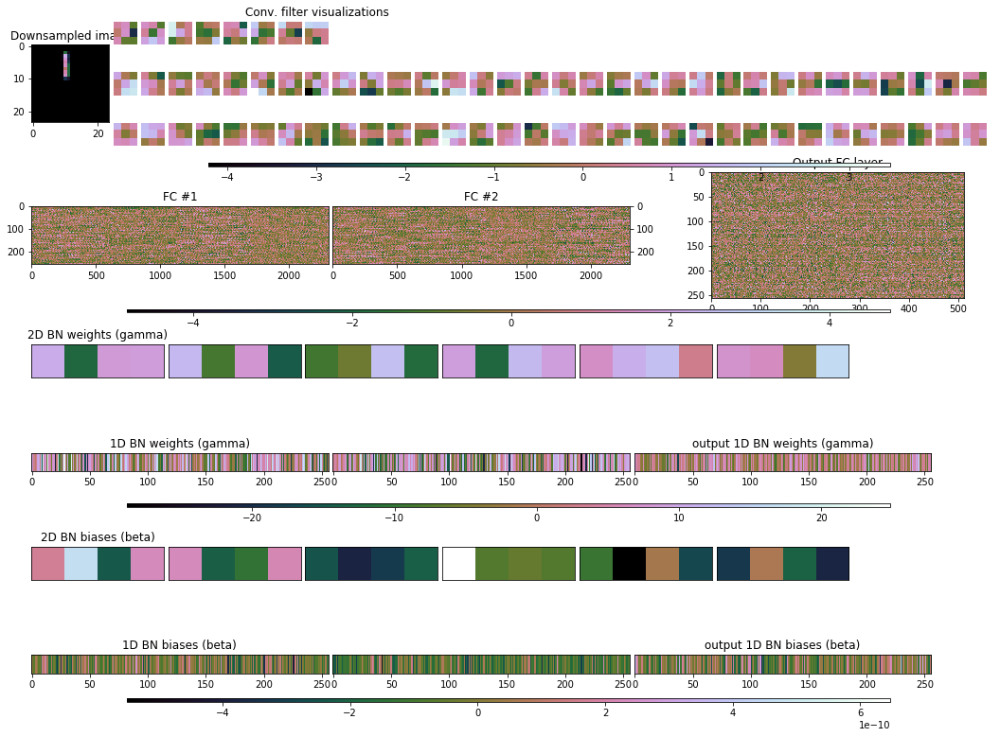


	Target class: 1 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.060, 0.989, 1.017, 1.040, 1.054, 1.025]


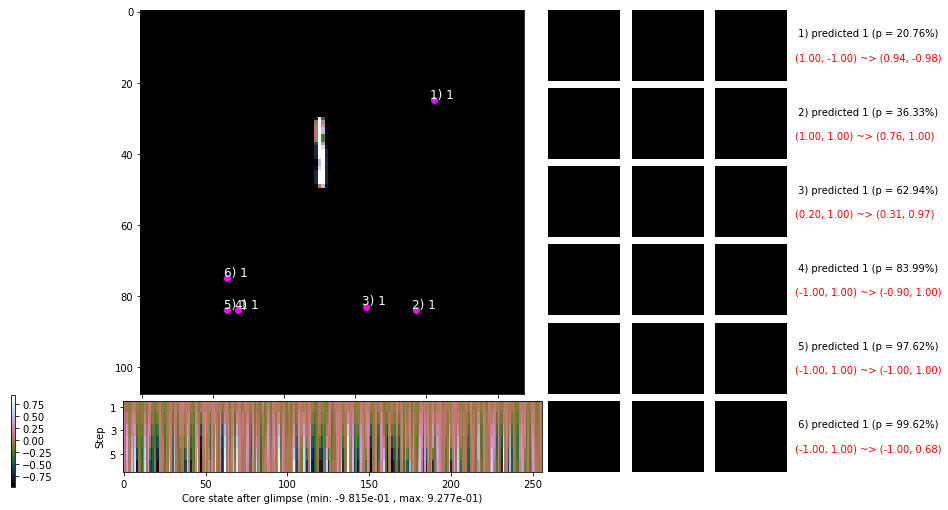

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


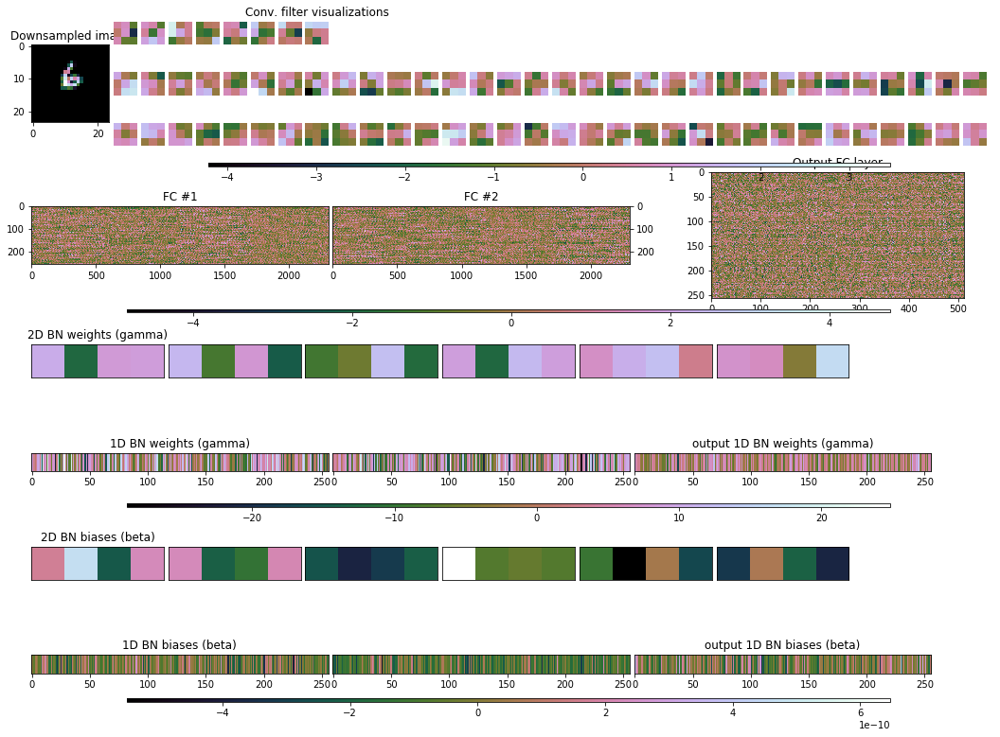


	Target class: 6 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


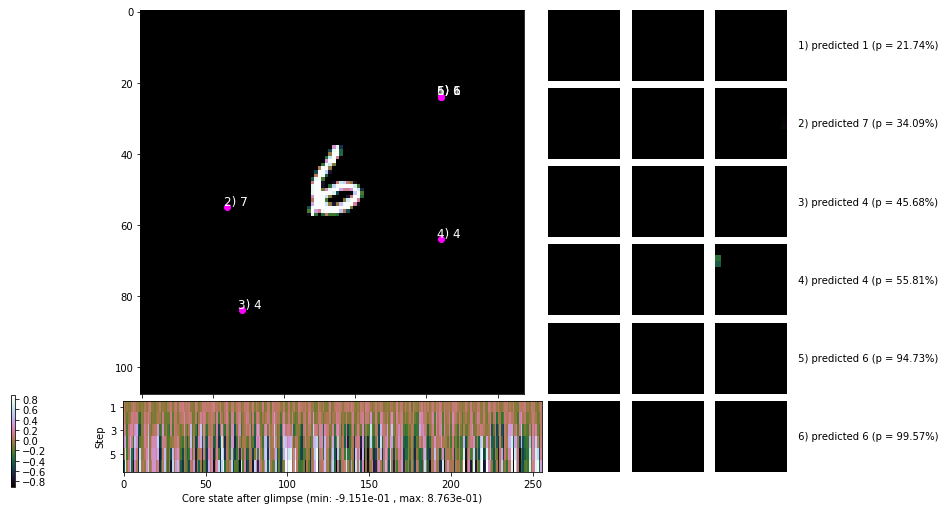

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


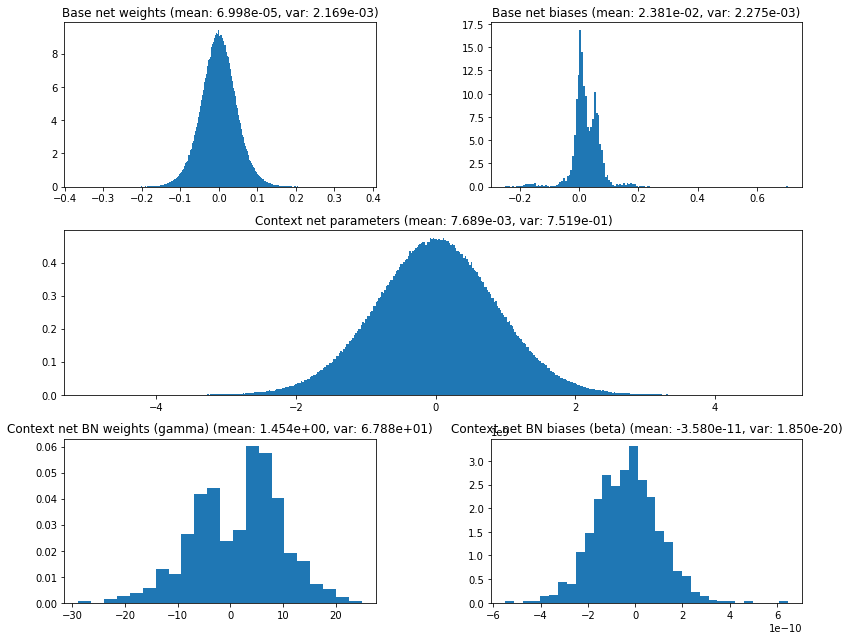

                                         Location network weights and biases


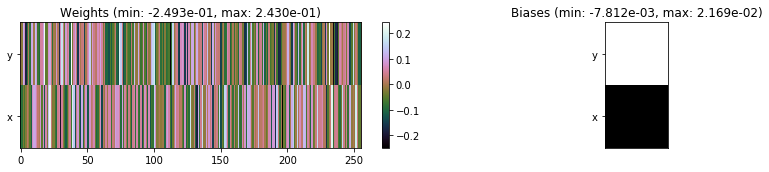

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1404.35 sec | TRAIN >> class loss: 0.2500 | steps:  3.814    | reward:  0.9359    | acc.: 93.593% 
                          | VAL   >> class loss: 0.1593 | steps:  3.658    | reward:  0.9588    | acc.: 95.880% 


Epoch  16/400) lr = 0.001898
 b   1000/  4000 >> 365.6 ms/b | lr: 4.72e-04 | grad 2norm:  7.82 | grad inf norm:  1.307
         Weights || abs max:  0.370 (23016.740) | mean:  6.980e-05 ( 0.066) | var: 2.170e-03 (10100.279)
          Biases || abs max:  0.706 (  194.202) | mean:  2.383e-02 ( 0.304) | var: 2.278e-03 (  188.325)
                    class loss: 0.252 | steps: 3.816 | reward:  0.935 | acc.: 93.50%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]

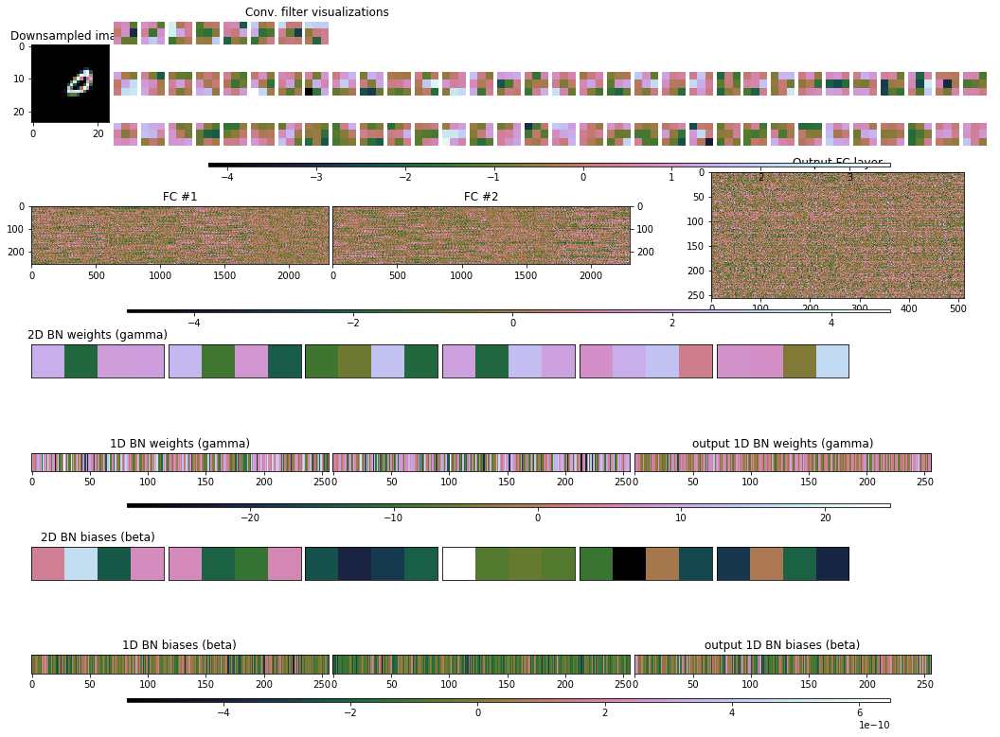


	Target class: 0 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.855, 0.933, 0.967, 0.891, 0.827, 0.806]


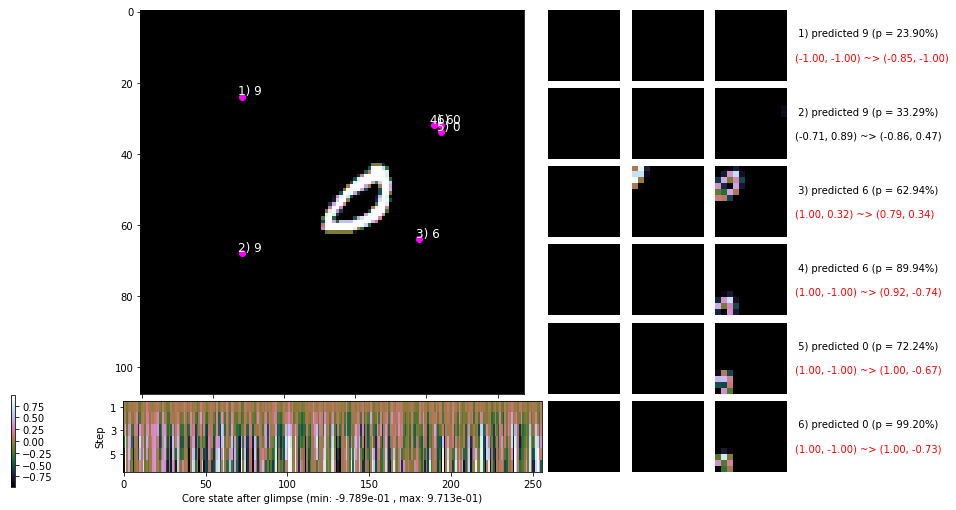

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 370.2 ms/b | lr: 4.27e-04 | grad 2norm:  7.91 | grad inf norm:  1.326
         Weights || abs max:  0.371 (20855.463) | mean:  7.028e-05 ( 0.066) | var: 2.173e-03 ( 3274.901)
          Biases || abs max:  0.707 (  944.418) | mean:  2.389e-02 ( 0.520) | var: 2.287e-03 ( 6582.766)
                    class loss: 0.250 | steps: 3.811 | reward:  0.937 | acc.: 93.69%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

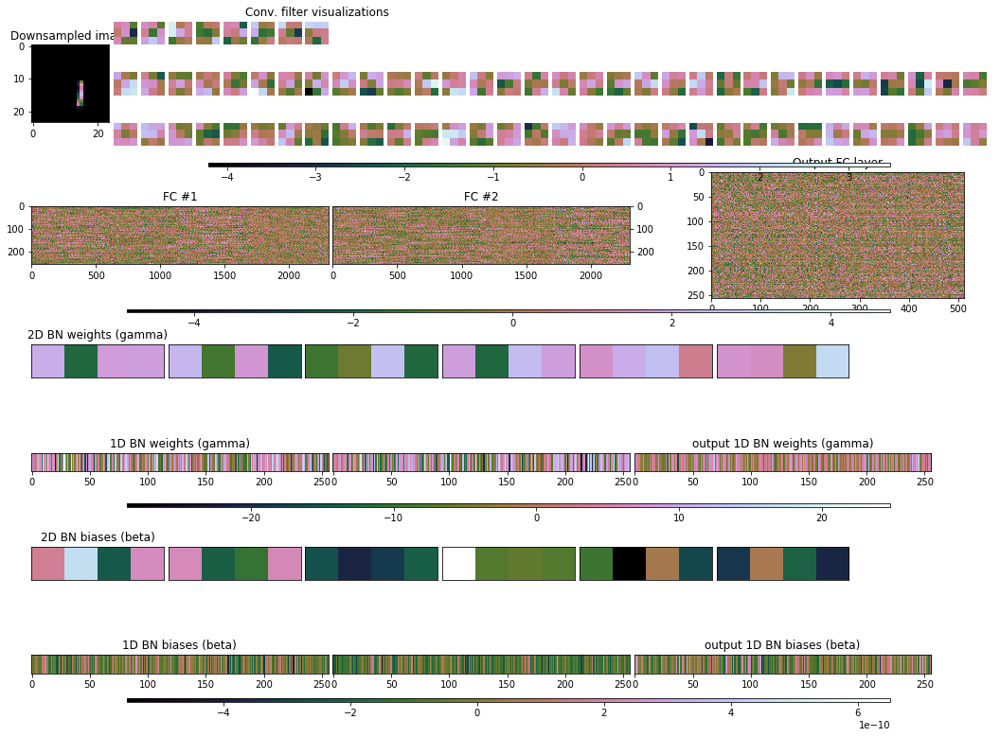


	Target class: 1 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.952, 0.958, 1.052, 1.093, 1.092, 1.049]


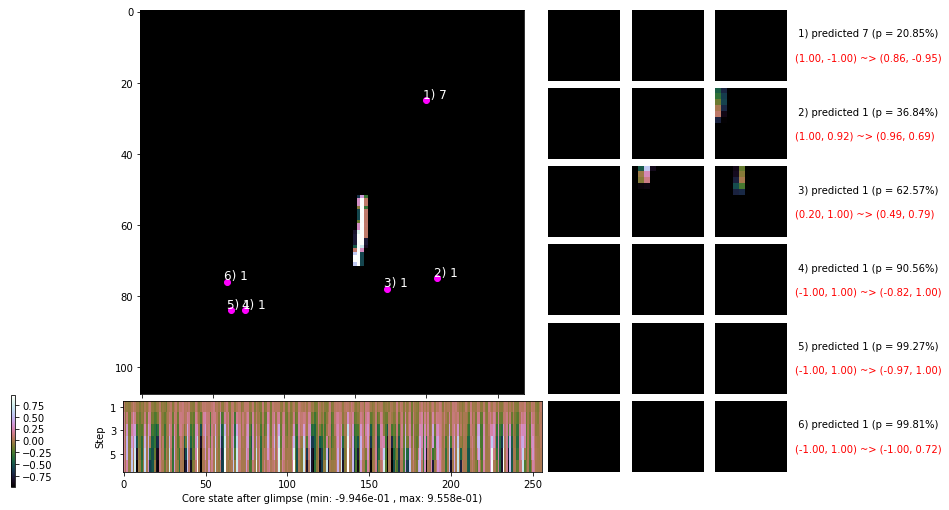

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


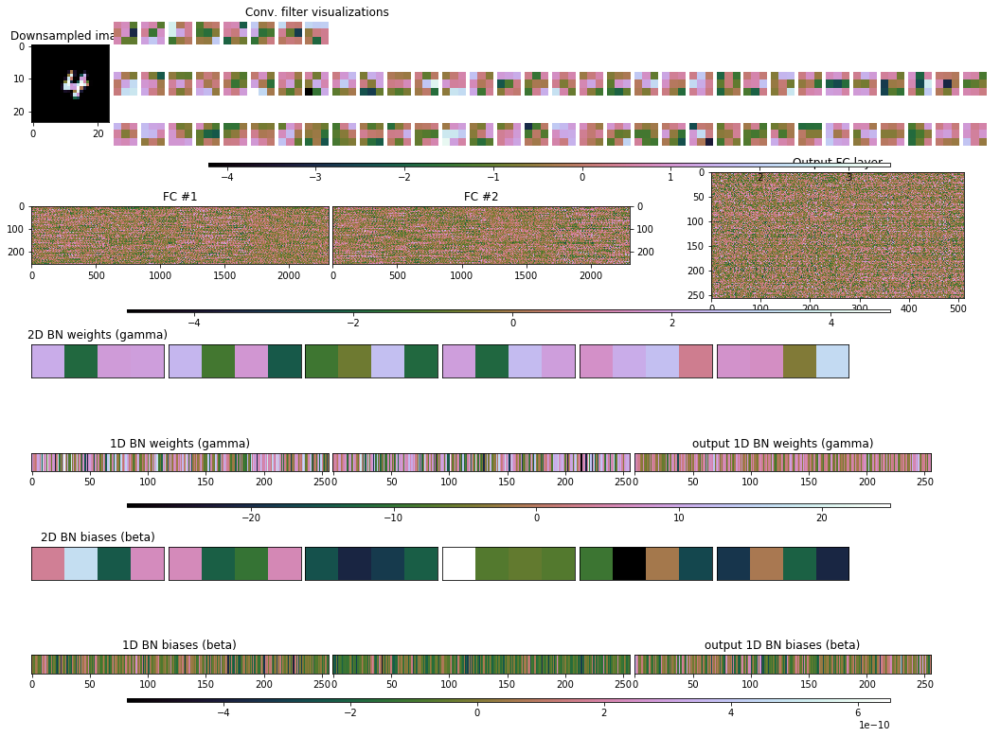


	Target class: 4 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


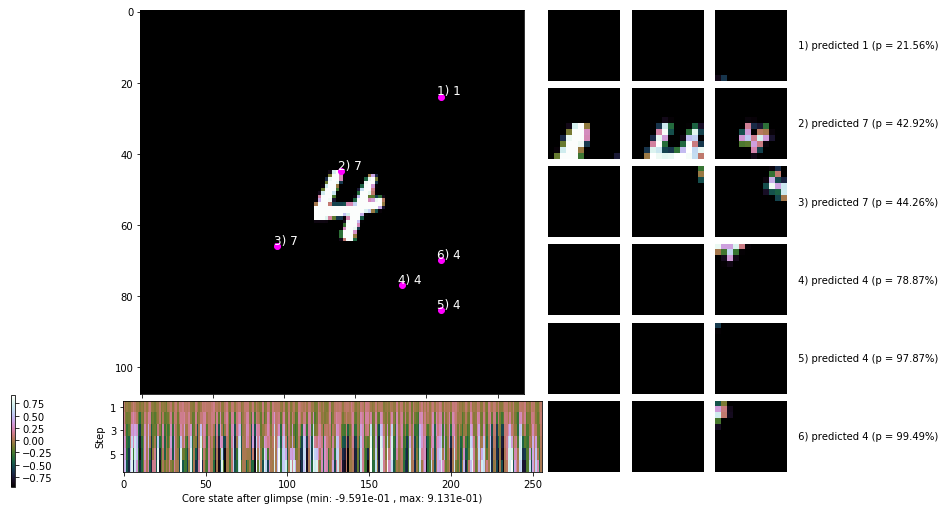

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


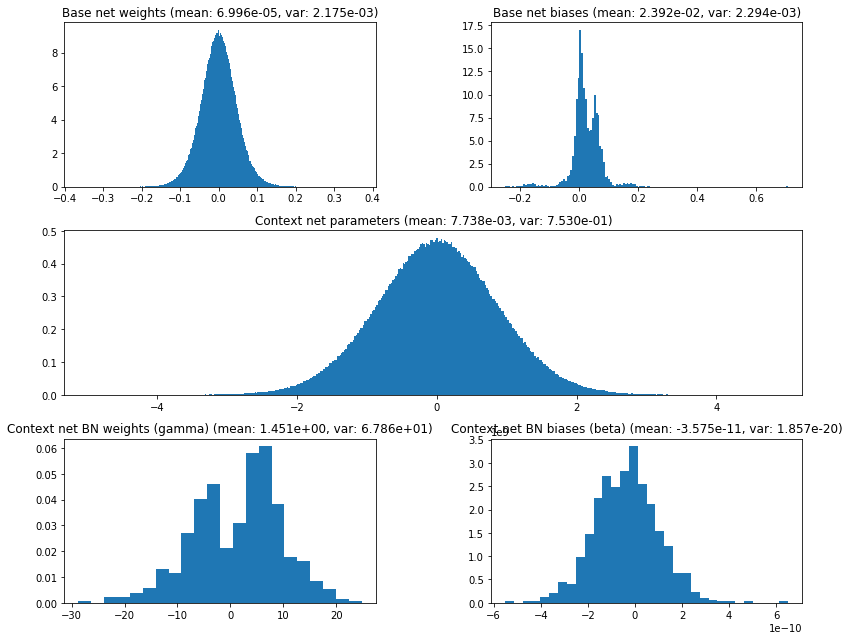

                                         Location network weights and biases


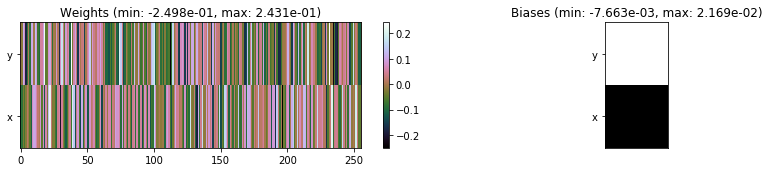

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1481.71 sec | TRAIN >> class loss: 0.2465 | steps:  3.813    | reward:  0.9371    | acc.: 93.707% 
                          | VAL   >> class loss: 0.1589 | steps:  3.648    | reward:  0.9582 :( | acc.: 95.820% :(


Epoch  17/400) lr = 0.001553
 b   1000/  4000 >> 363.8 ms/b | lr: 3.87e-04 | grad 2norm:  7.94 | grad inf norm:  1.325
         Weights || abs max:  0.371 (231549.219) | mean:  7.007e-05 ( 0.246) | var: 2.175e-03 (26506096.000)
          Biases || abs max:  0.708 (  285.543) | mean:  2.393e-02 ( 0.306) | var: 2.295e-03 (  339.982)
                    class loss: 0.239 | steps: 3.804 | reward:  0.937 | acc.: 93.72%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Si

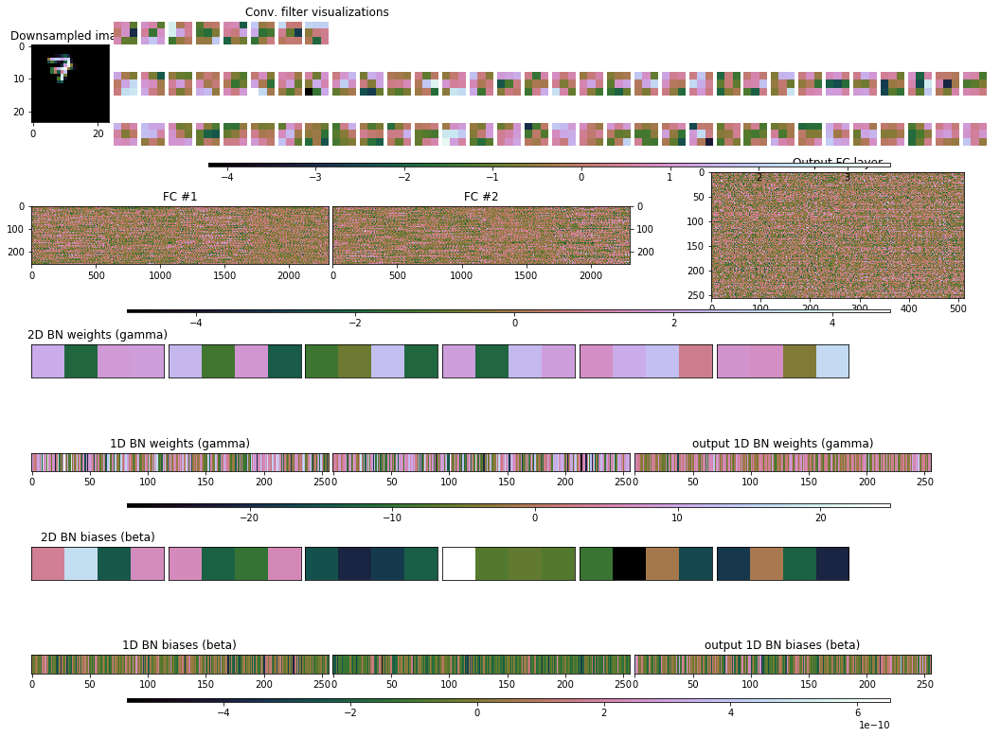


	Target class: 7 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.992, 0.951, 0.960, 0.981, 1.004, 0.989]


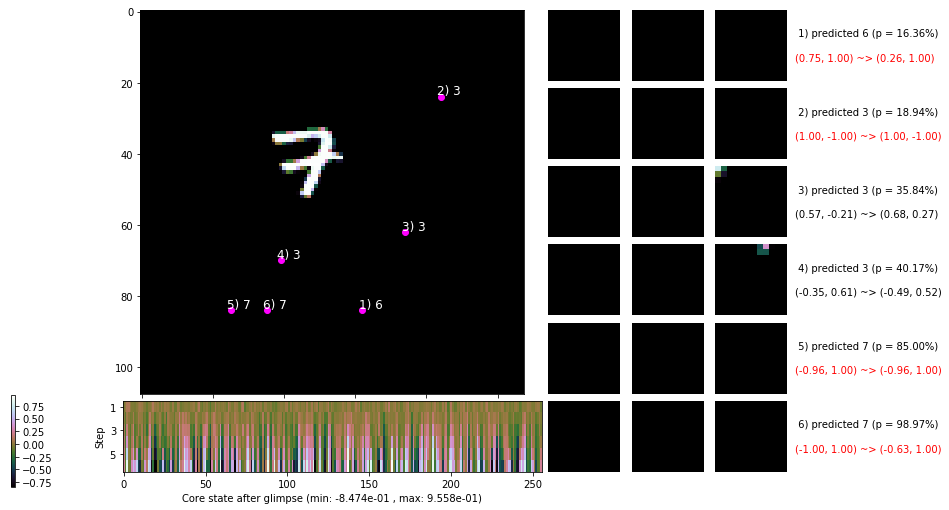

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 344.9 ms/b | lr: 3.50e-04 | grad 2norm:  7.94 | grad inf norm:  1.310
         Weights || abs max:  0.372 (74604.883) | mean:  7.001e-05 ( 0.110) | var: 2.178e-03 (1508874.250)
          Biases || abs max:  0.709 (  102.745) | mean:  2.397e-02 ( 0.247) | var: 2.301e-03 (    6.143)
                    class loss: 0.240 | steps: 3.803 | reward:  0.938 | acc.: 93.85%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0

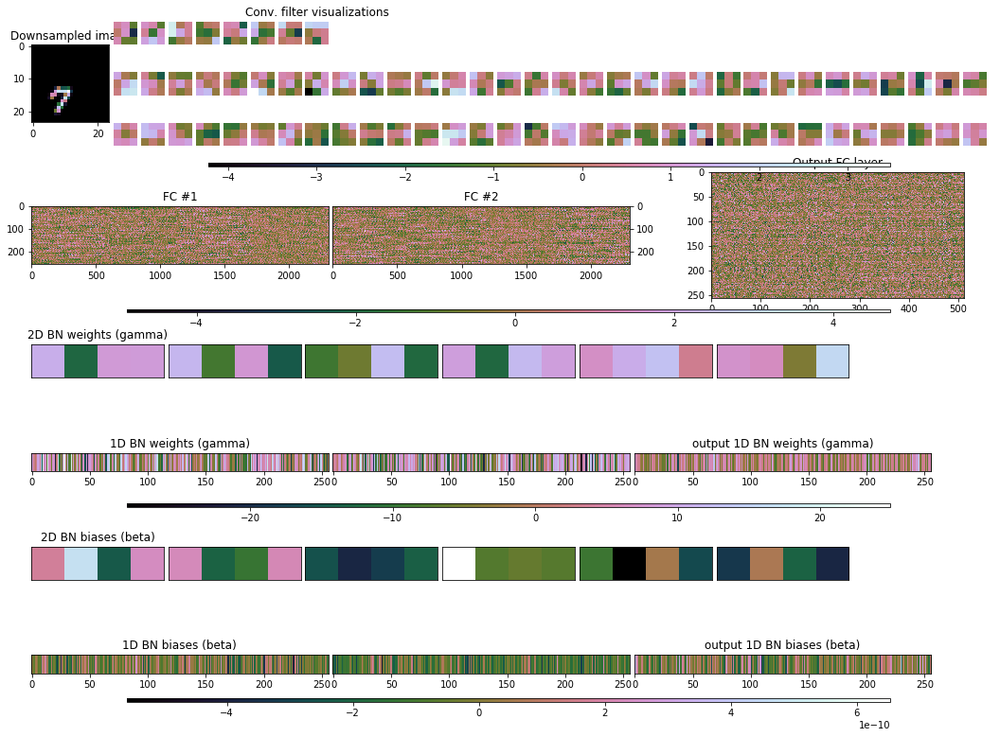


	Target class: 7 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.933, 0.949, 0.950, 0.957, 0.982, 0.978]


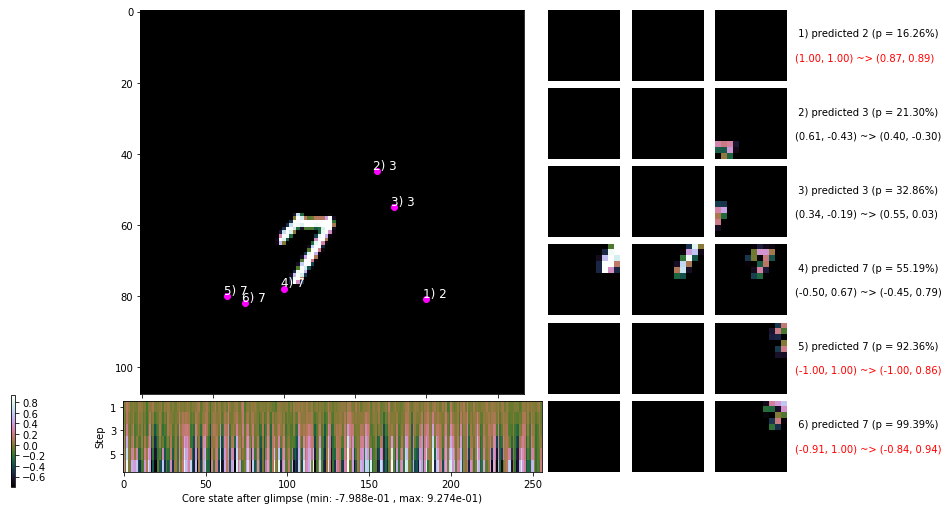

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


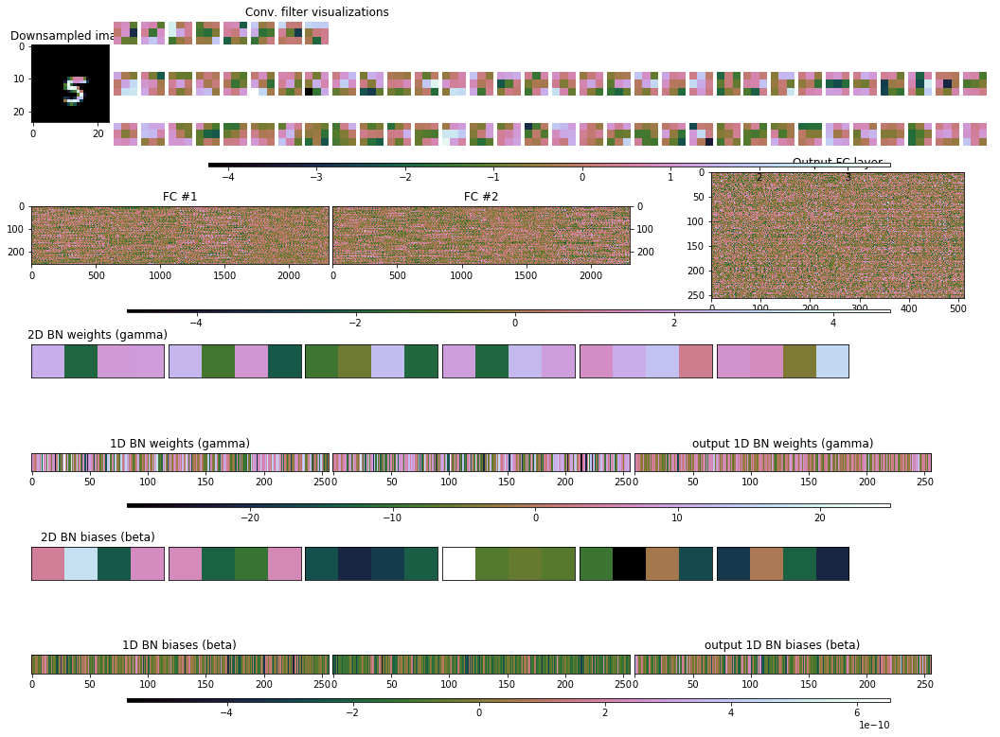


	Target class: 5 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


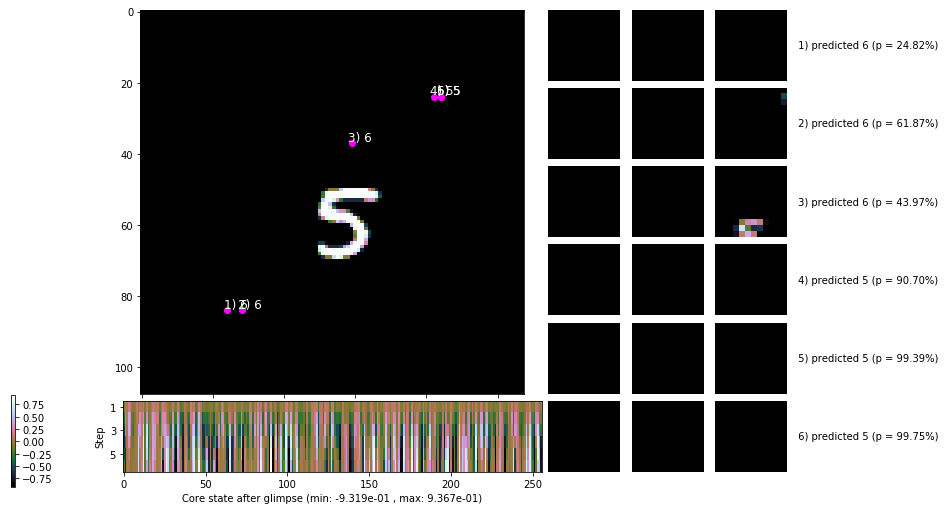

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


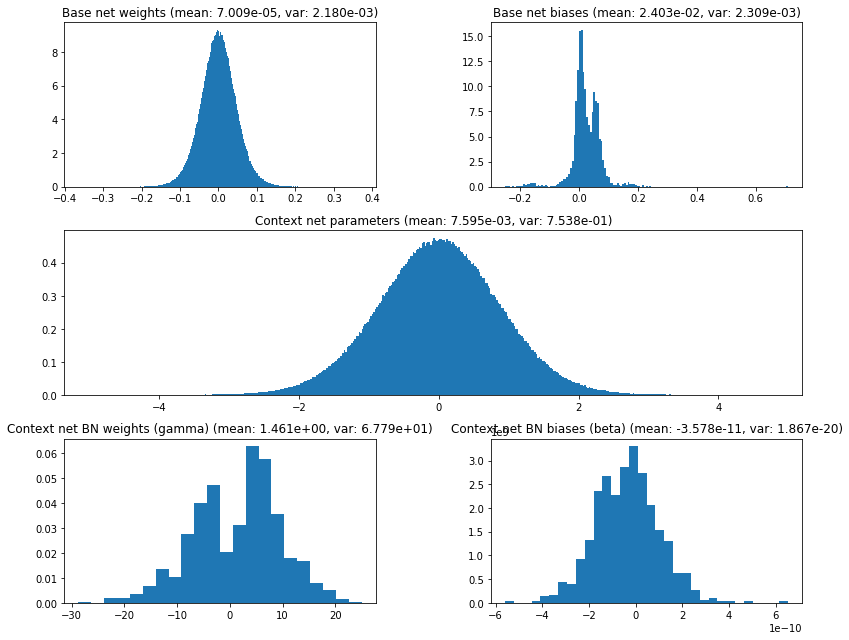

                                         Location network weights and biases


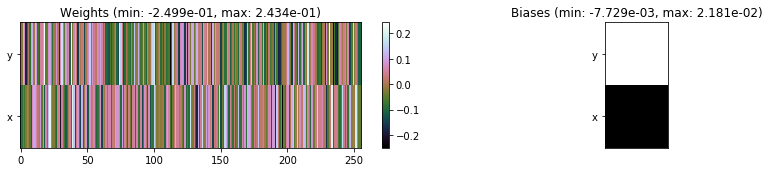

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1418.24 sec | TRAIN >> class loss: 0.2391 | steps:  3.805    | reward:  0.9388    | acc.: 93.883% 
                          | VAL   >> class loss: 0.1507 | steps:  3.655 :( | reward:  0.9588    | acc.: 95.880% 


Epoch  18/400) lr = 0.001271
 b   1000/  4000 >> 341.2 ms/b | lr: 3.16e-04 | grad 2norm:  7.87 | grad inf norm:  1.294
         Weights || abs max:  0.372 (21598.207) | mean:  7.042e-05 ( 0.067) | var: 2.181e-03 ( 8068.766)
          Biases || abs max:  0.710 (372601.188) | mean:  2.405e-02 (161.503) | var: 2.310e-03 (59902562304.000)
                    class loss: 0.237 | steps: 3.812 | reward:  0.939 | acc.: 93.93%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.

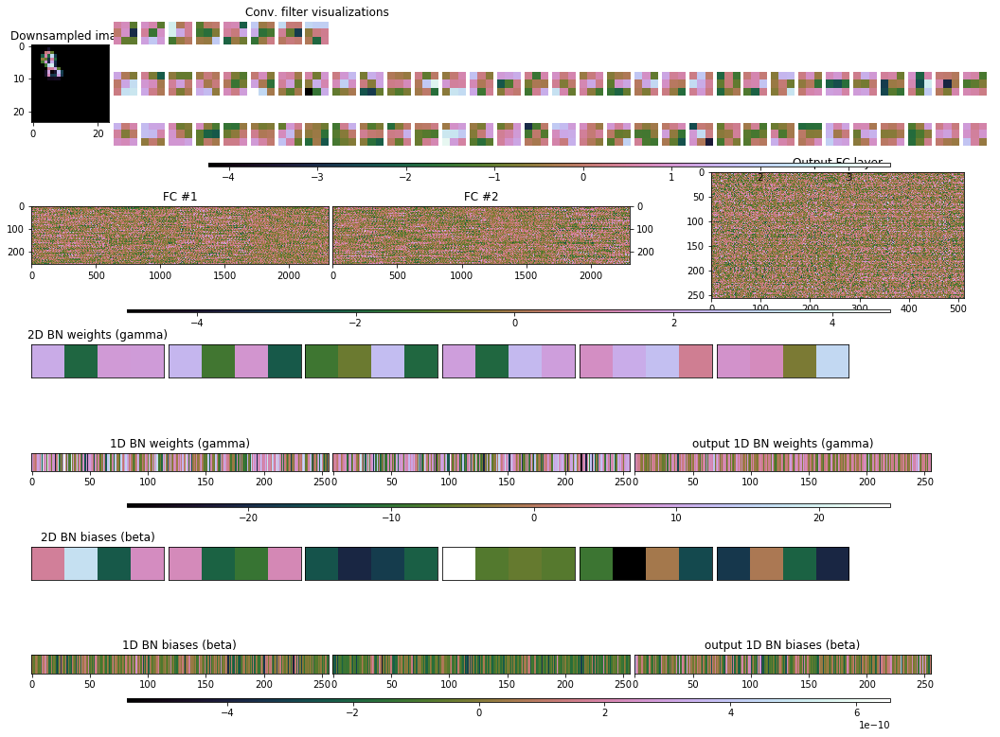


	Target class: 8 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.003, 0.938, 0.953, 0.959, 0.969, 0.977]


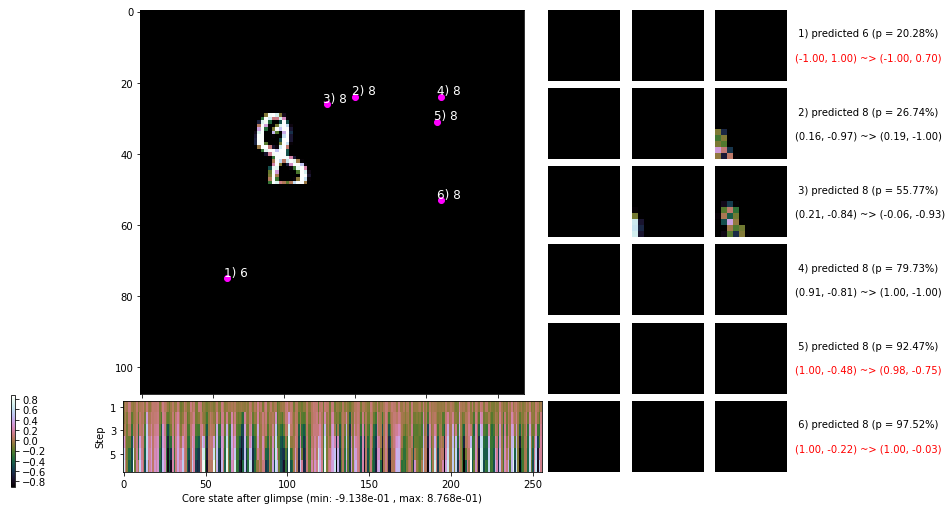

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 346.1 ms/b | lr: 2.86e-04 | grad 2norm:  8.03 | grad inf norm:  1.297
         Weights || abs max:  0.373 (38053.266) | mean:  7.115e-05 ( 0.085) | var: 2.182e-03 (39482.352)
          Biases || abs max:  0.711 (  201.872) | mean:  2.410e-02 ( 0.279) | var: 2.316e-03 (   31.861)
                    class loss: 0.237 | steps: 3.805 | reward:  0.941 | acc.: 94.09%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

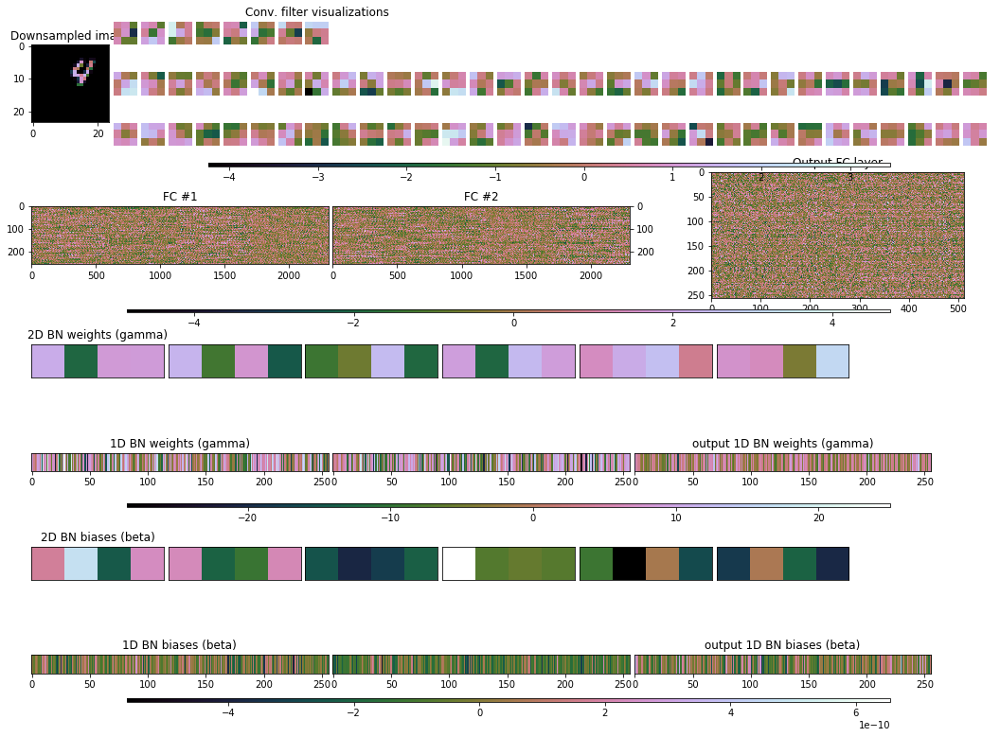


	Target class: 4 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.093, 1.001, 1.005, 1.010, 1.003, 0.989]


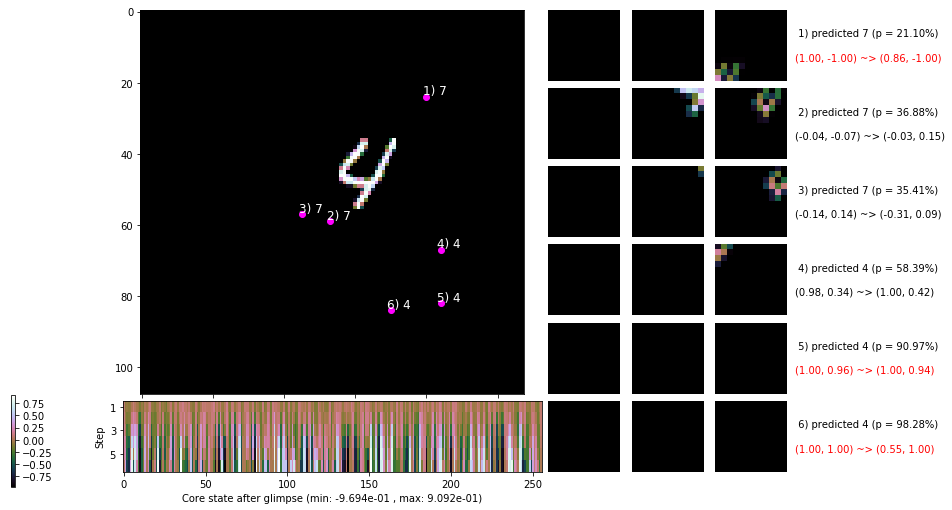

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


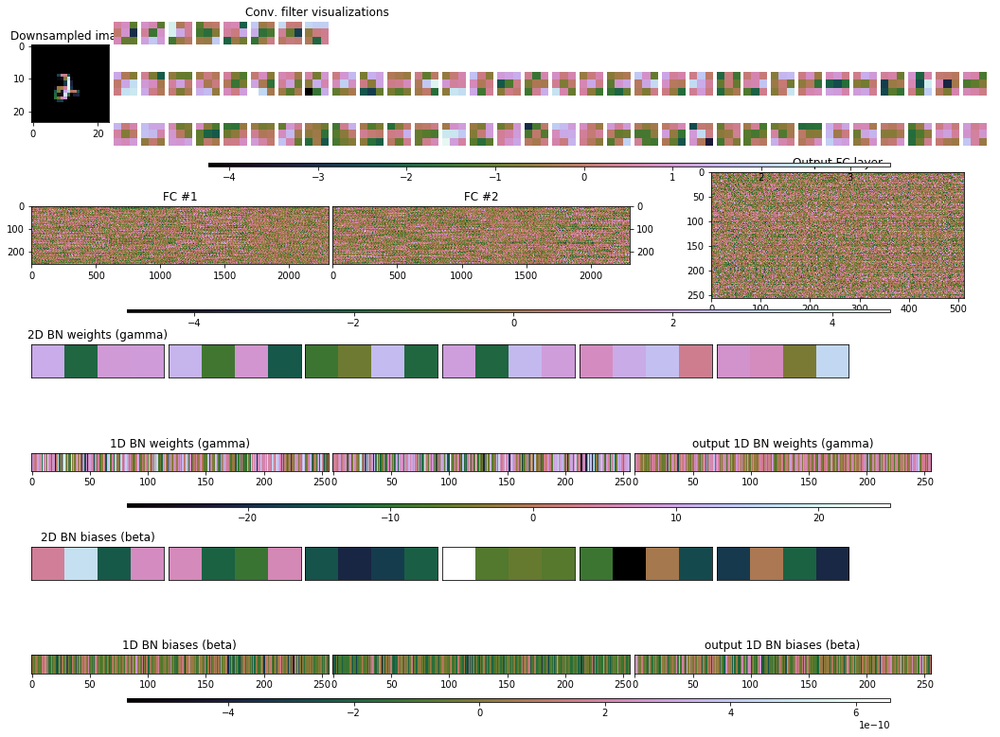


	Target class: 2 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


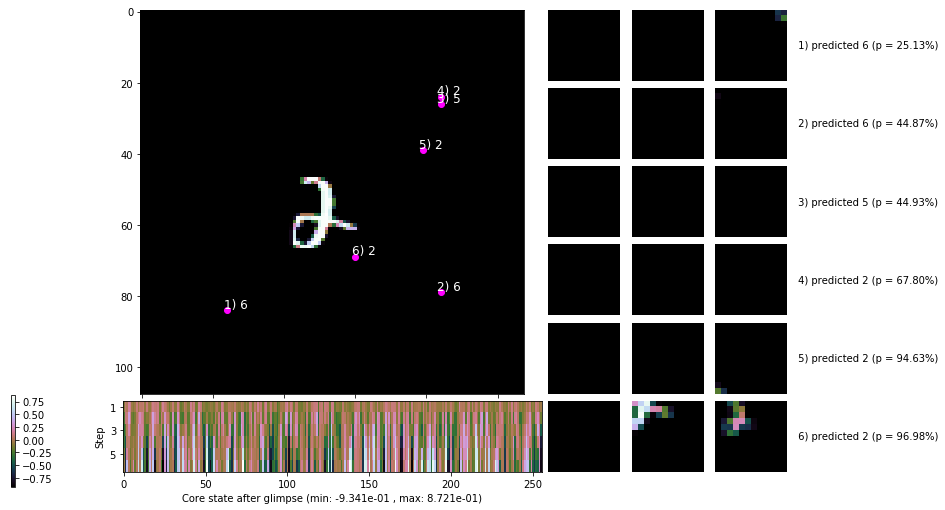

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


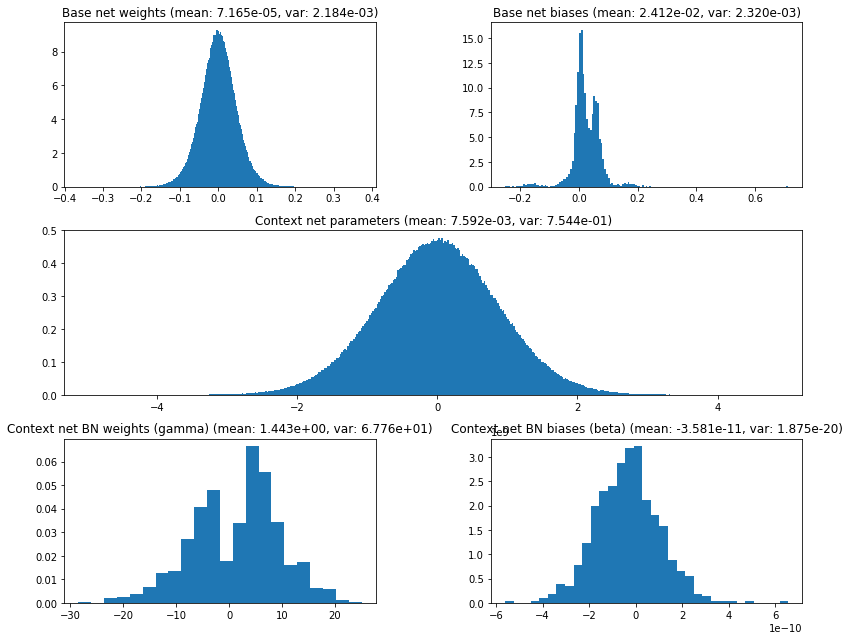

                                         Location network weights and biases


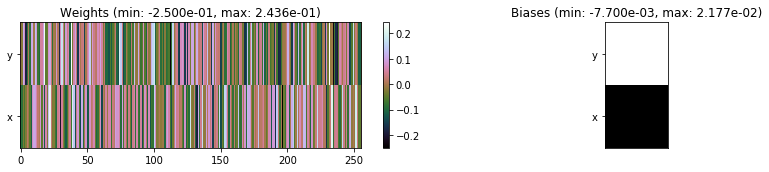

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1369.81 sec | TRAIN >> class loss: 0.2378 | steps:  3.806 :( | reward:  0.9400    | acc.: 94.001% 
                          | VAL   >> class loss: 0.1605 | steps:  3.656 :( | reward:  0.9618    | acc.: 96.180% 


Epoch  19/400) lr = 0.00104
 b   1000/  4000 >> 341.9 ms/b | lr: 2.59e-04 | grad 2norm:  7.96 | grad inf norm:  1.310
         Weights || abs max:  0.373 (23172.719) | mean:  7.155e-05 ( 0.070) | var: 2.184e-03 ( 8892.008)
          Biases || abs max:  0.712 (  136.824) | mean:  2.412e-02 ( 0.295) | var: 2.322e-03 (  129.049)
                    class loss: 0.240 | steps: 3.837 | reward:  0.938 | acc.: 93.85%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4])

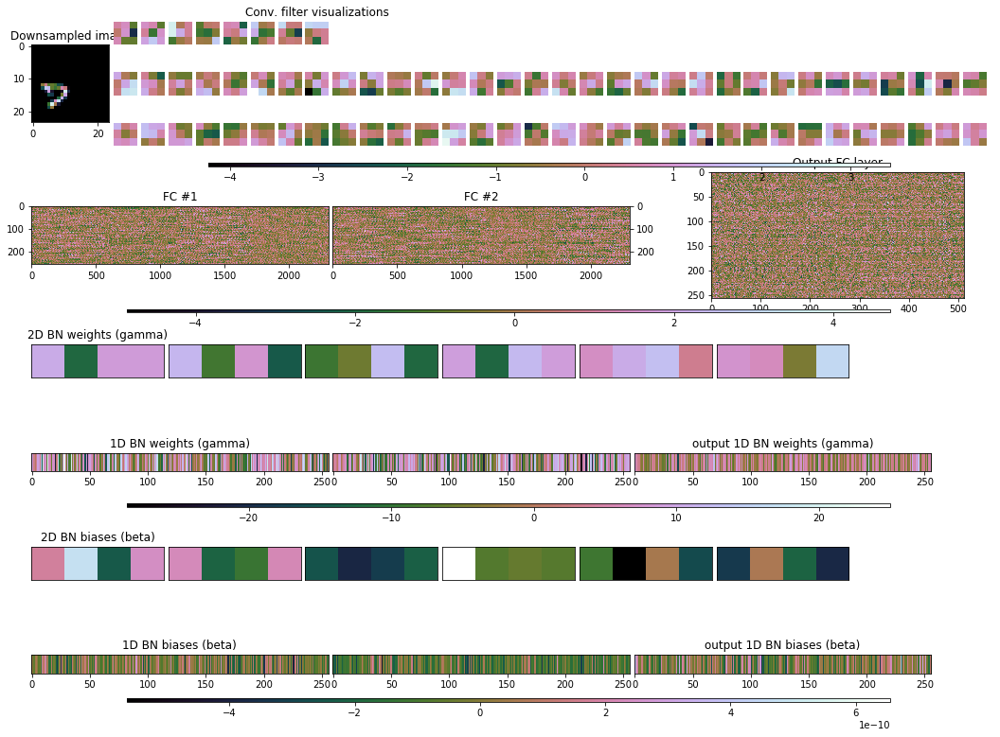


	Target class: 7 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.986, 0.944, 0.944, 0.956, 0.987, 0.993]


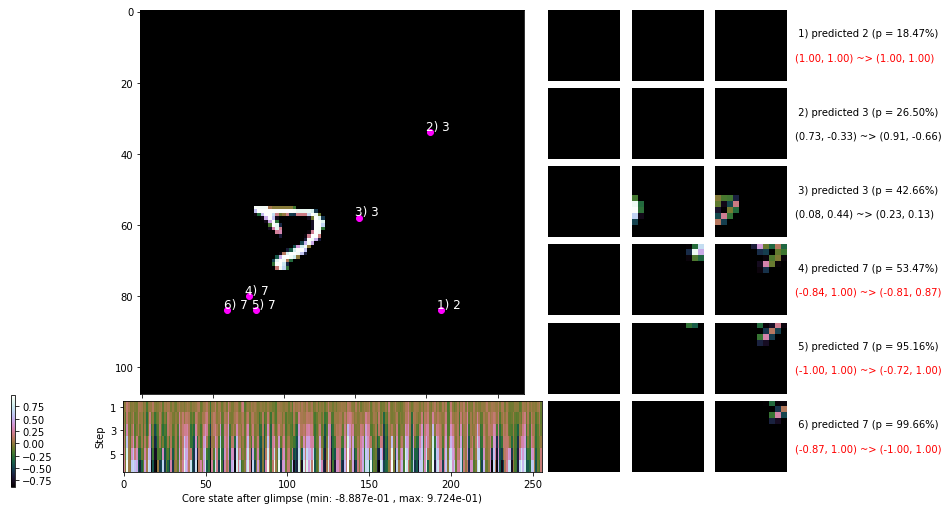

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 346.5 ms/b | lr: 2.34e-04 | grad 2norm:  8.19 | grad inf norm:  1.312
         Weights || abs max:  0.373 (23484.408) | mean:  7.233e-05 ( 0.066) | var: 2.186e-03 (44915.984)
          Biases || abs max:  0.713 (   69.679) | mean:  2.414e-02 ( 0.246) | var: 2.326e-03 (    3.466)
                    class loss: 0.239 | steps: 3.803 | reward:  0.937 | acc.: 93.74%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

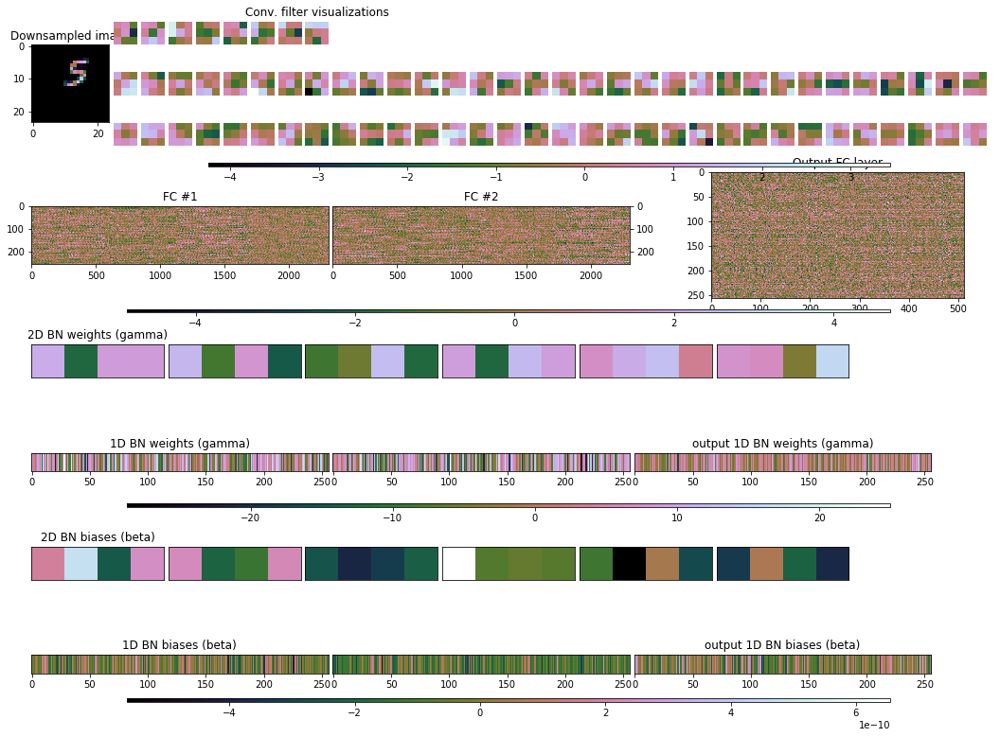


	Target class: 5 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.098, 0.963, 0.979, 0.938, 0.903, 0.896]


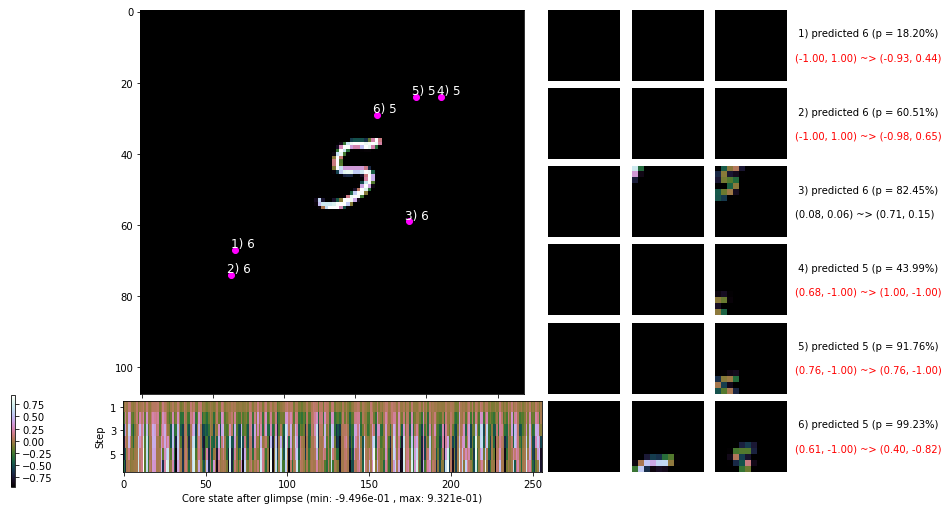

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


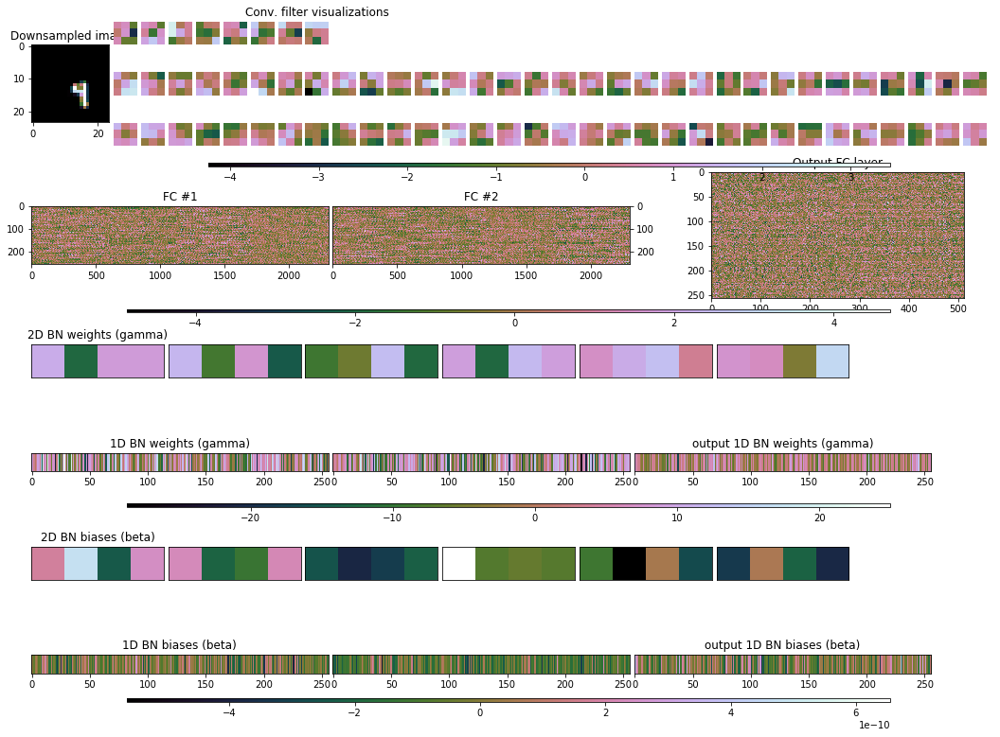


	Target class: 4 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


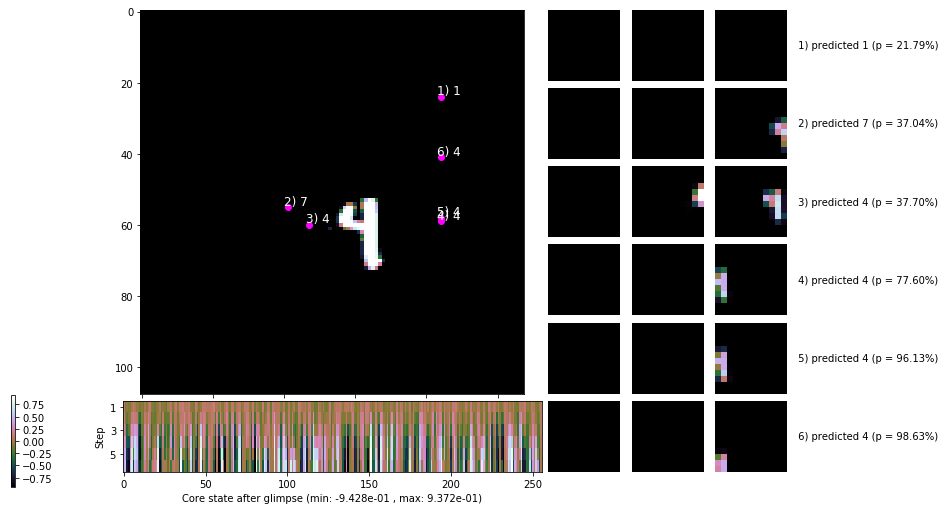

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


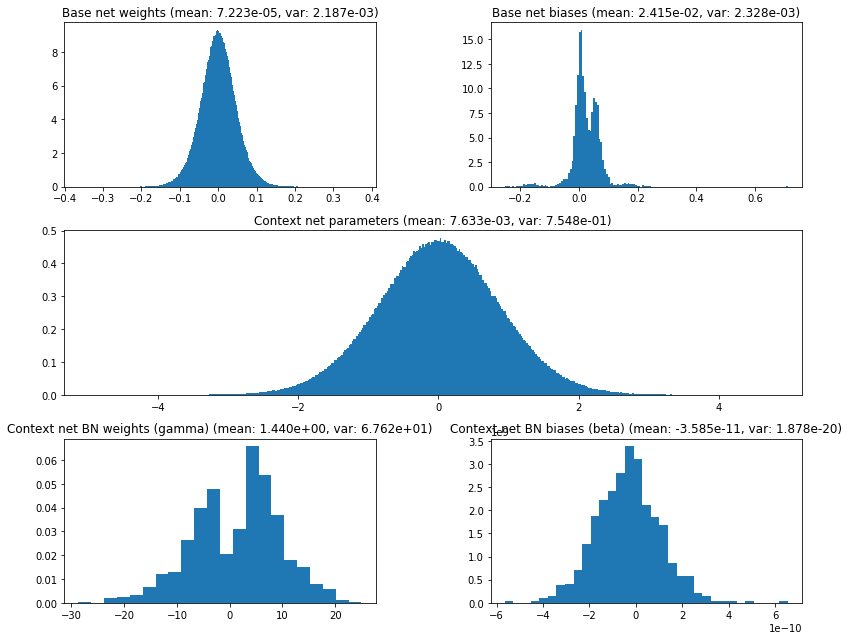

                                         Location network weights and biases


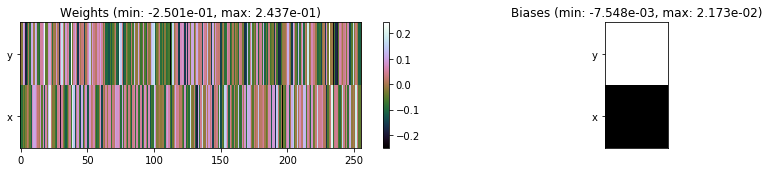

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1371.24 sec | TRAIN >> class loss: 0.2387 | steps:  3.814 :( | reward:  0.9387 :( | acc.: 93.874% :(
                          | VAL   >> class loss: 0.1475 | steps:  3.660 :( | reward:  0.9610 :( | acc.: 96.100% :(


Epoch  20/400) lr = 0.000851
 b   1000/  4000 >> 333.9 ms/b | lr: 2.12e-04 | grad 2norm:  7.81 | grad inf norm:  1.289
         Weights || abs max:  0.373 (28740.021) | mean:  7.236e-05 ( 0.076) | var: 2.187e-03 ( 8389.157)
          Biases || abs max:  0.713 ( 1904.109) | mean:  2.416e-02 ( 1.062) | var: 2.330e-03 (331336.969)
                    class loss: 0.232 | steps: 3.811 | reward:  0.942 | acc.: 94.17%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Siz

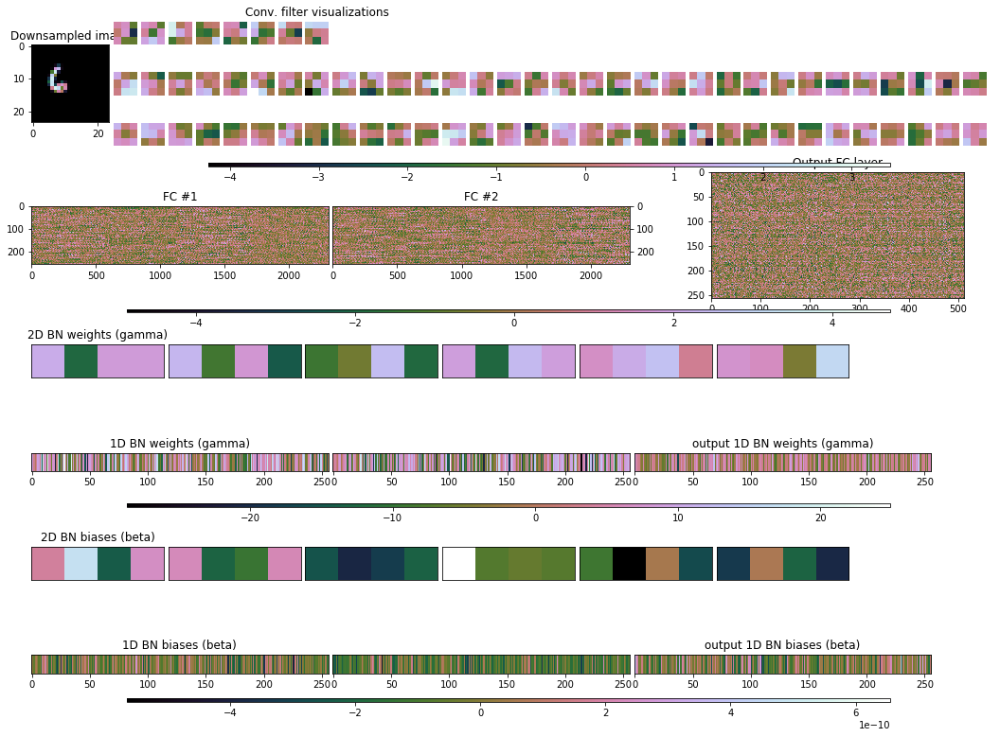


	Target class: 6 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.942, 0.875, 0.878, 0.856, 0.827, 0.845]


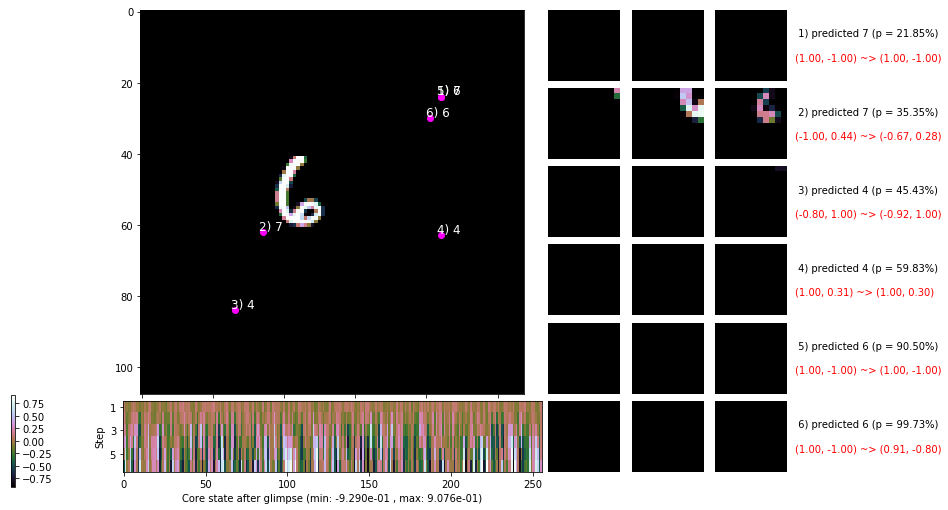

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 340.8 ms/b | lr: 1.92e-04 | grad 2norm:  8.06 | grad inf norm:  1.318
         Weights || abs max:  0.374 (28937.758) | mean:  7.243e-05 ( 0.075) | var: 2.188e-03 (14136.319)
          Biases || abs max:  0.714 (  170.267) | mean:  2.419e-02 ( 0.311) | var: 2.334e-03 (  787.718)
                    class loss: 0.239 | steps: 3.824 | reward:  0.939 | acc.: 93.86%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

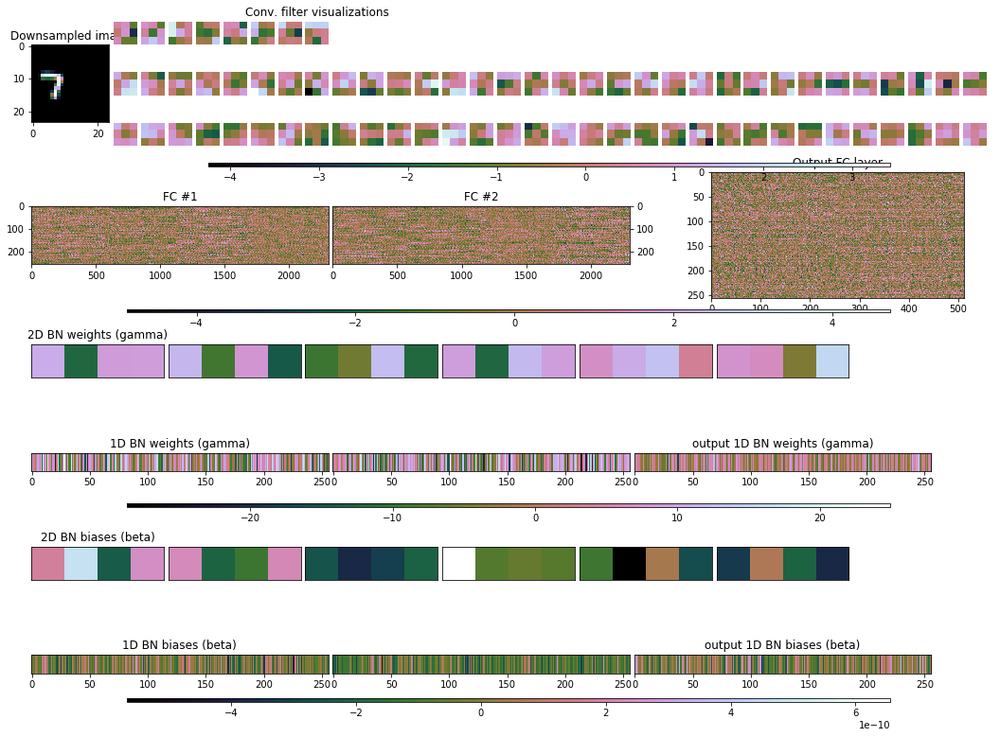


	Target class: 7 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.968, 0.907, 0.925, 0.932, 0.955, 0.972]


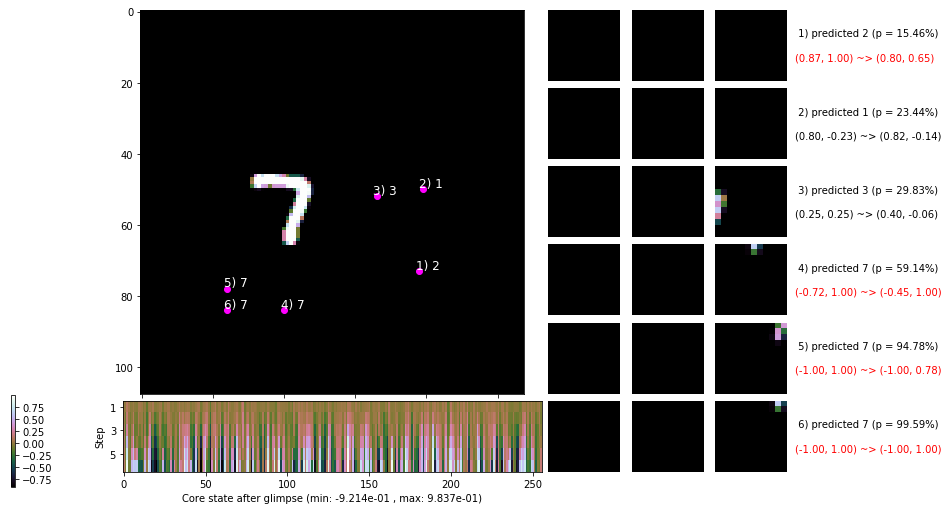

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


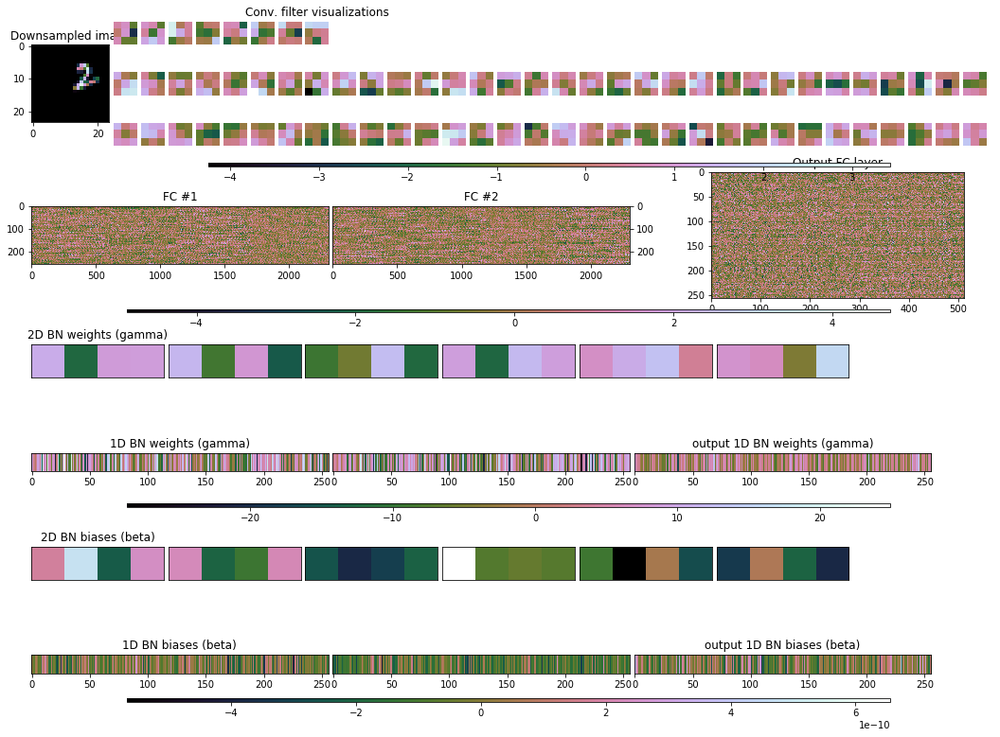


	Target class: 2 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


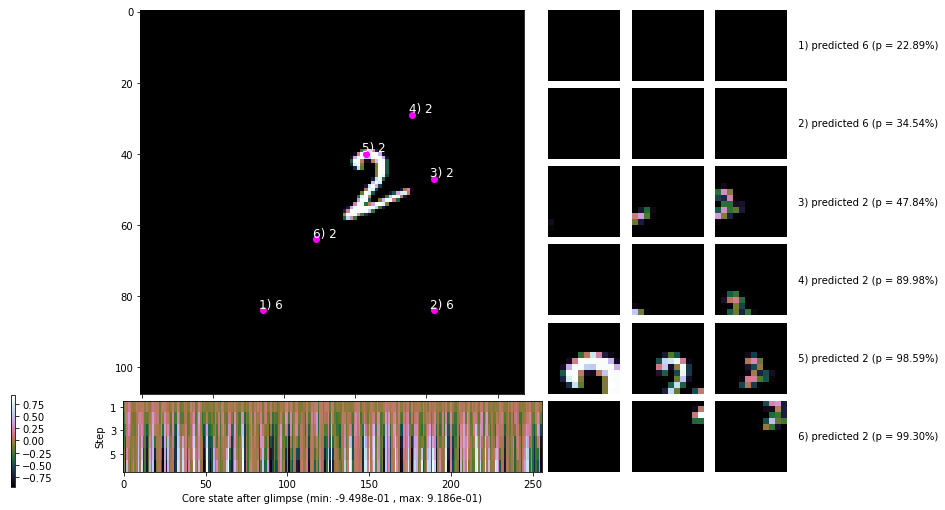

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


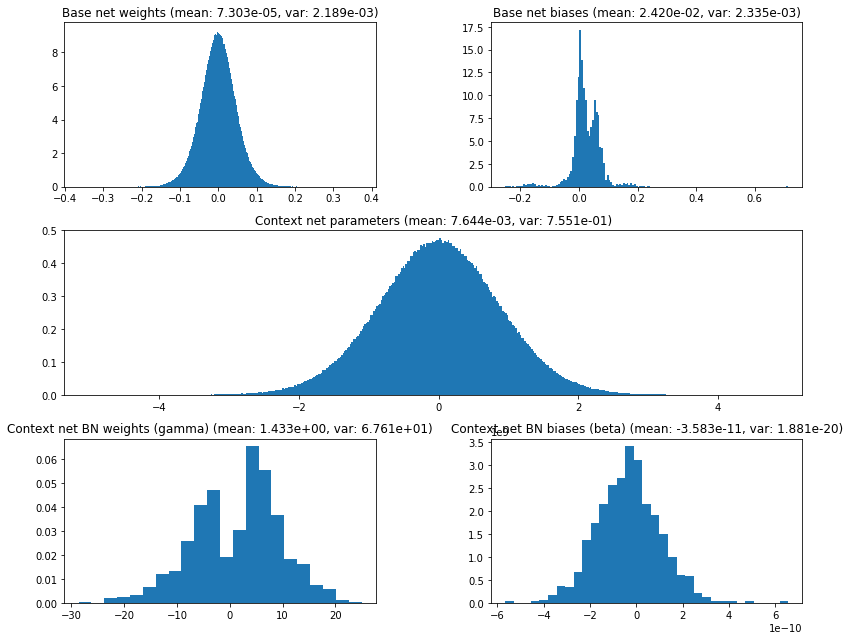

                                         Location network weights and biases


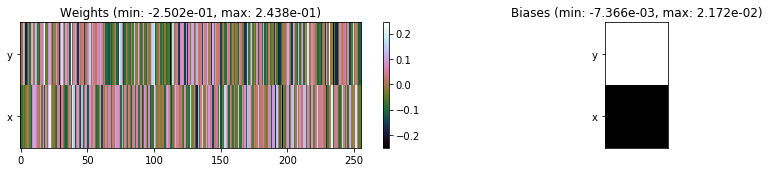

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1355.06 sec | TRAIN >> class loss: 0.2381 | steps:  3.817 :( | reward:  0.9396 :( | acc.: 93.958% :(
                          | VAL   >> class loss: 0.1550 | steps:  3.670 :( | reward:  0.9602 :( | acc.: 96.020% :(


Epoch  21/400) lr = 0.0006964
 b   1000/  4000 >> 336.1 ms/b | lr: 1.73e-04 | grad 2norm:  8.31 | grad inf norm:  1.317
         Weights || abs max:  0.374 (137462.797) | mean:  7.298e-05 ( 0.167) | var: 2.189e-03 (10108317.000)
          Biases || abs max:  0.714 (  186.964) | mean:  2.421e-02 ( 0.309) | var: 2.337e-03 (  406.989)
                    class loss: 0.232 | steps: 3.819 | reward:  0.940 | acc.: 93.97%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch

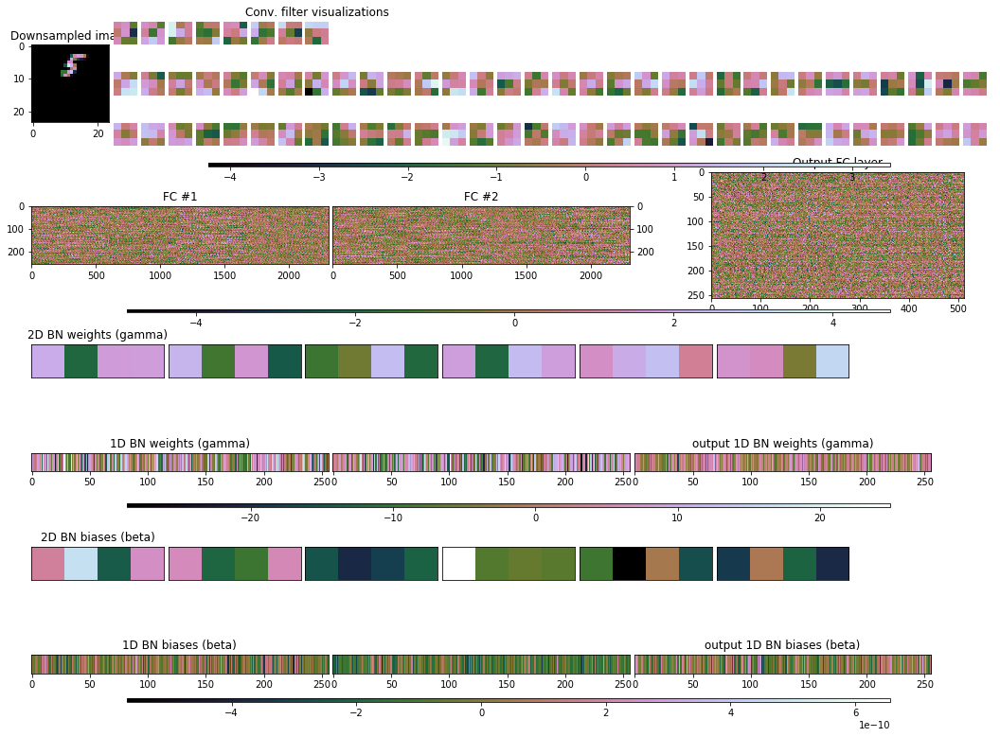


	Target class: 5 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.994, 0.917, 0.987, 0.998, 0.970, 0.963]


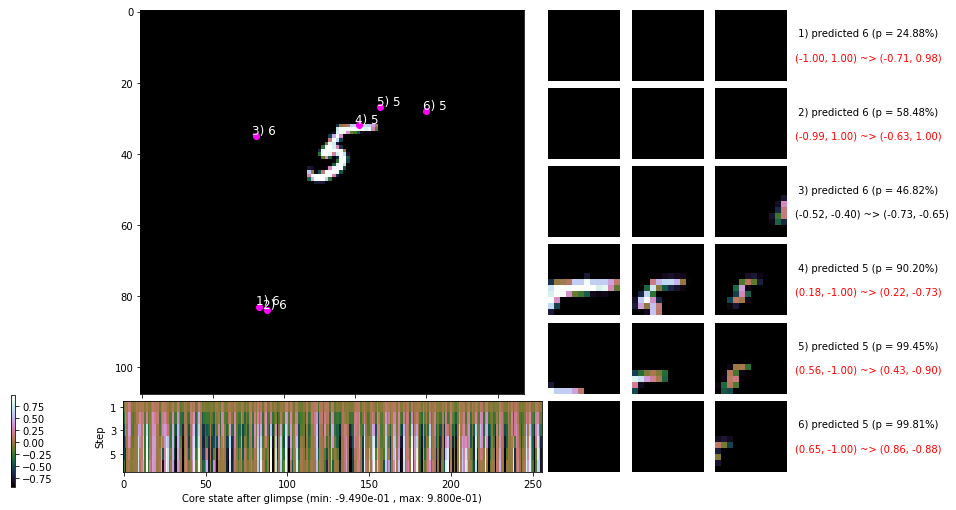

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 340.5 ms/b | lr: 1.57e-04 | grad 2norm:  7.79 | grad inf norm:  1.252
         Weights || abs max:  0.374 (36445.953) | mean:  7.351e-05 ( 0.077) | var: 2.191e-03 (175252.109)
          Biases || abs max:  0.715 (  240.232) | mean:  2.424e-02 ( 0.313) | var: 2.341e-03 (  578.476)
                    class loss: 0.234 | steps: 3.812 | reward:  0.941 | acc.: 94.14%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0,

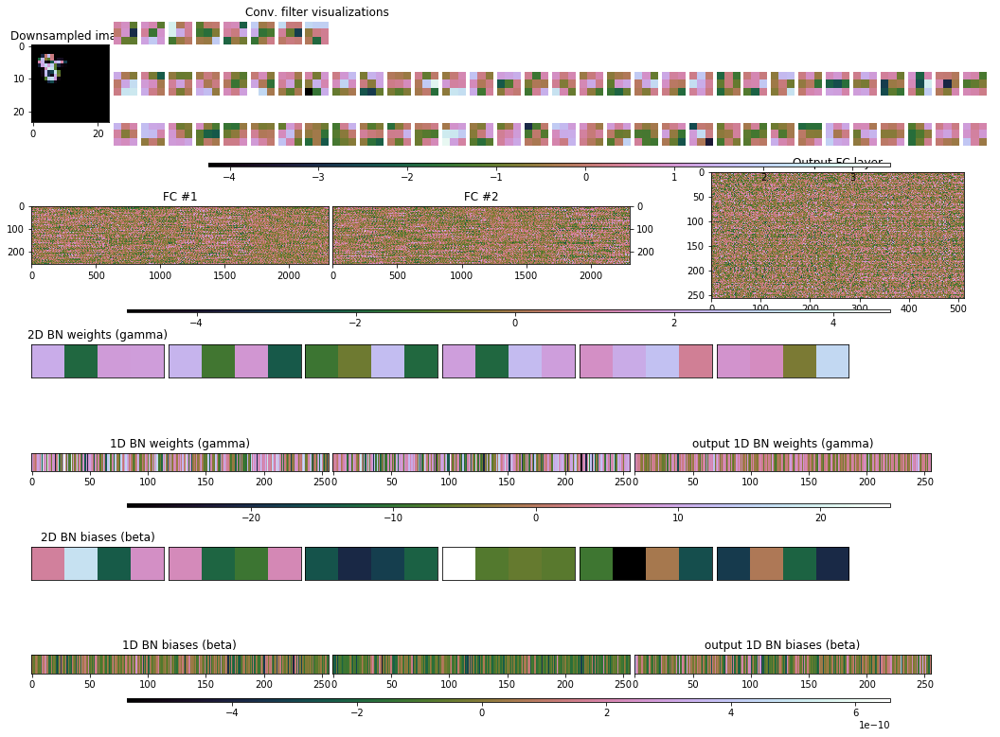


	Target class: 8 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.891, 0.842, 0.870, 0.889, 0.906, 0.942]


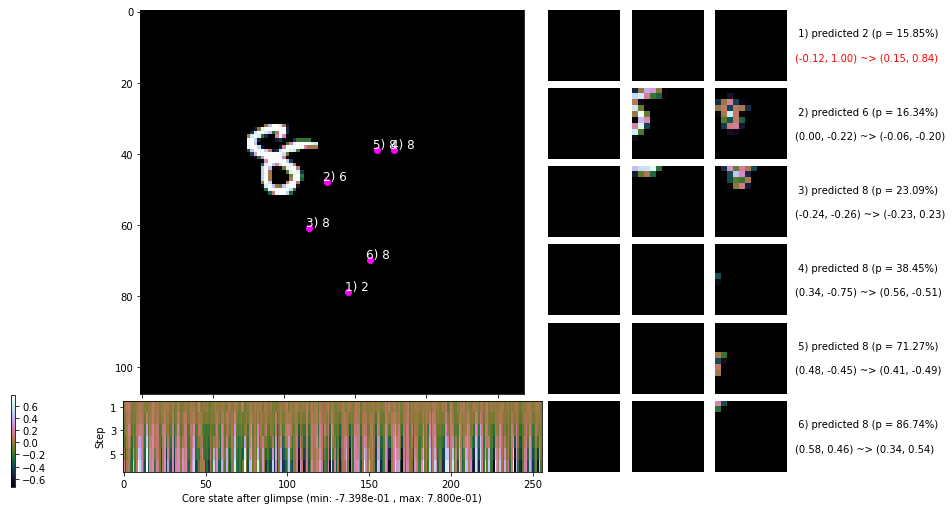

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


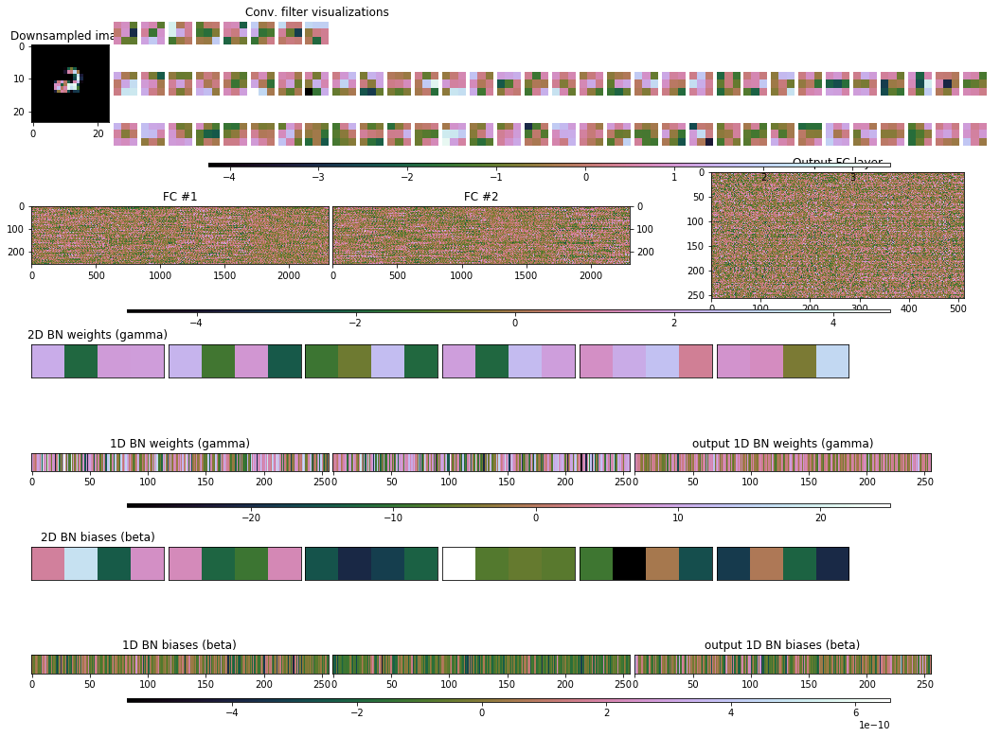


	Target class: 2 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


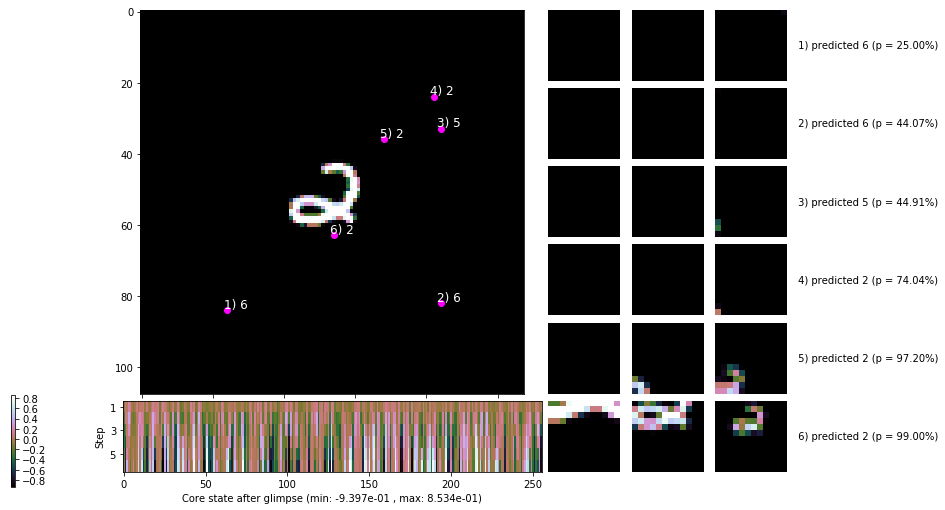

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


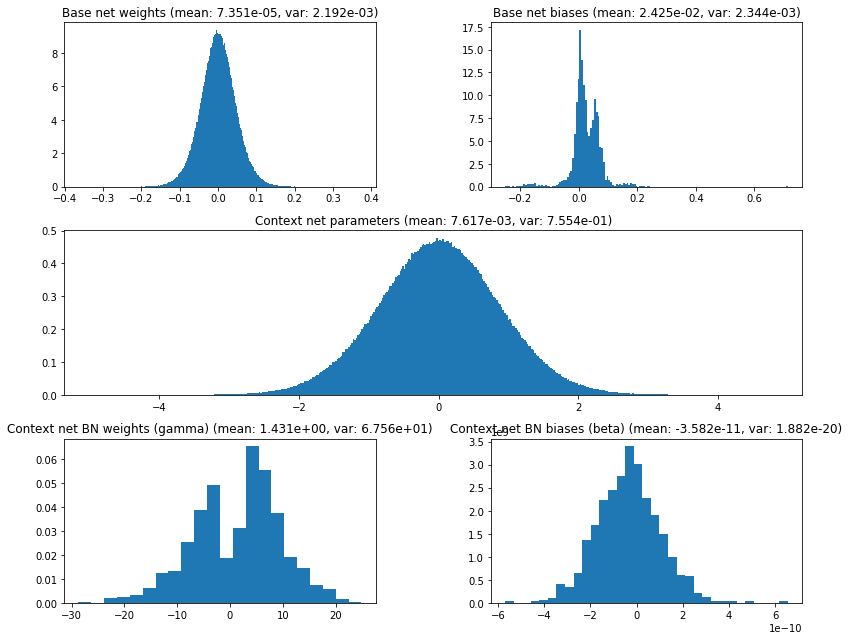

                                         Location network weights and biases


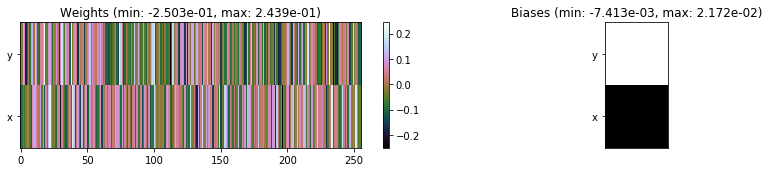

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1351.17 sec | TRAIN >> class loss: 0.2329 | steps:  3.818 :( | reward:  0.9411    | acc.: 94.112% 
                          | VAL   >> class loss: 0.1477 | steps:  3.667 :( | reward:  0.9616 :( | acc.: 96.160% :(


Epoch  22/400) lr = 0.0005699
 b   1000/  4000 >> 336.4 ms/b | lr: 1.42e-04 | grad 2norm:  8.01 | grad inf norm:  1.303
         Weights || abs max:  0.374 (20132.605) | mean:  7.363e-05 ( 0.064) | var: 2.192e-03 ( 3458.147)
          Biases || abs max:  0.715 (   72.430) | mean:  2.425e-02 ( 0.248) | var: 2.344e-03 (    3.497)
                    class loss: 0.232 | steps: 3.825 | reward:  0.941 | acc.: 94.05%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size(

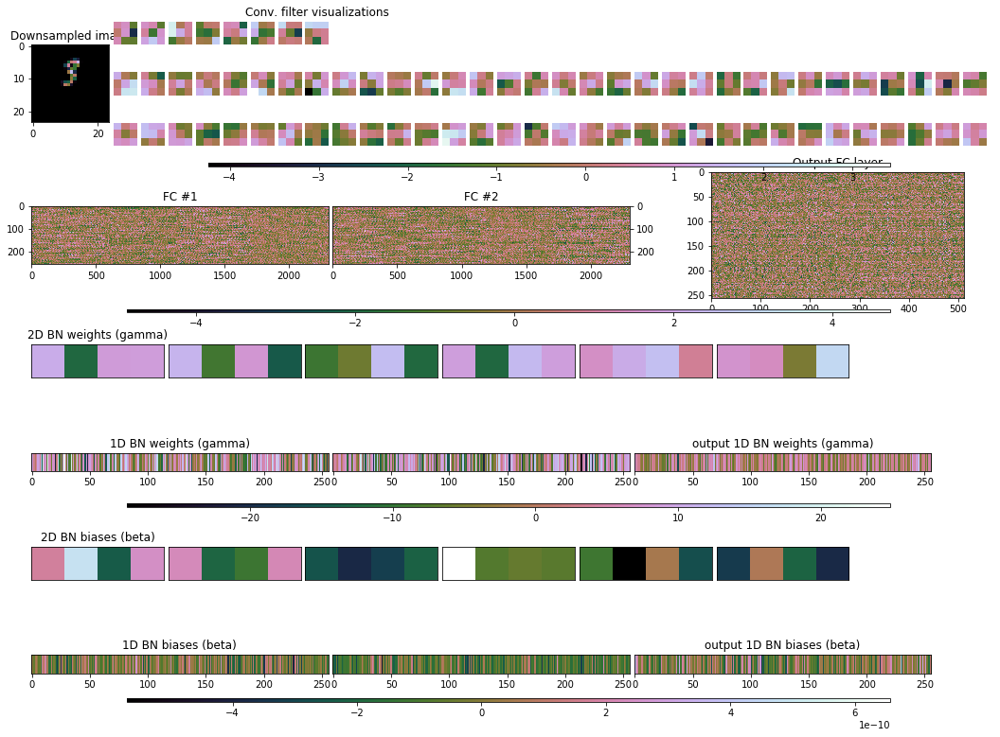


	Target class: 3 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.880, 0.935, 0.926, 0.880, 0.862, 0.881]


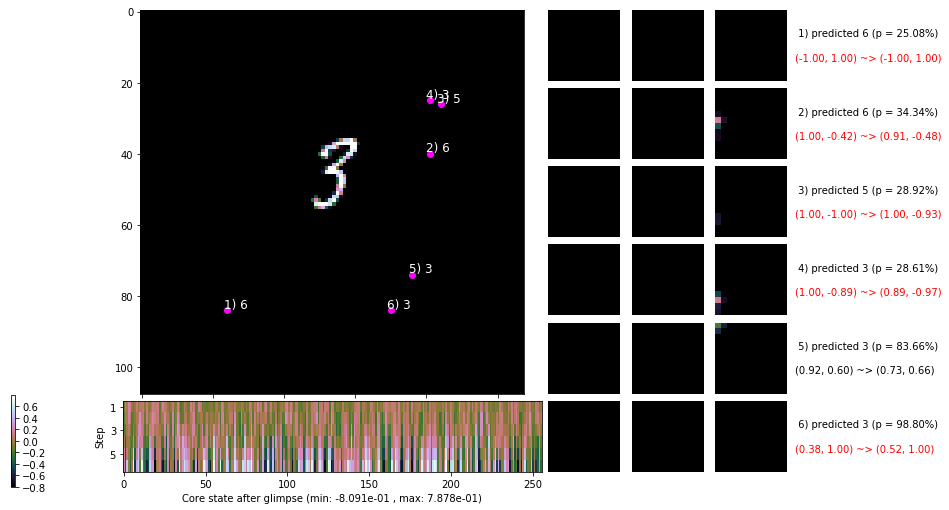

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 341.7 ms/b | lr: 1.28e-04 | grad 2norm:  7.92 | grad inf norm:  1.294
         Weights || abs max:  0.374 (46705.527) | mean:  7.409e-05 ( 0.088) | var: 2.193e-03 (193393.688)
          Biases || abs max:  0.716 (  885.230) | mean:  2.427e-02 ( 0.616) | var: 2.347e-03 (120798.383)
                    class loss: 0.228 | steps: 3.811 | reward:  0.942 | acc.: 94.19%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0

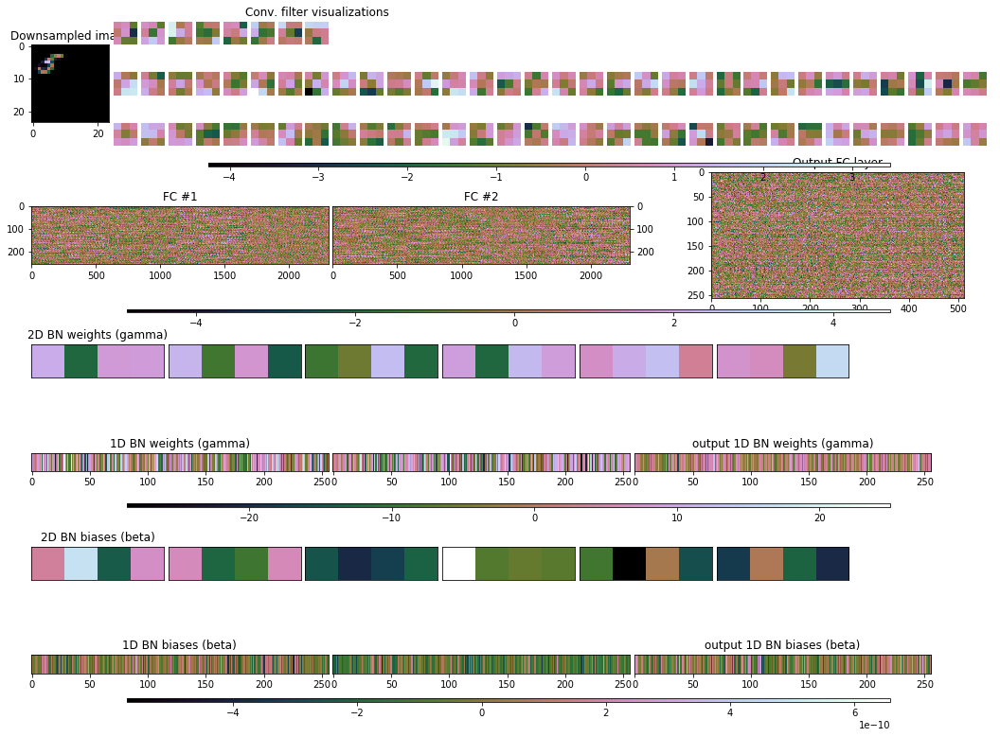


	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]
	                | Baseline rewards:   [0.780, 0.827, 0.876, 0.881, 0.893, 0.899]


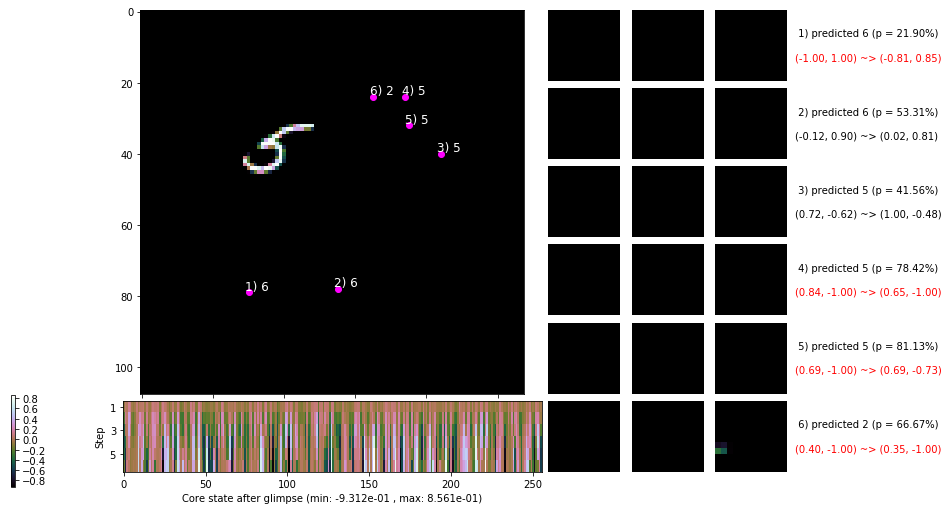

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


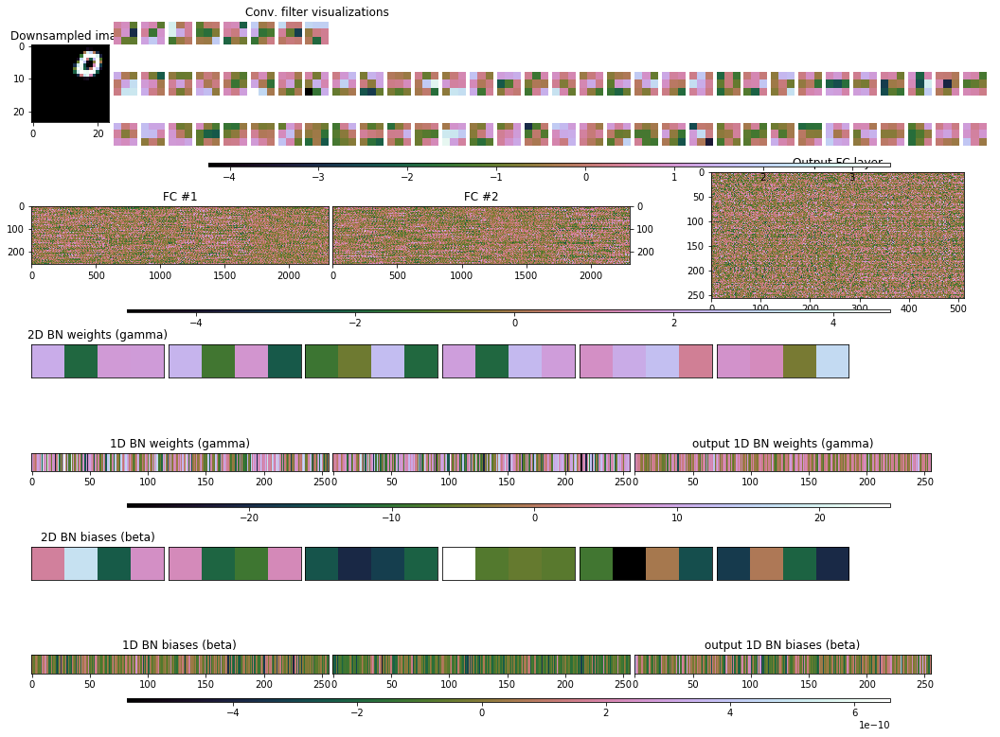


	Target class: 0 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


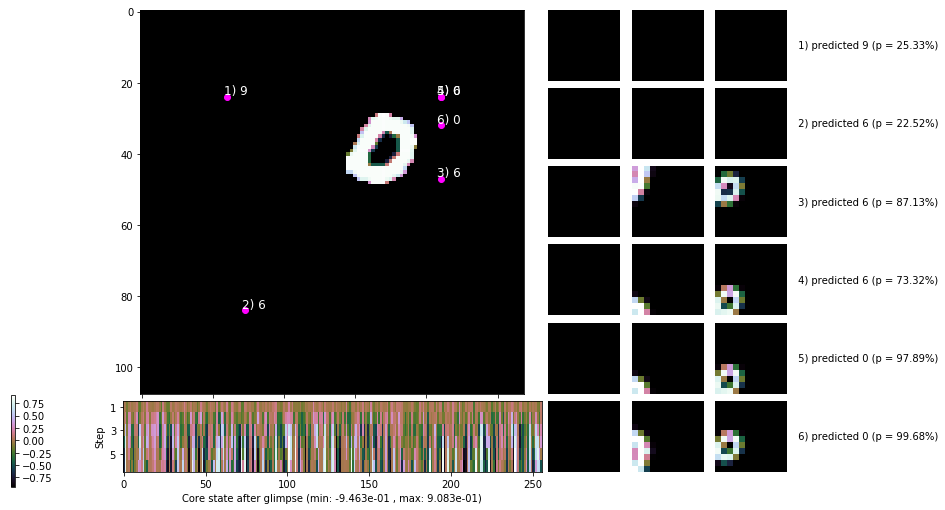

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


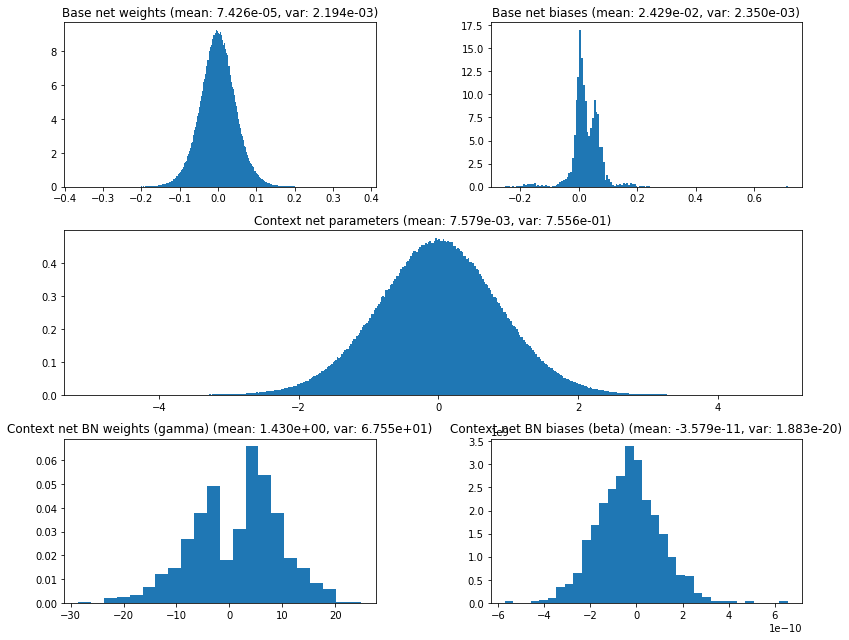

                                         Location network weights and biases


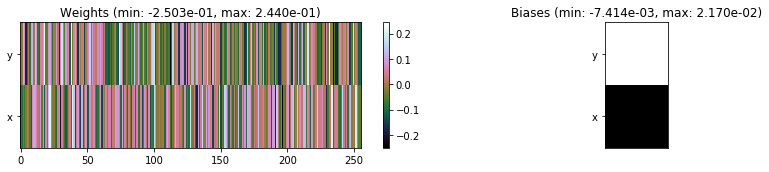

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1351.39 sec | TRAIN >> class loss: 0.2289 | steps:  3.817 :( | reward:  0.9413    | acc.: 94.129% 
                          | VAL   >> class loss: 0.1384 | steps:  3.676 :( | reward:  0.9638    | acc.: 96.380% 


Epoch  23/400) lr = 0.0004663
 b   1000/  4000 >> 335.0 ms/b | lr: 1.16e-04 | grad 2norm:  8.02 | grad inf norm:  1.306
         Weights || abs max:  0.374 (34109.195) | mean:  7.418e-05 ( 0.077) | var: 2.194e-03 (23056.906)
          Biases || abs max:  0.716 (   96.892) | mean:  2.429e-02 ( 0.270) | var: 2.351e-03 (    7.580)
                    class loss: 0.230 | steps: 3.821 | reward:  0.942 | acc.: 94.15%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4

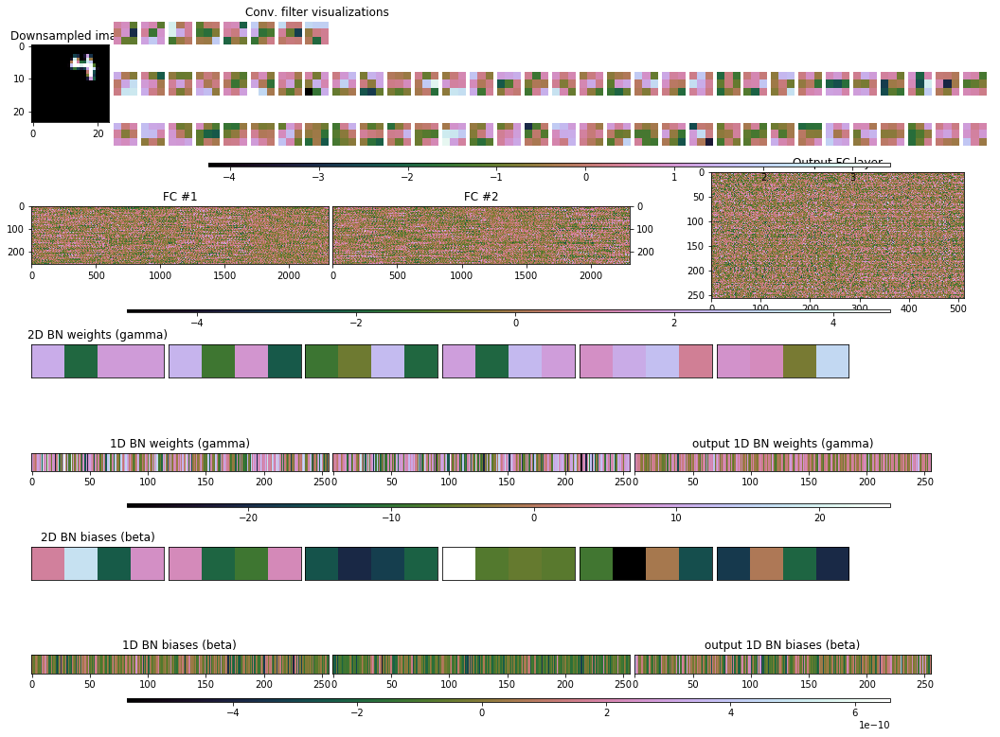


	Target class: 4 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.154, 0.950, 0.935, 0.958, 0.976, 0.986]


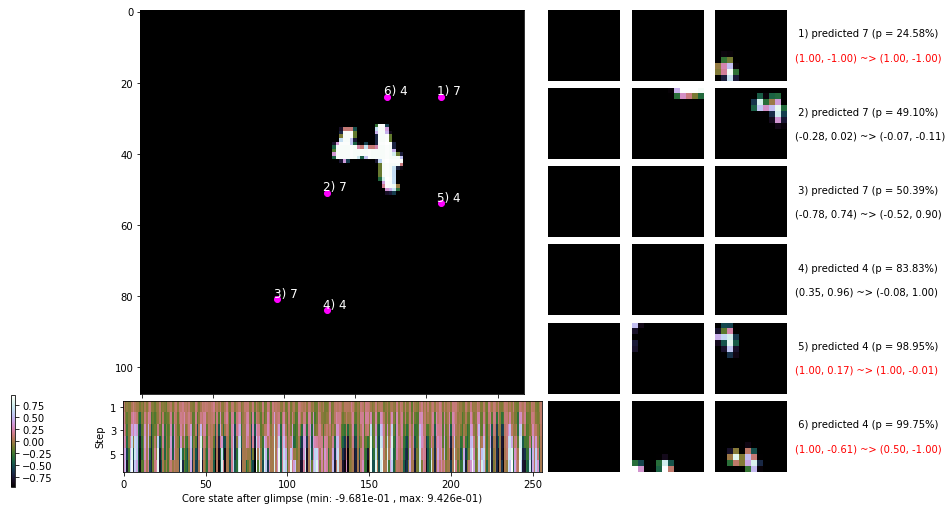

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 338.5 ms/b | lr: 1.05e-04 | grad 2norm:  7.68 | grad inf norm:  1.269
         Weights || abs max:  0.374 (65427.023) | mean:  7.424e-05 ( 0.106) | var: 2.195e-03 (500385.594)
          Biases || abs max:  0.716 (   52.592) | mean:  2.430e-02 ( 0.244) | var: 2.353e-03 (    2.782)
                    class loss: 0.227 | steps: 3.821 | reward:  0.942 | acc.: 94.17%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0,

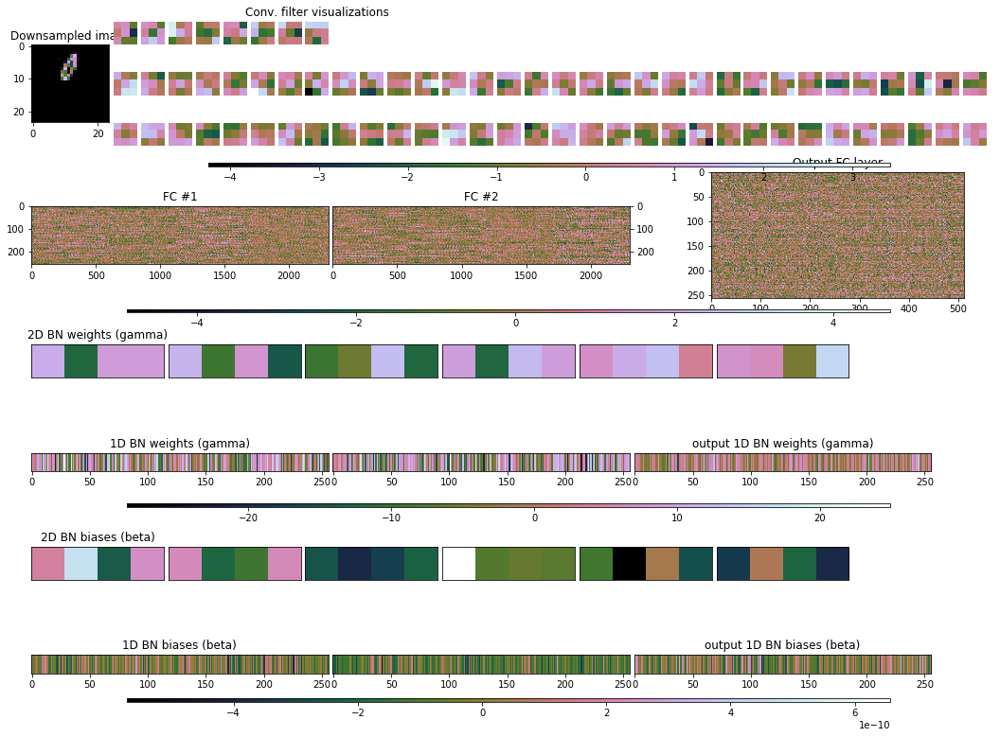


	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]
	                | Baseline rewards:   [0.873, 0.790, 0.810, 0.791, 0.813, 0.841]


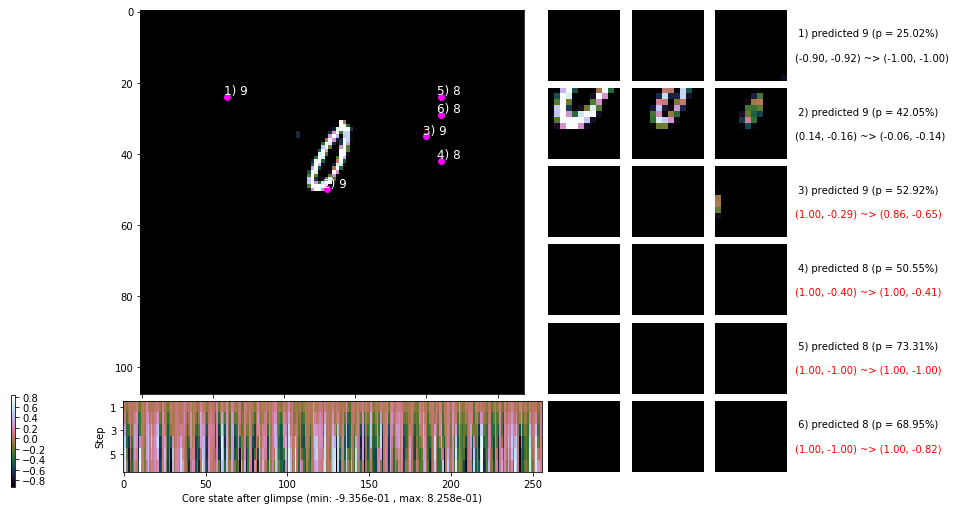

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


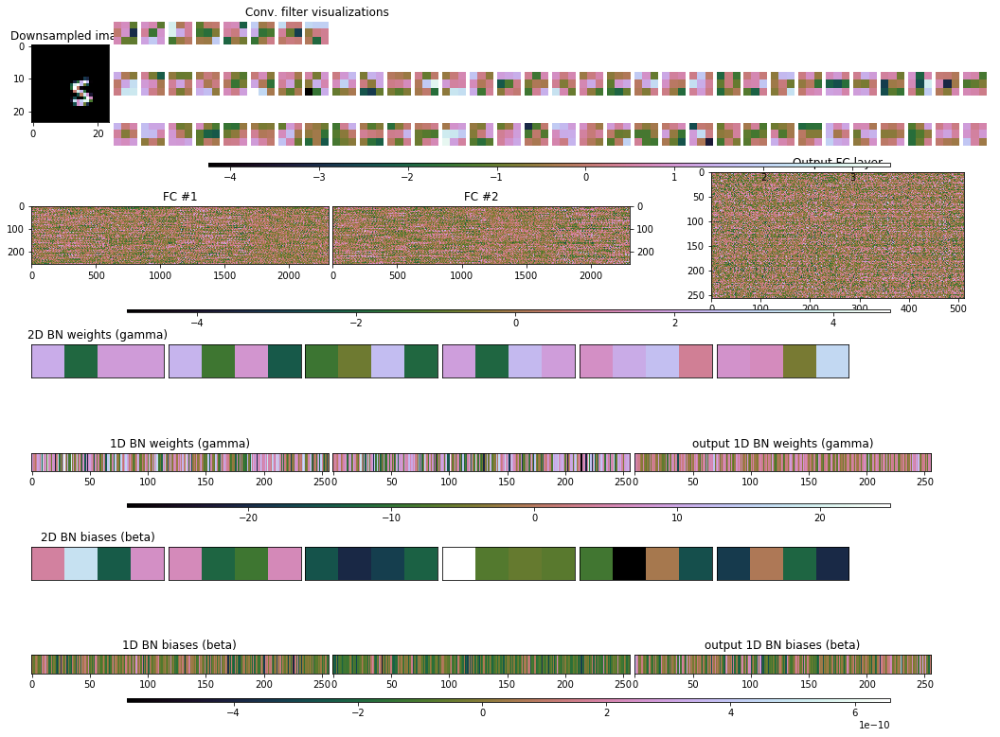


	Target class: 5 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


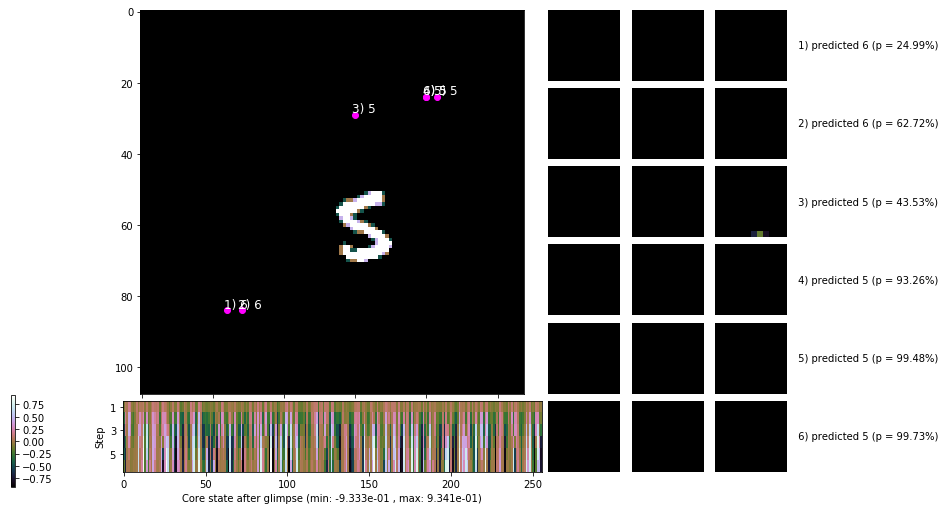

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


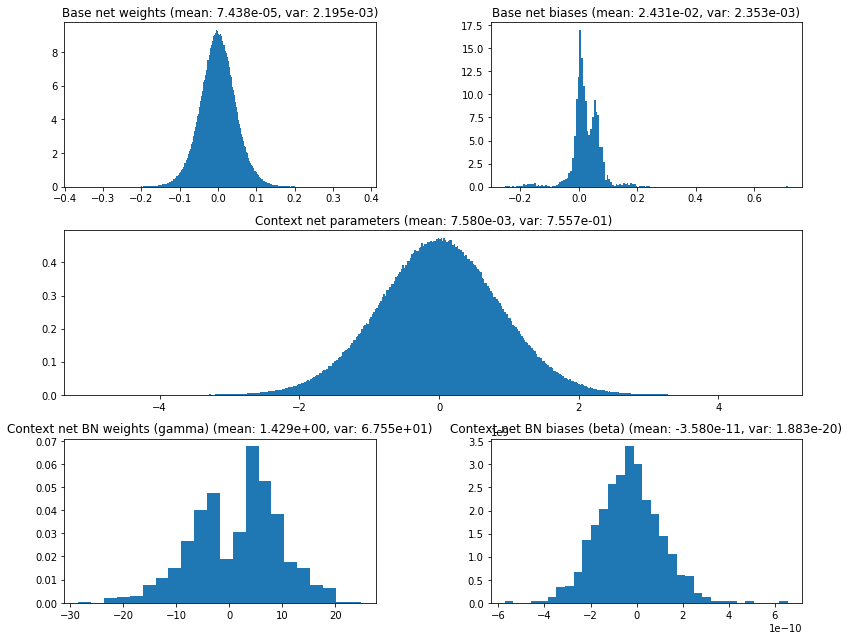

                                         Location network weights and biases


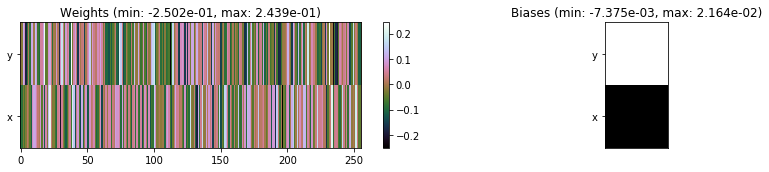

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1351.98 sec | TRAIN >> class loss: 0.2309 | steps:  3.818 :( | reward:  0.9412 :( | acc.: 94.117% :(
                          | VAL   >> class loss: 0.1485 | steps:  3.664 :( | reward:  0.9608 :( | acc.: 96.080% :(


Epoch  24/400) lr = 0.0003816
 b   1000/  4000 >> 334.3 ms/b | lr: 9.50e-05 | grad 2norm:  7.78 | grad inf norm:  1.232
         Weights || abs max:  0.374 (25340.773) | mean:  7.443e-05 ( 0.067) | var: 2.195e-03 (21043.828)
          Biases || abs max:  0.717 (   49.239) | mean:  2.431e-02 ( 0.242) | var: 2.354e-03 (    2.407)
                    class loss: 0.231 | steps: 3.817 | reward:  0.943 | acc.: 94.32%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Siz

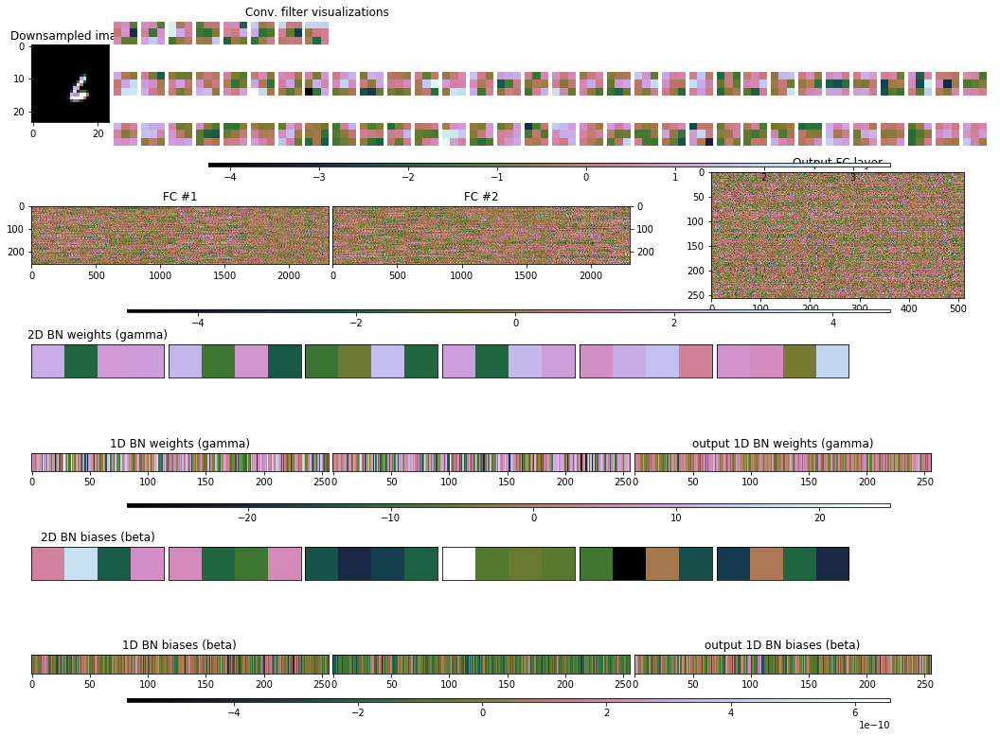


	Target class: 6 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.825, 0.868, 0.915, 0.953, 1.019, 1.056]


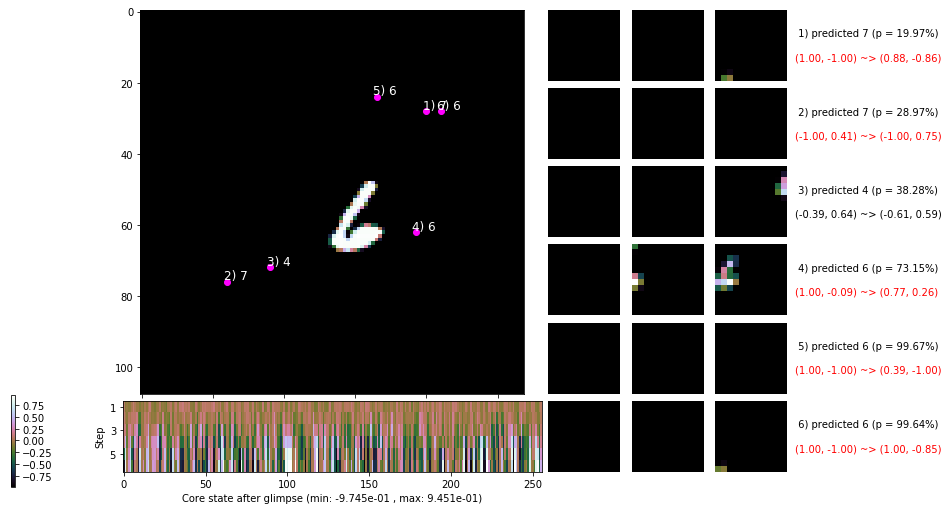

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 341.7 ms/b | lr: 8.59e-05 | grad 2norm:  7.84 | grad inf norm:  1.289
         Weights || abs max:  0.375 (37525.371) | mean:  7.417e-05 ( 0.079) | var: 2.196e-03 (143694.875)
          Biases || abs max:  0.717 (   95.707) | mean:  2.431e-02 ( 0.272) | var: 2.355e-03 (   67.826)
                    class loss: 0.231 | steps: 3.813 | reward:  0.942 | acc.: 94.19%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0,

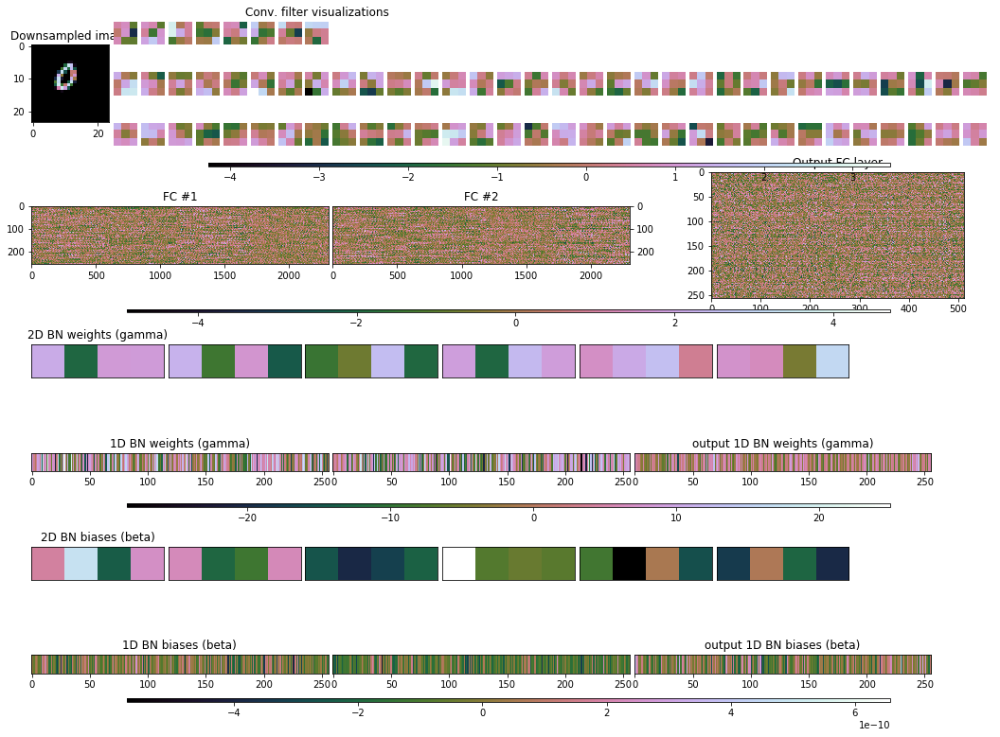


	Target class: 0 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.981, 0.983, 1.018, 0.975, 0.907, 0.863]


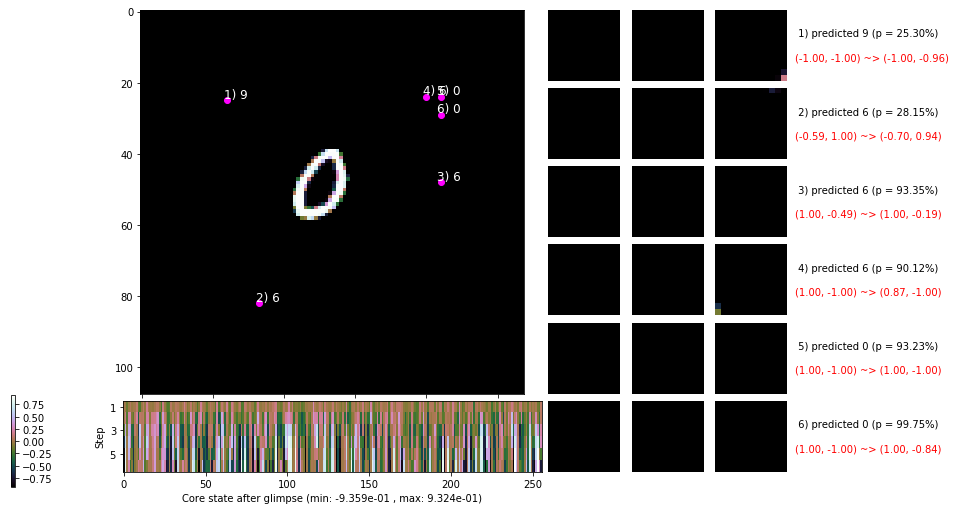

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


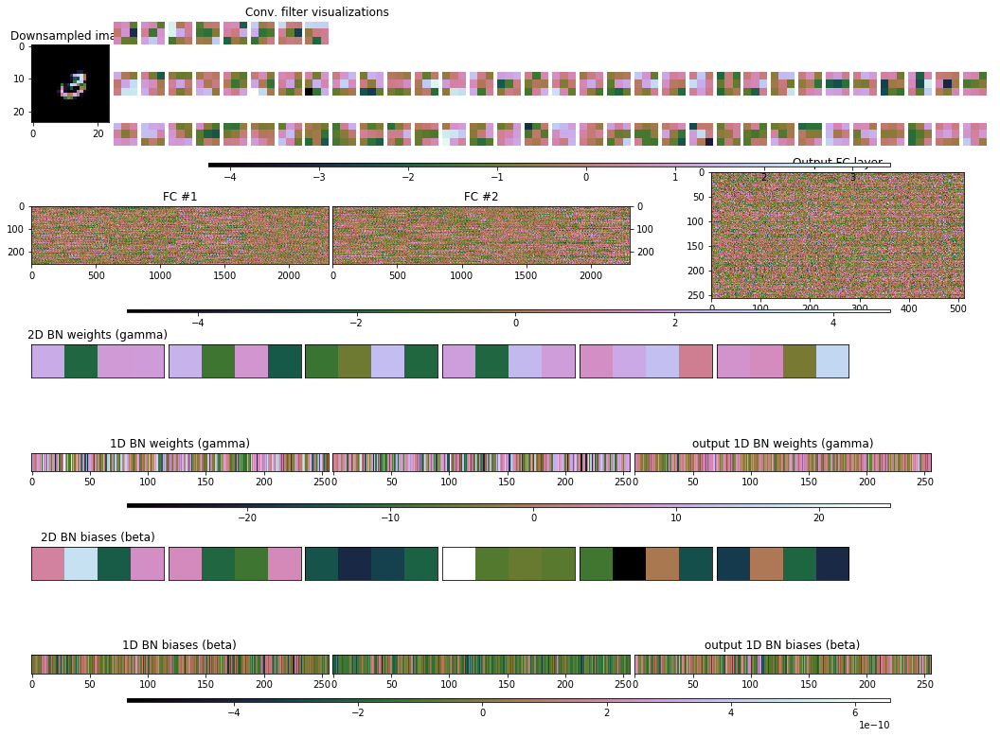


	Target class: 3 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


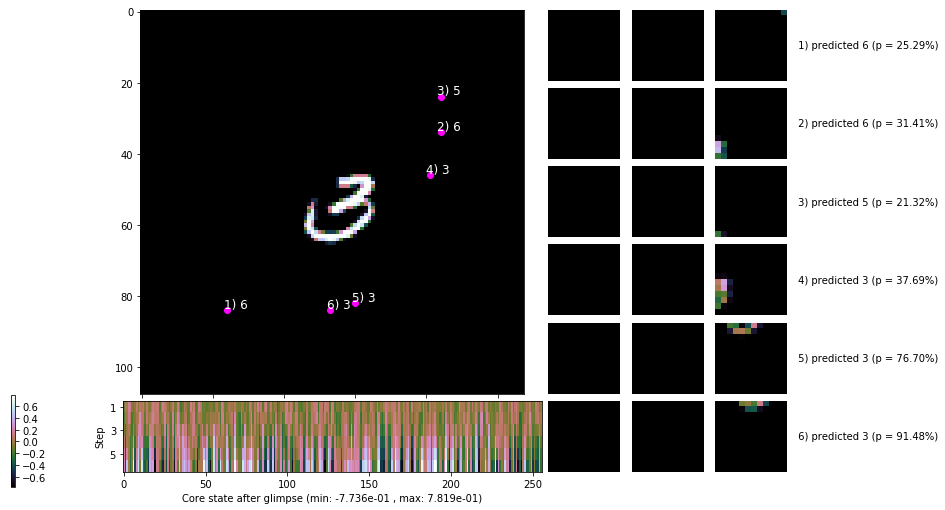

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


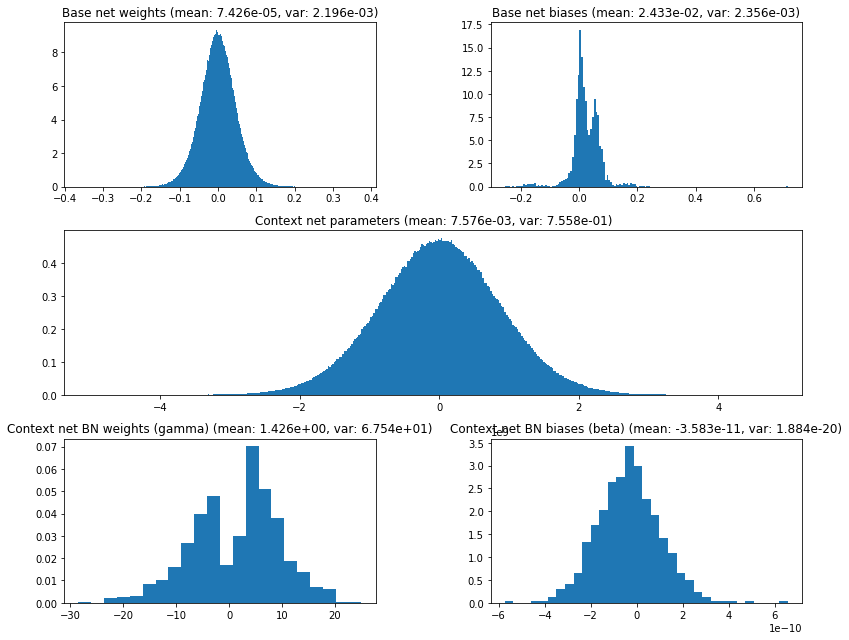

                                         Location network weights and biases


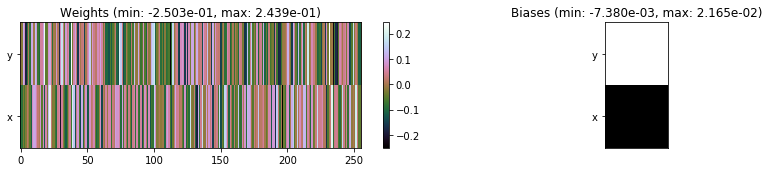

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1355.38 sec | TRAIN >> class loss: 0.2297 | steps:  3.813 :( | reward:  0.9426    | acc.: 94.265% 
                          | VAL   >> class loss: 0.1589 | steps:  3.658 :( | reward:  0.9616 :( | acc.: 96.160% :(


Epoch  25/400) lr = 0.0003123
 b   1000/  4000 >> 336.6 ms/b | lr: 7.77e-05 | grad 2norm:  8.21 | grad inf norm:  1.293
         Weights || abs max:  0.375 (85143.078) | mean:  7.427e-05 ( 0.121) | var: 2.196e-03 (2219048.000)
          Biases || abs max:  0.717 (   66.563) | mean:  2.433e-02 ( 0.256) | var: 2.357e-03 (    5.992)
                    class loss: 0.238 | steps: 3.818 | reward:  0.940 | acc.: 94.02%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Siz

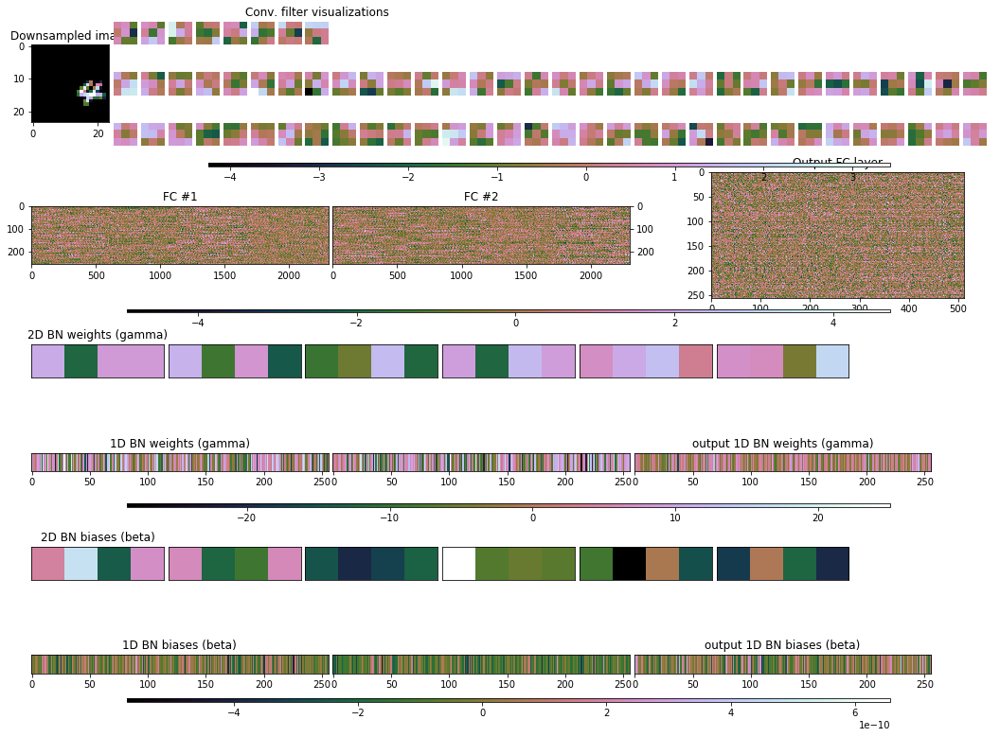


	Target class: 4 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.713, 0.786, 0.854, 0.937, 1.008, 1.002]


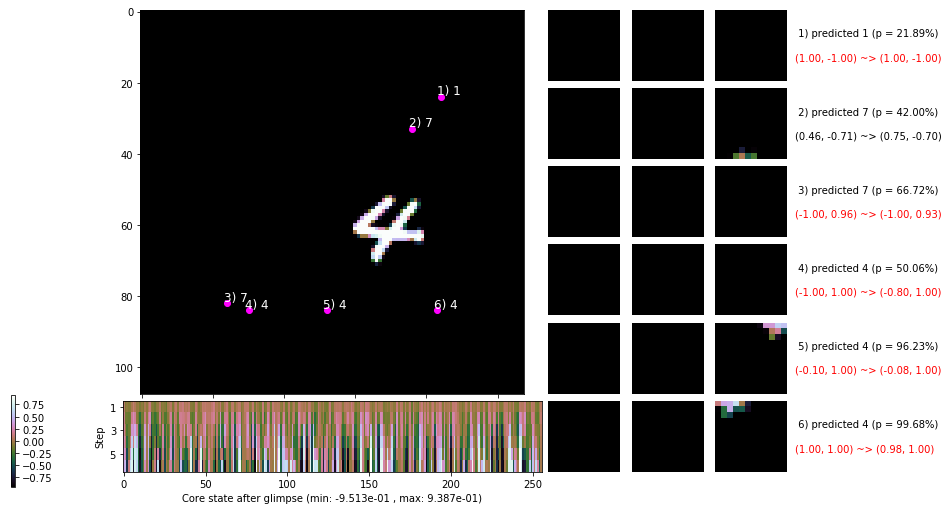

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 342.0 ms/b | lr: 7.03e-05 | grad 2norm:  7.69 | grad inf norm:  1.230
         Weights || abs max:  0.375 (26304.375) | mean:  7.436e-05 ( 0.068) | var: 2.197e-03 (22656.863)
          Biases || abs max:  0.718 (   48.005) | mean:  2.434e-02 ( 0.241) | var: 2.358e-03 (    2.569)
                    class loss: 0.223 | steps: 3.805 | reward:  0.944 | acc.: 94.38%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

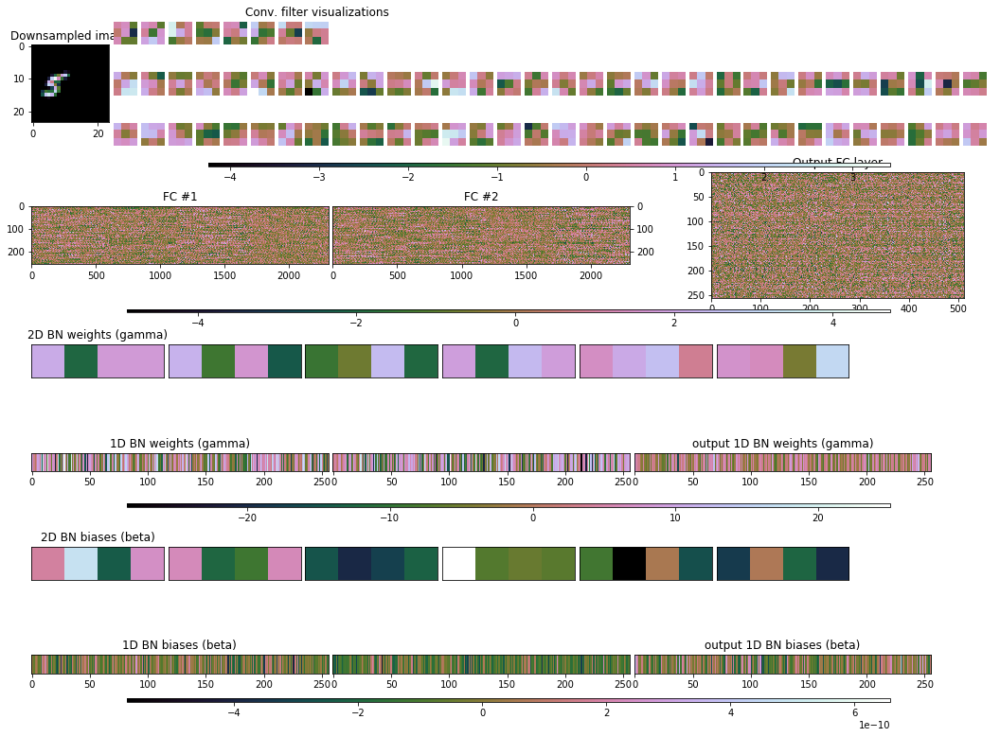


	Target class: 5 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.887, 0.891, 1.005, 1.083, 1.118, 1.147]


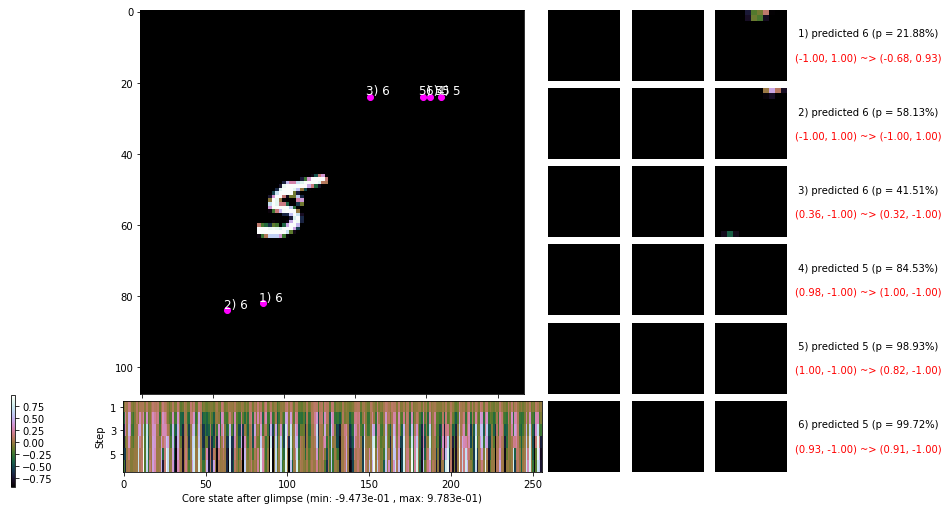

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


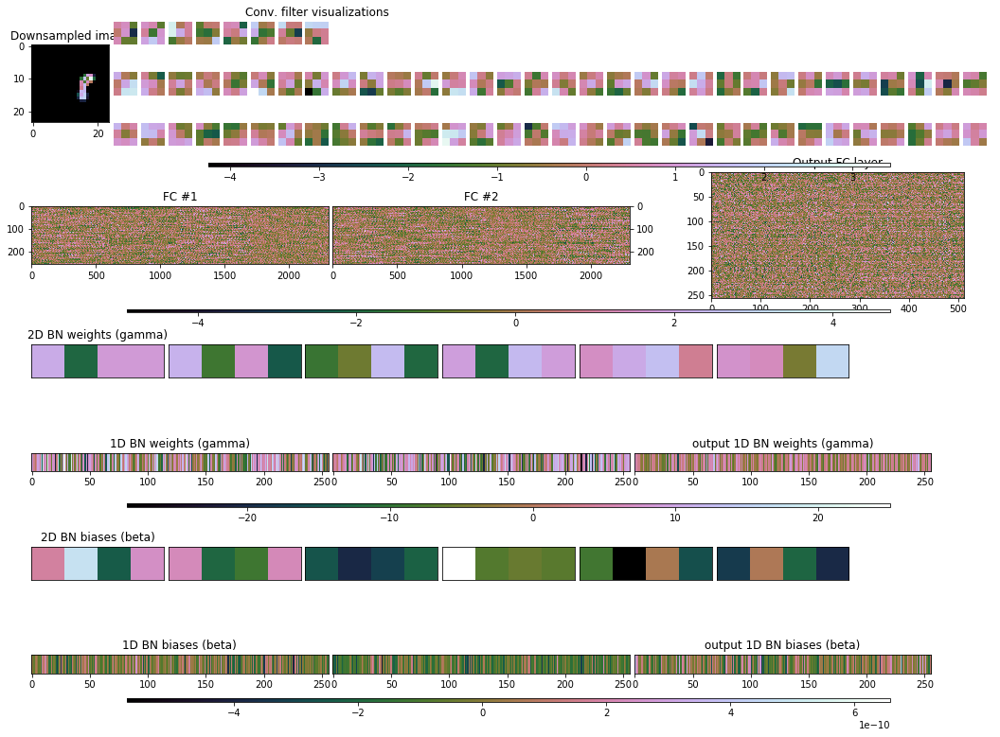


	Target class: 8 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


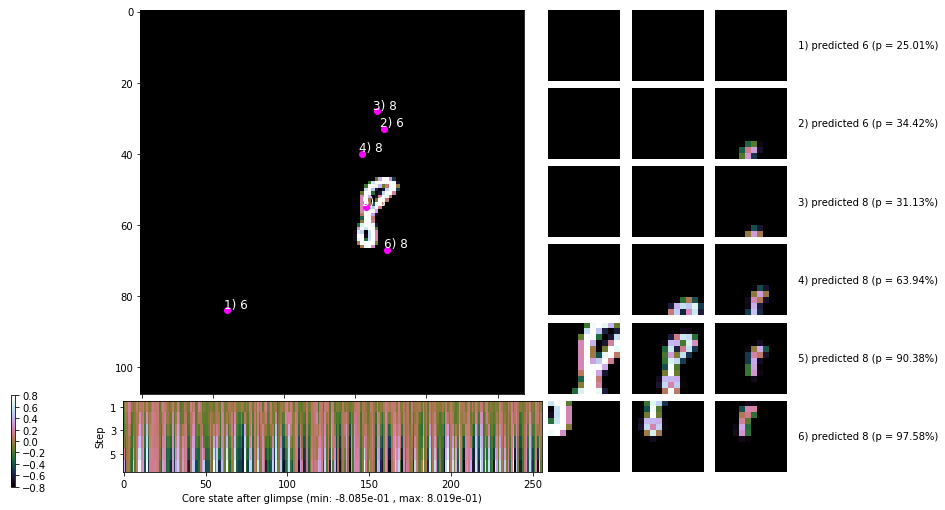

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


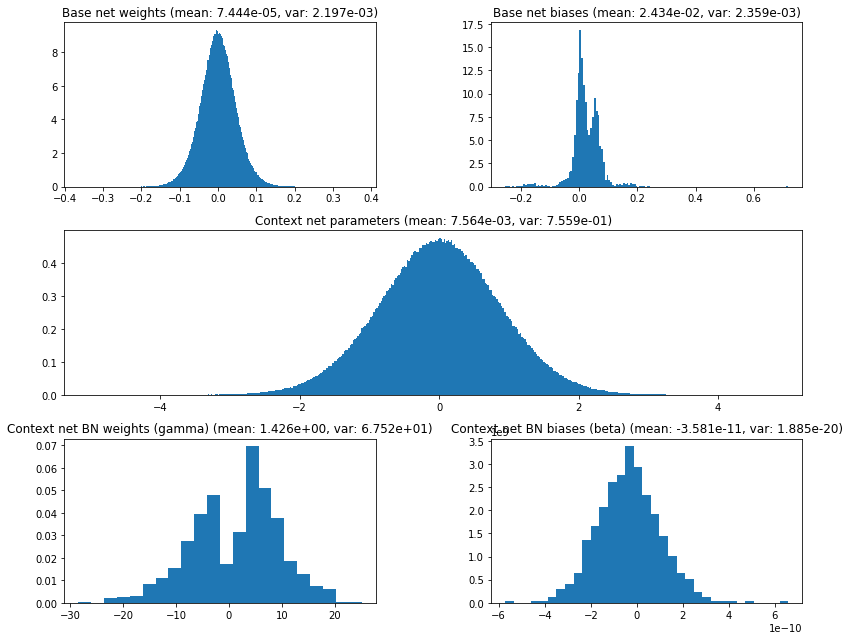

                                         Location network weights and biases


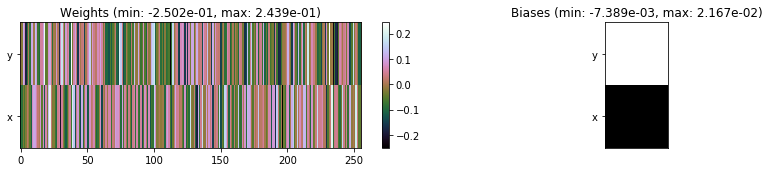

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1352.50 sec | TRAIN >> class loss: 0.2290 | steps:  3.812 :( | reward:  0.9424 :( | acc.: 94.239% :(
                          | VAL   >> class loss: 0.1590 | steps:  3.666 :( | reward:  0.9602 :( | acc.: 96.020% :(


Epoch  26/400) lr = 0.0002555
 b   1000/  4000 >> 337.4 ms/b | lr: 6.36e-05 | grad 2norm:  8.09 | grad inf norm:  1.285
         Weights || abs max:  0.375 (29401.477) | mean:  7.443e-05 ( 0.071) | var: 2.197e-03 (15924.387)
          Biases || abs max:  0.718 (  425.640) | mean:  2.434e-02 ( 0.398) | var: 2.359e-03 (41587.180)
                    class loss: 0.227 | steps: 3.823 | reward:  0.942 | acc.: 94.20%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Siz

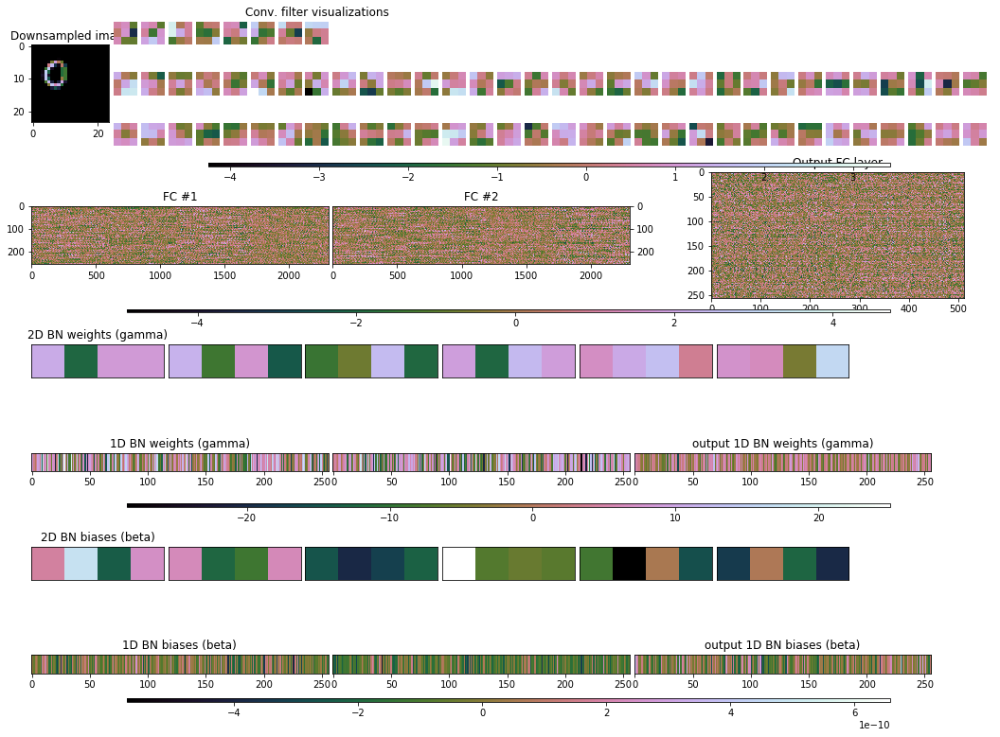


	Target class: 0 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.908, 0.947, 0.987, 0.958, 0.906, 0.858]


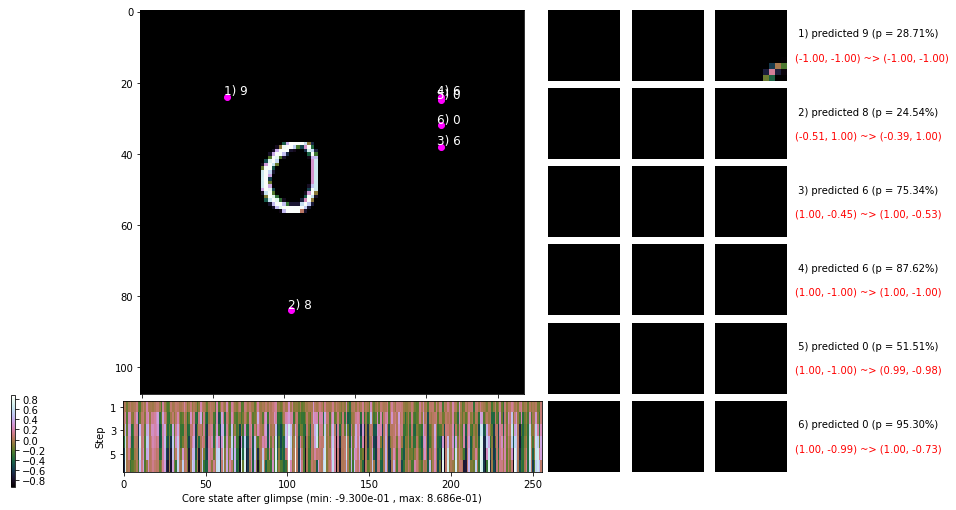

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 341.6 ms/b | lr: 5.75e-05 | grad 2norm:  8.02 | grad inf norm:  1.283
         Weights || abs max:  0.375 (16029.084) | mean:  7.466e-05 ( 0.059) | var: 2.197e-03 ( 2363.841)
          Biases || abs max:  0.718 (   43.229) | mean:  2.435e-02 ( 0.240) | var: 2.360e-03 (    2.329)
                    class loss: 0.234 | steps: 3.815 | reward:  0.941 | acc.: 94.15%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

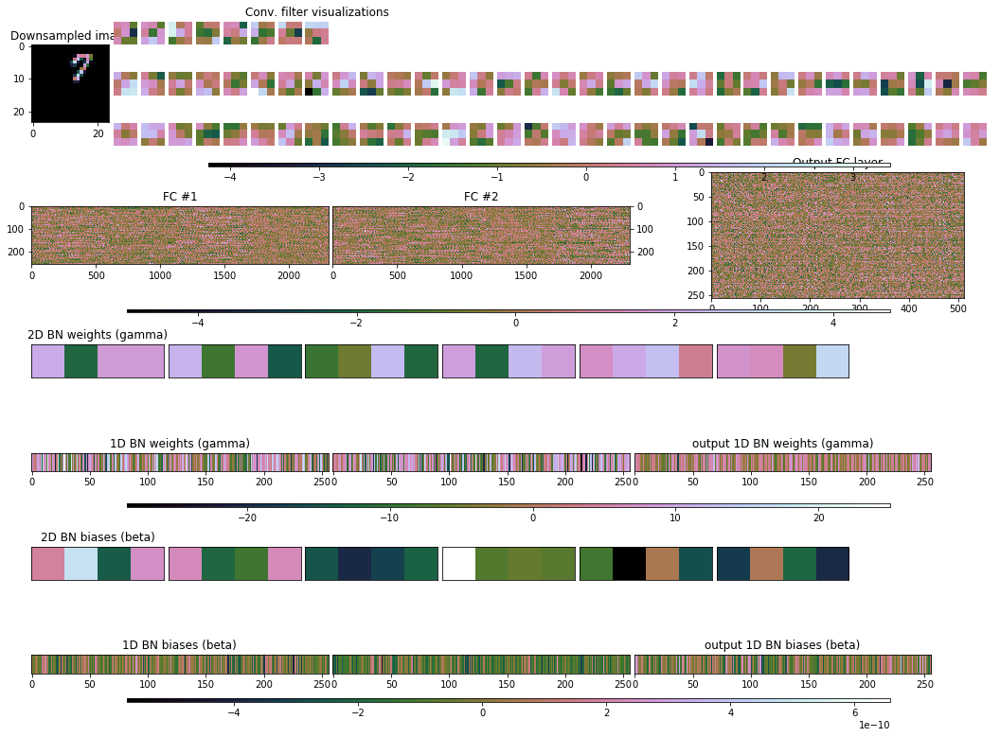


	Target class: 7 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.042, 0.967, 0.971, 0.989, 1.024, 1.016]


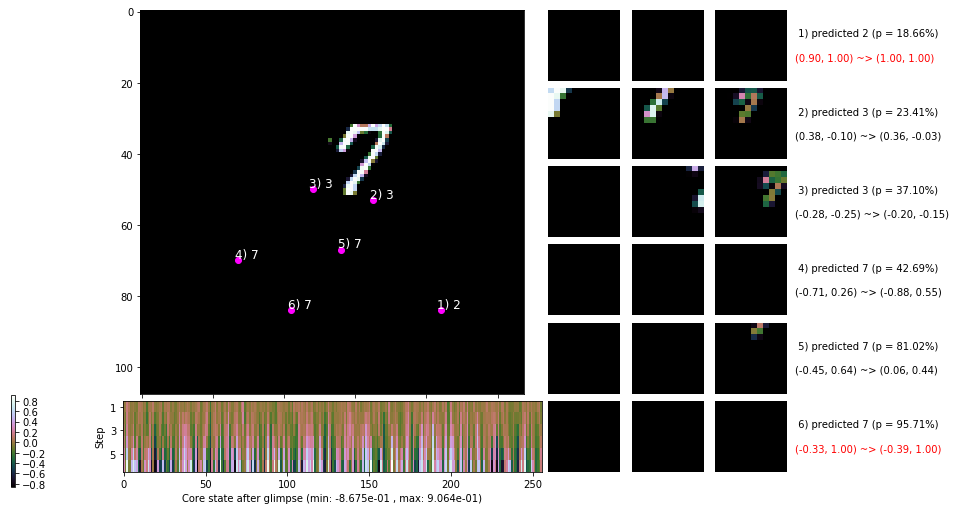

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


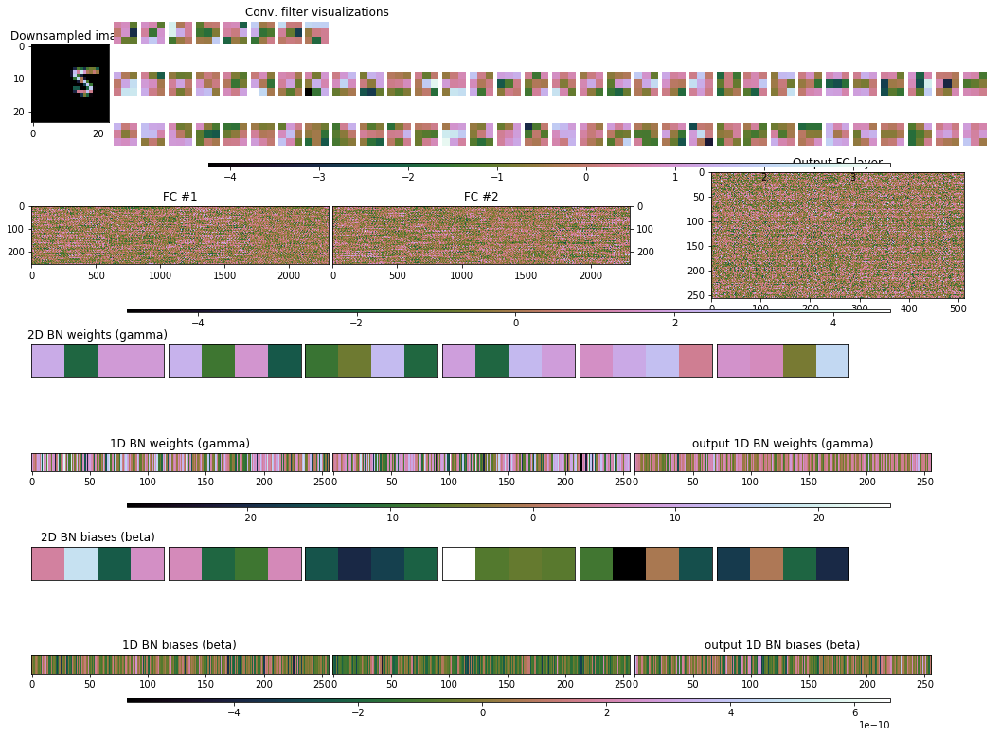


	Target class: 5 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


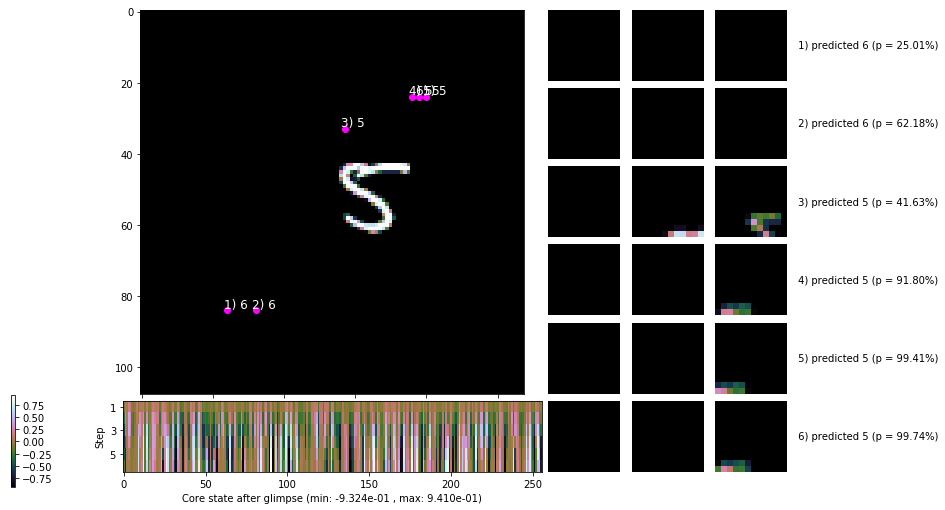

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


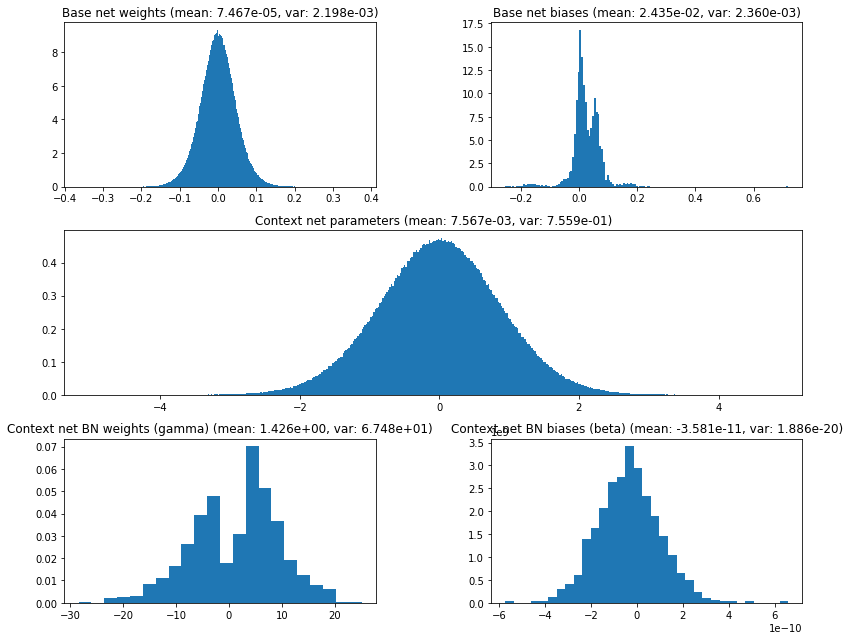

                                         Location network weights and biases


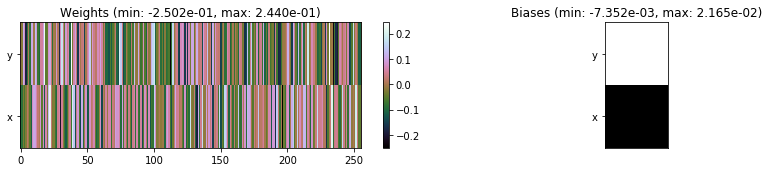

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1356.81 sec | TRAIN >> class loss: 0.2297 | steps:  3.817 :( | reward:  0.9419 :( | acc.: 94.188% :(
                          | VAL   >> class loss: 0.1450 | steps:  3.667 :( | reward:  0.9642    | acc.: 96.420% 


Epoch  27/400) lr = 0.0002091
 b   1000/  4000 >> 334.5 ms/b | lr: 5.20e-05 | grad 2norm:  8.06 | grad inf norm:  1.304
         Weights || abs max:  0.375 (33526.398) | mean:  7.470e-05 ( 0.074) | var: 2.198e-03 (51233.273)
          Biases || abs max:  0.718 (   83.324) | mean:  2.436e-02 ( 0.262) | var: 2.360e-03 (   25.684)
                    class loss: 0.230 | steps: 3.814 | reward:  0.942 | acc.: 94.21%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size(

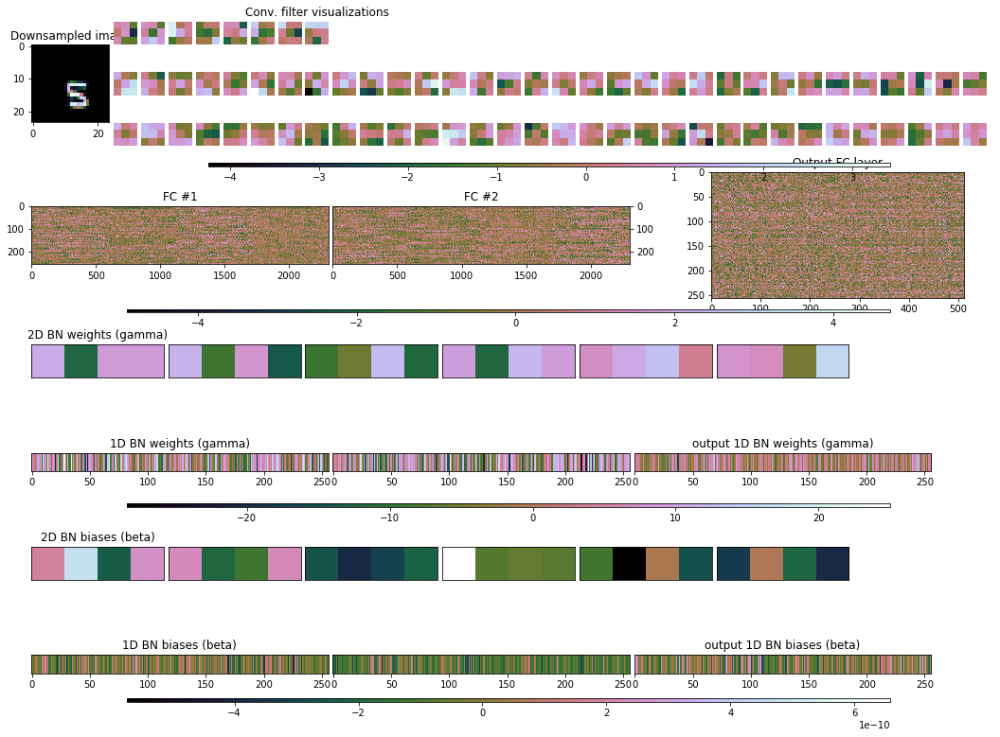


	Target class: 5 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.073, 1.027, 1.077, 1.099, 1.111, 1.117]


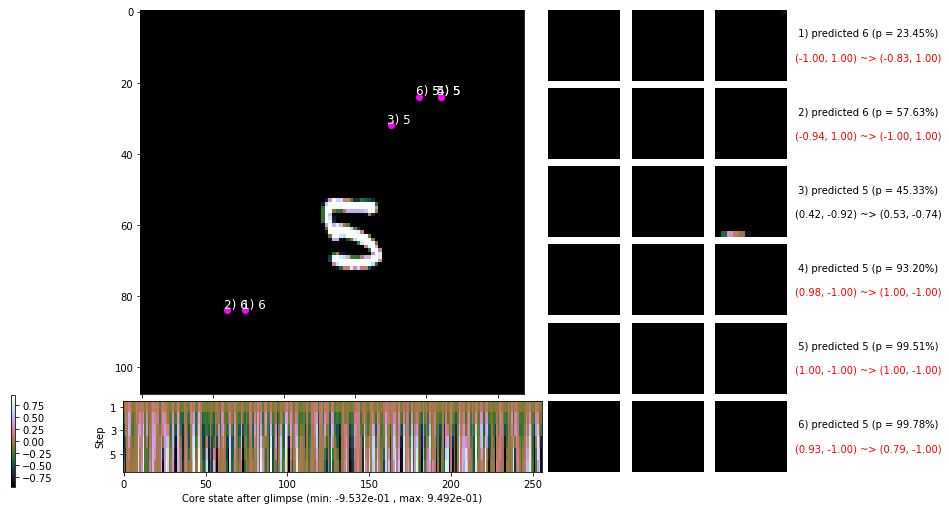

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 339.3 ms/b | lr: 4.71e-05 | grad 2norm:  8.12 | grad inf norm:  1.300
         Weights || abs max:  0.375 (32379.484) | mean:  7.462e-05 ( 0.074) | var: 2.198e-03 (107468.516)
          Biases || abs max:  0.718 (  420.442) | mean:  2.437e-02 ( 0.418) | var: 2.362e-03 ( 1909.782)
                    class loss: 0.227 | steps: 3.805 | reward:  0.941 | acc.: 94.11%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0,

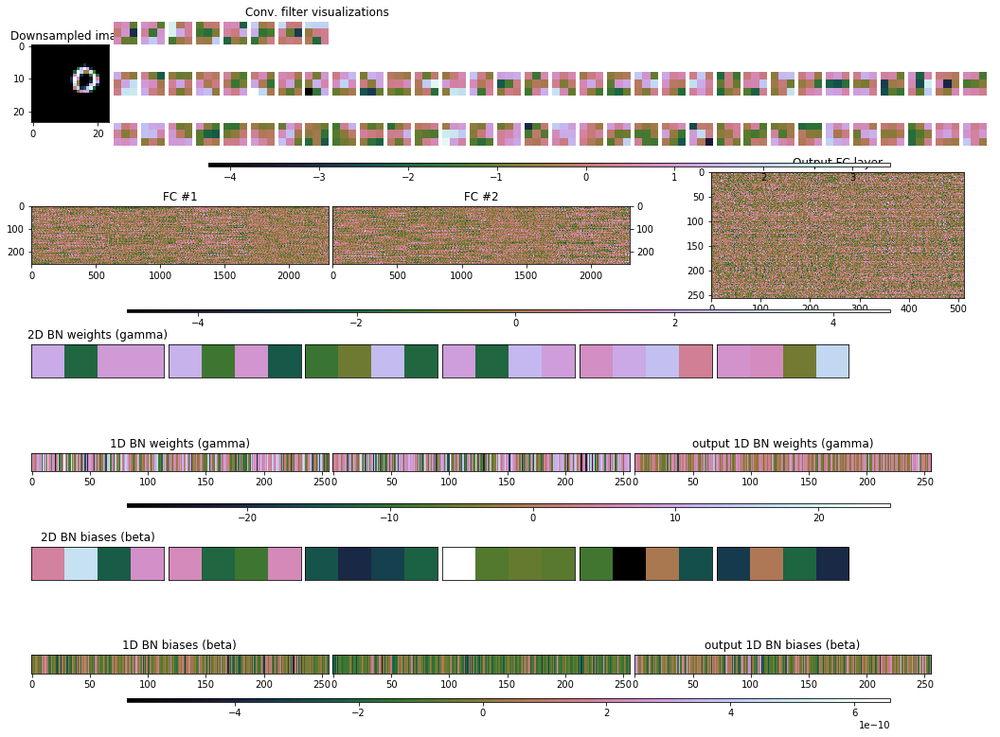


	Target class: 0 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.867, 0.912, 1.026, 1.041, 1.000, 0.949]


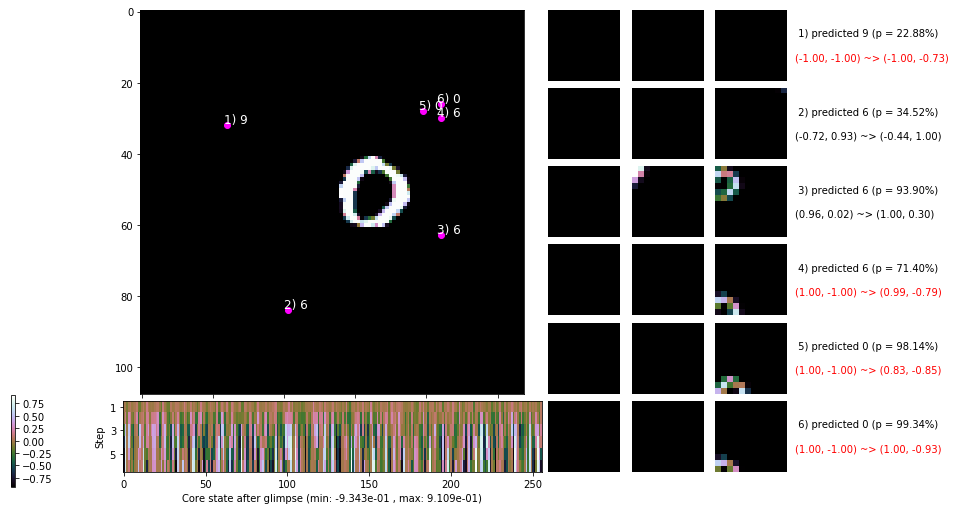

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


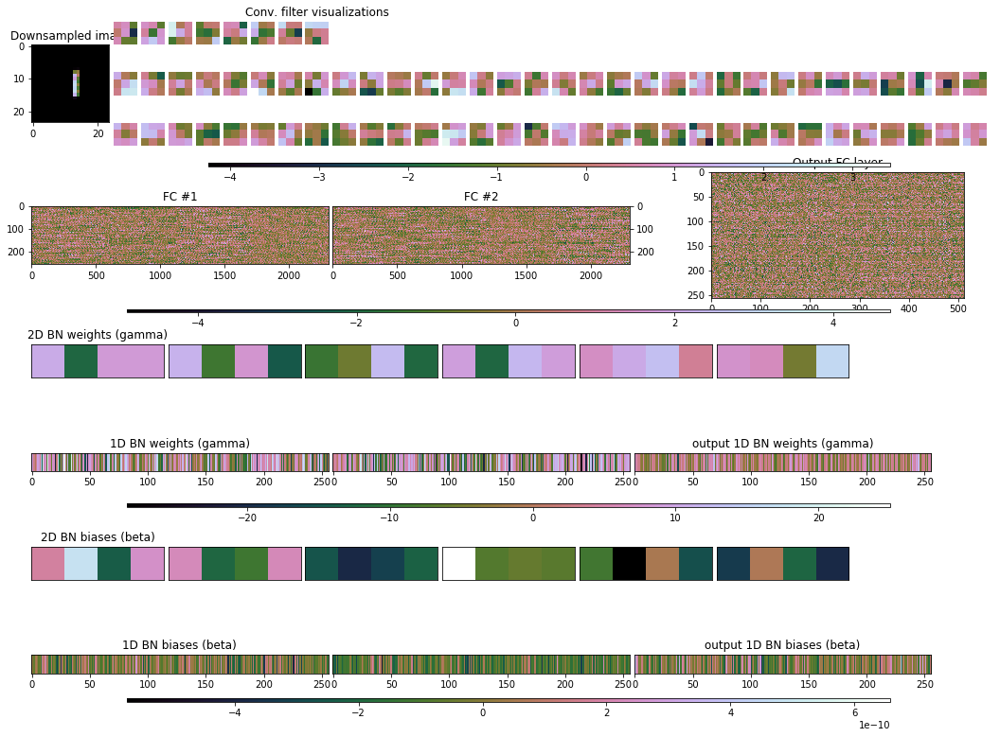


	Target class: 1 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


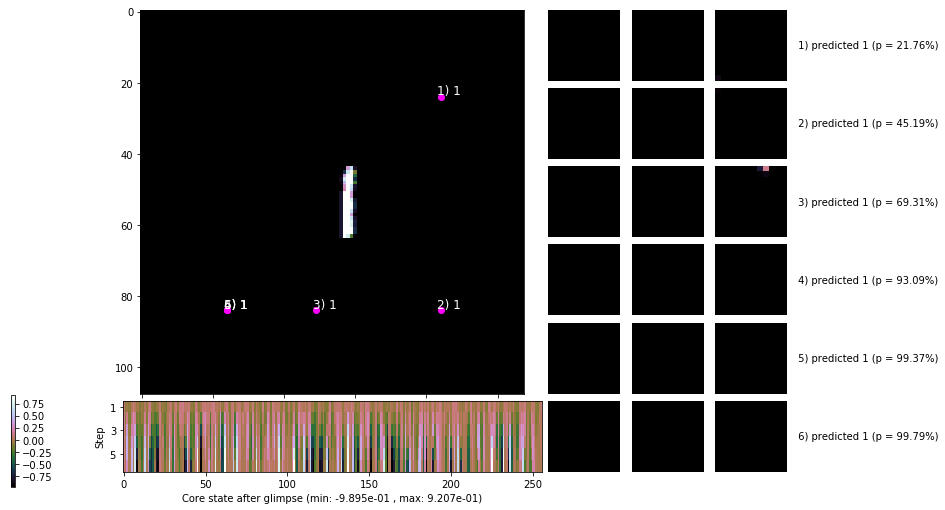

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


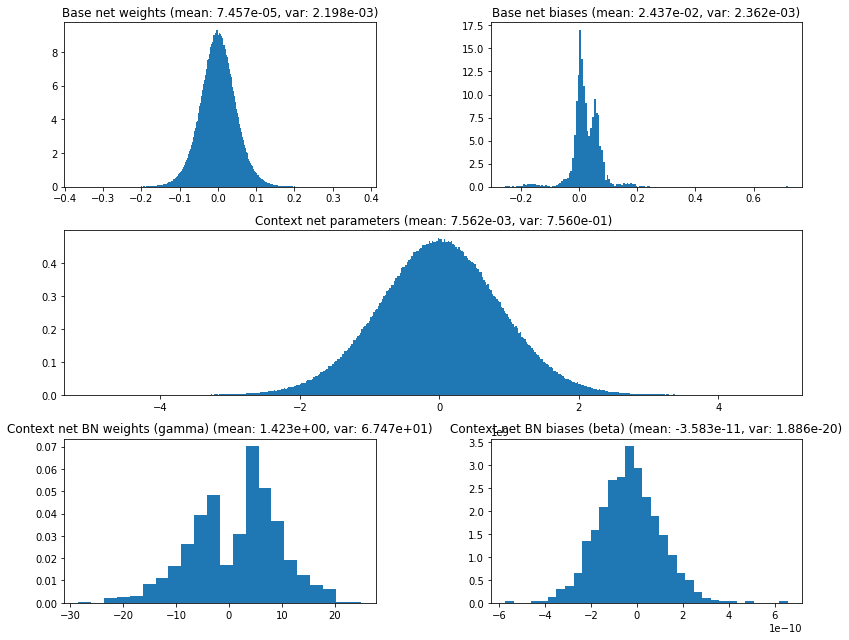

                                         Location network weights and biases


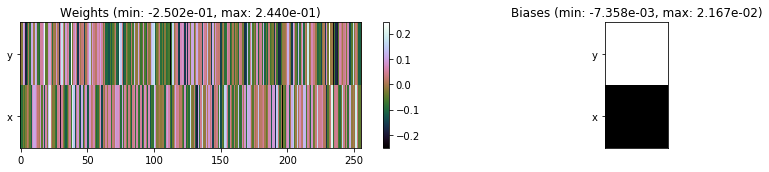

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1353.50 sec | TRAIN >> class loss: 0.2290 | steps:  3.809 :( | reward:  0.9418 :( | acc.: 94.185% :(
                          | VAL   >> class loss: 0.1483 | steps:  3.649 :( | reward:  0.9620 :( | acc.: 96.200% :(


Epoch  28/400) lr = 0.0001711
 b   1000/  4000 >> 334.0 ms/b | lr: 4.26e-05 | grad 2norm:  7.90 | grad inf norm:  1.261
         Weights || abs max:  0.375 (36583.090) | mean:  7.457e-05 ( 0.081) | var: 2.198e-03 (45021.113)
          Biases || abs max:  0.718 (   43.795) | mean:  2.437e-02 ( 0.243) | var: 2.362e-03 (    2.433)
                    class loss: 0.233 | steps: 3.801 | reward:  0.942 | acc.: 94.19%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Siz

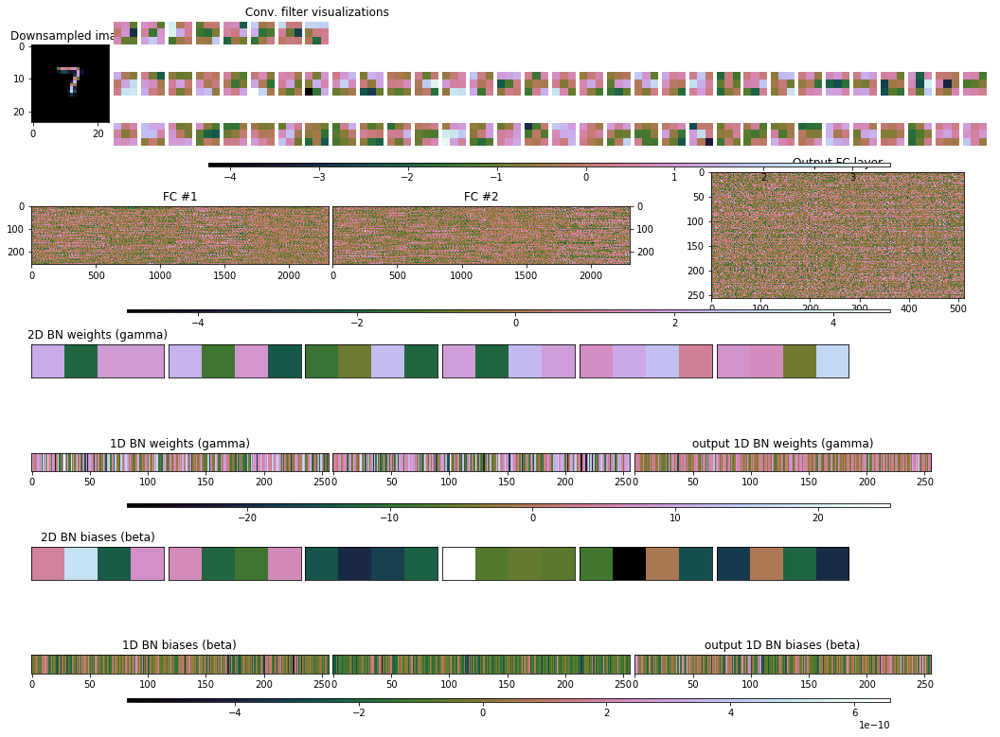


	Target class: 7 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.037, 0.945, 0.952, 0.979, 1.012, 1.028]


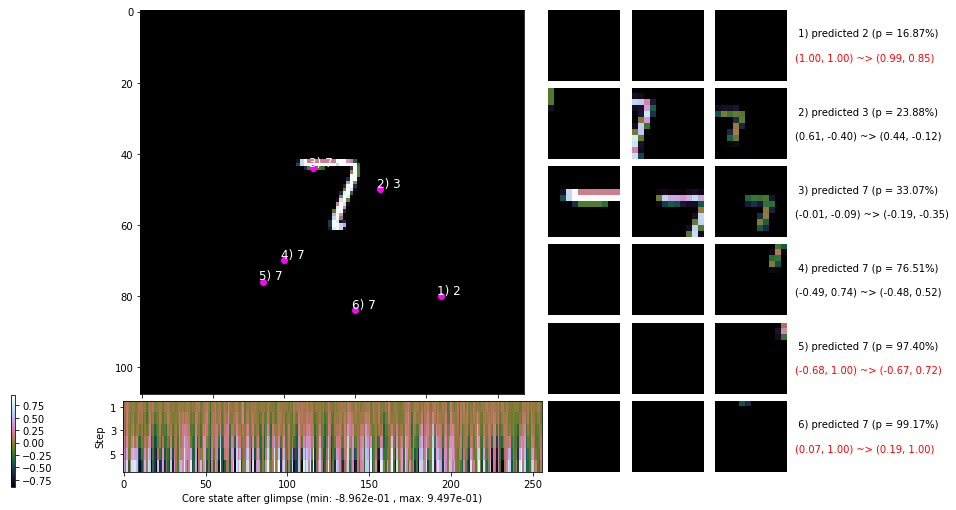

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 340.2 ms/b | lr: 3.85e-05 | grad 2norm:  7.69 | grad inf norm:  1.264
         Weights || abs max:  0.375 (36205.547) | mean:  7.454e-05 ( 0.073) | var: 2.199e-03 (185054.719)
          Biases || abs max:  0.719 (   41.770) | mean:  2.437e-02 ( 0.239) | var: 2.363e-03 (    2.243)
                    class loss: 0.222 | steps: 3.818 | reward:  0.944 | acc.: 94.43%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0,

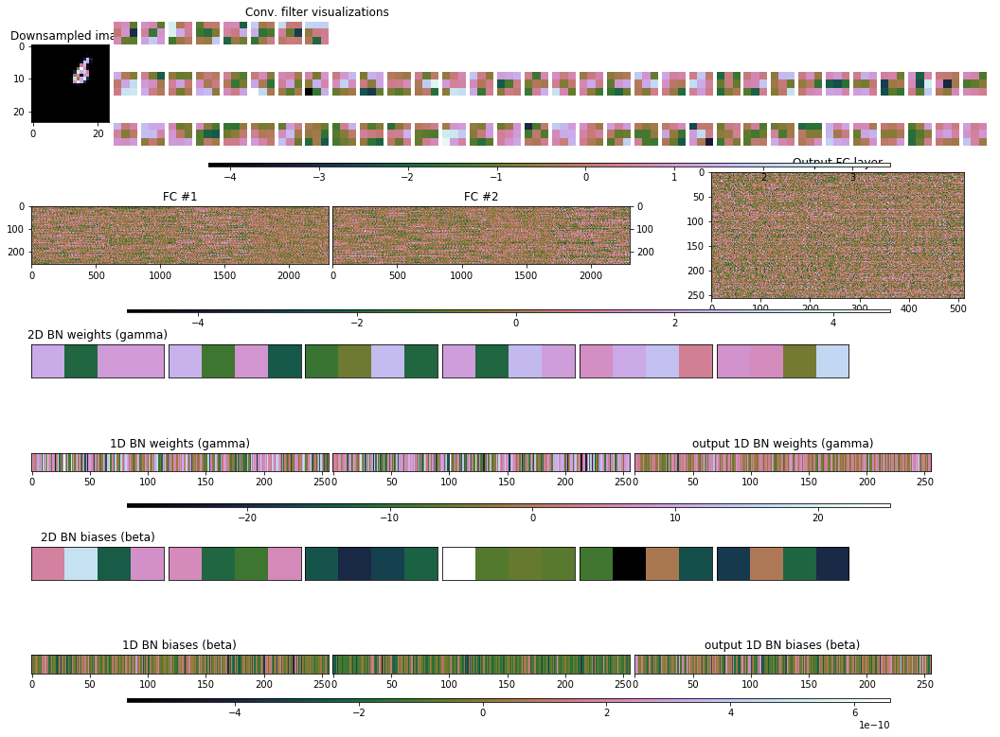


	Target class: 6 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.951, 0.824, 0.884, 0.900, 0.911, 0.902]


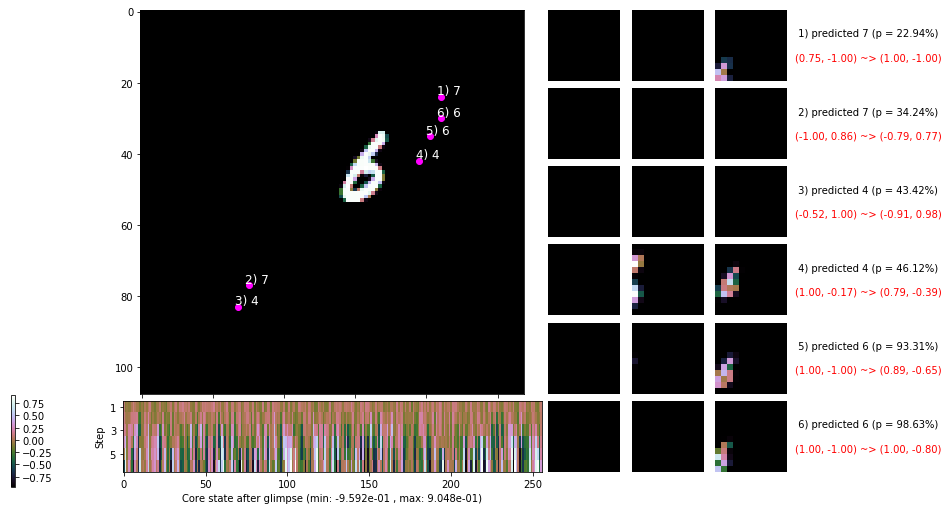

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


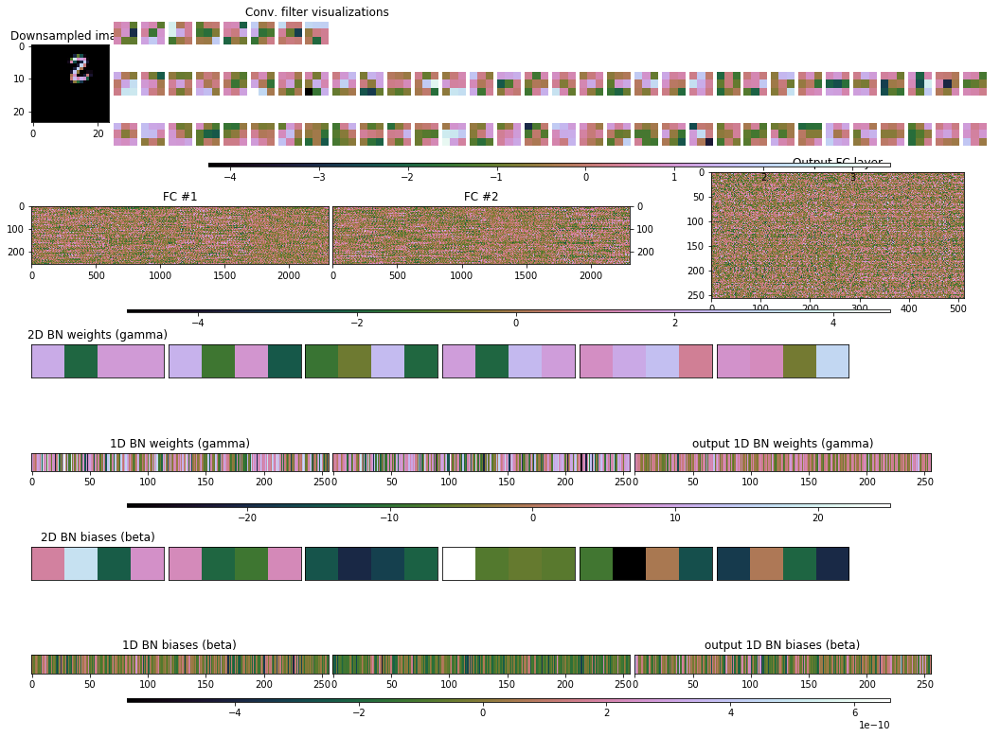


	Target class: 2 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


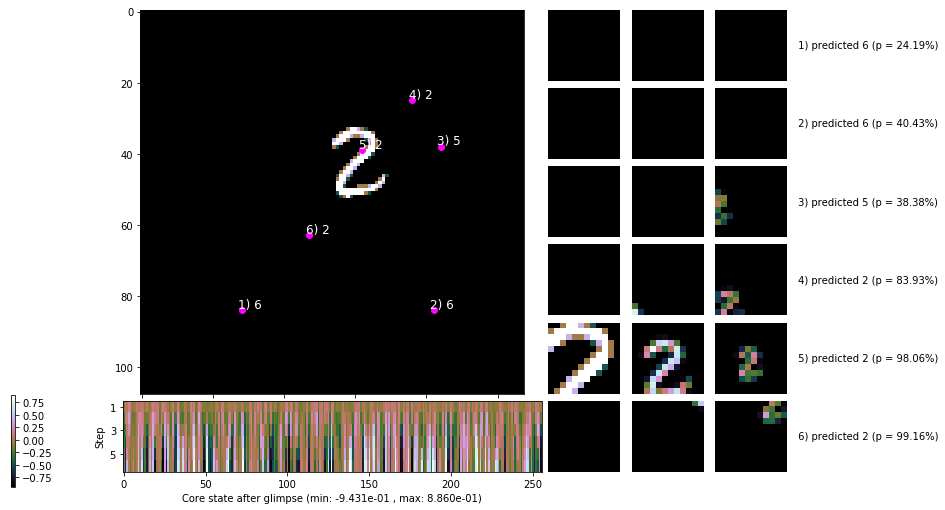

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


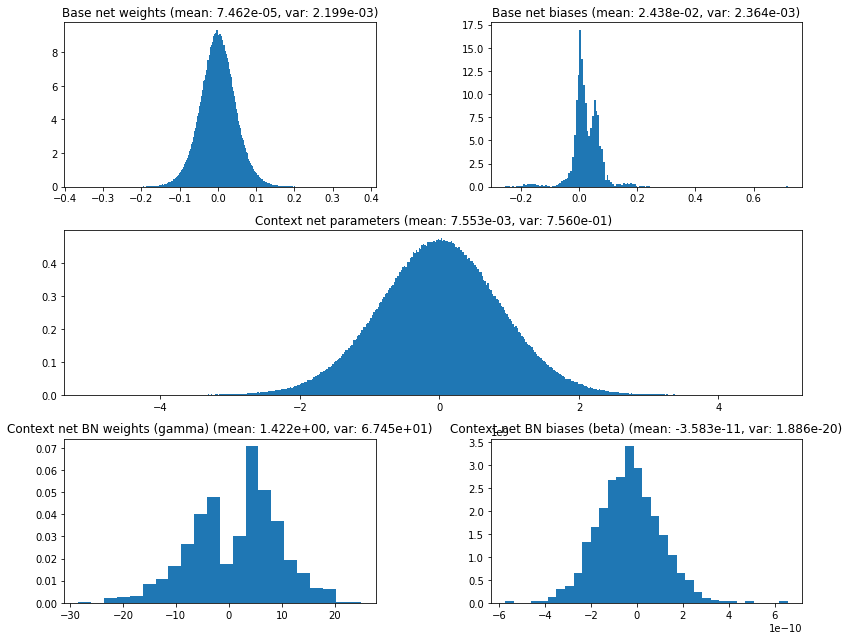

                                         Location network weights and biases


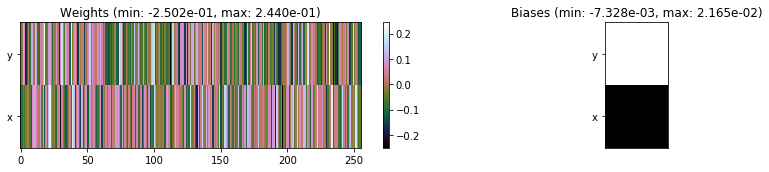

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1353.87 sec | TRAIN >> class loss: 0.2294 | steps:  3.811 :( | reward:  0.9423 :( | acc.: 94.227% :(
                          | VAL   >> class loss: 0.1409 | steps:  3.673 :( | reward:  0.9634 :( | acc.: 96.340% :(


Epoch  29/400) lr = 0.00014
 b   1000/  4000 >> 338.3 ms/b | lr: 3.49e-05 | grad 2norm:  8.06 | grad inf norm:  1.305
         Weights || abs max:  0.375 (34286.543) | mean:  7.461e-05 ( 0.072) | var: 2.199e-03 (137721.828)
          Biases || abs max:  0.719 (   41.442) | mean:  2.438e-02 ( 0.234) | var: 2.364e-03 (    2.099)
                    class loss: 0.228 | steps: 3.809 | reward:  0.942 | acc.: 94.21%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size

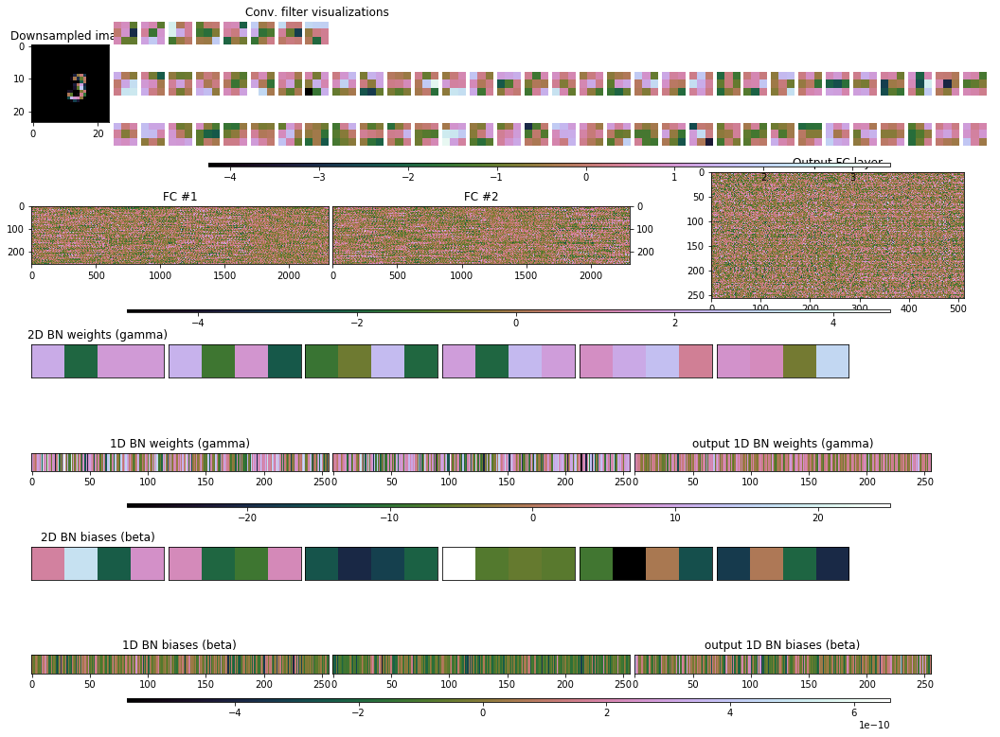


	Target class: 3 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.918, 0.978, 0.975, 0.984, 1.038, 1.109]


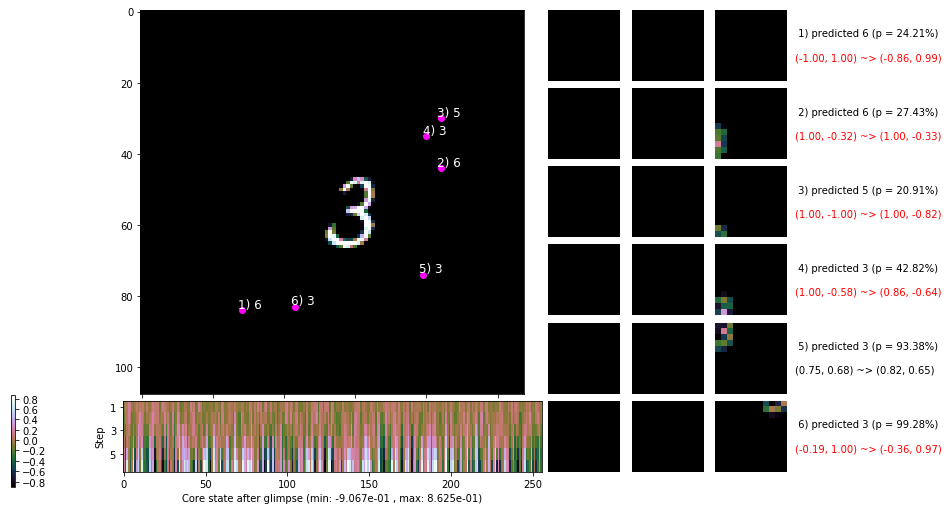

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 343.4 ms/b | lr: 3.15e-05 | grad 2norm:  7.85 | grad inf norm:  1.297
         Weights || abs max:  0.375 (18962.227) | mean:  7.464e-05 ( 0.060) | var: 2.199e-03 ( 4375.030)
          Biases || abs max:  0.719 (   44.990) | mean:  2.438e-02 ( 0.243) | var: 2.364e-03 (    2.416)
                    class loss: 0.228 | steps: 3.790 | reward:  0.943 | acc.: 94.32%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

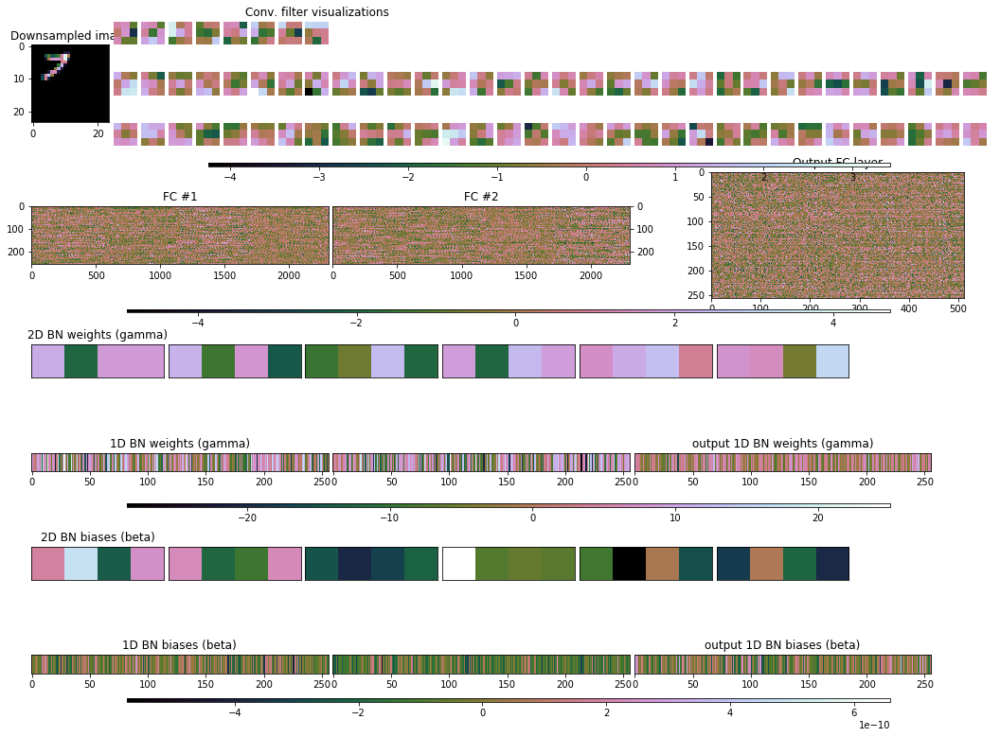


	Target class: 7 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.922, 0.853, 0.860, 0.899, 0.958, 1.011]


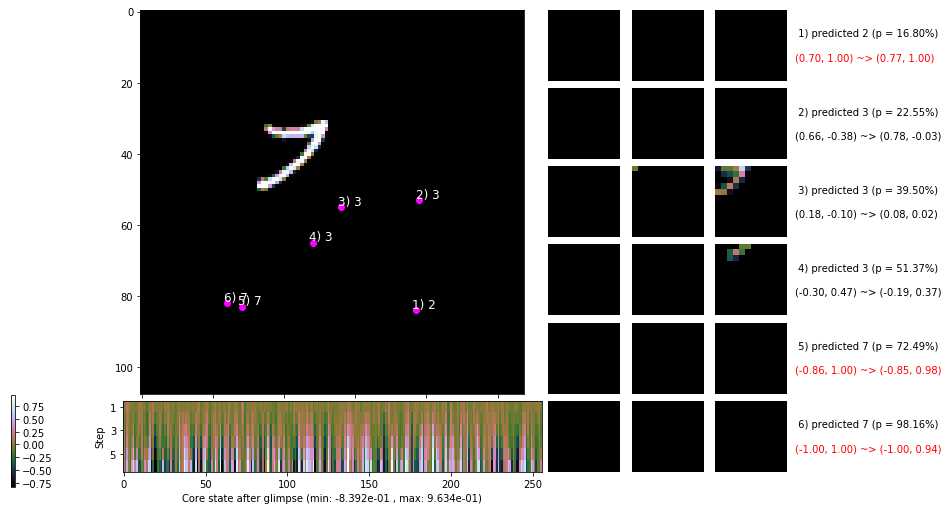

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


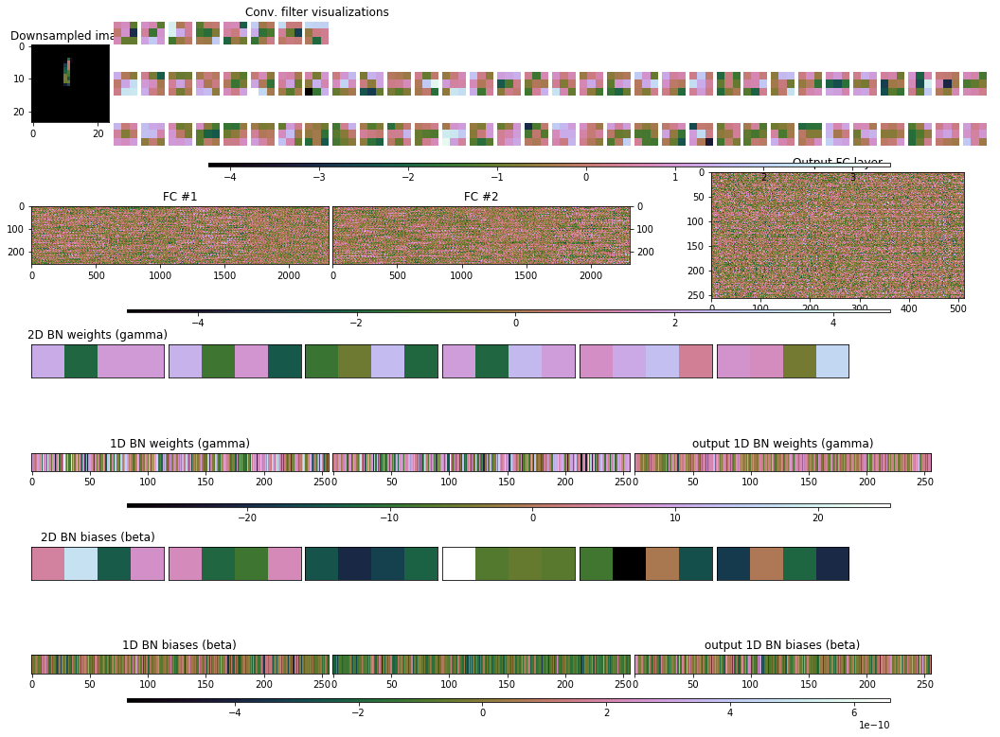


	Target class: 1 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


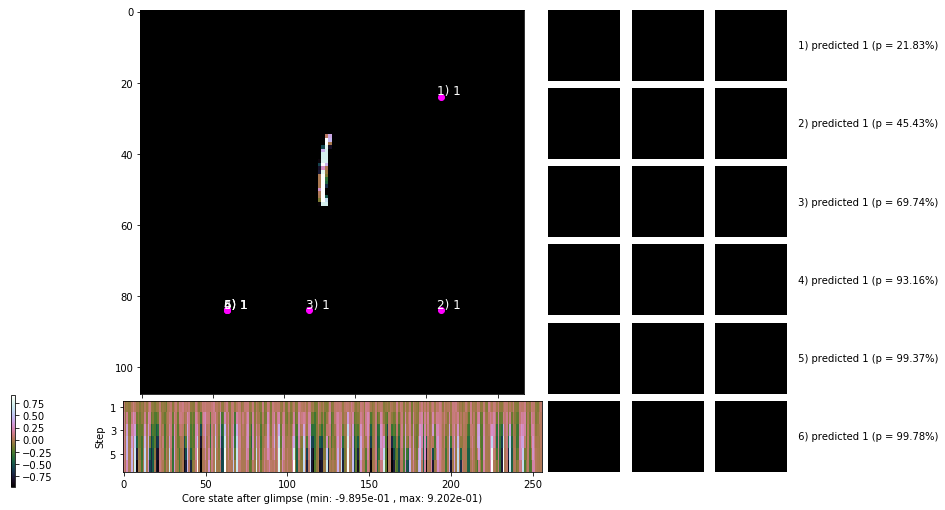

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


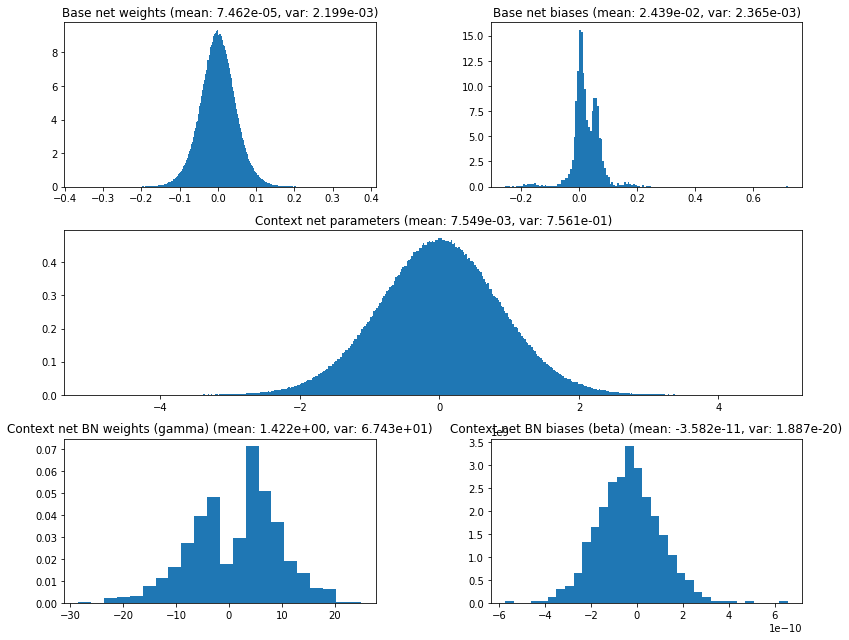

                                         Location network weights and biases


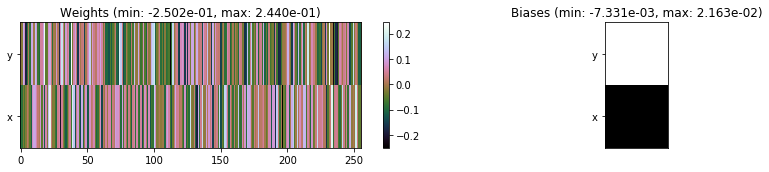

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1354.57 sec | TRAIN >> class loss: 0.2279 | steps:  3.807 :( | reward:  0.9423 :( | acc.: 94.232% :(
                          | VAL   >> class loss: 0.1493 | steps:  3.652 :( | reward:  0.9624 :( | acc.: 96.240% :(


Epoch  30/400) lr = 0.0001146
 b   1000/  4000 >> 337.9 ms/b | lr: 2.85e-05 | grad 2norm:  8.13 | grad inf norm:  1.294
         Weights || abs max:  0.375 (24210.738) | mean:  7.460e-05 ( 0.061) | var: 2.199e-03 (18624.219)
          Biases || abs max:  0.719 (   67.398) | mean:  2.439e-02 ( 0.257) | var: 2.365e-03 (   45.486)
                    class loss: 0.229 | steps: 3.817 | reward:  0.941 | acc.: 94.11%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Siz

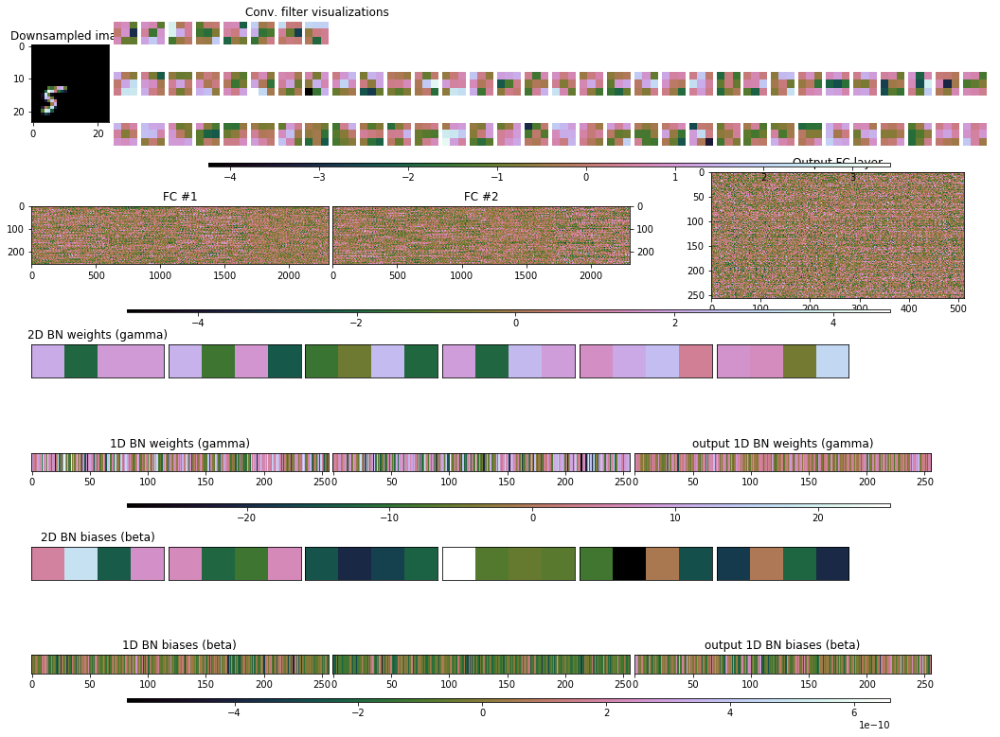


	Target class: 5 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [1.100, 1.047, 1.144, 1.177, 1.162, 1.138]


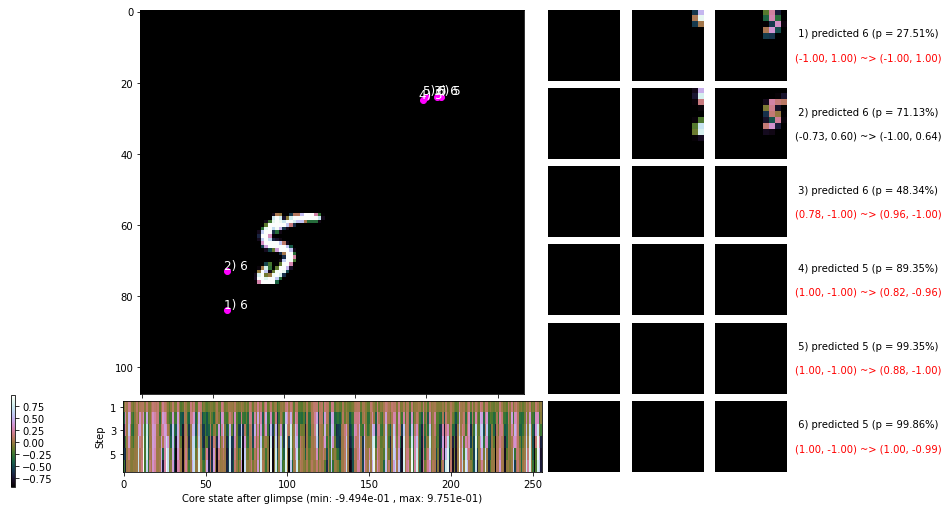

                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 342.1 ms/b | lr: 2.58e-05 | grad 2norm:  7.93 | grad inf norm:  1.273
         Weights || abs max:  0.375 (23694.201) | mean:  7.466e-05 ( 0.062) | var: 2.200e-03 (13341.620)
          Biases || abs max:  0.719 (   42.492) | mean:  2.439e-02 ( 0.243) | var: 2.366e-03 (    2.365)
                    class loss: 0.228 | steps: 3.804 | reward:  0.942 | acc.: 94.24%

	| num zero params & grads    [(torch.Size([8, 1, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([8, 4, 3, 3]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([4]), 0, 0), (torch.Size([256, 2304]), 0, 0), (torch.Size([256]), 0, 0), (torch.Size([256]), 0, 

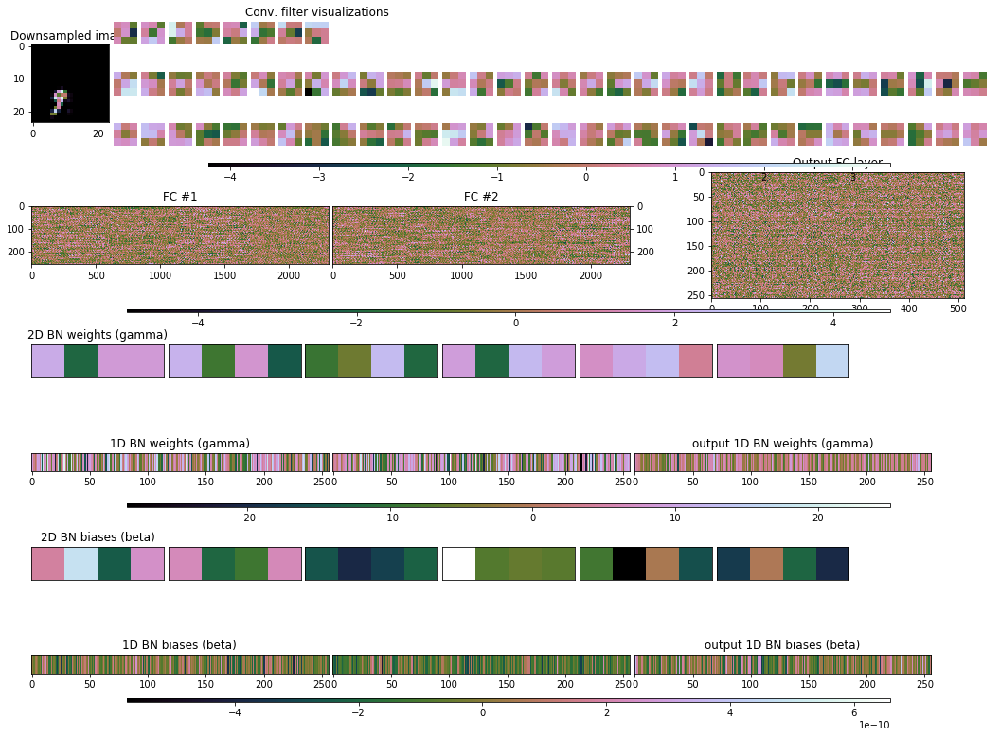


	Target class: 9 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]
	                | Baseline rewards:   [0.831, 0.896, 0.925, 0.947, 0.917, 0.870]


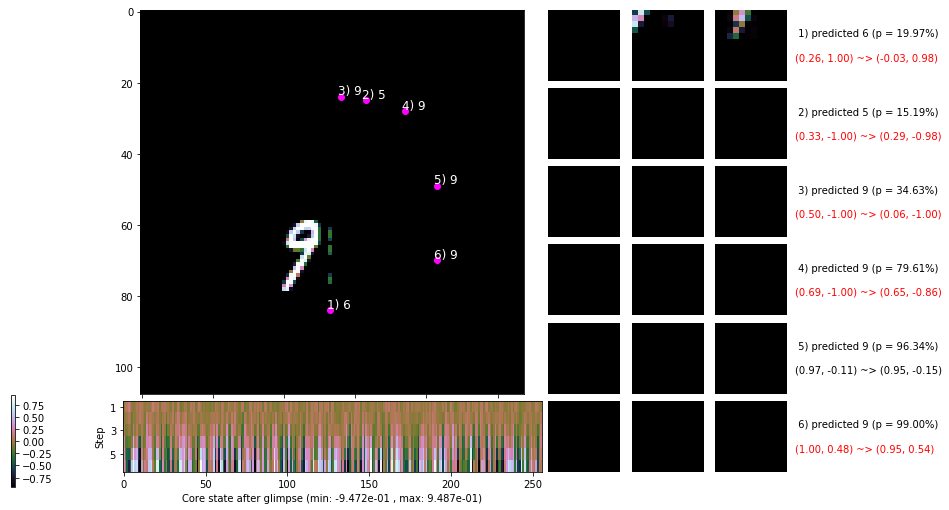

                 --------------------------------------------------------------------------------
                                             ---===  VALIDATION  ===---


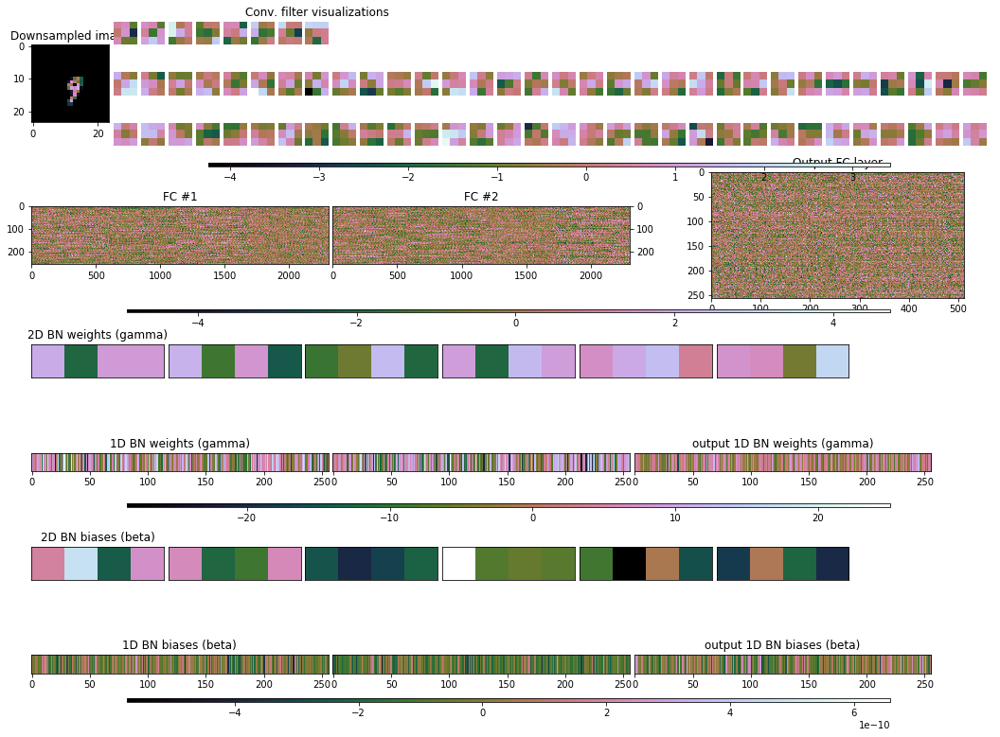


	Target class: 9 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


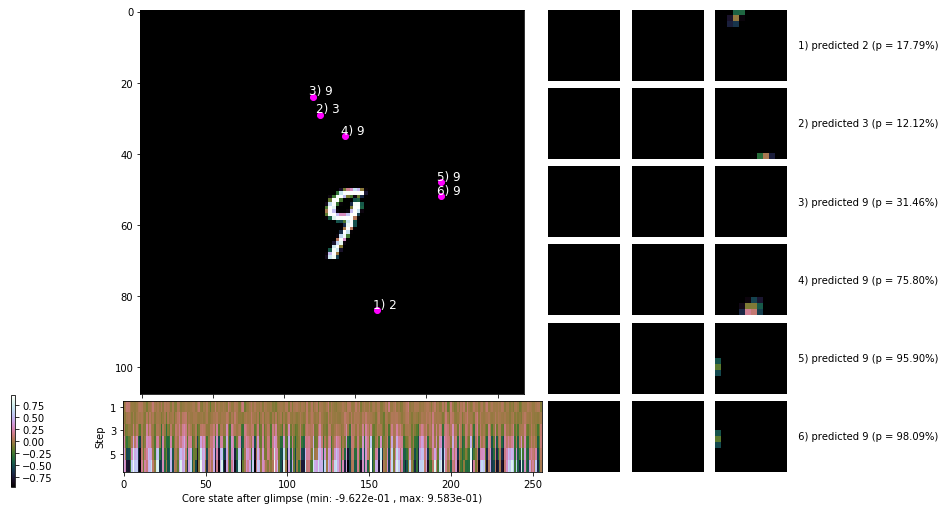

                                       ---===  MODEL PARAM DIAGNOSTICS  ===---


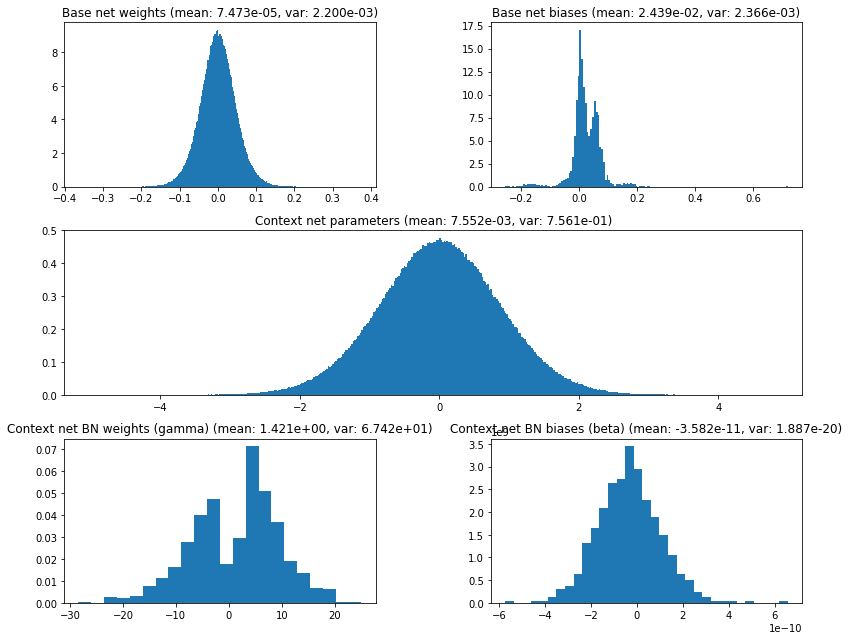

                                         Location network weights and biases


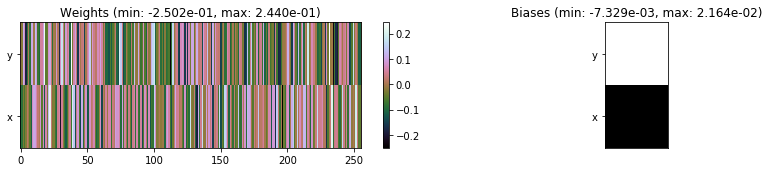

---------------------------------------------------------------------------------------------------------------------
Elapsed time: 1357.96 sec | TRAIN >> class loss: 0.2270 | steps:  3.808 :( | reward:  0.9423 :( | acc.: 94.234% :(
                          | VAL   >> class loss: 0.1528 | steps:  3.663 :( | reward:  0.9624 :( | acc.: 96.240% :(



			---~~~=== End of training ===~~~---

Evaluating on the TEST dataset...


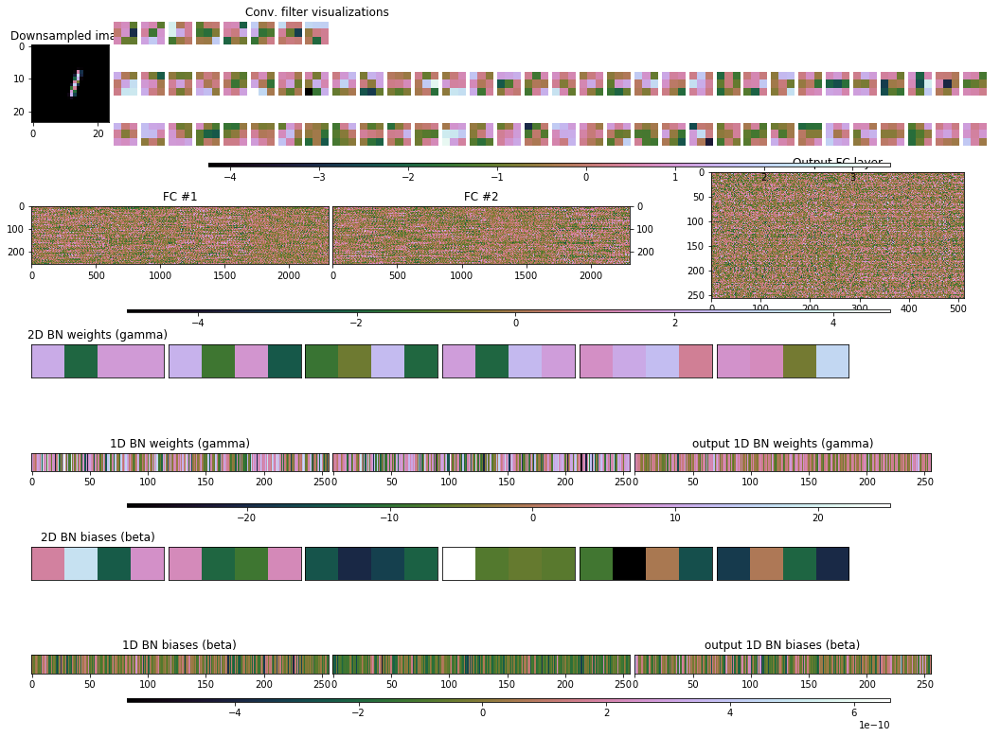


	Target class: 1 | Discounted rewards: [1.000, 1.000, 1.000, 1.000, 1.000, 1.000]


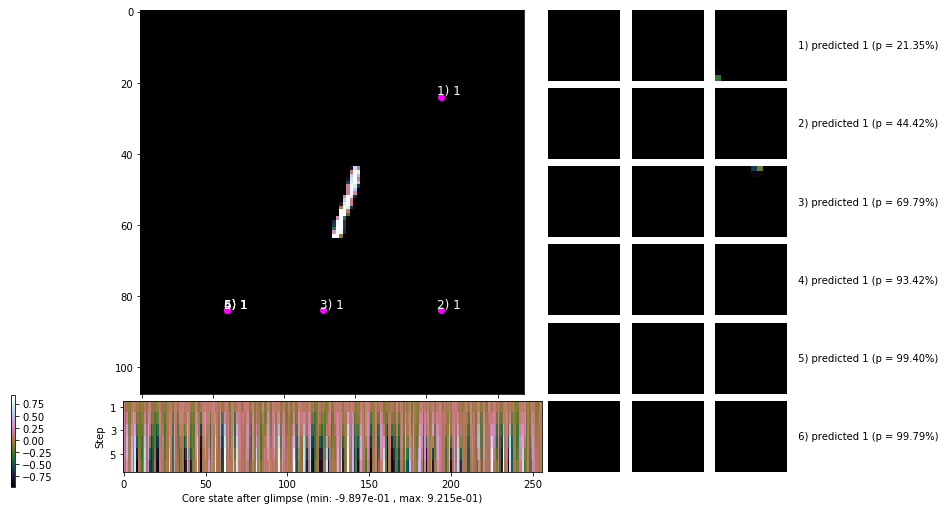

	>> class loss: 0.1510 | steps:  3.658 | reward:  0.9606 | acc.: 96.060%


In [8]:
model_info, train_info, val_info, test_info, epochs = train_eval_loop(
    model = model, epochs = num_epochs, image_size = image_size,
    train_data = train_data, val_data = val_data, test_data = test_data,
    padding = padding, optimizer = optimizer, lr_scheduler = lr_scheduler,
    class_criterion = class_criterion, error_penalty = error_penalty,
    loc_std = loc_std, gamma = gamma, context_net = context_net,
    grad_clip = grad_clip, steps_per_epoch = steps_per_epoch,
    max_ep_len = max_ep_len, log_freq = log_freq, viz_freq = viz_freq,
    eval_viz_freq = eval_viz_freq, early_stopping = early_stopping
)

In [9]:
print('Trained over %d epochs\n' % epochs)

for name, best_stats in zip(['train', 'val'], [train_info['bests'], val_info['bests']]):
    print('Best %s stats:' % name)
    for k, v in best_stats.items():
        print('    %s: %.3f (epoch %d)' % (k, v[k], v['epoch']))
    print('')

Trained over 30 epochs

Best train stats:
    steps: 3.805 (epoch 17)
    reward: 0.943 (epoch 24)
    accuracy: 0.943 (epoch 24)

Best val stats:
    steps: 3.648 (epoch 16)
    reward: 0.964 (epoch 26)
    accuracy: 0.964 (epoch 26)



### Training curves

In [10]:
epoch_range = range(1, epochs+1)
train_col = (1, 0, 0); train_err_col = (1, 0.1, 0.1)
val_col = (0, 0, 1); val_err_col = (0.1, 0.1, 1)

Text(0.5,1,'Weight and bias values over training time')

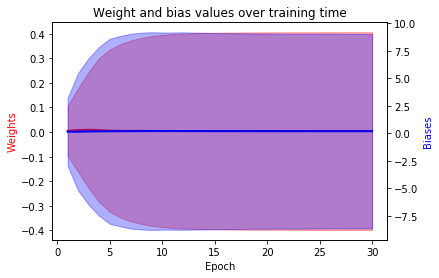

In [11]:
wts_mean = np.array(model_info['weights']['mean'])
wts_var = np.array(model_info['weights']['var'])
bias_mean = np.array(model_info['biases']['mean'])
bias_var = np.array(model_info['biases']['var'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_mean, color = train_col, linewidth = 2)
wts_ax.fill_between(epoch_range,
    wts_mean - wts_var, wts_mean + wts_var,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_mean, color = val_col, linewidth = 2)
bias_ax.fill_between(epoch_range,
    bias_mean - bias_var, bias_mean + bias_var,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Weight and bias values over training time')

Text(0.5,1,'Max absolute weight and bias values over training time')

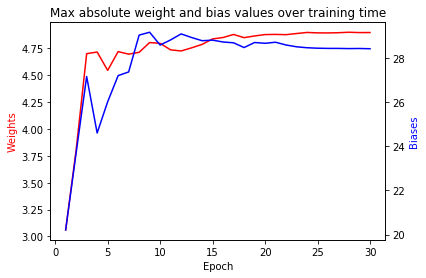

In [12]:
wts_absmax = np.array(model_info['weights']['abs max'])
bias_absmax = np.array(model_info['biases']['abs max'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_absmax, color = train_col)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_absmax, color = val_col)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Max absolute weight and bias values over training time')

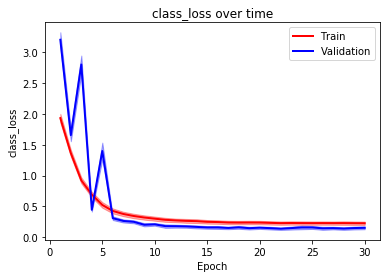

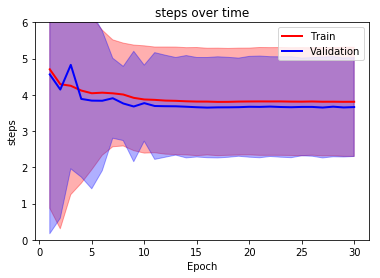

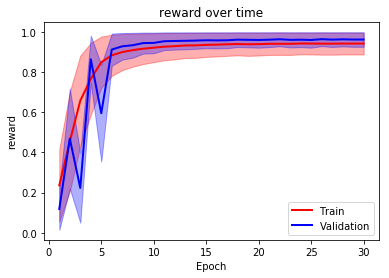

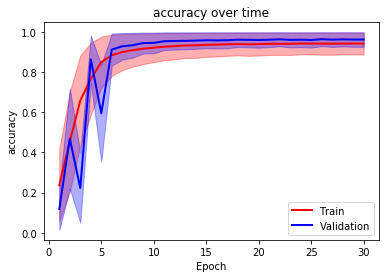

In [13]:
things_to_plot = ['class_loss', 'steps', 'reward', 'accuracy']
for thing in things_to_plot:
    train_avg = np.array([info['averages'][thing] for info in train_info['stats']])
    train_err = np.array([np.var(info['histories'][thing]) for info in train_info['stats']])
    
    val_avg = np.array([info['averages'][thing] for info in val_info['stats']])
    val_err = np.array([np.var(info['histories'][thing]) for info in val_info['stats']])
    
    plt.plot(epoch_range, train_avg, color = train_col, linewidth = 2)
    plt.plot(epoch_range, val_avg, color = val_col, linewidth = 2)
    plt.fill_between(epoch_range,
        train_avg - train_err, train_avg + train_err, alpha = 0.35,
        edgecolor = train_col, facecolor = train_err_col
    )
    plt.fill_between(epoch_range,
        val_avg - val_err, val_avg + val_err, alpha = 0.35,
        edgecolor = val_col, facecolor = val_err_col
    )
    if thing == 'steps':
        plt.ylim([0, 6])
    plt.legend(['Train', 'Validation'], loc = 'upper right' if thing in ['class_loss', 'steps'] else 'lower right')
    plt.xlabel('Epoch'); plt.ylabel(thing)
    plt.title('%s over time' % thing)
    plt.show()
    print('')

Text(0.5,1,'Gradient norms over training time')

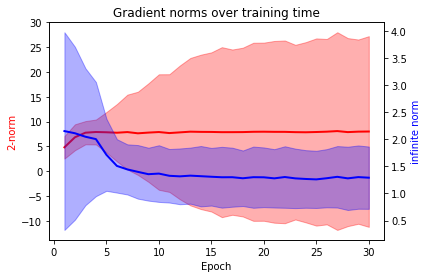

In [14]:
# Gradient stats
grad_2norm = np.array([info['averages']['grad_2norm'] for info in train_info['stats']])
grad_inf_norm = np.array([info['averages']['grad_inf_norm'] for info in train_info['stats']])
grad_2norm_err = np.array([np.var(info['histories']['grad_2norm']) for info in train_info['stats']])
grad_inf_norm_err = np.array([np.var(info['histories']['grad_inf_norm']) for info in train_info['stats']])

fig, pnorm_ax = plt.subplots()
pnorm_ax.plot(epoch_range, grad_2norm, color = train_col, linewidth = 2)
pnorm_ax.fill_between(epoch_range,
    grad_2norm - grad_2norm_err, grad_2norm + grad_2norm_err,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
pnorm_ax.set_xlabel('Epoch');
pnorm_ax.set_ylabel('2-norm', color = train_col)

infnorm_ax = pnorm_ax.twinx()
infnorm_ax.plot(epoch_range, grad_inf_norm, color = val_col, linewidth = 2)
infnorm_ax.fill_between(epoch_range,
    grad_inf_norm - grad_inf_norm_err, grad_inf_norm + grad_inf_norm_err,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
infnorm_ax.set_ylabel('infinite norm', color = val_col)

plt.title('Gradient norms over training time')